In [2]:
### Importing necessary libraries
import math
import torch
import torch.nn as nn
import numpy as np
import torch.nn.functional as F
from torch.optim.lr_scheduler import ReduceLROnPlateau
import json
import argparse 
import sys
sys.argv=['']
import h5py
from torch.utils.data import DataLoader, TensorDataset,random_split
from torch.optim.lr_scheduler import CosineAnnealingLR
import glob
import natsort
from PIL import Image
import PIL
import time
import torchvision.transforms as T
from torchvision import datasets
from torchvision.utils import make_grid
from torchvision.utils import save_image
import random
#from tools import *
import pandas as pd
import os
os.environ["KMP_DUPLICATE_LIB_OK"]="TRUE"
import matplotlib.pyplot as plt
from torchsummary import summary
from math import floor

In [3]:
# For the purpose  of reproducible results, 
#To Control the randomness.
rstate = 13
#custom operators
random.seed(rstate)
#libraries relying on NumPy
np.random.seed(rstate)
#for both CPU and CUDA devices
torch.manual_seed(rstate)
#GPU and CPU
g_cpu = torch.Generator().manual_seed(rstate)
g_cuda = torch.Generator(device='cuda').manual_seed(rstate)

# To preserve the reproducibility in the data loader
def seed_worker(worker_id):
    worker_seed = torch.initial_seed() % 2**32
    numpy.random.seed(worker_seed)
    random.seed(worker_seed)
    return

In [4]:


class Custom_Dataset(object):
    def __init__(self,main_dir,Data_set,transform_layout, transform_wind, transform_flow,transform_wake, n_images, n_channels_input):
        self.main_dir=main_dir
        self.transform_layout=transform_layout
        self.transform_wind=transform_wind
        self.transform_flow=transform_flow
        self.transform_wake=transform_wake
        self.n_images=n_images
        self.n_channels_input=n_channels_input
        #load all images with 'flow.png' from the provided path
        flow_files = glob.glob(os.path.join(self.main_dir, '*flow.png'))
        #Images are sorted naturally(e.g image 2 after image 1)
        self.image_flow=natsort.natsorted(flow_files)
        Coord_files=glob.glob(os.path.join(self.main_dir, '*layout_pixels.npy'))
        self.Coordin=natsort.natsorted(Coord_files)
        layout_files=glob.glob(os.path.join(self.main_dir, '*layout.png'))
        self.image_layout=natsort.natsorted(layout_files)
        wind_files=glob.glob(os.path.join(self.main_dir, '*wind_resource.png'))
        self.image_wind=natsort.natsorted(wind_files)
        wake_files=glob.glob(os.path.join(self.main_dir,'*wake_effects.png'))
       # print(len(wake_files))
        self.image_wake=natsort.natsorted(wake_files)
        self.speed=list(Data_set['wind_speed [m/s]'])
        self.Jensen_power=list(Data_set['jensen_power [kW-hr]'])
        
        #for reproducable results
        rstate = 10
        random.seed(rstate)
        np.random.seed(rstate)


                
            
            
    def __len__(self):
        return len(self.image_layout)
    def __getitem__(self,idx):
        if self.n_images:
            if idx >= self.n_images:
                raise Exception('CustomDataSet:Error: Index out of bounds inside __get_item__')
       # coordinate=[]
        input_loc = self.image_layout[idx]
     
        layout = self.transform_layout(Image.open(input_loc))
        u_inf=self.speed[idx]
        power=self.Jensen_power[idx]
        coor_loc=self.Coordin[idx]
        
        
        if self.n_channels_input == 2:
            target_loc = self.image_flow[idx]
            target = self.transform_flow(Image.open(target_loc))
            wind_loc = self.image_wind[idx]
            wind = self.transform_wind(Image.open(wind_loc))
            inputs = layout
           
        else:
            inputs = layout
            wake_loc = self.image_wake[idx]
            target=self.transform_wake(Image.open(wake_loc))
            #coordinate=torch.from_numpy(coordinate)
        return inputs, target,u_inf,power,coor_loc
    
# In the original images the background is black and turbines are white by applying the negative transform, the backgorund becomes
#white and the turbines are black
def to_negative(img):
    img = PIL.ImageOps.invert(img)
    return img

class Negative(object):
    """Convert image to negative.
    Args:
    Returns:
        PIL Image: Negative version of the input.
    """
    def __init__(self):
        pass

    def __call__(self, img):
        """
        Args:
            img (PIL Image): Image to be converted to Negative.
        Returns:
            PIL Image: Negatived image.
        """
        return to_negative(img)
        

In [5]:

#this csv file all csv files which are created for each wind speed 


# Define individual transformations for each input and output
transforms_list = [
                   T.Grayscale(),
                # to tranform the orignal black background to white
                   T.ToTensor()]
transforms_layout = T.Compose(transforms_list)
transforms_list = [
                   T.Grayscale(),T.ToTensor()]
transforms_flow = T.Compose(transforms_list)
transforms_list = [
                   T.Grayscale(),
                   T.ToTensor()]
transforms_wind = T.Compose(transforms_list)
transforms_list = [
                   T.Grayscale(),
                   T.ToTensor()]
transforms_wake = T.Compose(transforms_list)

#load dataset


(tensor([0., 1.]), tensor([9990,   10]))
(tensor([0., 1.]), tensor([9987,   13]))
(tensor([0., 1.]), tensor([9972,   28]))


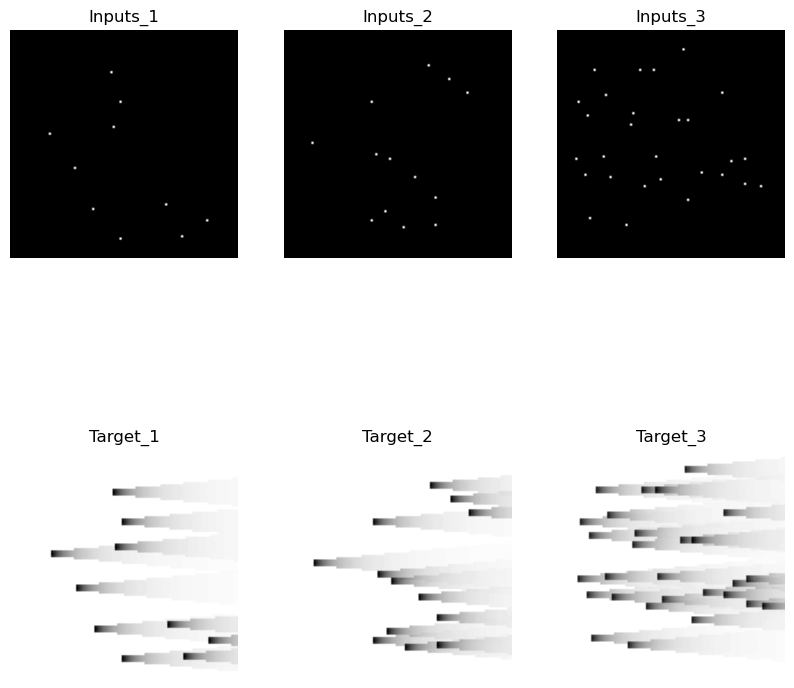

In [6]:
img_folder = 'C:/Users/saeed/Code/DecodeCNN/Error/final_code/test_final/image100'
Data_set=pd.read_csv('{}/data_set.csv'.format(img_folder))
dataset = Custom_Dataset(img_folder,Data_set, transforms_layout, transforms_wind, transforms_flow,transforms_wake, n_images=300, n_channels_input = 1)
fig=plt.figure(figsize=(10,10))
for i in range(3):
    ax = fig.add_subplot(2, 3, i + 1)

    ax.imshow(dataset.__getitem__(i)[0].squeeze(0), cmap='gray')
    print(dataset.__getitem__(i)[0].unique(return_counts=True))
    ax.set_title('Inputs_{}'.format(i+1))
    ax.axis("off")
    ax =fig.add_subplot(2, 3, i + 1 + 3)
    ax.imshow(dataset.__getitem__(i)[1].squeeze(0),cmap='gray')
    ax.set_title('Target_{}'.format(i+1))
    ax.axis("off")

plt.show()

In [7]:
# Split the dataset

ntest = int(0.1 * len(dataset))
nvalid=int(0.1*(len(dataset)))
ntrain=(len(dataset) - ntest-nvalid)
train_data,valid_data,test_data = random_split(dataset, lengths=[ntrain, nvalid,ntest])
ntest=len(test_data)
nvalid=len(test_data)
ntrain=len(train_data)
print('Number of train data:{}\nNumber of valid data:{}\nNumber of test data:{}'.format(ntrain,nvalid,ntest ))


Number of train data:240
Number of valid data:30
Number of test data:30


In [8]:
def power_curve(u):
    """
    Default, theoretical power curve
    """
   
    return 0.3 * np.power(u, 3)

DRAW_TURBINES_AS_LINES=False    
def calculate_power_from_image(
    img_flow,
    img_layout,
    cmap_min,
    cmap_max,
    power_curve_function,
    d_rot,
    farm_size,
    grid_resolution,
    rel_thickness,
    n_turbines=None,
    turbine_pixel_coordinates=None,
    invert_image = False
):
    
    # if we are given filenames, read in the images
    
    if type(img_flow) is str:
    
        img_name = img_flow
        img_flow = Image.open(img_flow)
    
        img_flow = img_flow.convert("L")
    
        
            #img_flow=np.flip(img_flow, axis=0)
    if type(img_layout) is str:
        lay_name = img_layout
        img_layout = Image.open(img_layout)
    # At this point, the images are PIL Image objects
    # flatten to grayscale
        img_layout = img_layout.convert("1")
    # We now convert them to numpy arrays
    img_flow = np.array(img_flow)
    
    img_flow=np.squeeze(img_flow, axis=0)
   
    img_layout = np.asarray(img_layout)
    img_layout=np.squeeze(img_layout, axis=0)

  
  
  
    layout_mask = (img_layout == False)
    # velocities are right after the turbine, while the first
    # set of turbines should see u = 12
    layout_mask_shifted = np.zeros(layout_mask.shape,dtype=bool)
    layout_mask_shifted[:,:-1] = layout_mask[:,1:]
    layout_mask_shifted[:,-1] = layout_mask[:,-1]
    layout_mask_old = layout_mask
    layout_mask = layout_mask_shifted
    

 
   


    # apply power curve to these speeds, using layout as mask
   
    
    uturb = img_flow[layout_mask]
    img_power = power_curve_function(uturb)
    # use image size and farm size to determine the area that each pixel covers
    # and how many pixels represent a turbine
    pix_per_m = grid_resolution / farm_size

    pix_per_turbine = max(floor(d_rot * pix_per_m), 1)
    #The thickness
    thick = max(floor(rel_thickness * d_rot * pix_per_m), 1)
    if DRAW_TURBINES_AS_LINES:
        turbine_pixel_size = pix_per_turbine * thick
    else:
        turbine_pixel_size = 1

    # totalize power AEP [kW-hr] considering number of turbines and pixels
    # this is equivalent to using the average power at each turbine site
    # with a ROUGH estimation of the number of turbines
    total_power = 8766 * img_power.sum() / turbine_pixel_size
   
    # if turbine coordinates are given then this has priority
    # so we overwrite the power estimate from above
    if turbine_pixel_coordinates is not None:
        mask = np.zeros(img_flow.shape)
        
        ixt = turbine_pixel_coordinates
 
        # We got turbine coordinates based on coordinate origin
        # at lower-left corner
        if DRAW_TURBINES_AS_LINES:
            for i in range(np.int_(np.floor(pix_per_turbine / 2))):
                for j in range(thick):
                    # note that x and y are reversed in image coordinates
                    # this is the same as doing it regularly,
                    # i.e. [i,j] instead of [j,i] and then transposing the array
                    mask[grid_resolution - ixt[:, 1] - i, ixt[:, 0]] = 1
                    mask[grid_resolution - ixt[:, 1] + i, ixt[:, 0]] = 1
                    mask[grid_resolution - ixt[:, 1] - i, ixt[:, 0] + j] = 1
                    mask[grid_resolution - ixt[:, 1] + i, ixt[:, 0] + j] = 1
        
            mask = np.bool_(mask)
            power = power_curve_function(img_flow[mask])
      
            total_power = 8766 * power.sum() / turbine_pixel_size
        else:

            XT=[]
            for i in range(ixt.shape[0]):
                x_t=[ixt[i,1],ixt[i,0]]
                XT.append(x_t)
        
            for j in XT:
                mask[j[0]][j[1]]=1

            mask = np.bool_(mask)
        
            power = power_curve_function(img_flow[mask])
            u_image=img_flow[mask].mean()
            
            u_eff=img_flow[mask]
            #print('u_eff=',u_eff)

            total_power = 8766 * power.sum()
           

    # re-calculate power if I have nt but not the pixel coordinates
  
    if n_turbines is not None and turbine_pixel_coordinates is None:
        total_power = 8766 * img_power.mean() * n_turbines
     


    return total_power

In [9]:
# Evaluating the validation and test set
def evaluate(model, epoch,valid_set, batch_size):


    
    val_loss=0
    
    device='cuda'
    actual_power=[]
    Jenson=[]
    pre_power=[]
    
    if epoch==(args.epochs-1):
 
        for step,(inputs, target,u_inf,power,coor_loc) in enumerate(valid_set):
            #images, labels = get_torch_vars(xs, ys, args.gpu)

            #############################################
            #To Enable GPU Usage

            #############################################
            inputs  = inputs.to(device, dtype=torch.float)
            #targets= targets.to(device, dtype=torch.float)
            target= target.to(device, dtype=torch.float)

            output = model(inputs)
            loss=F.mse_loss(output, target, reduction='sum')

            val_loss+=loss.item()


            for output1,true,lay,u,p,coor in zip(output,target,inputs,u_inf,power,coor_loc):
                
            #print(u.item())
                true=u.item()*true
                output1=(u.item()*output1).cpu().detach().numpy()
                power_image=calculate_power_from_image(
                            true.cpu(),
                            lay.cpu(),
                            cmap_min,
                            cmap_max,
                            power_curve_function,
                            d_rot,
                            farm_size,
                            grid_resolution,
                            rel_thickness,
                            n_turbines=None,
                            turbine_pixel_coordinates=np.load(coor),
                            invert_image = False)
               
                power_output=calculate_power_from_image(
                            output1,
                            lay.cpu(),
                            cmap_min,
                            cmap_max,
                            power_curve_function,
                            d_rot,
                            farm_size,
                            grid_resolution,
                            rel_thickness,
                            n_turbines=None,
                            turbine_pixel_coordinates=np.load(coor),
                            invert_image = False)
               
                

 
                actual_power.append(power_image)
                Jenson.append(p.item())
                pre_power.append(power_output)
        print('Validation Images')
        visual(inputs, target, output, args.gpu, 1,sv=True)
    else:
        
        for step,(inputs, target,u_inf,power,coor_loc) in enumerate(valid_set):
            
            #To Enable GPU Usage
            inputs  = inputs.to(device, dtype=torch.float)
            
            target= target.to(device, dtype=torch.float)

            output = model(inputs)
            loss=F.mse_loss(output, target, reduction='sum')
            val_loss+=loss.item()
        
            
    
    
    return val_loss,actual_power,Jenson,pre_power

In [10]:
# to visualize the images
def visual(img_grey, img_real, img_fake, gpu = 0, flag_torch = 0,sv=False):
    if gpu:
        img_grey = img_grey.cpu().detach()
        img_real = img_real.cpu().detach()
        img_fake = img_fake.cpu().detach()

    if flag_torch:
        img_grey = img_grey.numpy()
        img_real = img_real.numpy()
        img_fake = img_fake.numpy()

    if flag_torch == 2:
        img_real = np.transpose(img_real[:, :, :, :, :], [0, 4, 2, 3, 1]).squeeze()
        img_fake = np.transpose(img_fake[:, :, :, :, :], [0, 4, 2, 3, 1]).squeeze()

  #correct image structure
    img_grey = np.transpose(img_grey[:5, :, :, :], [0, 2, 3, 1]).squeeze()
    img_real = np.transpose(img_real[:5, :, :, :], [0, 2, 3, 1])
    img_fake = np.transpose(img_fake[:5, :, :, :], [0, 2, 3, 1])

    fig=plt.figure(figsize=(10,10))
    for i in range(3):
        ax = fig.add_subplot(3, 3, i + 1)
        ax.imshow(img_grey[i], cmap='gray')
        ax.set_title('Layout_{}'.format(i+1))
        ax.axis("off")
        ax =fig.add_subplot(3, 3, i + 1 + 3)
        ax.imshow(img_real[i],cmap='gray')
        ax.set_title('Target_{}'.format(i+1))
        ax.axis("off")
        ax = fig.add_subplot(3, 3, i + 1 + 6)
        ax.imshow(img_fake[i],cmap='gray')
        ax.set_title('Prediction_{}'.format(i+1))
        ax.axis("off")
    plt.show()
    if sv==True:
        fig.savefig('temp.png')

In [11]:
## turbines and wind farm parameters
d_rot = 40
    # thickness of the rotor relative to its diameter
rel_thickness = 0.05
farm_size = 2000
grid_resolution = 400
power_curve_function=power_curve
cmap_max=1
cmap_min=0

In [12]:

#Convolutional layers in the dense blocks

class conv_layer(nn.Module):
    def __init__(self,init_features,kernel_conv,stride_conv,padding_conv,growth_rate,bn_size,drop_out,bottleneck):
        super(). __init__()
        if bottleneck and init_features>growth_rate*bn_size:
            self.conv=nn.Sequential(
                nn.BatchNorm2d(init_features),
                nn.ReLU(inplace='True'),
                nn.Conv2d(init_features,growth_rate*bn_size,kernel_size=1,stride=1,padding=0,bias=False),
                nn.BatchNorm2d(growth_rate*bn_size),
                nn.ReLU(inplace='True'),
                nn.Conv2d(growth_rate*bn_size,growth_rate,kernel_conv,stride_conv,padding_conv,bias=False)
            )
        else:
            self.conv=nn.Sequential(
                nn.BatchNorm2d(init_features),
                nn.ReLU(inplace='True'),
                nn.Conv2d(init_features,growth_rate,kernel_conv,stride_conv,padding_conv,bias=False)
            )
        self.drop_out=drop_out
        
    def forward(self,x):
        out=self.conv(x)
        if self.drop_out>0:
            out = F.dropout(out, p=self.drop_out)
        return torch.cat([x,out],1)
    
# Dense blocks
            
class Dense_block(nn.Module):
    def __init__(self,init_features,kernel_conv,stride_conv,padding_conv,conv_layer,n_layers,growth_rate,bn_size,drop_out,bottleneck):
        super().__init__()
        self.layer = self._make_layer(init_features,kernel_conv,stride_conv,padding_conv,n_layers,conv_layer,growth_rate,bn_size,drop_out,bottleneck)
    def _make_layer(self,init_features,kernel_conv,stride_conv,padding_conv,n_layers,conv_layer,growth_rate,bn_size,drop_out,bottleneck):
        layers=[]
        for i in range(n_layers):
            layers.append(conv_layer(init_features+i*growth_rate,kernel_conv,stride_conv,padding_conv,growth_rate,bn_size,drop_out,bottleneck))
        return nn.Sequential(*layers)
    def forward(self, x):
        return self.layer(x)
#Encoders and decoders

class Encode_Decode(nn.Module):
    def __init__(self,init_features,kernel,stride,padding,output_padding,out_features,growth_rate,drop_out,down,bottleneck):
        super().__init__()
        self.drop_out=drop_out
        if down:
            if bottleneck:
                self.block1=nn.Sequential(nn.BatchNorm2d(init_features),
                    nn.ReLU(inplace=True),
                    nn.Conv2d(init_features,out_features,kernel_size=1,stride=1,padding=0,bias=False),
                    nn.BatchNorm2d(out_features),
                    nn.ReLU(inplace=True),
                    nn.Conv2d(out_features,out_features,kernel,stride,padding,bias=False)
                    )
            else:
                self.block1=nn.Sequential(nn.BatchNorm2d(init_features),
                    nn.ReLU(inplace=True),
                    nn.Conv2d(init_features,out_features,kernel,stride,padding,bias=False)
                    )
        else:
            if bottleneck:
                self.block1=nn.Sequential(nn.BatchNorm2d(init_features),
                    nn.ReLU(inplace=True),
                    nn.Conv2d(init_features,out_features,kernel_size=1,stride=1,padding=0,bias=False),
                    nn.BatchNorm2d(out_features),
                    nn.ReLU(inplace=True),
                    nn.ConvTranspose2d(out_features,out_features,kernel,stride,padding,output_padding,bias=False)
                    )
                
            else:
                self.block1=nn.Sequential(nn.BatchNorm2d(init_features),
                    nn.ReLU(inplace=True),
                    nn.ConvTranspose2d(out_features,out_features,kernel,stride,padding,output_padding,bias=False)
                                         )
    def forward(self,x):
        out=self.block1(x)
        if self.drop_out>0:
            out = F.dropout(out, p=self.drop_out)
        return out
                
class last_decode(nn.Module):
    def __init__(self,init_features,out_channels,kernel_size,stride,padding,output_padding,drop_out):
        super().__init__()
        self.norm1=nn.BatchNorm2d(init_features)
        self.relu1=nn.ReLU(inplace=True)
        self.conv1=nn.Conv2d(init_features,init_features//2,kernel_size=1,stride=1,padding=0,bias=False)
        self.norm2=nn.BatchNorm2d(init_features//2)
        self.relu2=nn.ReLU(inplace=True)
        self.conv2=nn.ConvTranspose2d(init_features//2,out_channels,kernel_size,stride,padding,output_padding,bias=False)
        self.drop_out=drop_out
    def forward(self,x):
        out=self.conv1(self.relu1(self.norm1(x)))
        out=self.conv2(self.relu2(self.norm2(out)))
        if self.drop_out>0:
            out = F.dropout(out, p=self.drop_out)
        return out        
    


In [13]:
# original Dense_C8 network
class Dense_C8(nn.Module):
    def __init__(self,in_channels,kernel,stride,padding,output_padding,out_channels,init_features,growth_rate,bn_size,bottleneck,drop_out):
        super().__init__()
        block=conv_layer
        self.conv1=nn.Conv2d(in_channels,init_features,kernel[3], stride[3], padding[3],bias=False)
        n_layers=2
        self.dense_block1=Dense_block(init_features,kernel[0],stride[0],padding[0],block,n_layers,growth_rate,bn_size,drop_out,bottleneck)
        in_features=init_features+growth_rate*n_layers
        self.encode1=Encode_Decode(in_features,kernel[1],stride[1],padding[1],output_padding[0],in_features//2,growth_rate,drop_out,down=True,bottleneck=True)
        n_layers=2
        self.dense_block2=Dense_block(in_features//2,kernel[0],stride[0],padding[0],block,n_layers,growth_rate,bn_size,drop_out,bottleneck)
        in_features=in_features//2+growth_rate*n_layers
        self.encode2=Encode_Decode(in_features,kernel[1],stride[1],padding[1],output_padding[0],in_features//2,growth_rate,drop_out,down=True,bottleneck=True)
        n_layers=4
        self.dense_block3=Dense_block(in_features//2,kernel[0],stride[0],padding[0],block,n_layers,growth_rate,bn_size,drop_out,bottleneck)
        in_features=in_features//2+growth_rate*n_layers
        self.decode1=Encode_Decode(in_features,kernel[1],stride[1],padding[1],output_padding[1],in_features//2,growth_rate,drop_out,down=False,bottleneck=True)
        n_layers=2
        self.dense_block4=Dense_block(in_features//2,kernel[0],stride[0],padding[0],block,n_layers,growth_rate,bn_size,drop_out,bottleneck)
        in_features=in_features//2+growth_rate*n_layers
        self.decode2=Encode_Decode(in_features,kernel[1],stride[1],padding[1],output_padding[2],in_features//2,growth_rate,drop_out,down=False,bottleneck=True)
        n_layers=2
        self.dense_block5=Dense_block(in_features//2,kernel[0],stride[0],padding[0],block,n_layers,growth_rate,bn_size,drop_out,bottleneck)
        in_features=in_features//2+growth_rate*n_layers
        self.last=last_decode(in_features,out_channels,kernel[2],stride[2],padding[2],output_padding[3],drop_out=0)
    def forward(self,x):
        out=self.dense_block1(self.conv1(x))
        out=self.dense_block2(self.encode1(out))
        out=self.dense_block3(self.encode2(out))
        out=self.dense_block4(self.decode1(out))
        out=self.dense_block5(self.decode2(out))
        out=self.last(out)
        #Try different activations when we change activation, input images should be scaled to the same range
        self.activation=nn.Sigmoid()
        out=self.activation(out)
        return out
        

In [14]:
class Dense_C8_one_layer_Added(nn.Module):
    def __init__(self,in_channels,kernel,stride,padding,output_padding,out_channels,init_features,growth_rate,bn_size,bottleneck,drop_out):
        super().__init__()
        block=conv_layer
        self.conv1=nn.Conv2d(in_channels,init_features,kernel[3], stride[3], padding[3],bias=False)
        
        n_layers=2
        self.dense_block1=Dense_block(init_features,kernel[0],stride[0],padding[0],block,n_layers,growth_rate,bn_size,drop_out,bottleneck)
        in_features1=init_features+growth_rate*n_layers
        self.encode1=Encode_Decode(in_features1,kernel[1],stride[1],padding[1],output_padding[0],in_features1//2,growth_rate,drop_out,down=True,bottleneck=True)
        
        n_layers=2
        self.dense_block2=Dense_block(in_features1//2,kernel[0],stride[0],padding[0],block,n_layers,growth_rate,bn_size,drop_out,bottleneck)
        in_features11=in_features1//2+growth_rate*n_layers
        self.encode2=Encode_Decode(in_features11,kernel[1],stride[1],padding[1],output_padding[0],in_features11//2,growth_rate,drop_out,down=True,bottleneck=True)
        
        n_layers=2
        self.dense_block22=Dense_block(in_features11//2,kernel[0],stride[0],padding[0],block,n_layers,growth_rate,bn_size,drop_out,bottleneck)
        in_features=in_features11//2+growth_rate*n_layers
        self.encode22=Encode_Decode(in_features,kernel[1],stride[1],padding[1],output_padding[0],in_features//2,growth_rate,drop_out,down=True,bottleneck=True)
        
        n_layers=4
        self.dense_block3=Dense_block(in_features//2,kernel[0],stride[0],padding[0],block,n_layers,growth_rate,bn_size,drop_out,bottleneck)
        in_features=in_features//2+growth_rate*n_layers
        self.decode1=Encode_Decode(in_features,kernel[1],stride[1],padding[1],output_padding[1],in_features//2,growth_rate,drop_out,down=False,bottleneck=True)
        
        n_layers=2
        in_features=in_features//2+in_features11//2
        self.dense_block4=Dense_block(in_features,kernel[0],stride[0],padding[0],block,n_layers,growth_rate,bn_size,drop_out,bottleneck)
        in_features=in_features+growth_rate*n_layers
        self.decode2=Encode_Decode(in_features,kernel[1],stride[1],padding[1],output_padding[2],in_features//2,growth_rate,drop_out,down=False,bottleneck=True)
        
        n_layers=2
        in_features44=in_features//2+in_features1//2
        self.dense_block44=Dense_block(in_features44,kernel[0],stride[0],padding[0],block,n_layers,growth_rate,bn_size,drop_out,bottleneck)
        in_features=in_features44+growth_rate*n_layers
        self.decode22=Encode_Decode(in_features,kernel[1],stride[1],padding[1],output_padding[2],in_features//2,growth_rate,drop_out,down=False,bottleneck=True)
        
        n_layers=2
        in_features2=in_features//2+init_features
        self.dense_block5=Dense_block(in_features2,kernel[0],stride[0],padding[0],block,n_layers,growth_rate,bn_size,drop_out,bottleneck)
        in_features=in_features2+growth_rate*n_layers
        self.last=last_decode(in_features,out_channels,kernel[2],stride[2],padding[2],output_padding[3],drop_out=0)
    def forward(self,x):
        out1=self.conv1(x)
       # print(out1.size())
        out2=self.encode1(self.dense_block1(out1))
       # print(out2.size())
        out3=self.encode2(self.dense_block2(out2))
       # print(out3.size())
        out33=self.encode22(self.dense_block22(out3))
       # print(out33.size())
        out4=self.decode1(self.dense_block3(out33))
        #print(out4.size())
        out4=torch.cat([out4, out3], 1)
        #print(out4.size())
        out4=self.dense_block4(out4)
      # print(out4.size())
        out5=self.decode2(out4)
       # print('------')
        
        out5=torch.cat([out5, out2], 1)
        #print(out5.size())
        out55=self.decode22(self.dense_block44(out5))
        out5=torch.cat([out55, out1], 1)
        out=self.dense_block5(out5)
        out=self.last(out)
        #Try different activations when we change activation, input images should be scaled to the same range
        self.activation=nn.Sigmoid()
        out=self.activation(out)
        return out
        
        

In [15]:
# original net
def network(model,k,input_size):
    parser=argparse.ArgumentParser("Convolutional Encoder-Decoder networks")
    parser.add_argument('--in_channel', type=int, default=1,help='number of input channels')
    parser.add_argument('--out_channel',type=int, default=1, help='numebr of output channels')
    parser.add_argument('--growth_rate',type=int, default=10, help='equivalent with K=16')
    parser.add_argument('--init_features', type=int, default=4, help='number of channels after the first convolutional layer')
    parser.add_argument('--bn_size',type=int, default=8, help='battleneck size')
    parser.add_argument('--bottleneck',type=str, default=False, help='battleneck')
    parser.add_argument('--drop_rate', type=int, default=0, help='dropout probability')
    if k==3:
        parser.add_argument('--kernel', type=int, default=[3,3,4,7],help='kernel size[k_conv,k,k_last,k_first]')
        parser.add_argument('--stride',type=int, default=[1,2,2,2], help='stride[s_conv,s,s_last,s_first]')
        parser.add_argument('--output_padding', type=int, default=[1,1,1,0],help='padding[encoder,med_layer,decoder,last]')
        if input_size==100:
            parser.add_argument('--padding', type=int, default=[1,1,3,2],help='padding[p_conv,p,p_last.p_first]')
            args=parser.parse_args()
        if ((input_size==200)|(input_size==400)):
            parser.add_argument('--padding', type=int, default=[1,1,1,2],help='padding[p_conv,p,p_last.p_first]')
            args=parser.parse_args()
    if k==7:
        parser.add_argument('--kernel', type=int, default=[7,7,4,7],help='kernel size[k_conv,k,k_last,k_first]')
        parser.add_argument('--stride',type=int, default=[1,2,2,2], help='stride[s_conv,s,s_last,s_first]')
        parser.add_argument('--output_padding', type=int, default=[1,1,1,0],help='padding[encoder,med_layer,decoder,last]')
        if input_size==100:
            parser.add_argument('--padding', type=int, default=[3,3,3,2],help='padding[p_conv,p,p_last.p_first]')
            args=parser.parse_args()
        if ((input_size==200)|(input_size==400)):
            parser.add_argument('--padding', type=int, default=[3,3,1,2],help='padding[p_conv,p,p_last.p_first]')
            args=parser.parse_args()
        
        
    device = 'cuda'
    ConvNet=model(args.in_channel,args.kernel,args.stride,args.padding,args.output_padding,args.out_channel, args.init_features,args.growth_rate,args.bn_size,bottleneck=False,drop_out=0)
    ConvNet=ConvNet.to(device)
    summary(ConvNet, (1, input_size, input_size))
    return ConvNet
        
        

In [16]:
# added layer
def network_add(model,k,input_size):
    parser=argparse.ArgumentParser("Convolutional Encoder-Decoder networks")
    parser.add_argument('--in_channel', type=int, default=1,help='number of input channels')
    parser.add_argument('--out_channel',type=int, default=1, help='numebr of output channels')
    parser.add_argument('--growth_rate',type=int, default=10, help='equivalent with K=16')
    parser.add_argument('--init_features', type=int, default=4, help='number of channels after the first convolutional layer')
    parser.add_argument('--bn_size',type=int, default=8, help='battleneck size')
    parser.add_argument('--bottleneck',type=str, default=False, help='battleneck')
    parser.add_argument('--drop_rate', type=int, default=0, help='dropout probability')
    if k==3:

        if input_size==100:
            parser.add_argument('--kernel', type=int, default=[3,3,4,7],help='kernel size[k_conv,k,k_last,k_first]')
            parser.add_argument('--stride',type=int, default=[1,2,2,2], help='stride[s_conv,s,s_last,s_first]')
            parser.add_argument('--output_padding', type=int, default=[1,0,0,0],help='padding[encoder,med_layer,decoder,last]')
            parser.add_argument('--padding', type=int, default=[1,1,0,2],help='padding[p_conv,p,p_last.p_first]')
            args=parser.parse_args()
        if (input_size==200):
            parser.add_argument('--kernel', type=int, default=[3,3,4,6],help='kernel size[k_conv,k,k_last,k_first]')
            parser.add_argument('--stride',type=int, default=[1,2,2,2], help='stride[s_conv,s,s_last,s_first]')
            parser.add_argument('--output_padding', type=int, default=[1,0,1,0],help='padding[encoder,med_layer,decoder,last]')
            parser.add_argument('--padding', type=int, default=[1,1,1,2],help='padding[p_conv,p,p_last.p_first]')
            args=parser.parse_args()
            
        if (input_size==400):
            parser.add_argument('--kernel', type=int, default=[3,3,4,6],help='kernel size[k_conv,k,k_last,k_first]')
            parser.add_argument('--stride',type=int, default=[1,2,2,2], help='stride[s_conv,s,s_last,s_first]')
            parser.add_argument('--output_padding', type=int, default=[1,1,1,0],help='padding[encoder,med_layer,decoder,last]')
            parser.add_argument('--padding', type=int, default=[1,1,1,2],help='padding[p_conv,p,p_last.p_first]')
            args=parser.parse_args()
    if k==7:

        if input_size==100:
            parser.add_argument('--kernel', type=int, default=[7,7,4,7],help='kernel size[k_conv,k,k_last,k_first]')
            parser.add_argument('--stride',type=int, default=[1,2,2,2], help='stride[s_conv,s,s_last,s_first]')
            parser.add_argument('--output_padding', type=int, default=[1,0,0,0],help='padding[encoder,med_layer,decoder,last]')
            parser.add_argument('--padding', type=int, default=[3,3,0,2],help='padding[p_conv,p,p_last.p_first]')
            args=parser.parse_args()
        if (input_size==200):
            parser.add_argument('--kernel', type=int, default=[7,7,4,6],help='kernel size[k_conv,k,k_last,k_first]')
            parser.add_argument('--stride',type=int, default=[1,2,2,2], help='stride[s_conv,s,s_last,s_first]')
            parser.add_argument('--output_padding', type=int, default=[1,0,1,0],help='padding[encoder,med_layer,decoder,last]')
            parser.add_argument('--padding', type=int, default=[3,3,1,2],help='padding[p_conv,p,p_last.p_first]')
            args=parser.parse_args()
            
        if (input_size==400):
            parser.add_argument('--kernel', type=int, default=[7,7,4,6],help='kernel size[k_conv,k,k_last,k_first]')
            parser.add_argument('--stride',type=int, default=[1,2,2,2], help='stride[s_conv,s,s_last,s_first]')
            parser.add_argument('--output_padding', type=int, default=[1,1,1,0],help='padding[encoder,med_layer,decoder,last]')
            parser.add_argument('--padding', type=int, default=[3,3,1,2],help='padding[p_conv,p,p_last.p_first]')
            args=parser.parse_args()
        
        
    device = 'cuda'
    ConvNet=model(args.in_channel,args.kernel,args.stride,args.padding,args.output_padding,args.out_channel, args.init_features,args.growth_rate,args.bn_size,bottleneck=False,drop_out=0)
    ConvNet=ConvNet.to(device)
    summary(ConvNet, (1, input_size, input_size))
    return ConvNet
    #summary(original, (1, input_size, input_size))

In [17]:
# Train Function 
def train(args,model,w):
    device='cuda'
    train_set=torch.utils.data.DataLoader(train_data, args.batch_size, pin_memory=True, num_workers=0)
    valid_set=torch.utils.data.DataLoader(valid_data, args.test_batch_size, pin_memory=True, num_workers=0)
    optimizer = torch.optim.Adam(model.parameters(), lr=args.learning_rate,
                       weight_decay=args.weight_decay)
    scheduler=ReduceLROnPlateau(optimizer,mode='min',threshold_mode='rel', cooldown=0, min_lr=0, eps=1e-8)
    #scheduler = CosineAnnealingLR(optimizer, T_max=300, eta_min=0.00001,last_epoch=-1)
    n_out_pixels_train = args.ntrain * train_data[0][1].numel()
    n_out_pixels_valid = args.nvalid * valid_data[0][1].numel()
    train_losses=[]
    RMSE_train=[]
    RMSE_valid=[]
    Epochs=[]
    valid_losses=[]
    for epoch in range(args.epochs):
        # Train the Model
        model.train()  # Change model to 'train' mod
        train_loss_speed=0
        train_loss_AEP=0
        train_loss_s=0
        train_loss=0
        n=0
        for step,(inputs, target,u_inf,power,coor_loc) in enumerate(train_set):
            
            inputs  = inputs.to(device, dtype=torch.float)
            targets= target.to(device, dtype=torch.float)
            

            
            
            model.zero_grad()
            outputs=model(inputs)
            masked_targets=inputs*targets
            masked_outputs=inputs*outputs
           
            #masked_target1=(masked_targets)**3
            #print(masked_targets[0,:,:,:].unique(return_counts=True))
            #print(masked_target1[0,:,:,:].unique(return_counts=True))
            
            #criterion = WeightedMSELoss(weight=weights)
            #loss=criterion(outputs, targets)
            
            loss_S=F.mse_loss(outputs, targets, reduction='sum')
            print('loss_S=',loss_S)
            
            
            loss_AEP=F.mse_loss((masked_outputs)**3, (masked_targets)**3, reduction='sum')
            print('loss_AEP=',loss_AEP)
           
            loss=(1-w)*loss_S+w*loss_AEP

  
       


            
            loss.backward()
            optimizer.step()
            train_loss_s+=loss_S.item()
            train_loss+=loss.item() 
         


       
                
            
            
            
            
            
        if epoch>= args.epoch_t:
            out1=((u_inf[0].item())*outputs[0,:,:,:]).cpu().detach().numpy()
          
           
            power_image=calculate_power_from_image(
            out1,
            inputs[0,:,:,:].cpu(),
            cmap_min,
            cmap_max,
            power_curve_function,
            d_rot,
            farm_size,
            grid_resolution,
            rel_thickness,
            n_turbines=None,
            turbine_pixel_coordinates=np.load(coor_loc[0]),
            invert_image = False) 
            print('Power_Error=',((power[0].item()-power_image)/(power[0].item()))*100)
 
    
        train_losses.append(train_loss)   
        rmse_s=np.sqrt(train_loss_s/n_out_pixels_train)
        rmse = np.sqrt(train_loss / n_out_pixels_train)
      
        RMSE_train.append(rmse_s)

        scheduler.step(rmse)
        Epochs.append(epoch+1)
        model.eval()
        val_loss,actual_power,Jenson,pre_power=evaluate(model, epoch,valid_set, args.test_batch_size)
        rmse_val = np.sqrt(val_loss / n_out_pixels_valid)
        RMSE_valid.append(rmse_val)
        
        #print(("Epoch {}: , train_loss_speed: {},train_loss_AEP: {},").format(
                  # epoch ,
                   #train_loss_s/160000,train_loss_AEP))
        print(("Epoch {}: , Train RMSE: {},Validation RMSE: {}").format(
                   epoch ,
                   rmse_s,rmse_val))
        valid_losses.append(val_loss)
        print(("Epoch {}: , Train loss: {},Validation loss: {}").format(
                  epoch ,
                  train_loss_s,val_loss))
        
            
       # model_path = save_dir + "/_epoch_" + str(epoch)
        
            

        #torch.save(gen.state_dict(), model_path)
        
        #print(""epoch, loss.cpu().detach())
        if args.plot:
            visual(inputs, targets, outputs, args.gpu, 1)
    if args.plot_LC:
            
        plt.title("Training Curve")
        plt.plot(Epochs, train_losses, label="Train")
        plt.plot(Epochs, valid_losses, label="Validation")
        plt.legend(loc='best')
        plt.xlabel("Iterations")
        plt.ylabel("Loss")
        plt.show()
        plt.title("RMSE")
        plt.plot(Epochs, RMSE_train, label="Train")
        plt.plot(Epochs, RMSE_valid, label="Validation")
        plt.legend(loc='best')
        plt.xlabel("Iterations")
        plt.ylabel("RMSE")
        plt.show()
        dict1 = {'train': RMSE_train, 'valid': RMSE_valid}  
        df = pd.DataFrame(dict1) 
        # saving the dataframe 
        df.to_csv('RMSE.csv') 
    
    return model,actual_power,Jenson,pre_power


In [18]:


def test_evaluation(model,test_data):
    args = AttrDict()
    args_dict = {
                "gpu": True,
                "valid": False,
                "plot_LC": True,
                "checkpoint": "",
                "plot": False,
                "visualize": False,
                "downsize_input": False,
                "batch_size":32,
                "test_batch_size":16,
                "learning_rate":3e-3,
                "weight_decay":0.005,
                "epochs":300,
                "ntrain":ntrain,
                "ntest":ntest,
                "nvalid":nvalid,
                "epoch_t":290
                }
    args.update(args_dict)

    device='cuda'
    actual_power_test=[]
    pre_power_test=[]
    Jensen_test=[]
    test_loss=0
    test_set=torch.utils.data.DataLoader(test_data, 16, pin_memory=True, num_workers=0)
    n_out_pixels_test = args.ntest * test_data[0][1].numel()
    for step,(inputs, target,u_inf,power,coor_loc) in enumerate(test_set):
        inputs  = inputs.to(device, dtype=torch.float)
    #targets= targets.to(device, dtype=torch.float)
        target= target.to(device, dtype=torch.float)
        output = model(inputs)
        loss=F.mse_loss(output, target, reduction='sum')
        test_loss+=loss.item()
        for output1,true,lay,u,p,coor in zip(output,target,inputs,u_inf,power,coor_loc):
                
            #print(u.item())
            true=u.item()*true
            output1=(u.item()*output1).cpu().detach().numpy()
            power_image=calculate_power_from_image(
                            true.cpu(),
                            lay.cpu(),
                            cmap_min,
                            cmap_max,
                            power_curve_function,
                            d_rot,
                            farm_size,
                            grid_resolution,
                            rel_thickness,
                            n_turbines=None,
                            turbine_pixel_coordinates=np.load(coor),
                            invert_image = False)
               
            power_output=calculate_power_from_image(
                            output1,
                            lay.cpu(),
                            cmap_min,
                            cmap_max,
                            power_curve_function,
                            d_rot,
                            farm_size,
                            grid_resolution,
                            rel_thickness,
                            n_turbines=None,
                            turbine_pixel_coordinates=np.load(coor),
                            invert_image = False)
               
                

 
            actual_power_test.append(power_image)
            Jensen_test.append(p.item())
            pre_power_test.append(power_output)
    rmse = np.sqrt(test_loss / n_out_pixels_test)
    #print(test_loss)
    #print(rmse)
    return(rmse,actual_power_test,Jensen_test,pre_power_test)



In [19]:
class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self

w= 0
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1            [-1, 4, 49, 49]             196
       BatchNorm2d-2            [-1, 4, 49, 49]               8
              ReLU-3            [-1, 4, 49, 49]               0
            Conv2d-4           [-1, 10, 49, 49]             360
        conv_layer-5           [-1, 14, 49, 49]               0
       BatchNorm2d-6           [-1, 14, 49, 49]              28
              ReLU-7           [-1, 14, 49, 49]               0
            Conv2d-8           [-1, 10, 49, 49]           1,260
        conv_layer-9           [-1, 24, 49, 49]               0
      Dense_block-10           [-1, 24, 49, 49]               0
      BatchNorm2d-11           [-1, 24, 49, 49]              48
             ReLU-12           [-1, 24, 49, 49]               0
           Conv2d-13           [-1, 12, 49, 49]             288
      BatchNorm2d-14           [-1

loss_S= tensor(6024.1675, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(85.3872, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(5303.2861, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(75.9709, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(4671.3779, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(65.6838, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(4065.6372, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(62.6816, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(3660.7314, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(56.8103, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(3363.5930, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(46.7448, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(2999.3818, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(43.5843, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(1443.

loss_S= tensor(974.4833, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(79.4382, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(564.2411, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(36.9770, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 8: , Train RMSE: 0.05689764691198656,Validation RMSE: 0.06590824446020029
Epoch 8: , Train loss: 7769.621337890625,Validation loss: 1303.1690063476562
loss_S= tensor(978.0767, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(82.1992, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(938.0829, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(95.1047, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(921.0007, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(89.8876, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(953.2980, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(78.9218, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= t

loss_S= tensor(621.1395, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(97.7776, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(577.3540, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(121.1619, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(339.3080, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(58.3959, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 15: , Train RMSE: 0.0436933325574648,Validation RMSE: 0.045483096381819306
Epoch 15: , Train loss: 4581.8575439453125,Validation loss: 620.6136169433594
loss_S= tensor(596.0938, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(135.2077, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(581.4125, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(142.1935, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(549.8564, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(125.4933, device='cuda:0', grad_fn=<MseLossBackward>)
los

loss_S= tensor(434.0082, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(104.8210, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(436.8431, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(105.4001, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(445.0373, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(103.5635, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(427.0168, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(117.1152, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(254.8089, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(51.7834, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 22: , Train RMSE: 0.03702963858530819,Validation RMSE: 0.03767269196607409
Epoch 22: , Train loss: 3290.865921020508,Validation loss: 425.76951599121094
loss_S= tensor(413.8068, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(119.6109, device='cuda:0', grad_fn=<MseLossBackward>)
lo

loss_S= tensor(319.4381, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(99.7600, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(332.3842, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(82.4967, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(356.2707, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(84.6604, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(353.2109, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(91.9047, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(318.2260, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(102.9201, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(194.1497, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(43.0803, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 29: , Train RMSE: 0.032701266616726274,Validation RMSE: 0.035645013195942744
Epoch 29: , Train loss: 2566.4948120117188,Validation loss: 381.1700897216797
loss

loss_S= tensor(251.5930, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(72.2510, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(250.5573, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(56.8362, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(252.4756, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(60.5956, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(259.9527, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(67.4662, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(244.4697, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(71.9219, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(157.7802, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(25.3472, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 36: , Train RMSE: 0.028256907178491136,Validation RMSE: 0.02923836822938521
Epoch 36: , Train loss: 1916.2867279052734,Validation loss: 256.4646530151367
loss_S

loss_S= tensor(203.4606, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(44.8565, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(214.1444, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(27.4243, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(220.6532, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(35.4942, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(198.2947, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(63.3456, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(125.6041, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(27.3496, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 43: , Train RMSE: 0.02590649448305489,Validation RMSE: 0.027137416265596577
Epoch 43: , Train loss: 1610.7514953613281,Validation loss: 220.9318084716797
loss_S= tensor(201.8054, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(44.5188, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S

loss_S= tensor(166.3764, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(22.5448, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(174.0116, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(25.9792, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(173.6253, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(30.9152, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(159.3710, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(34.9497, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(102.5522, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(15.4044, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 50: , Train RMSE: 0.023038376097804222,Validation RMSE: 0.024217201626411295
Epoch 50: , Train loss: 1273.8402557373047,Validation loss: 175.94185638427734
loss_S= tensor(160.3019, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(25.3622, device='cuda:0', grad_fn=<MseLossBackward>)
loss

Epoch 56: , Train RMSE: 0.021706082462272368,Validation RMSE: 0.023317708187914152
Epoch 56: , Train loss: 1130.7696380615234,Validation loss: 163.11465454101562
loss_S= tensor(145.6440, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(20.3894, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(149.3249, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(32.7577, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(140.7914, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(27.4090, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(146.6097, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(17.2221, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(155.9532, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(17.5733, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(150.2923, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(23.7343, device='cuda:0', grad_fn=<MseLossBackward>)
loss

loss_S= tensor(80.5398, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(10.2680, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 63: , Train RMSE: 0.02106543721019744,Validation RMSE: 0.023568382925140508
Epoch 63: , Train loss: 1065.00634765625,Validation loss: 166.6406021118164
loss_S= tensor(138.2562, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(14.7656, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(149.8183, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(29.7649, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(136.5304, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(29.8937, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(127.8026, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(17.3366, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(149.0171, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(10.7032, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= t

loss_S= tensor(123.9111, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(19.7438, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(123.5786, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(20.3572, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(120.4604, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(13.5154, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(114.5540, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(12.3862, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(78.6984, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(9.9348, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 70: , Train RMSE: 0.01953940462903206,Validation RMSE: 0.02058329116055059
Epoch 70: , Train loss: 916.2919998168945,Validation loss: 127.1015625
loss_S= tensor(117.6535, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(19.0448, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(1

loss_S= tensor(110.3629, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(13.2358, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(113.3531, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(12.4227, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(109.8951, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(11.6854, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(101.2505, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(11.9983, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(69.8536, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(9.6863, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 77: , Train RMSE: 0.018536847491965536,Validation RMSE: 0.01987541367842054
Epoch 77: , Train loss: 824.6753158569336,Validation loss: 118.5096206665039
loss_S= tensor(106.9176, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(13.8277, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= t

loss_S= tensor(98.0822, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(9.8693, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(107.9426, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(8.7642, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(108.2504, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(12.8827, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(94.3986, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(14.4316, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(61.3857, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(8.1695, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 84: , Train RMSE: 0.017989070735564928,Validation RMSE: 0.019734362499789854
Epoch 84: , Train loss: 776.6559982299805,Validation loss: 116.8335189819336
loss_S= tensor(99.7410, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(11.1388, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tenso

loss_S= tensor(102.2469, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(16.5253, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(96.1634, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(15.1205, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(94.9323, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(10.2378, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(103.7983, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(9.2362, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(102.8576, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(11.2957, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(93.6985, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(11.7591, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(58.5451, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(7.4161, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 91: , Train RMSE: 0.0176270

loss_S= tensor(58.5453, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(6.8549, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 97: , Train RMSE: 0.01706445859257178,Validation RMSE: 0.01853444139383692
Epoch 97: , Train loss: 698.8697929382324,Validation loss: 103.05765533447266
loss_S= tensor(88.0646, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(8.3865, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(91.9792, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(11.7563, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(91.1031, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(12.6681, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(90.5308, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(12.1723, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(92.5668, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(12.3685, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(

loss_S= tensor(82.4307, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(8.5957, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(56.0405, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(6.7280, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 104: , Train RMSE: 0.016816448877674146,Validation RMSE: 0.019420081082615774
Epoch 104: , Train loss: 678.7030868530273,Validation loss: 113.14186477661133
loss_S= tensor(89.5115, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(13.2770, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(87.7263, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(16.1783, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(83.5471, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(10.3079, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(85.1954, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(7.8395, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tens

loss_S= tensor(73.8111, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(7.7407, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(76.5036, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(7.0265, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(82.6007, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(7.6424, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(78.4250, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(6.8791, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(71.5020, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(6.6250, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(48.0045, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(5.2918, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 111: , Train RMSE: 0.015602152994538352,Validation RMSE: 0.017541770856220173
Epoch 111: , Train loss: 584.225227355957,Validation loss: 92.31411743164062
loss_S= tensor(75

loss_S= tensor(43.7936, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.7695, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 117: , Train RMSE: 0.015239545521805486,Validation RMSE: 0.01705102436348255
Epoch 117: , Train loss: 557.3849945068359,Validation loss: 87.22122955322266
loss_S= tensor(71.2906, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(5.9174, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(76.1477, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(7.9490, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(69.4220, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(7.2527, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(70.3674, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(5.9081, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(77.7737, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(5.5554, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(77

loss_S= tensor(75.5679, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(5.6900, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(72.6307, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(5.9485, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(42.7882, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.8720, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 124: , Train RMSE: 0.015077616206991449,Validation RMSE: 0.01596463116842706
Epoch 124: , Train loss: 545.6028251647949,Validation loss: 76.46083450317383
loss_S= tensor(67.8463, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.8366, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(72.9502, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(7.9144, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(73.7075, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(8.2505, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(69

loss_S= tensor(85.1745, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(6.2626, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(69.3551, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(6.2611, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(83.9180, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(8.6858, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(48.4318, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.9264, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 131: , Train RMSE: 0.015818855174566687,Validation RMSE: 0.01735785456653543
Epoch 131: , Train loss: 600.5668296813965,Validation loss: 90.38853454589844
loss_S= tensor(83.5330, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.8357, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(66.9781, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(5.6282, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(71

loss_S= tensor(58.3981, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.8905, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(60.3318, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.3357, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(62.3871, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.1840, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(64.3308, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.1379, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(61.9576, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.3640, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(59.7963, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.5993, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(38.2892, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.0234, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 138: , Train RMSE: 0.01394261535149

loss_S= tensor(56.9328, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(5.2291, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(58.7164, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.6100, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(60.6061, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.5231, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(62.9031, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.4302, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(60.3377, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.4277, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(58.4928, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.5653, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(37.4202, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.8518, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 145: , Train RMSE: 0.01375947770123

loss_S= tensor(57.9610, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.4990, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(59.8599, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.4327, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(62.1635, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.3742, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(59.5579, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.3313, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(57.7795, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.4847, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(36.9689, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.7987, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 152: , Train RMSE: 0.013671755719345738,Validation RMSE: 0.014305619586360965
Epoch 152: , Train loss: 448.60057067871094,Validation loss: 61.395225524902344
loss_S= tensor

loss_S= tensor(55.5368, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.9887, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(57.3781, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.4587, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(59.2438, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.3963, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(61.5336, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.3442, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(58.9251, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.2776, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(57.2079, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.4192, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(36.5894, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.7405, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 159: , Train RMSE: 0.01360130217199

loss_S= tensor(36.3057, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.7022, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 165: , Train RMSE: 0.013547198627951887,Validation RMSE: 0.01417801921968417
Epoch 165: , Train loss: 440.46381759643555,Validation loss: 60.30486869812012
loss_S= tensor(57.0444, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.2470, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(54.9932, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.9126, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(56.8589, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.4049, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(58.7079, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.3536, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(60.9713, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.3065, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(5

loss_S= tensor(57.9049, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.1594, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(56.2923, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.3026, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(35.9877, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.6512, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 172: , Train RMSE: 0.013488094625720315,Validation RMSE: 0.014117818801745289
Epoch 172: , Train loss: 436.6288719177246,Validation loss: 59.79384231567383
loss_S= tensor(56.5576, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.1984, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(54.4911, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.8526, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(56.3861, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.3634, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(5

loss_S= tensor(57.3925, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.1094, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(55.8334, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.2523, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(35.6930, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.6069, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 179: , Train RMSE: 0.013431543848827054,Validation RMSE: 0.014060557817632451
Epoch 179: , Train loss: 432.9752883911133,Validation loss: 59.30978584289551
loss_S= tensor(56.0880, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.1405, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(54.0050, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.7740, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(55.9260, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.3073, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(5

loss_S= tensor(59.5268, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.1797, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(56.8986, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.0653, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(55.3894, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.2097, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(35.3931, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.5644, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 186: , Train RMSE: 0.013376337655935261,Validation RMSE: 0.014005370563188369
Epoch 186: , Train loss: 429.4233818054199,Validation loss: 58.84512138366699
loss_S= tensor(55.6370, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.0983, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(53.5499, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.7108, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(5

loss_S= tensor(53.1683, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.6695, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(55.1188, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.2327, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(56.8914, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.1925, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(59.0591, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.1331, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(56.4239, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.0221, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(54.9559, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.1620, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(35.1043, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.5247, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 193: , Train RMSE: 0.01332253040333

loss_S= tensor(34.8581, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.4916, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 199: , Train RMSE: 0.013277082080961717,Validation RMSE: 0.013905619060476168
Epoch 199: , Train loss: 423.07418060302734,Validation loss: 58.00987243652344
loss_S= tensor(54.8219, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.0466, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(52.7388, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.6273, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(54.6968, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.1874, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(56.4467, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.1476, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(58.5903, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.0813, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(

loss_S= tensor(54.1482, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.0935, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(34.5790, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.4543, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 206: , Train RMSE: 0.013224271915058714,Validation RMSE: 0.013853205979771207
Epoch 206: , Train loss: 419.71528244018555,Validation loss: 57.573394775390625
loss_S= tensor(54.3920, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.0148, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(52.3115, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.5773, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(54.2776, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.1387, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(56.0090, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.1050, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor

loss_S= tensor(53.9188, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.0960, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(55.6301, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.0733, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(57.7303, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.0047, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(55.1185, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.8925, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(53.7174, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.0429, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(34.2941, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.3969, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 213: , Train RMSE: 0.013171497694036466,Validation RMSE: 0.013800184510328996
Epoch 213: , Train loss: 416.37204360961914,Validation loss: 57.133527755737305
loss_S= tensor

loss_S= tensor(55.1947, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.0325, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(57.2775, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.9593, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(54.6766, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.8333, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(53.2877, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.9861, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(34.0155, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.3394, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 220: , Train RMSE: 0.013118937166843722,Validation RMSE: 0.013747983148796284
Epoch 220: , Train loss: 413.0556297302246,Validation loss: 56.70211219787598
loss_S= tensor(53.5300, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.9288, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(5

Epoch 226: , Train RMSE: 0.013073493468590824,Validation RMSE: 0.013702060937981585
Epoch 226: , Train loss: 410.1989555358887,Validation loss: 56.32394218444824
loss_S= tensor(53.1666, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.9006, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(51.0913, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.4190, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(53.0839, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.9832, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(54.7544, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.9612, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(56.8247, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.8895, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(54.2280, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.7793, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(5

Epoch 233: , Train RMSE: 0.013020701028787463,Validation RMSE: 0.013647795713227714
Epoch 233: , Train loss: 406.89277267456055,Validation loss: 55.87869834899902
loss_S= tensor(52.7310, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.8419, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(50.6668, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.3701, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(52.6681, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.9475, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(54.3046, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.9497, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(56.3548, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.8695, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(53.7801, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.7481, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(

Epoch 240: , Train RMSE: 0.012966897487465514,Validation RMSE: 0.013594264462846355
Epoch 240: , Train loss: 403.5370330810547,Validation loss: 55.44120788574219
loss_S= tensor(52.3188, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.8339, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(50.2395, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.3188, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(52.2393, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.8669, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(53.8844, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.8543, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(55.9060, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.7841, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(53.3386, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.6808, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(5

loss_S= tensor(51.6482, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.7776, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(32.9350, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.1665, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 247: , Train RMSE: 0.01291478775058733,Validation RMSE: 0.013539919618248701
Epoch 247: , Train loss: 400.3001823425293,Validation loss: 54.99882698059082
loss_S= tensor(51.8816, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.7817, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(49.8278, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.3001, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(51.8344, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.8587, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(53.4129, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.8528, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(55

loss_S= tensor(52.5047, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.6034, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(51.2228, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.7560, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(32.6524, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.1283, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 254: , Train RMSE: 0.012859335978476988,Validation RMSE: 0.013485100471368404
Epoch 254: , Train loss: 396.8700523376465,Validation loss: 54.55438041687012
loss_S= tensor(51.4427, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.7088, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(49.3781, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.1888, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(51.4095, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.7555, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(5

loss_S= tensor(49.0144, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.1714, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(51.0423, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.7062, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(52.6359, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.7025, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(54.5875, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.6389, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(52.0653, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.5274, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(50.8043, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.7241, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(32.3693, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.1264, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 261: , Train RMSE: 0.01280647713127

loss_S= tensor(48.6197, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.1953, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(50.6334, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.7270, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(52.1507, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.7091, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(54.1134, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.5985, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(51.6358, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.4413, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(50.3604, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.6095, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(32.0896, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.0265, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 268: , Train RMSE: 0.01275227766947

Epoch 274: , Train RMSE: 0.012705101926030183,Validation RMSE: 0.013327893021455319
Epoch 274: , Train loss: 387.407075881958,Validation loss: 53.28981971740723
loss_S= tensor(50.2141, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.6261, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(48.1692, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(4.1010, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(50.2061, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.6757, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(51.6973, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.6935, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(53.6188, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.5931, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(51.1536, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.4197, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(49

Epoch 281: , Train RMSE: 0.012647836848026853,Validation RMSE: 0.013269793427274558
Epoch 281: , Train loss: 383.922664642334,Validation loss: 52.82622528076172
loss_S= tensor(49.7552, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.5306, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(47.7115, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.9796, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(49.7624, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.5799, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(51.2534, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.6240, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(53.1437, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.5568, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(50.6800, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.4056, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(49

loss_S= tensor(31.2751, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(2.9060, device='cuda:0', grad_fn=<MseLossBackward>)
Epoch 288: , Train RMSE: 0.012591210708003947,Validation RMSE: 0.013213013566886148
Epoch 288: , Train loss: 380.49260902404785,Validation loss: 52.375118255615234
loss_S= tensor(49.3165, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.4992, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(47.2746, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.9098, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(49.3302, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.5061, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(50.8049, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.5493, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(52.6857, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.4958, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor

loss_S= tensor(49.8294, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.2935, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(48.7337, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.4590, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(30.9893, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(2.8664, device='cuda:0', grad_fn=<MseLossBackward>)
Power_Error= 3.176998980831886
Epoch 295: , Train RMSE: 0.012534150521205191,Validation RMSE: 0.013155867111179767
Epoch 295: , Train loss: 377.05183029174805,Validation loss: 51.923051834106445
loss_S= tensor(48.8567, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.4649, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(46.8349, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.8607, device='cuda:0', grad_fn=<MseLossBackward>)
loss_S= tensor(48.8837, device='cuda:0', grad_fn=<MseLossBackward>)
loss_AEP= tensor(3.4536, device='cuda:0', grad_fn=<M

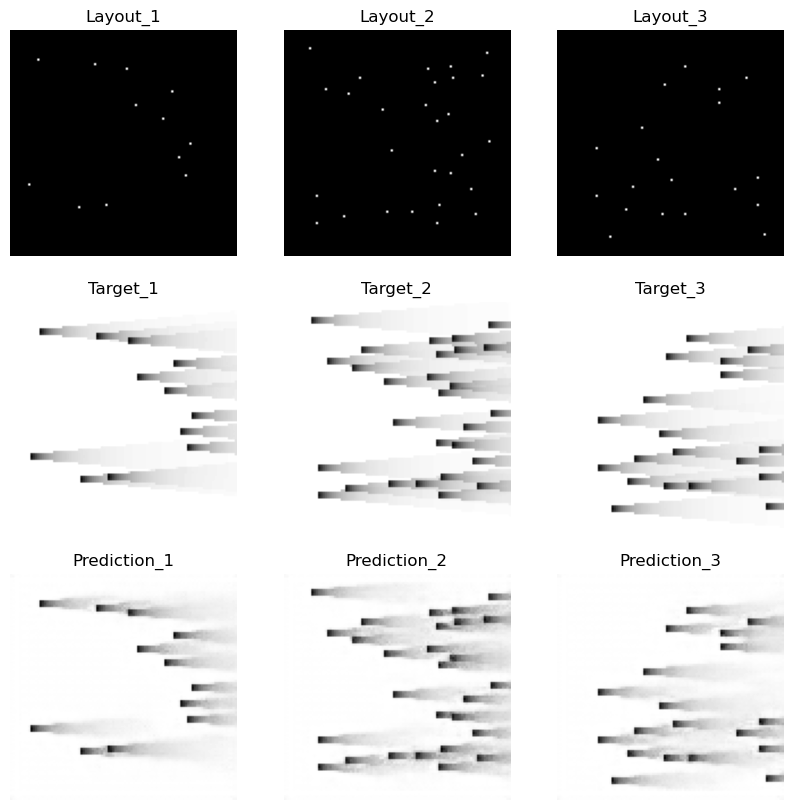

Epoch 299: , Train RMSE: 0.012505337529254501,Validation RMSE: 0.013126282644419856
Epoch 299: , Train loss: 375.32032012939453,Validation loss: 51.689788818359375


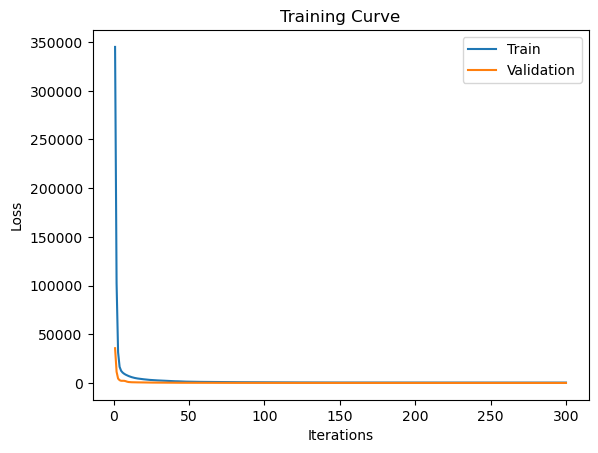

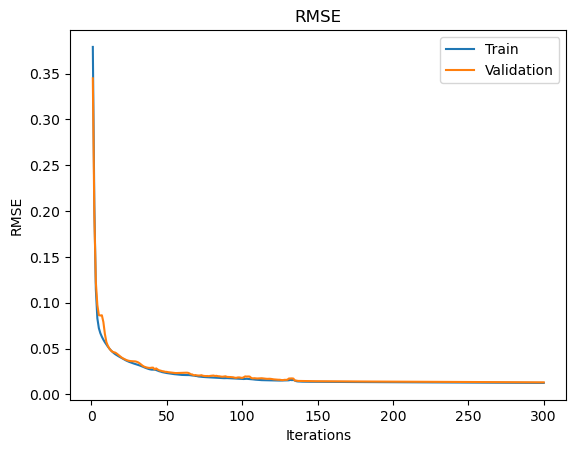

AEP Error on validation data= 5.938772559198818


In [20]:
AEP_Error=[]
RMSE=[]
for w in [0]:
    print('w=',w)
    device = 'cuda'


   

    args = AttrDict()
    args_dict = {
    "gpu": True,
    "valid": False,
    "plot_LC": True,
    "checkpoint": "",
    "plot": False,
    "visualize": False,
    "downsize_input": False,
    "batch_size":32,
    "test_batch_size":16,
    "learning_rate":3e-3,
    "weight_decay":0.005,
    "epochs":300,
    "ntrain":ntrain,
    "ntest":ntest,
    "nvalid":nvalid,
    "epoch_t":290
    }

    
    args.update(args_dict)
    ConvNet=network_add(Dense_C8,3,100)
    #ConvNet=network_add(Dense_C8_one_layer_Added,7,400)
    cnn,actual_power,Jensen,pre_power = train(args,ConvNet,w)
    #cnn,actual_power,Jensen,pre_power = train(args,ConvNet,w)
    model=cnn
    #torch.save(model.state_dict(), './results/w_{}_model.pt'.format(w))
    rmse_test,actual_power_test,Jensen_test,pre_power_test=test_evaluation(model,test_data)
    RMSE.append(rmse_test)
    difference=[]
    zip_object = zip(Jensen_test,pre_power_test)
    for list1_i, list2_i in zip_object:
        difference.append((abs(list1_i-list2_i)/list1_i)*100)
    AEP_Error.append(np.mean(difference))
    print("AEP Error on validation data=",np.mean(difference))
    

w= 0
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1            [-1, 4, 49, 49]             196
       BatchNorm2d-2            [-1, 4, 49, 49]               8
              ReLU-3            [-1, 4, 49, 49]               0
            Conv2d-4           [-1, 10, 49, 49]             360
        conv_layer-5           [-1, 14, 49, 49]               0
       BatchNorm2d-6           [-1, 14, 49, 49]              28
              ReLU-7           [-1, 14, 49, 49]               0
            Conv2d-8           [-1, 10, 49, 49]           1,260
        conv_layer-9           [-1, 24, 49, 49]               0
      Dense_block-10           [-1, 24, 49, 49]               0
      BatchNorm2d-11           [-1, 24, 49, 49]              48
             ReLU-12           [-1, 24, 49, 49]               0
           Conv2d-13           [-1, 12, 49, 49]             288
      BatchNorm2d-14           [-1

Epoch 13: , Train RMSE: 0.04626999981075188,Validation RMSE: 0.04643970849461809
Epoch 13: , Train loss: 5138.19091796875,Validation loss: 646.9939575195312
Epoch 14: , Train RMSE: 0.04486010316412565,Validation RMSE: 0.045835374451473294
Epoch 14: , Train loss: 4829.829254150391,Validation loss: 630.2644653320312
Epoch 15: , Train RMSE: 0.043641796766029785,Validation RMSE: 0.04527135344462691
Epoch 15: , Train loss: 4571.055419921875,Validation loss: 614.8486328125
Epoch 16: , Train RMSE: 0.042571561814974686,Validation RMSE: 0.044472266538239054
Epoch 16: , Train loss: 4349.610900878906,Validation loss: 593.3347473144531
Epoch 17: , Train RMSE: 0.041606823378723526,Validation RMSE: 0.043330319422056514
Epoch 17: , Train loss: 4154.706604003906,Validation loss: 563.2549743652344
Epoch 18: , Train RMSE: 0.04069817425181167,Validation RMSE: 0.04195525386436026
Epoch 18: , Train loss: 3975.2193298339844,Validation loss: 528.072998046875
Epoch 19: , Train RMSE: 0.03976807112749085,Valida

Epoch 65: , Train RMSE: 0.020329984211913215,Validation RMSE: 0.021108546965740747
Epoch 65: , Train loss: 991.9398193359375,Validation loss: 133.67122650146484
Epoch 66: , Train RMSE: 0.019960810970096974,Validation RMSE: 0.021081224579828285
Epoch 66: , Train loss: 956.2415390014648,Validation loss: 133.32540893554688
Epoch 67: , Train RMSE: 0.019860770787996498,Validation RMSE: 0.02066066301983726
Epoch 67: , Train loss: 946.6805191040039,Validation loss: 128.05889892578125
Epoch 68: , Train RMSE: 0.01959947467346483,Validation RMSE: 0.020900729406061493
Epoch 68: , Train loss: 921.9345779418945,Validation loss: 131.0521469116211
Epoch 69: , Train RMSE: 0.01945827022871721,Validation RMSE: 0.021064861342580954
Epoch 69: , Train loss: 908.6982727050781,Validation loss: 133.11851501464844
Epoch 70: , Train RMSE: 0.019274132633443346,Validation RMSE: 0.02070364736221908
Epoch 70: , Train loss: 891.5812530517578,Validation loss: 128.59230422973633
Epoch 71: , Train RMSE: 0.0191017533847

Epoch 117: , Train RMSE: 0.015604267658200529,Validation RMSE: 0.01639169314831119
Epoch 117: , Train loss: 584.3836059570312,Validation loss: 80.60628128051758
Epoch 118: , Train RMSE: 0.015543534065263164,Validation RMSE: 0.01680174991334395
Epoch 118: , Train loss: 579.8434829711914,Validation loss: 84.68964004516602
Epoch 119: , Train RMSE: 0.015622219855611474,Validation RMSE: 0.017161474140104
Epoch 119: , Train loss: 585.7290077209473,Validation loss: 88.3548583984375
Epoch 120: , Train RMSE: 0.01542135335805922,Validation RMSE: 0.016632171537281984
Epoch 120: , Train loss: 570.7635345458984,Validation loss: 82.98873901367188
Epoch 121: , Train RMSE: 0.015325501767397559,Validation RMSE: 0.01686769379113162
Epoch 121: , Train loss: 563.6904106140137,Validation loss: 85.35572814941406
Epoch 122: , Train RMSE: 0.015224376194644305,Validation RMSE: 0.016435796574467334
Epoch 122: , Train loss: 556.2759132385254,Validation loss: 81.04062271118164
Epoch 123: , Train RMSE: 0.015076285

Epoch 168: , Train RMSE: 0.012737531524309726,Validation RMSE: 0.013365103224139144
Epoch 168: , Train loss: 389.38730239868164,Validation loss: 53.58779525756836
Epoch 169: , Train RMSE: 0.012725403853367597,Validation RMSE: 0.013354606268079917
Epoch 169: , Train loss: 388.64616775512695,Validation loss: 53.503652572631836
Epoch 170: , Train RMSE: 0.012713899904564473,Validation RMSE: 0.013343892605188538
Epoch 170: , Train loss: 387.9438018798828,Validation loss: 53.4178409576416
Epoch 171: , Train RMSE: 0.01270332176115546,Validation RMSE: 0.013333579458508165
Epoch 171: , Train loss: 387.2985210418701,Validation loss: 53.33530235290527
Epoch 172: , Train RMSE: 0.012692770272052813,Validation RMSE: 0.013323388125876641
Epoch 172: , Train loss: 386.6554012298584,Validation loss: 53.253801345825195
Epoch 173: , Train RMSE: 0.012682794810294478,Validation RMSE: 0.01331398219303092
Epoch 173: , Train loss: 386.0478820800781,Validation loss: 53.17863655090332
Epoch 174: , Train RMSE: 0.

Epoch 219: , Train RMSE: 0.012347560793298393,Validation RMSE: 0.0129807779078441
Epoch 219: , Train loss: 365.9094181060791,Validation loss: 50.55017852783203
Epoch 220: , Train RMSE: 0.012341208667143052,Validation RMSE: 0.012974447079088059
Epoch 220: , Train loss: 365.5330352783203,Validation loss: 50.50088310241699
Epoch 221: , Train RMSE: 0.01233497603963693,Validation RMSE: 0.012968027853105722
Epoch 221: , Train loss: 365.1639213562012,Validation loss: 50.450923919677734
Epoch 222: , Train RMSE: 0.012328405766257364,Validation RMSE: 0.0129617729569241
Epoch 222: , Train loss: 364.7750129699707,Validation loss: 50.40226745605469
Epoch 223: , Train RMSE: 0.01232202748013952,Validation RMSE: 0.0129556004298985
Epoch 223: , Train loss: 364.39766693115234,Validation loss: 50.35427474975586
Epoch 224: , Train RMSE: 0.012315795470326506,Validation RMSE: 0.01294943576207047
Epoch 224: , Train loss: 364.0291633605957,Validation loss: 50.306365966796875
Epoch 225: , Train RMSE: 0.0123094

Epoch 270: , Train RMSE: 0.012022853414928467,Validation RMSE: 0.012661769840619681
Epoch 270: , Train loss: 346.91761016845703,Validation loss: 48.09612464904785
Epoch 271: , Train RMSE: 0.012016899434840888,Validation RMSE: 0.01265586268456352
Epoch 271: , Train loss: 346.57409286499023,Validation loss: 48.0512580871582
Epoch 272: , Train RMSE: 0.012010464006756897,Validation RMSE: 0.012649505450767914
Epoch 272: , Train loss: 346.20298957824707,Validation loss: 48.00299644470215
Epoch 273: , Train RMSE: 0.012004351681191953,Validation RMSE: 0.012642984101748697
Epoch 273: , Train loss: 345.8507022857666,Validation loss: 47.953514099121094
Epoch 274: , Train RMSE: 0.011997314814973055,Validation RMSE: 0.012636001778829798
Epoch 274: , Train loss: 345.44535064697266,Validation loss: 47.90056228637695
Epoch 275: , Train RMSE: 0.011990907814098027,Validation RMSE: 0.012629860071578505
Epoch 275: , Train loss: 345.07648849487305,Validation loss: 47.8540096282959
Epoch 276: , Train RMSE: 

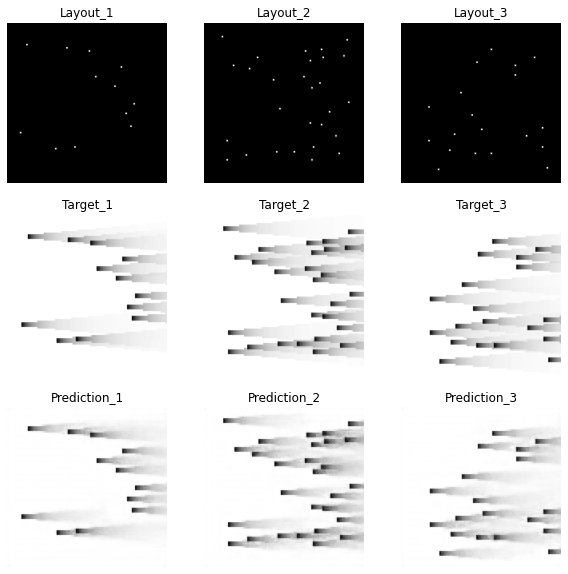

Epoch 299: , Train RMSE: 0.01183588317925774,Validation RMSE: 0.012473724214378286
Epoch 299: , Train loss: 336.2115135192871,Validation loss: 46.678138732910156


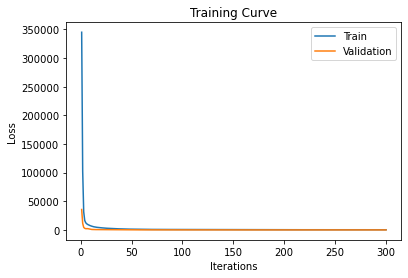

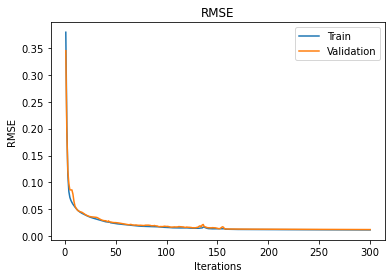

AEP Error on validation data= 4.6050686049961636


In [19]:
AEP_Error=[]
RMSE=[]
for w in [0,0.2,0.4,0.6,0.8,1]:
    print('w=',w)
    device = 'cuda'


   

    args = AttrDict()
    args_dict = {
    "gpu": True,
    "valid": False,
    "plot_LC": True,
    "checkpoint": "",
    "plot": False,
    "visualize": False,
    "downsize_input": False,
    "batch_size":32,
    "test_batch_size":16,
    "learning_rate":3e-3,
    "weight_decay":0.005,
    "epochs":300,
    "ntrain":ntrain,
    "ntest":ntest,
    "nvalid":nvalid,
    "epoch_t":290
    }

    
    args.update(args_dict)
    ConvNet=network_add(Dense_C8,3,100)
    #ConvNet=network_add(Dense_C8_one_layer_Added,7,400)
    cnn,actual_power,Jensen,pre_power = train(args,ConvNet,w)
    #cnn,actual_power,Jensen,pre_power = train(args,ConvNet,w)
    model=cnn
    torch.save(model.state_dict(), './results/w_{}_model.pt'.format(w))
    rmse_test,actual_power_test,Jensen_test,pre_power_test=test_evaluation(model,test_data)
    RMSE.append(rmse_test)
    difference=[]
    zip_object = zip(Jensen_test,pre_power_test)
    for list1_i, list2_i in zip_object:
        difference.append((abs(list1_i-list2_i)/list1_i)*100)
    AEP_Error.append(np.mean(difference))
    print("AEP Error on validation data=",np.mean(difference))
    

In [30]:
RMSE

[0.49101575469038333,
 0.008265650229364457,
 0.008367599481911224,
 0.008795980350404782,
 0.007852778048073581,
 0.008511628966130032]

In [31]:
AEP_Error=np.array([2.633456418553393,
 2.0431948088899086,
 1.6122130813603648,
 1.270581063886542,
 0.6564241585067537,
 0.09462359532011592])
np.save('./results/weighted_loss/AEP_Error3.npy',AEP_Error)
AEP_Error

array([2.63345642, 2.04319481, 1.61221308, 1.27058106, 0.65642416,
       0.0946236 ])

In [32]:
RMSE=np.array([0.008511628966130032,
 0.008265650229364457,
 0.008367599481911224,
 0.008795980350404782,
 0.007852778048073581,
0.49101575469038333])
np.save('./results/weighted_loss/RMSE3.npy',RMSE)
RMSE

array([0.00851163, 0.00826565, 0.0083676 , 0.00879598, 0.00785278,
       0.49101575])

In [26]:
AEP_Error=np.array([1.46164149800041,
 1.2161003635701293,
 1.7655166430070213,
 1.2610911012002244,
 0.6715279447671466,
 5.985408028953285])
np.save('./results/weighted_loss/AEP_Error3.npy',AEP_Error)
AEP_Error

array([1.4616415 , 1.21610036, 1.76551664, 1.2610911 , 0.67152794,
       5.98540803])

In [27]:
RMSE=np.array([ 0.010147816134629464,
 0.011057985350809497,
 0.008445326201374562,
 0.008120836022345417,
 0.007682187733782298,
 0.44974958310152996])
np.save('./results/weighted_loss/RMSE3.npy',RMSE)
RMSE

array([0.01014782, 0.01105799, 0.00844533, 0.00812084, 0.00768219,
       0.44974958])

In [33]:
result_df = pd.DataFrame()
for i in [1,2,3]:
    w=[0,0.2,0.4,0.6,0.8,1]
    RMSE=np.load('./results/weighted_loss/RMSE{}.npy'.format(i))
    AEP=np.load('./results/weighted_loss/AEP_Error{}.npy'.format(i))
    df = pd.DataFrame(np.column_stack([w,RMSE,AEP]),columns=['w', 'RMSE','AEP'])
    result_df = pd.concat([result_df, df], axis=0)

In [35]:
result_df.to_csv('./results/weighted_loss/RMSE_AEP.csv', index=False)
result_df

,w,RMSE,AEP
0,0.0,0.008744,2.768831
1,0.2,0.011208,1.978134
2,0.4,0.009107,2.175567
3,0.6,0.009307,1.675507
4,0.8,0.008692,0.993491
5,1.0,0.447780,0.095716
0,0.0,0.010148,1.461641
1,0.2,0.011058,1.216100
2,0.4,0.008445,1.765517
3,0.6,0.008121,1.261091


The best model with a weighted loss function

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 4, 200, 200]             144
       BatchNorm2d-2          [-1, 4, 200, 200]               8
              ReLU-3          [-1, 4, 200, 200]               0
            Conv2d-4         [-1, 10, 200, 200]           1,960
        conv_layer-5         [-1, 14, 200, 200]               0
       BatchNorm2d-6         [-1, 14, 200, 200]              28
              ReLU-7         [-1, 14, 200, 200]               0
            Conv2d-8         [-1, 10, 200, 200]           6,860
        conv_layer-9         [-1, 24, 200, 200]               0
      Dense_block-10         [-1, 24, 200, 200]               0
      BatchNorm2d-11         [-1, 24, 200, 200]              48
             ReLU-12         [-1, 24, 200, 200]               0
           Conv2d-13         [-1, 12, 200, 200]             288
      BatchNorm2d-14         [-1, 12, 2

Epoch 0: , Train RMSE: 0.398492117375836,Validation RMSE: 0.38437547425444996
Epoch 0: , Train loss: 6097765.15625,Validation loss: 709173.625


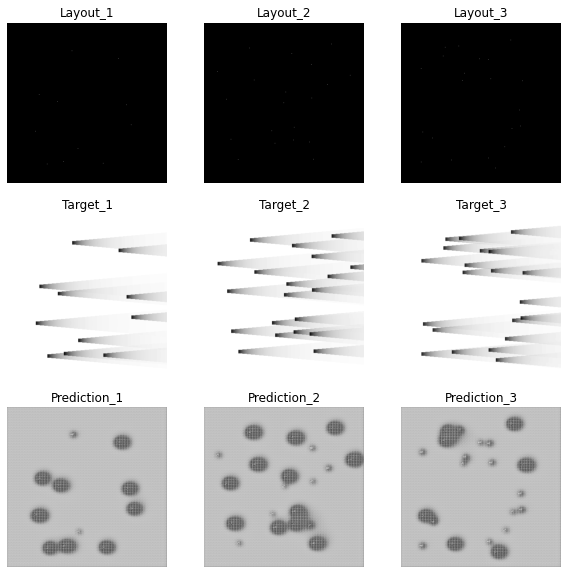

Epoch 1: , Train RMSE: 0.21511282605590146,Validation RMSE: 0.26609920906026757
Epoch 1: , Train loss: 1776903.47265625,Validation loss: 339882.1875


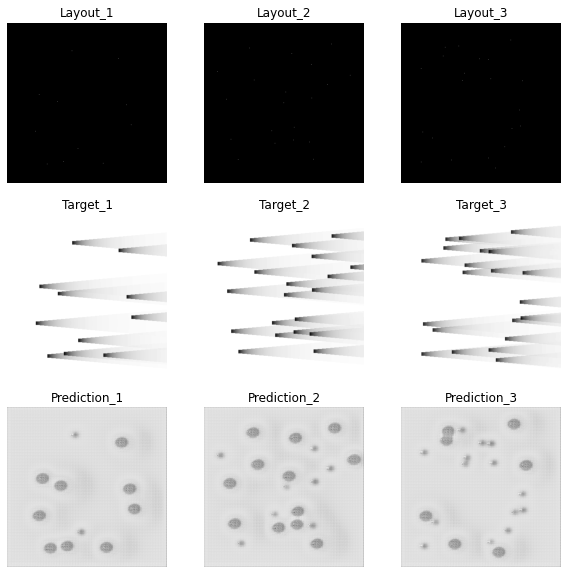

Epoch 2: , Train RMSE: 0.12575473848772414,Validation RMSE: 0.11469912236750114
Epoch 2: , Train loss: 607267.36328125,Validation loss: 63148.265625


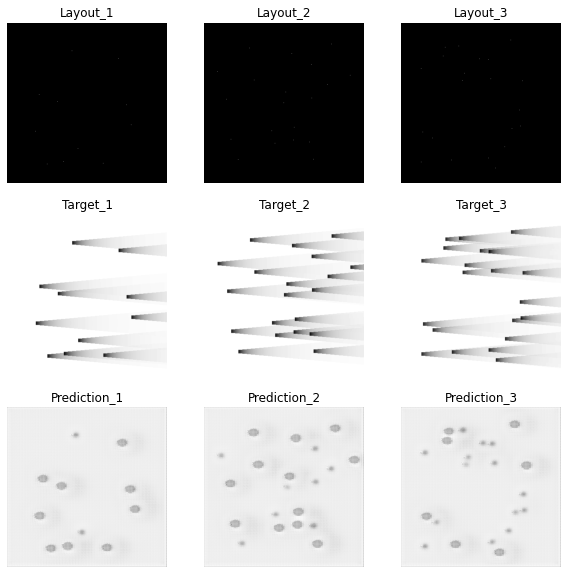

Epoch 3: , Train RMSE: 0.09393268658659241,Validation RMSE: 0.08649196603617057
Epoch 3: , Train loss: 338816.625,Validation loss: 35908.12890625


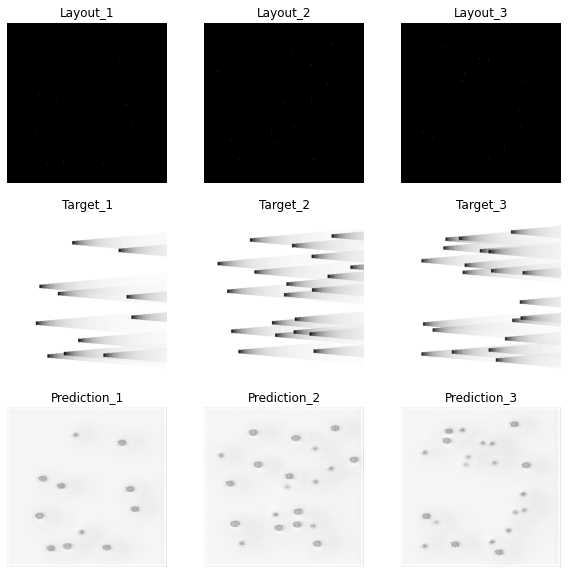

Epoch 4: , Train RMSE: 0.0786259091501077,Validation RMSE: 0.08535277876231047
Epoch 4: , Train loss: 237390.08984375,Validation loss: 34968.46484375


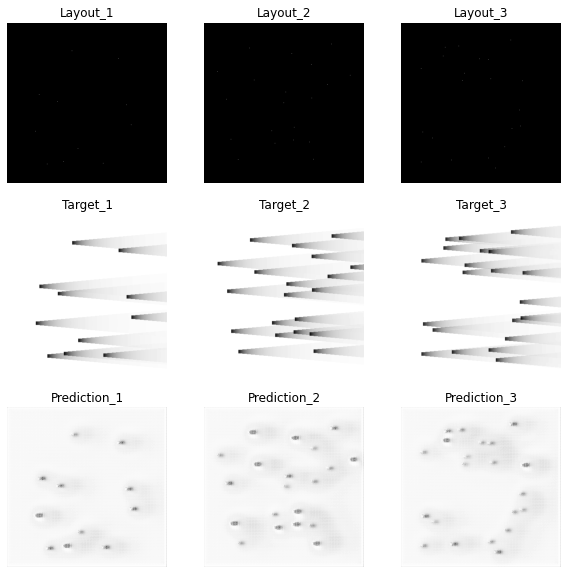

Epoch 5: , Train RMSE: 0.06618691431350138,Validation RMSE: 0.08715340815329241
Epoch 5: , Train loss: 168219.1728515625,Validation loss: 36459.439453125


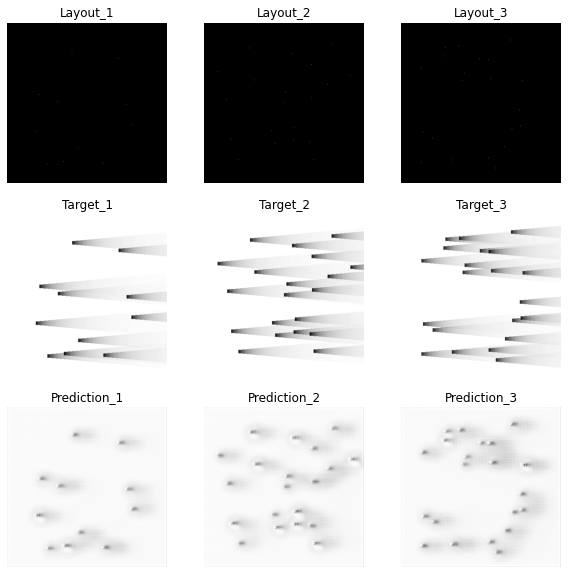

Epoch 6: , Train RMSE: 0.05560515123193358,Validation RMSE: 0.08699921332109609
Epoch 6: , Train loss: 118730.22119140625,Validation loss: 36330.54296875


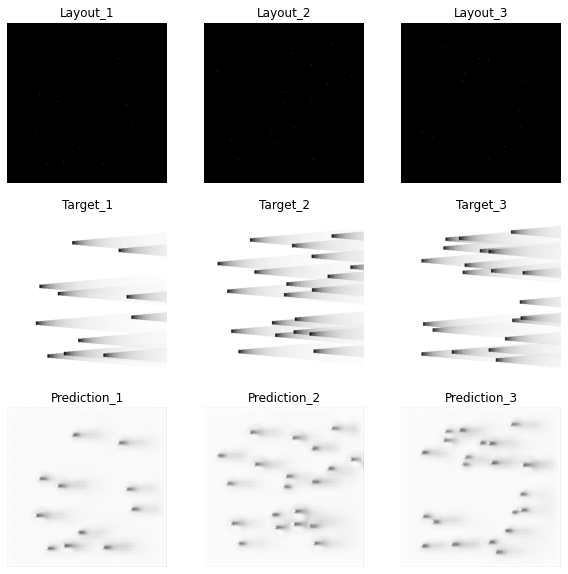

Epoch 7: , Train RMSE: 0.047932970452206174,Validation RMSE: 0.08422460554782966
Epoch 7: , Train loss: 88226.6748046875,Validation loss: 34050.1640625


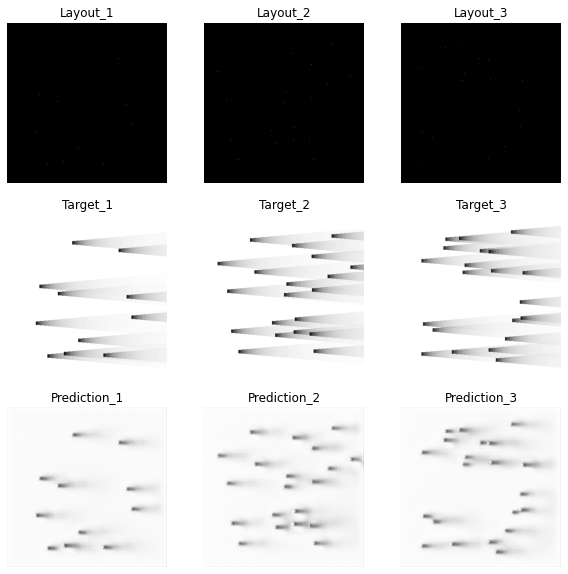

Epoch 8: , Train RMSE: 0.042639370700517674,Validation RMSE: 0.07619549179825276
Epoch 8: , Train loss: 69815.65185546875,Validation loss: 27867.6142578125


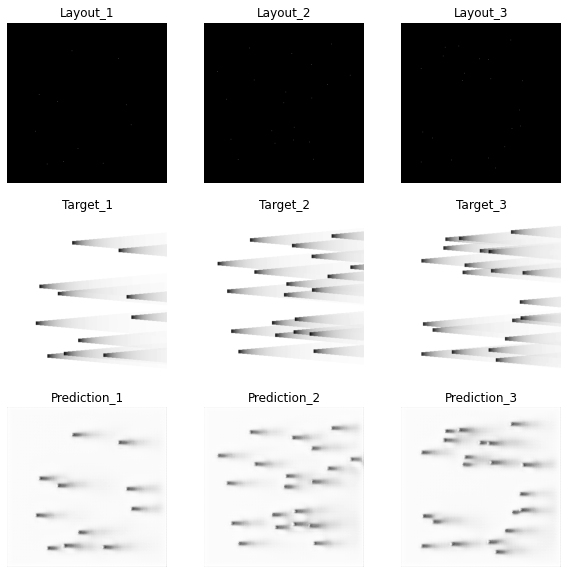

Epoch 9: , Train RMSE: 0.039191122225311396,Validation RMSE: 0.0609165111423217
Epoch 9: , Train loss: 58980.251953125,Validation loss: 17811.9423828125


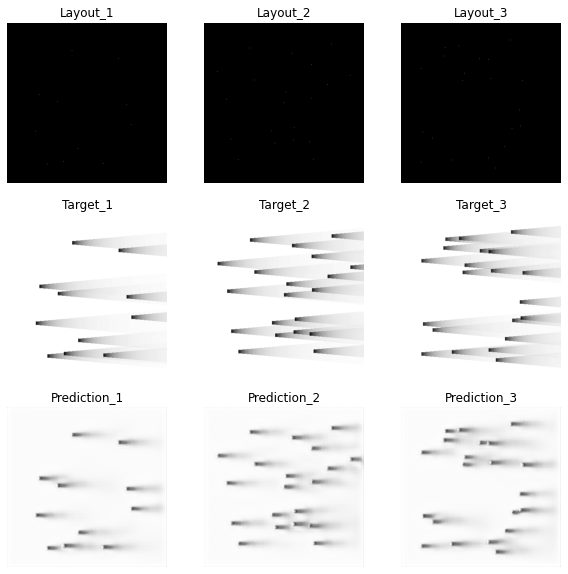

Epoch 10: , Train RMSE: 0.0368629668694208,Validation RMSE: 0.043606960177378314
Epoch 10: , Train loss: 52180.927734375,Validation loss: 9127.521484375


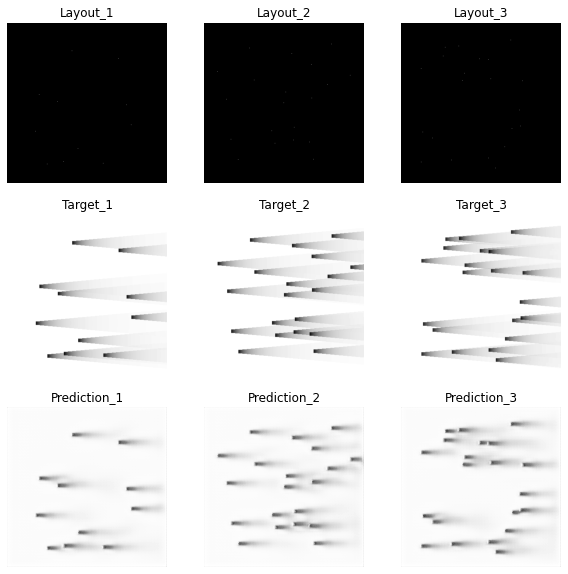

Epoch 11: , Train RMSE: 0.035032680149927754,Validation RMSE: 0.037777130146334555
Epoch 11: , Train loss: 47127.88525390625,Validation loss: 6850.135498046875


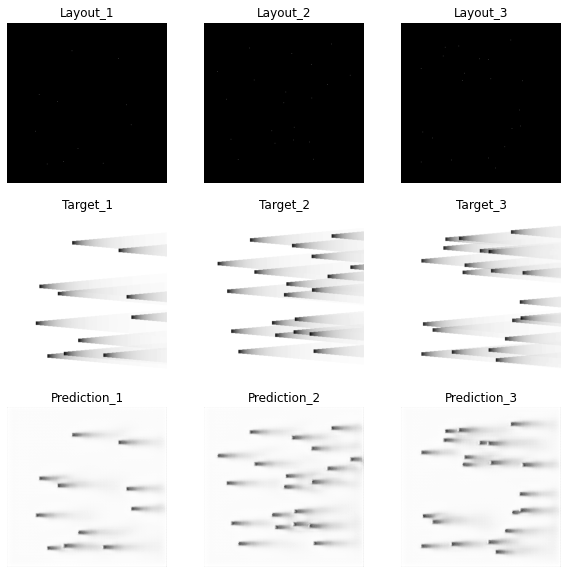

Epoch 12: , Train RMSE: 0.03340252463037092,Validation RMSE: 0.03427133917314442
Epoch 12: , Train loss: 42843.980224609375,Validation loss: 5637.718505859375


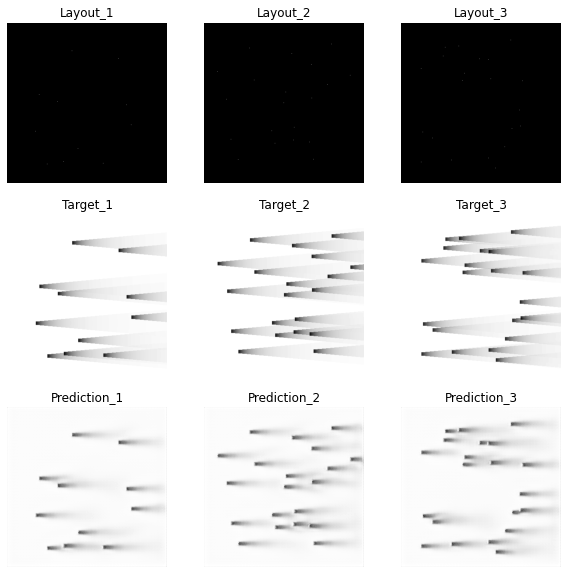

Epoch 13: , Train RMSE: 0.03200685324398051,Validation RMSE: 0.03258048084257802
Epoch 13: , Train loss: 39338.4443359375,Validation loss: 5095.14111328125


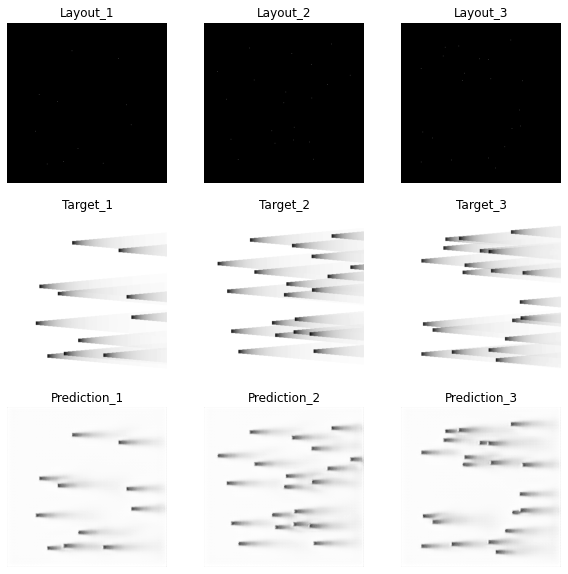

Epoch 14: , Train RMSE: 0.03074054072169027,Validation RMSE: 0.03094914915099562
Epoch 14: , Train loss: 36287.264404296875,Validation loss: 4597.67919921875


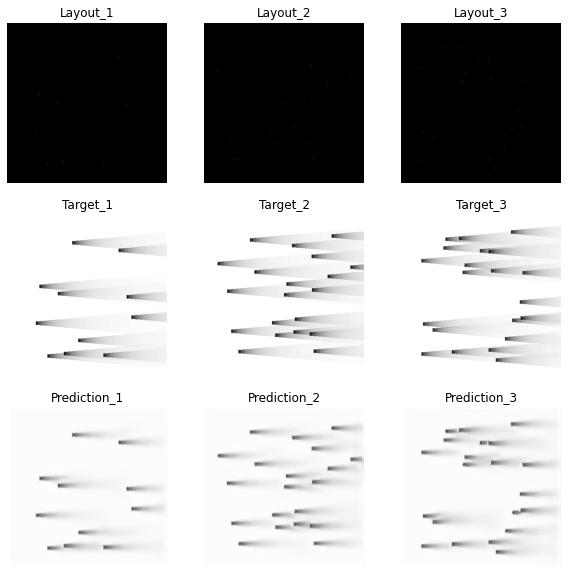

Epoch 15: , Train RMSE: 0.029639514355990243,Validation RMSE: 0.02981279839260392
Epoch 15: , Train loss: 33734.43115234375,Validation loss: 4266.254150390625


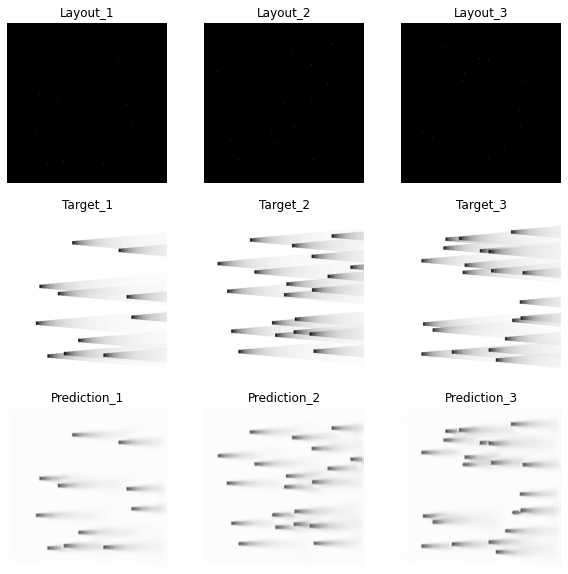

Epoch 16: , Train RMSE: 0.028633455651776576,Validation RMSE: 0.028743716230467318
Epoch 16: , Train loss: 31483.191650390625,Validation loss: 3965.765869140625


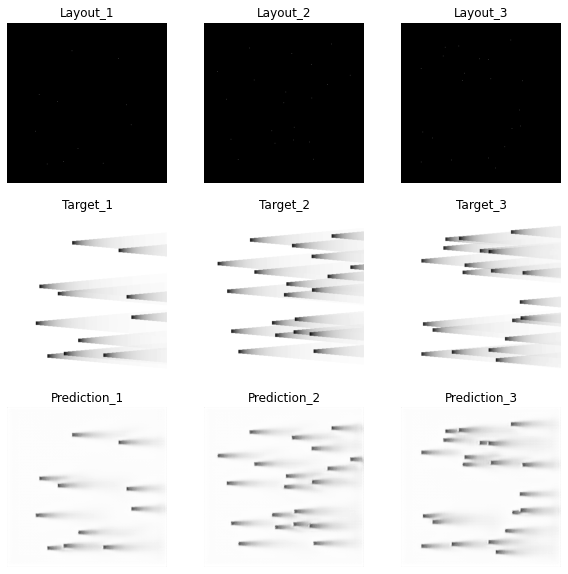

Epoch 17: , Train RMSE: 0.027788235141297954,Validation RMSE: 0.027943008824155104
Epoch 17: , Train loss: 29651.94287109375,Validation loss: 3747.8963623046875


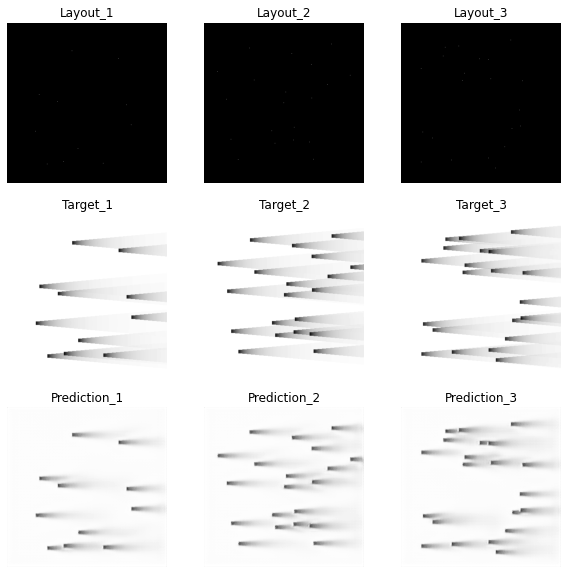

Epoch 18: , Train RMSE: 0.027084404987749795,Validation RMSE: 0.027273126803467565
Epoch 18: , Train loss: 28168.895751953125,Validation loss: 3570.3525390625


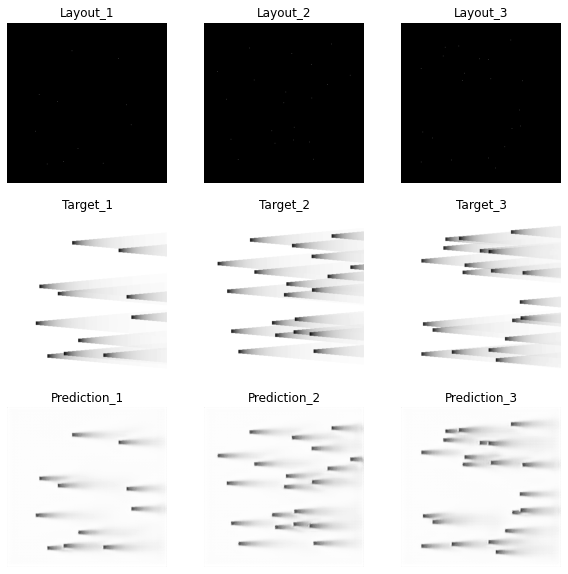

Epoch 19: , Train RMSE: 0.02649282663051168,Validation RMSE: 0.02675195153268807
Epoch 19: , Train loss: 26951.802734375,Validation loss: 3435.201171875


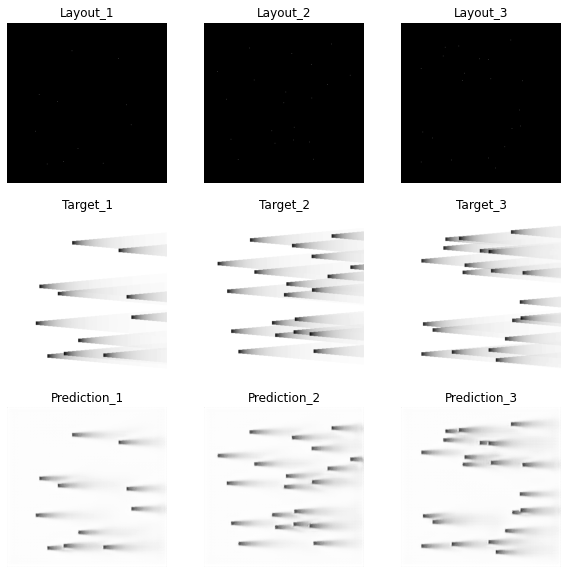

Epoch 20: , Train RMSE: 0.025977362828366577,Validation RMSE: 0.026269969307840767
Epoch 20: , Train loss: 25913.2177734375,Validation loss: 3312.5341796875


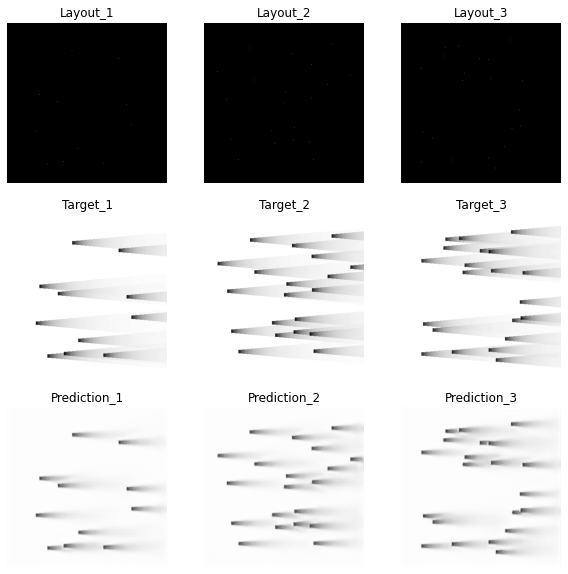

Epoch 21: , Train RMSE: 0.025509425347411803,Validation RMSE: 0.025791993894540018
Epoch 21: , Train loss: 24988.06201171875,Validation loss: 3193.08935546875


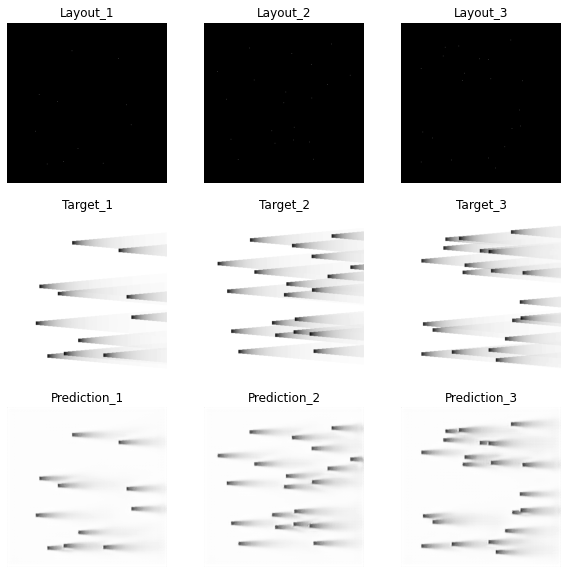

Epoch 22: , Train RMSE: 0.025065050561360425,Validation RMSE: 0.02528832154459779
Epoch 22: , Train loss: 24125.0595703125,Validation loss: 3069.59619140625


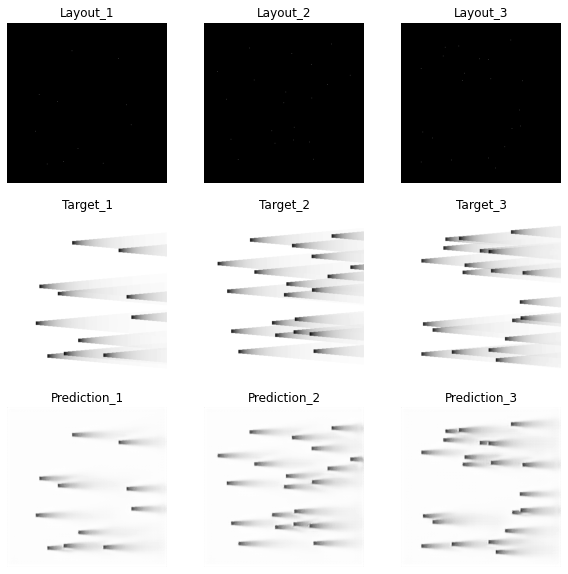

Epoch 23: , Train RMSE: 0.02463142961709063,Validation RMSE: 0.024775997905733985
Epoch 23: , Train loss: 23297.561279296875,Validation loss: 2946.4803466796875


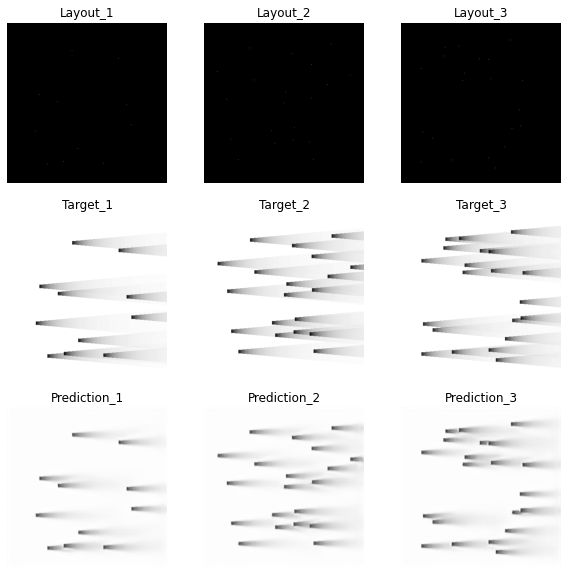

Epoch 24: , Train RMSE: 0.024206262991307723,Validation RMSE: 0.024302332879420477
Epoch 24: , Train loss: 22500.217651367188,Validation loss: 2834.896240234375


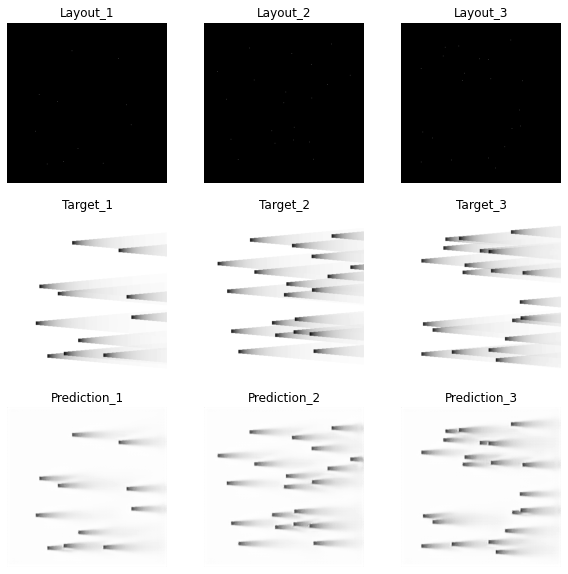

Epoch 25: , Train RMSE: 0.023791624235080844,Validation RMSE: 0.023890782756796014
Epoch 25: , Train loss: 21735.989135742188,Validation loss: 2739.693603515625


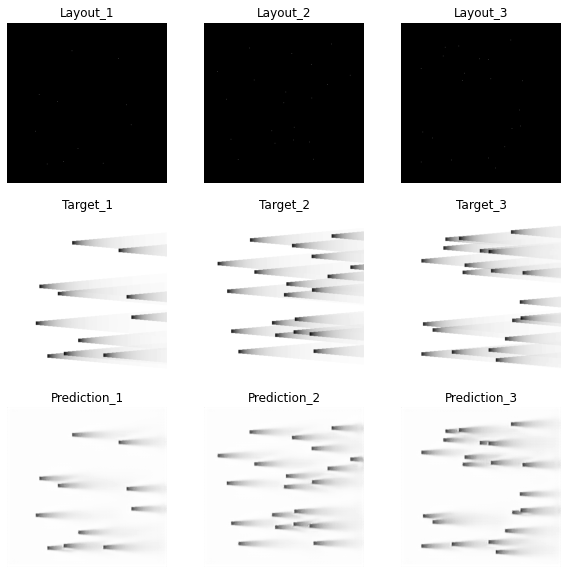

Epoch 26: , Train RMSE: 0.023397979375210445,Validation RMSE: 0.023499501324496228
Epoch 26: , Train loss: 21022.6728515625,Validation loss: 2650.6875


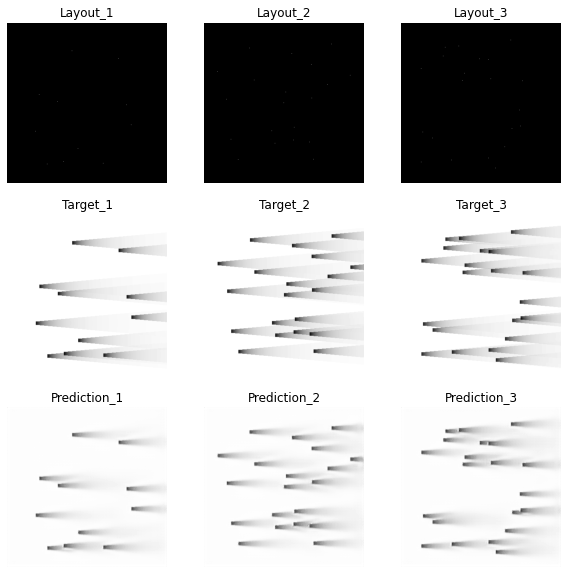

Epoch 27: , Train RMSE: 0.02302727934979597,Validation RMSE: 0.023125775848295598
Epoch 27: , Train loss: 20361.814819335938,Validation loss: 2567.0472412109375


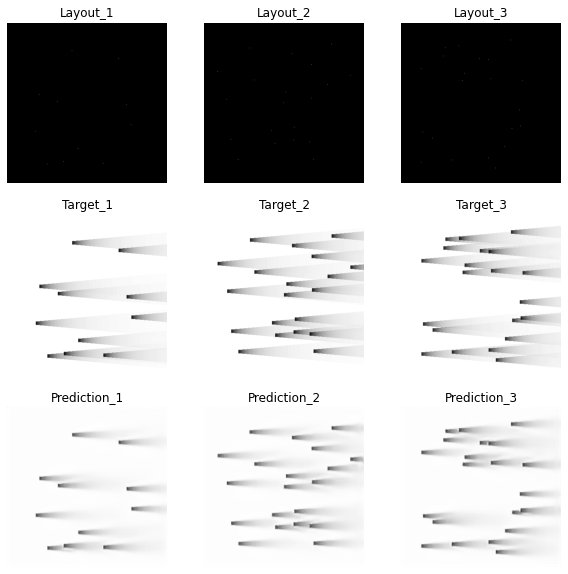

Epoch 28: , Train RMSE: 0.02267914765937883,Validation RMSE: 0.022778385660800777
Epoch 28: , Train loss: 19750.799560546875,Validation loss: 2490.5032958984375


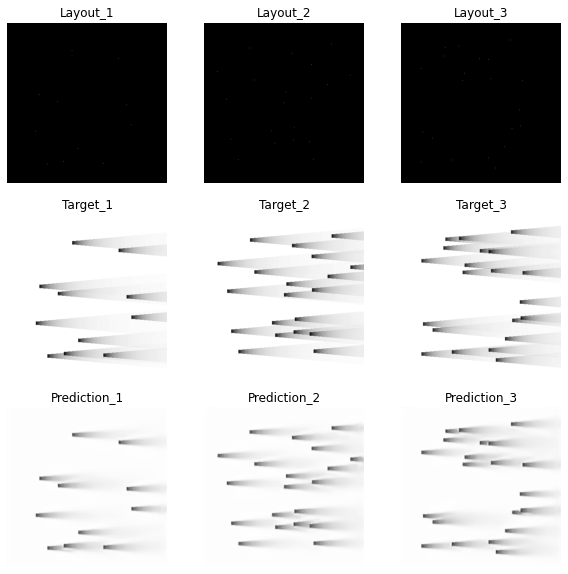

Epoch 29: , Train RMSE: 0.022352200846227303,Validation RMSE: 0.022463533590910714
Epoch 29: , Train loss: 19185.44189453125,Validation loss: 2422.129638671875


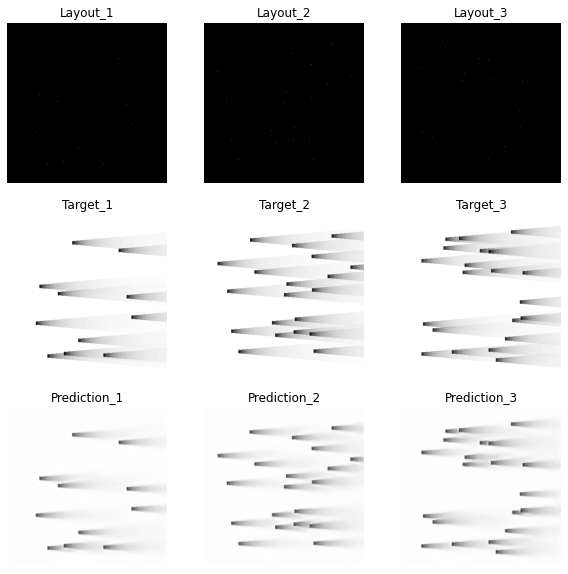

Epoch 30: , Train RMSE: 0.022045595805589405,Validation RMSE: 0.022161550328160508
Epoch 30: , Train loss: 18662.718505859375,Validation loss: 2357.4447021484375


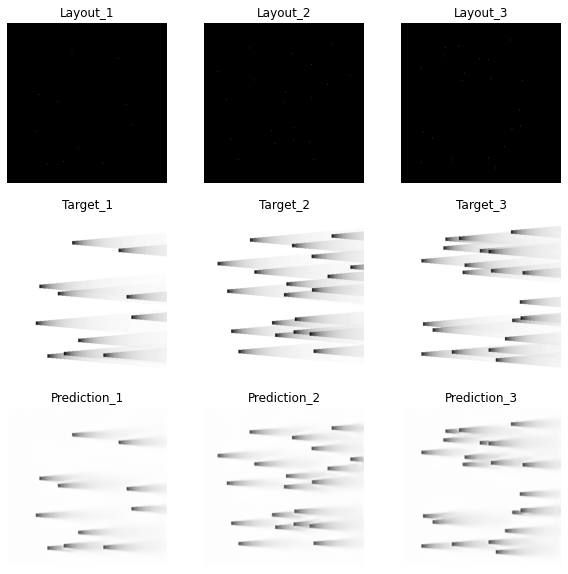

Epoch 31: , Train RMSE: 0.02176204488191831,Validation RMSE: 0.02187957483319054
Epoch 31: , Train loss: 18185.725341796875,Validation loss: 2297.8358154296875


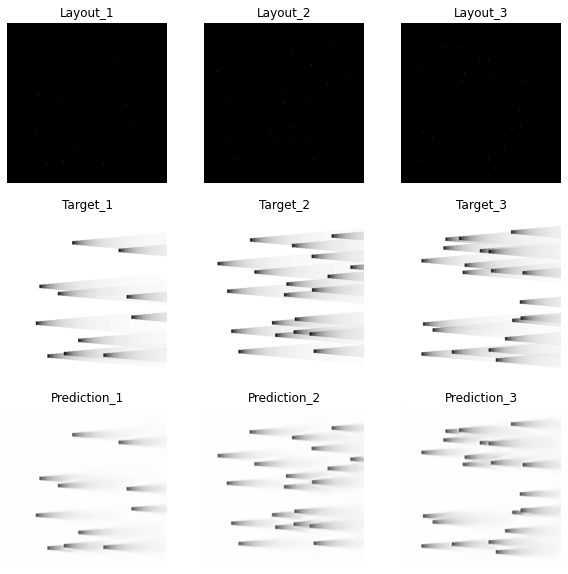

Epoch 32: , Train RMSE: 0.021500036609234063,Validation RMSE: 0.021606174043435997
Epoch 32: , Train loss: 17750.46044921875,Validation loss: 2240.7684326171875


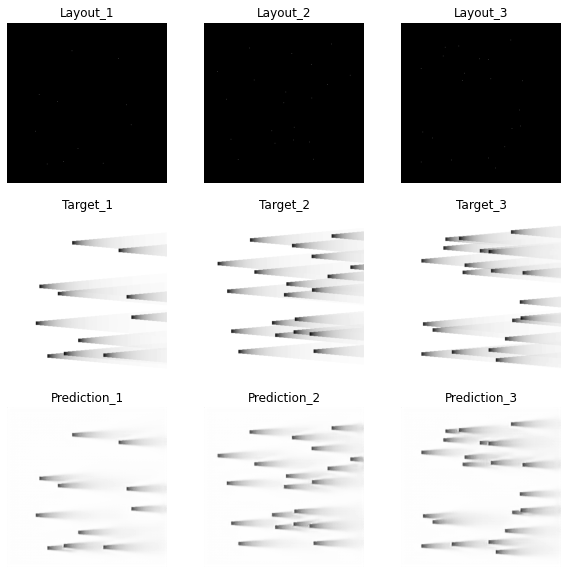

Epoch 33: , Train RMSE: 0.021251036076438787,Validation RMSE: 0.0213282209866964
Epoch 33: , Train loss: 17341.69091796875,Validation loss: 2183.4864501953125


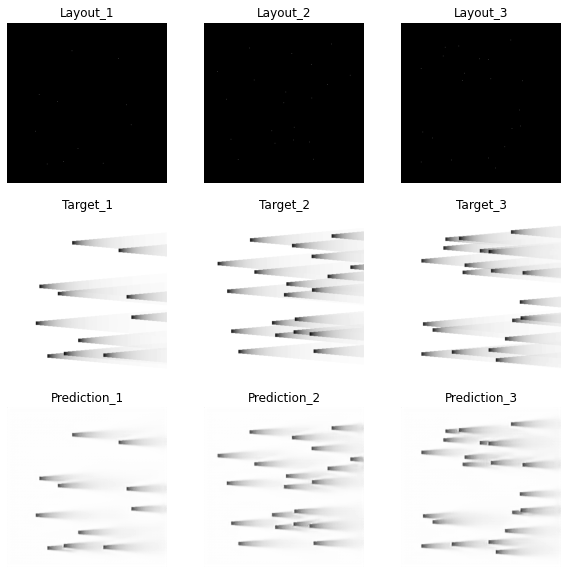

Epoch 34: , Train RMSE: 0.021007633093553385,Validation RMSE: 0.02105018589303156
Epoch 34: , Train loss: 16946.712890625,Validation loss: 2126.9295654296875


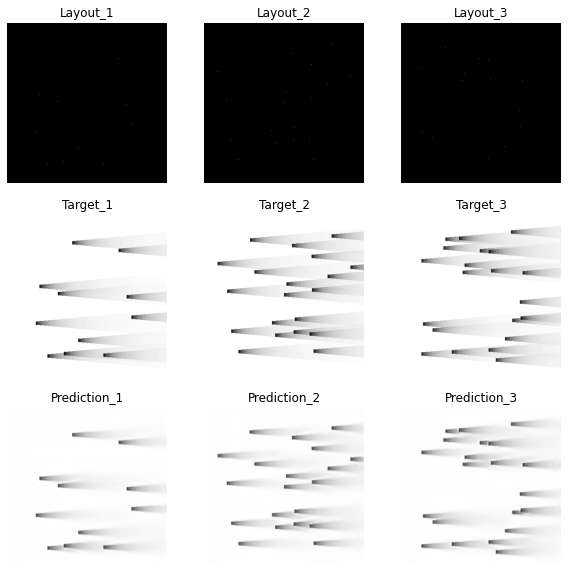

Epoch 35: , Train RMSE: 0.020763648971254572,Validation RMSE: 0.020752509030544368
Epoch 35: , Train loss: 16555.358154296875,Validation loss: 2067.1998291015625


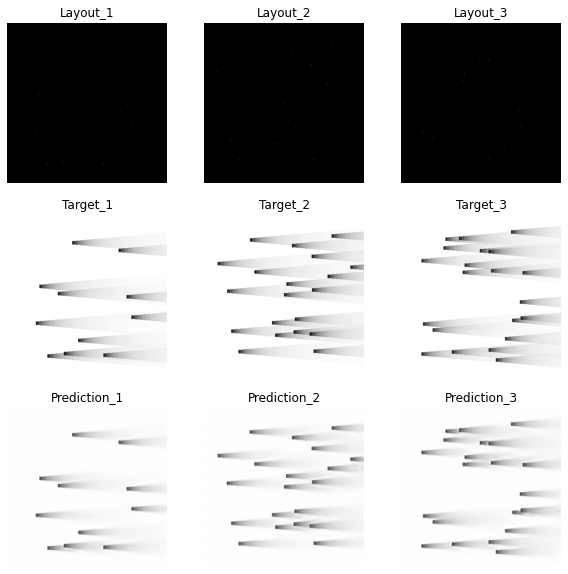

Epoch 36: , Train RMSE: 0.020517130509604516,Validation RMSE: 0.02046829557035713
Epoch 36: , Train loss: 16164.58154296875,Validation loss: 2010.9653930664062


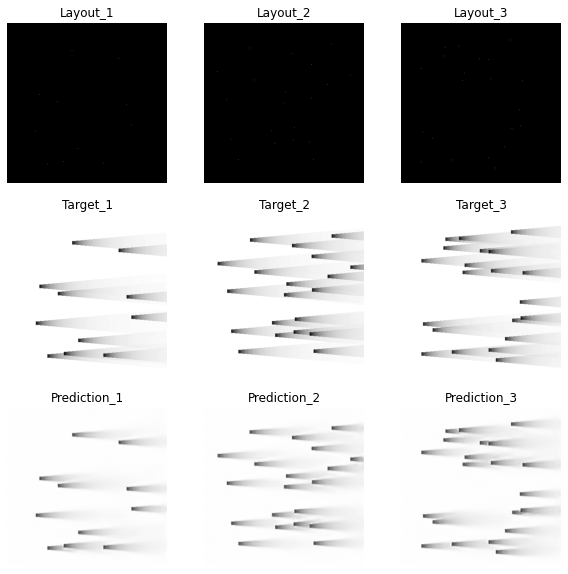

Epoch 37: , Train RMSE: 0.020277183857875712,Validation RMSE: 0.020210968265281473
Epoch 37: , Train loss: 15788.704711914062,Validation loss: 1960.7195434570312


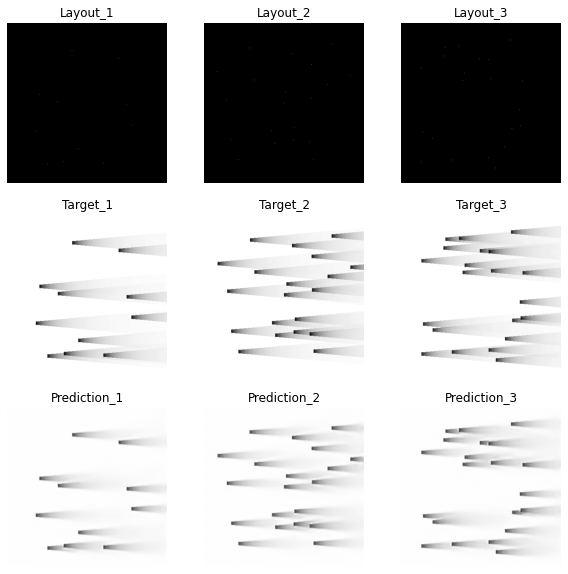

Epoch 38: , Train RMSE: 0.020047694478142784,Validation RMSE: 0.019970667309717274
Epoch 38: , Train loss: 15433.346069335938,Validation loss: 1914.3722534179688


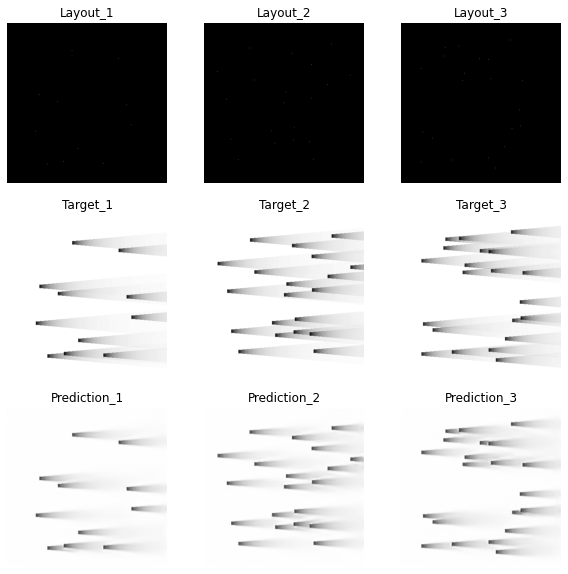

Epoch 39: , Train RMSE: 0.019831494729653645,Validation RMSE: 0.0197816378699549
Epoch 39: , Train loss: 15102.266235351562,Validation loss: 1878.3033447265625


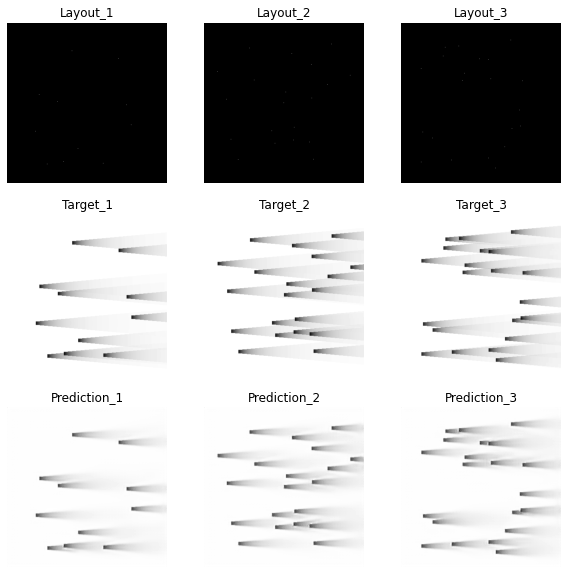

Epoch 40: , Train RMSE: 0.01963681821264844,Validation RMSE: 0.019578643020713975
Epoch 40: , Train loss: 14807.2177734375,Validation loss: 1839.95166015625


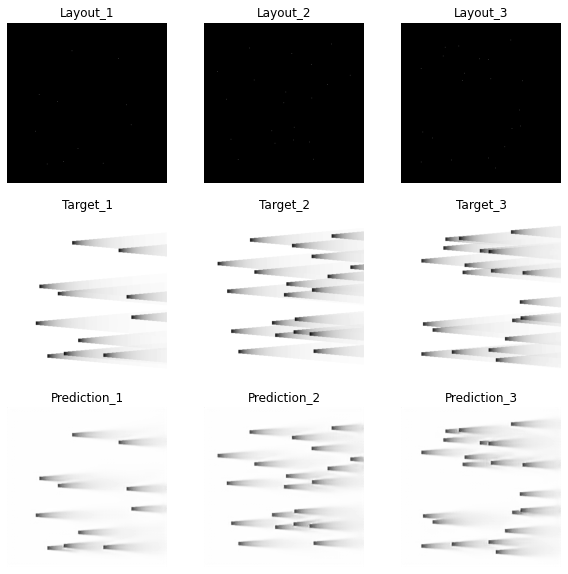

Epoch 41: , Train RMSE: 0.01945590994840307,Validation RMSE: 0.019433582299515053
Epoch 41: , Train loss: 14535.645385742188,Validation loss: 1812.7877807617188


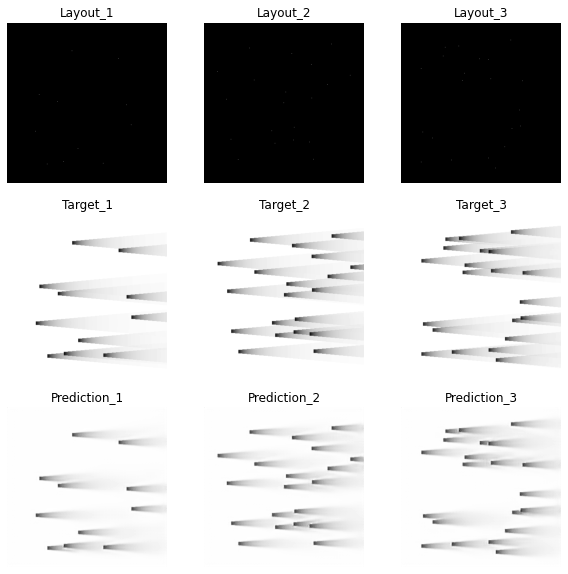

Epoch 42: , Train RMSE: 0.019292097851718037,Validation RMSE: 0.019258053832898765
Epoch 42: , Train loss: 14291.905517578125,Validation loss: 1780.1886596679688


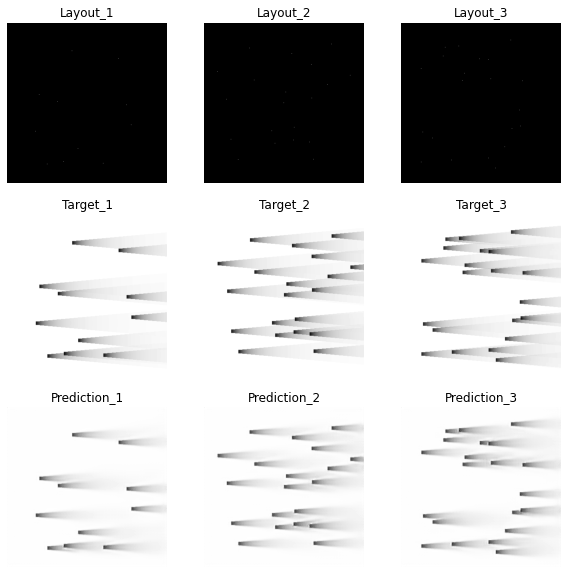

Epoch 43: , Train RMSE: 0.01913464162299057,Validation RMSE: 0.01915539097480455
Epoch 43: , Train loss: 14059.565185546875,Validation loss: 1761.2592163085938


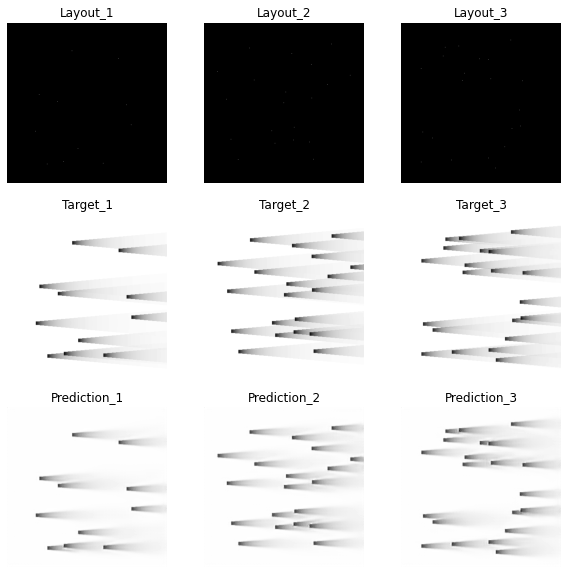

Epoch 44: , Train RMSE: 0.0189913221920833,Validation RMSE: 0.019007314712856924
Epoch 44: , Train loss: 13849.740234375,Validation loss: 1734.1344604492188


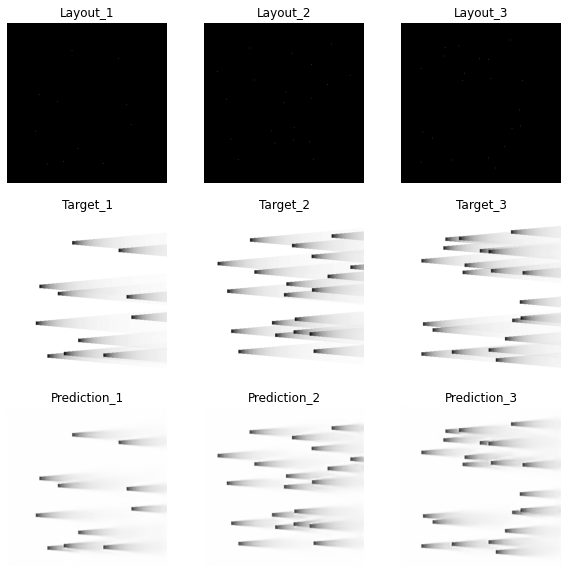

Epoch 45: , Train RMSE: 0.018835809218567,Validation RMSE: 0.018870081245909186
Epoch 45: , Train loss: 13623.848022460938,Validation loss: 1709.183837890625


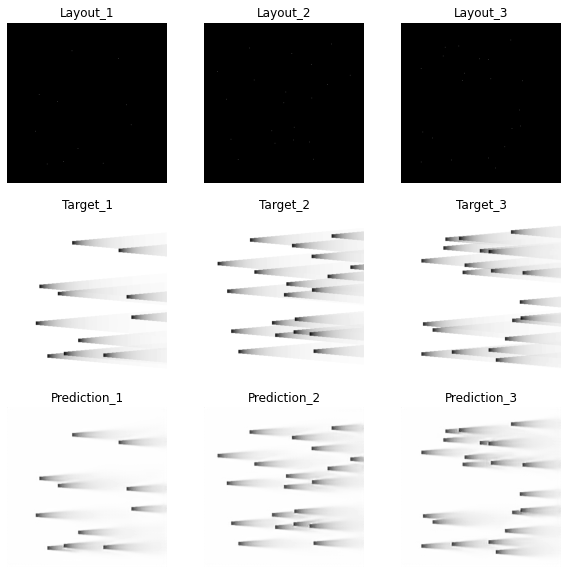

Epoch 46: , Train RMSE: 0.01868333528140373,Validation RMSE: 0.01862986893131865
Epoch 46: , Train loss: 13404.173461914062,Validation loss: 1665.9456787109375


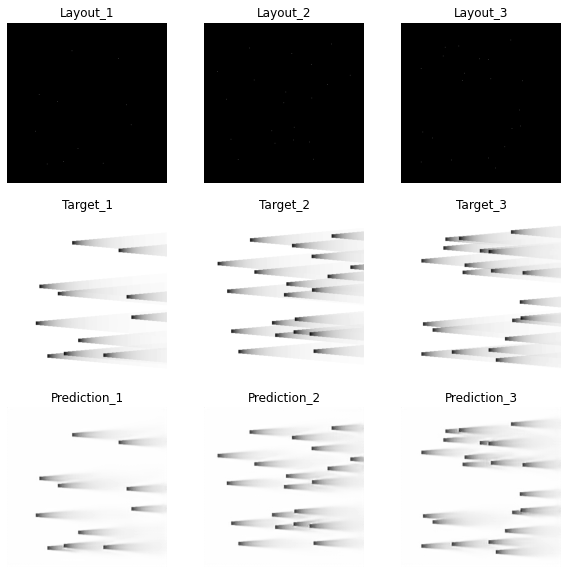

Epoch 47: , Train RMSE: 0.018514337637097967,Validation RMSE: 0.018560844647272447
Epoch 47: , Train loss: 13162.77880859375,Validation loss: 1653.623779296875


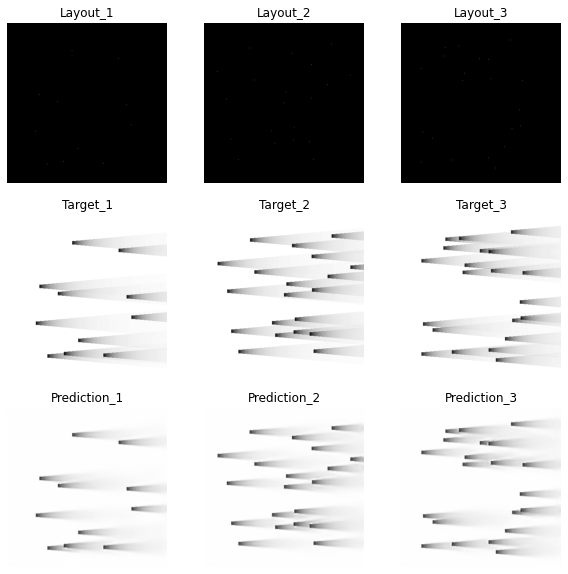

Epoch 48: , Train RMSE: 0.018380214945906453,Validation RMSE: 0.01848153101415345
Epoch 48: , Train loss: 12972.760375976562,Validation loss: 1639.5215454101562


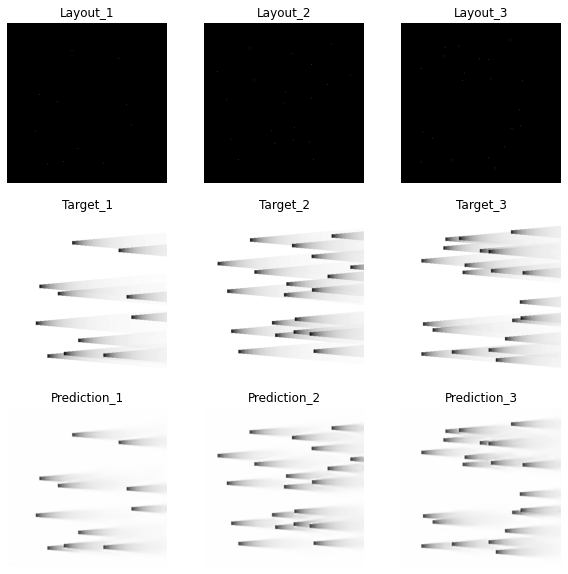

Epoch 49: , Train RMSE: 0.018234833830067677,Validation RMSE: 0.018259582024616677
Epoch 49: , Train loss: 12768.351928710938,Validation loss: 1600.3792114257812


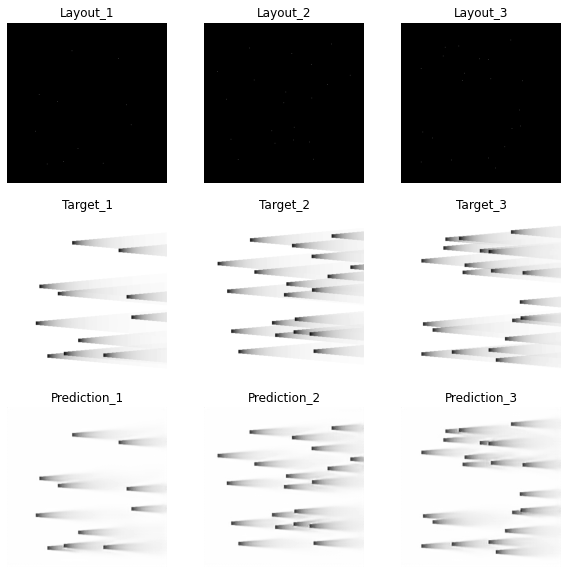

Epoch 50: , Train RMSE: 0.018095356827599725,Validation RMSE: 0.018192095862984585
Epoch 50: , Train loss: 12573.770446777344,Validation loss: 1588.5712890625


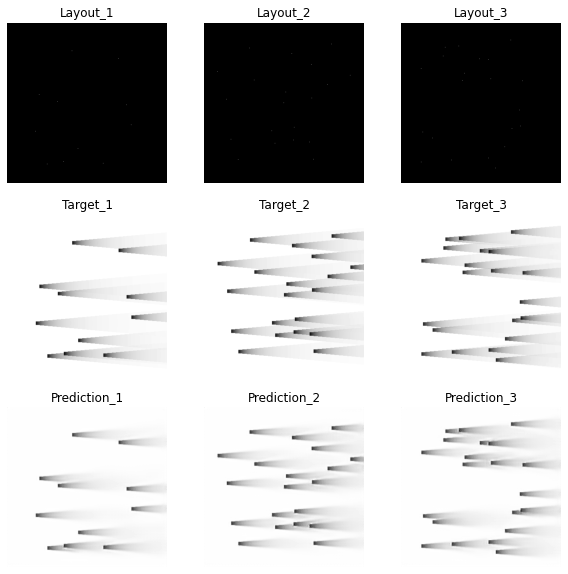

Epoch 51: , Train RMSE: 0.01798355213782856,Validation RMSE: 0.018102534259675392
Epoch 51: , Train loss: 12418.872863769531,Validation loss: 1572.9683837890625


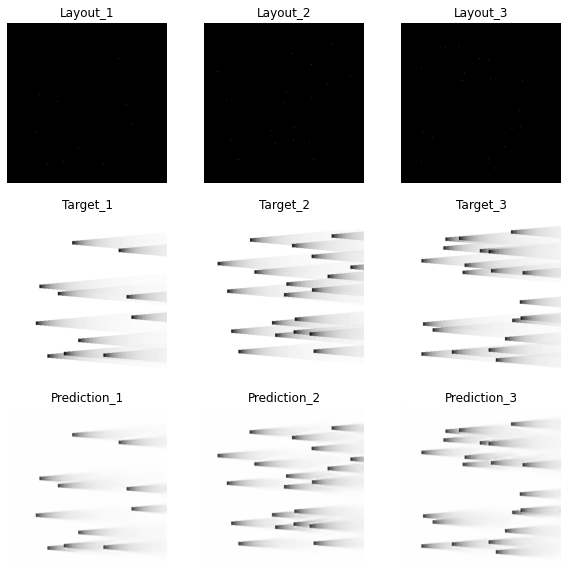

Epoch 52: , Train RMSE: 0.01784260887688251,Validation RMSE: 0.017857529147375036
Epoch 52: , Train loss: 12224.973754882812,Validation loss: 1530.678466796875


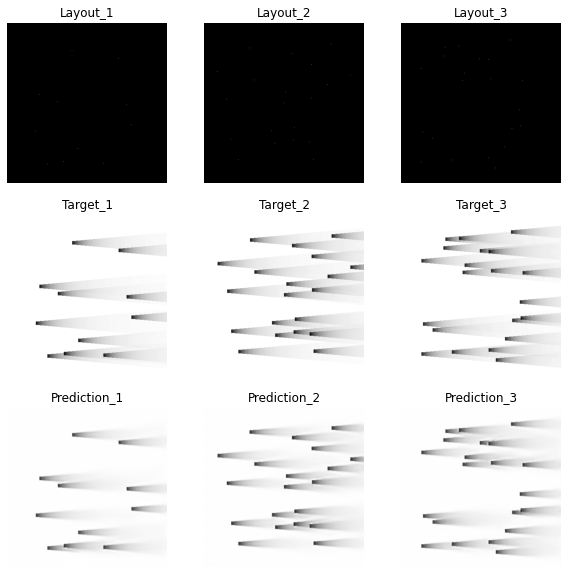

Epoch 53: , Train RMSE: 0.017700715150412404,Validation RMSE: 0.01776968288238136
Epoch 53: , Train loss: 12031.308166503906,Validation loss: 1515.6558227539062


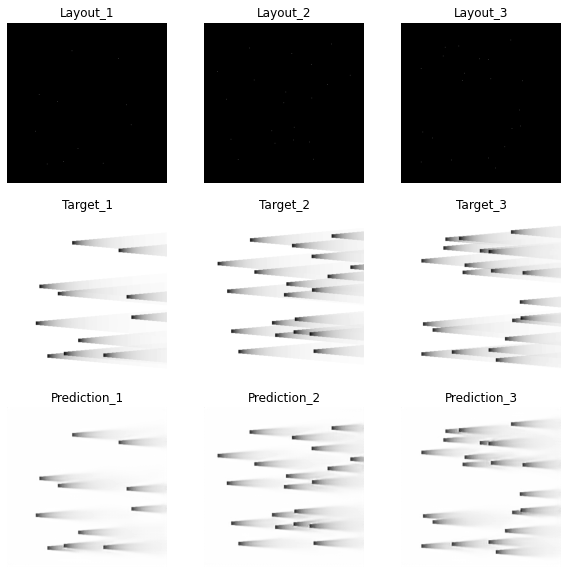

Epoch 54: , Train RMSE: 0.017586434532269477,Validation RMSE: 0.01768855934879767
Epoch 54: , Train loss: 11876.454895019531,Validation loss: 1501.8486328125


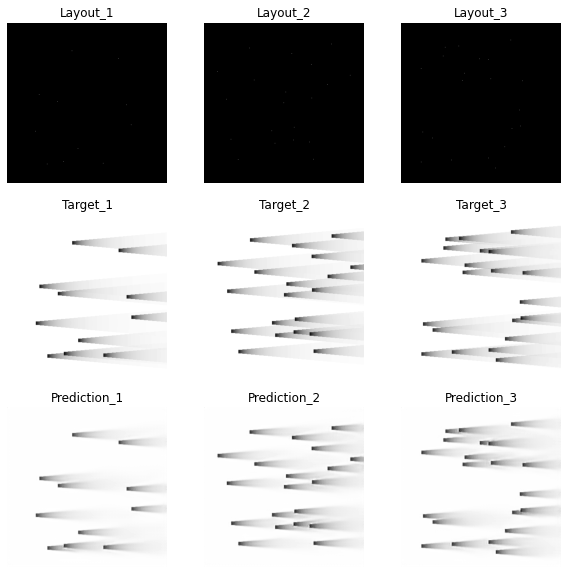

Epoch 55: , Train RMSE: 0.017453835268290217,Validation RMSE: 0.01744812643200243
Epoch 55: , Train loss: 11698.036437988281,Validation loss: 1461.2981567382812


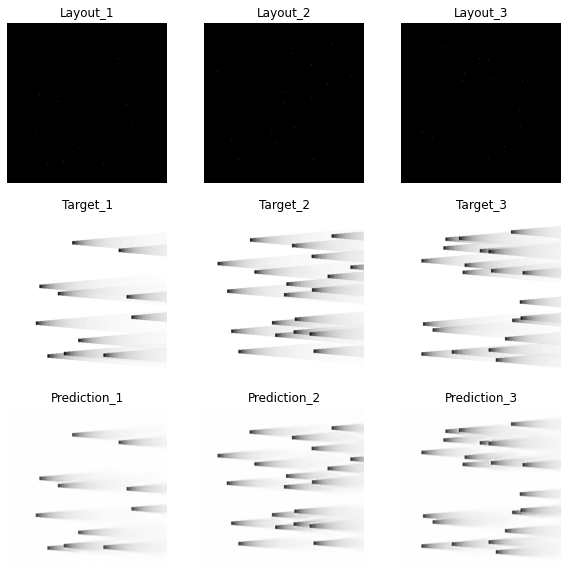

Epoch 56: , Train RMSE: 0.01731211896676738,Validation RMSE: 0.017399712714385014
Epoch 56: , Train loss: 11508.843383789062,Validation loss: 1453.2000122070312


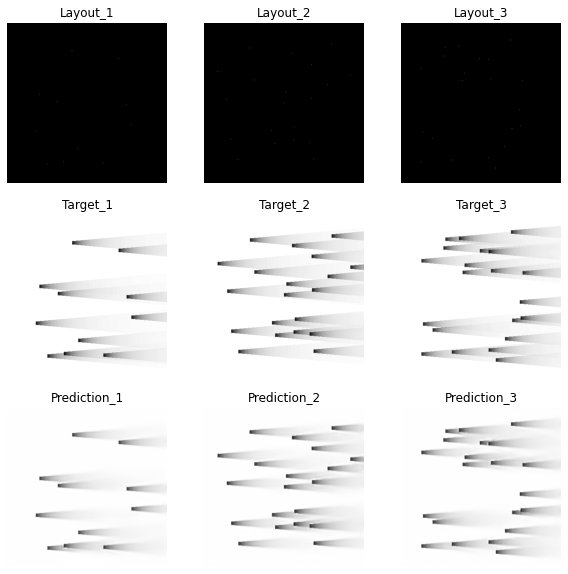

Epoch 57: , Train RMSE: 0.017201943865427786,Validation RMSE: 0.01726121922777558
Epoch 57: , Train loss: 11362.823913574219,Validation loss: 1430.1585083007812


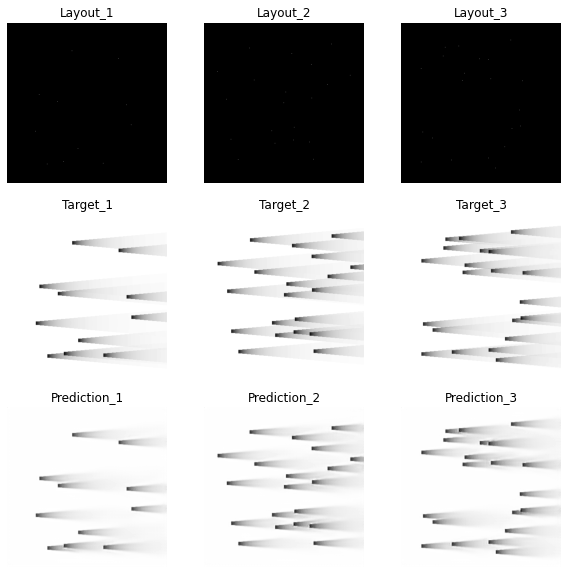

Epoch 58: , Train RMSE: 0.01708918981263746,Validation RMSE: 0.017093870805293718
Epoch 58: , Train loss: 11214.351684570312,Validation loss: 1402.56201171875


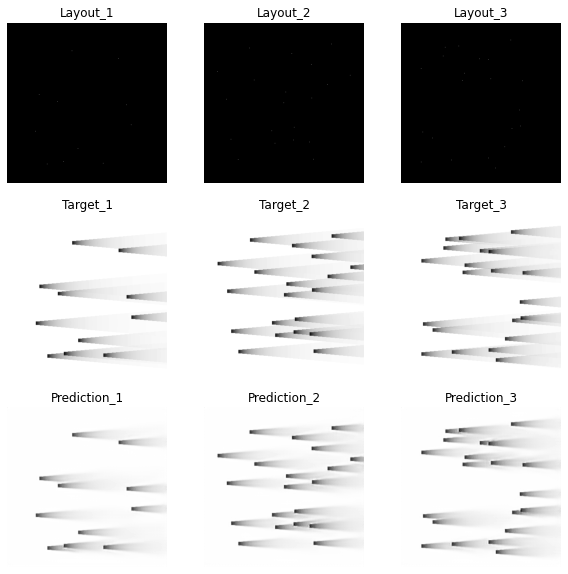

Epoch 59: , Train RMSE: 0.016962919391497147,Validation RMSE: 0.016989167371094245
Epoch 59: , Train loss: 11049.240356445312,Validation loss: 1385.4326782226562


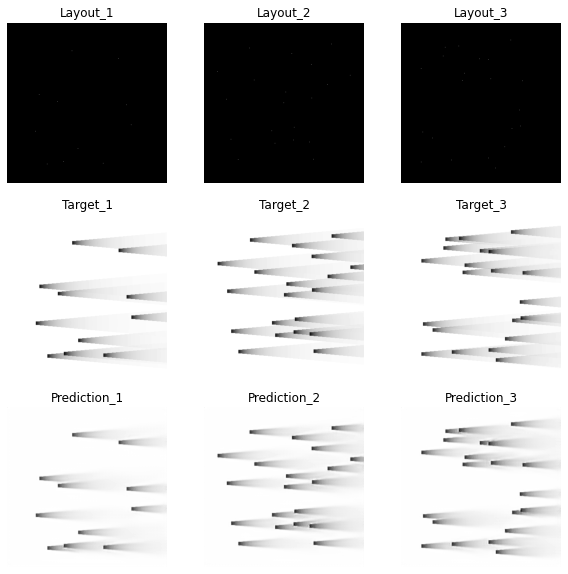

Epoch 60: , Train RMSE: 0.016845074622182477,Validation RMSE: 0.016836269814972438
Epoch 60: , Train loss: 10896.251098632812,Validation loss: 1360.60791015625


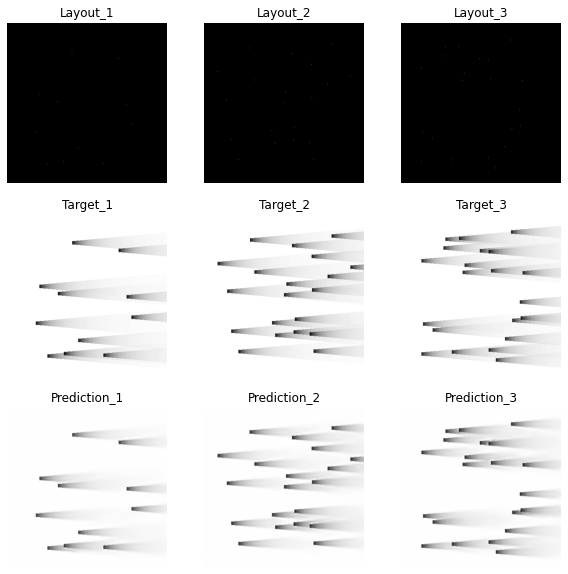

Epoch 61: , Train RMSE: 0.016713485126473034,Validation RMSE: 0.016686994490187856
Epoch 61: , Train loss: 10726.678466796875,Validation loss: 1336.5877685546875


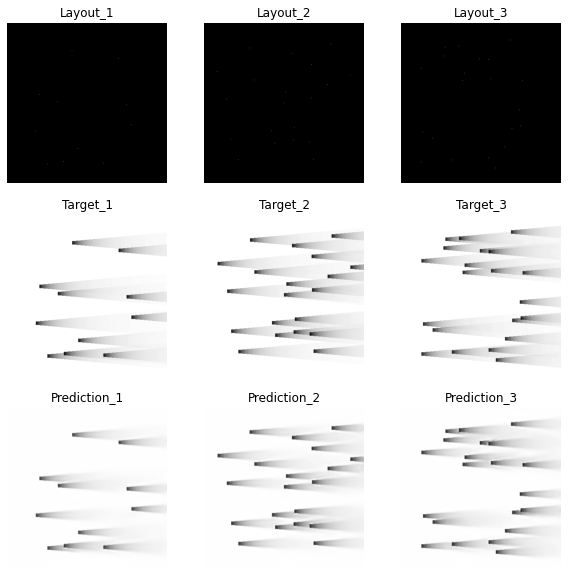

Epoch 62: , Train RMSE: 0.016586810665951895,Validation RMSE: 0.016602347178147143
Epoch 62: , Train loss: 10564.695861816406,Validation loss: 1323.0620727539062


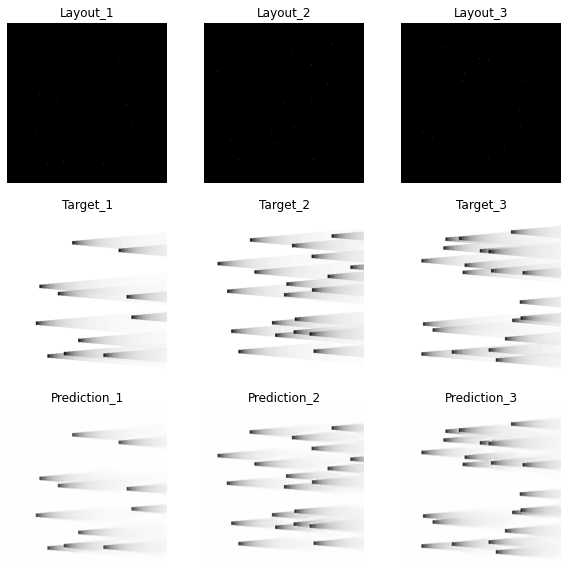

Epoch 63: , Train RMSE: 0.016469647088129105,Validation RMSE: 0.016442397245070853
Epoch 63: , Train loss: 10415.97216796875,Validation loss: 1297.691650390625


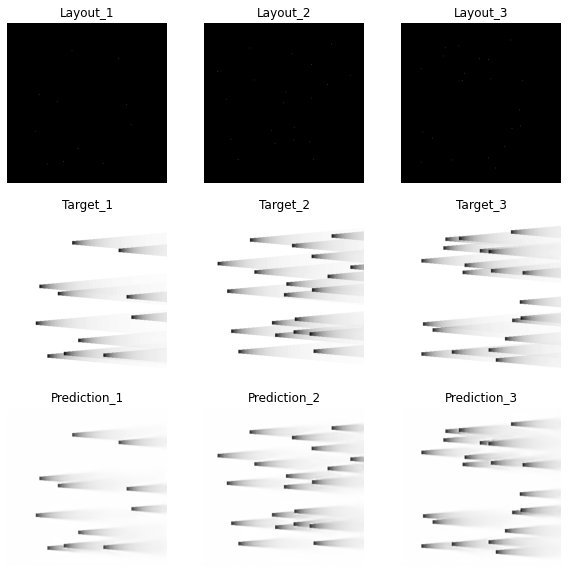

Epoch 64: , Train RMSE: 0.01635918503401724,Validation RMSE: 0.01639906216552807
Epoch 64: , Train loss: 10276.720703125,Validation loss: 1290.8603515625


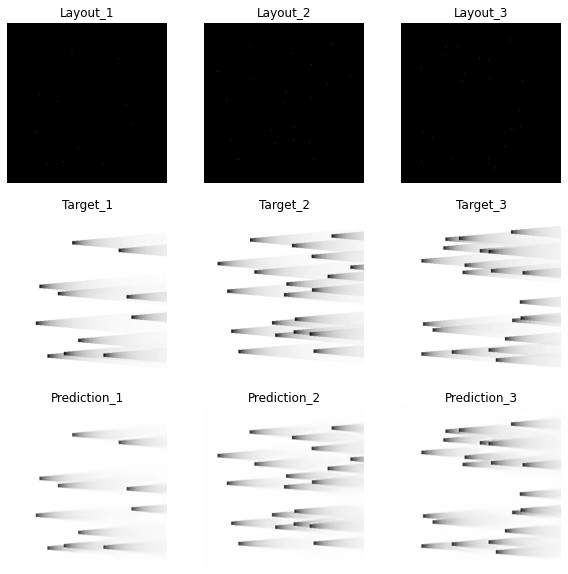

Epoch 65: , Train RMSE: 0.016260327407556084,Validation RMSE: 0.016267795306798036
Epoch 65: , Train loss: 10152.892700195312,Validation loss: 1270.277587890625


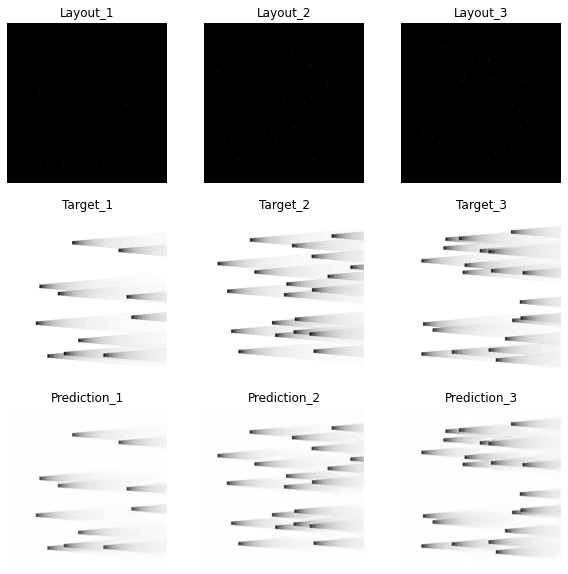

Epoch 66: , Train RMSE: 0.016158542069570094,Validation RMSE: 0.016272872868615177
Epoch 66: , Train loss: 10026.181701660156,Validation loss: 1271.0706787109375


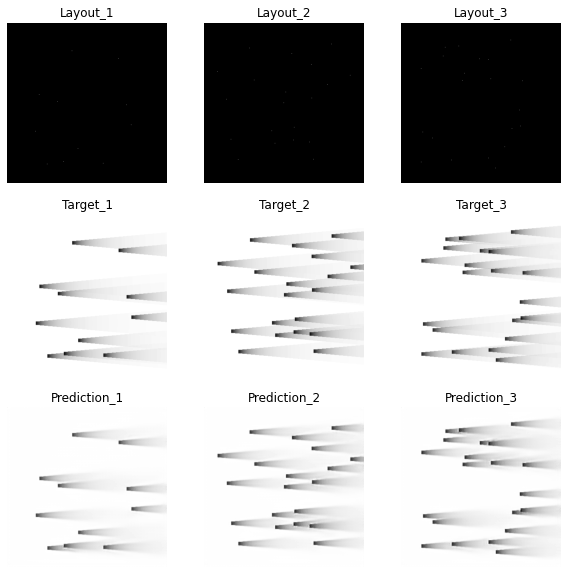

Epoch 67: , Train RMSE: 0.016072110884174914,Validation RMSE: 0.016164276549377212
Epoch 67: , Train loss: 9919.209533691406,Validation loss: 1254.1624145507812


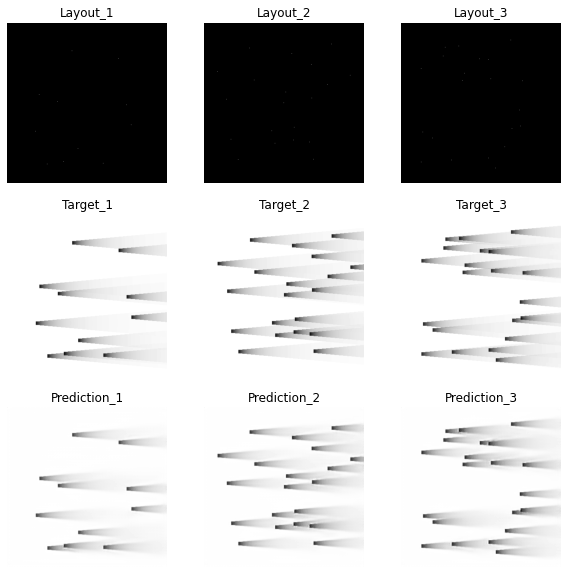

Epoch 68: , Train RMSE: 0.015986763008554897,Validation RMSE: 0.016090361303204966
Epoch 68: , Train loss: 9814.14111328125,Validation loss: 1242.7186889648438


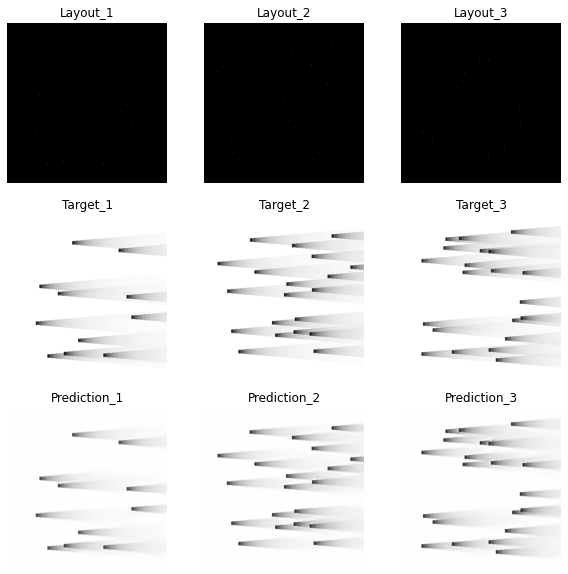

Epoch 69: , Train RMSE: 0.015908154466654917,Validation RMSE: 0.015934975018912105
Epoch 69: , Train loss: 9717.864135742188,Validation loss: 1218.8324584960938


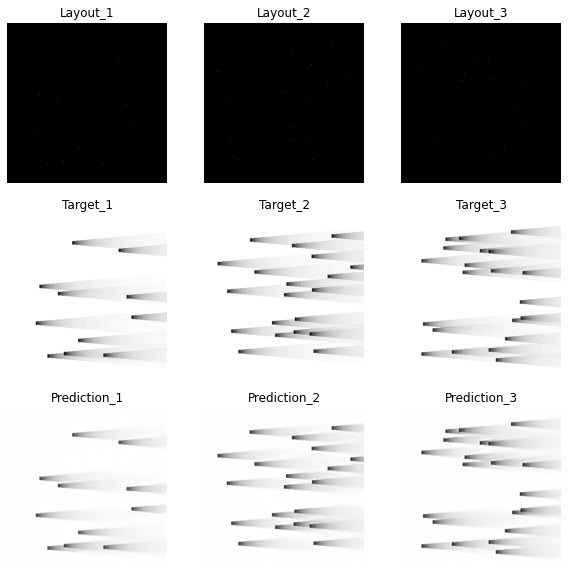

Epoch 70: , Train RMSE: 0.015810553359277158,Validation RMSE: 0.015707081765959554
Epoch 70: , Train loss: 9598.986145019531,Validation loss: 1184.2196044921875


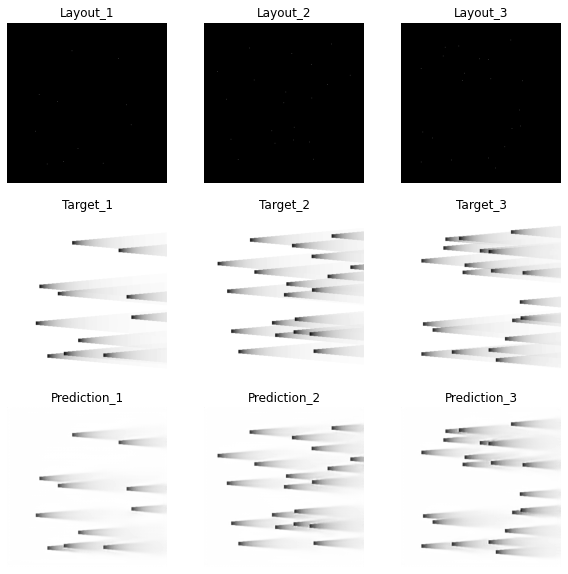

Epoch 71: , Train RMSE: 0.015717590046547783,Validation RMSE: 0.015687252290955998
Epoch 71: , Train loss: 9486.437255859375,Validation loss: 1181.2314453125


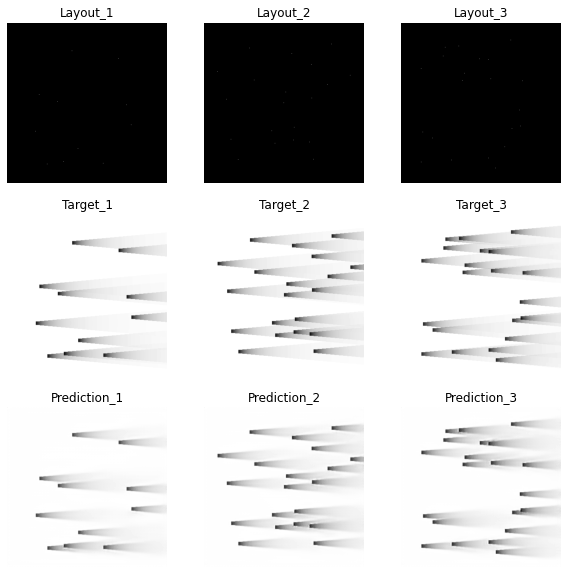

Epoch 72: , Train RMSE: 0.015667199433513888,Validation RMSE: 0.01595881693267471
Epoch 72: , Train loss: 9425.707702636719,Validation loss: 1222.482421875


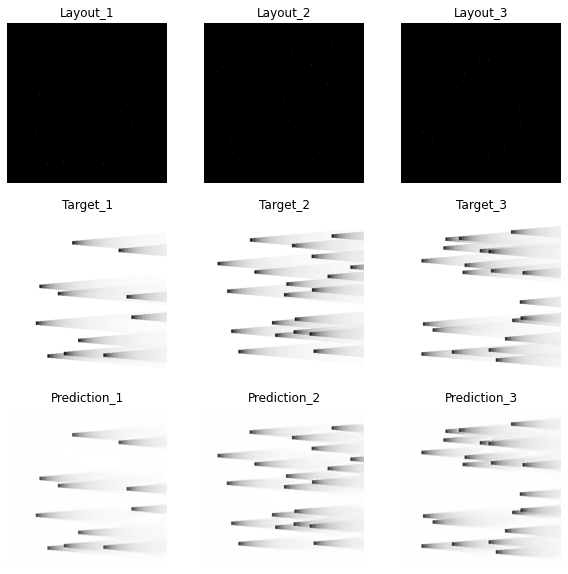

Epoch 73: , Train RMSE: 0.015659750987964197,Validation RMSE: 0.016041529006697627
Epoch 73: , Train loss: 9416.74755859375,Validation loss: 1235.1871337890625


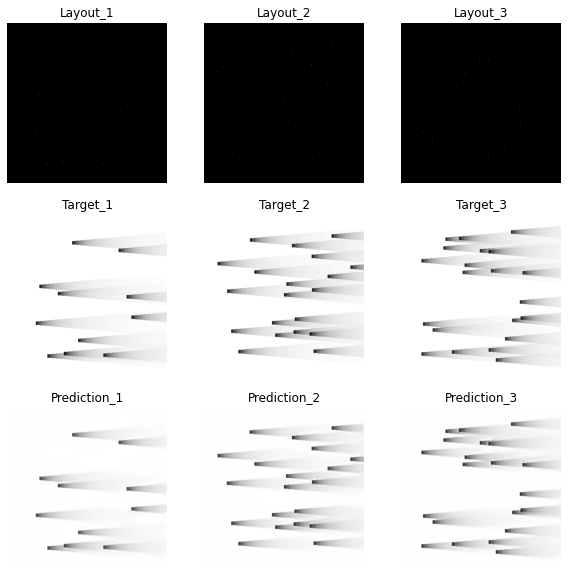

Epoch 74: , Train RMSE: 0.015530473757508163,Validation RMSE: 0.015498770716332566
Epoch 74: , Train loss: 9261.91162109375,Validation loss: 1153.01708984375


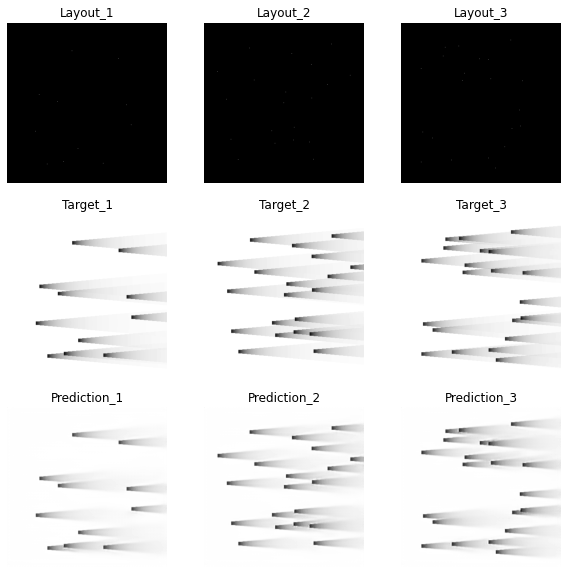

Epoch 75: , Train RMSE: 0.015267824460289143,Validation RMSE: 0.015276526721632697
Epoch 75: , Train loss: 8951.288208007812,Validation loss: 1120.1868896484375


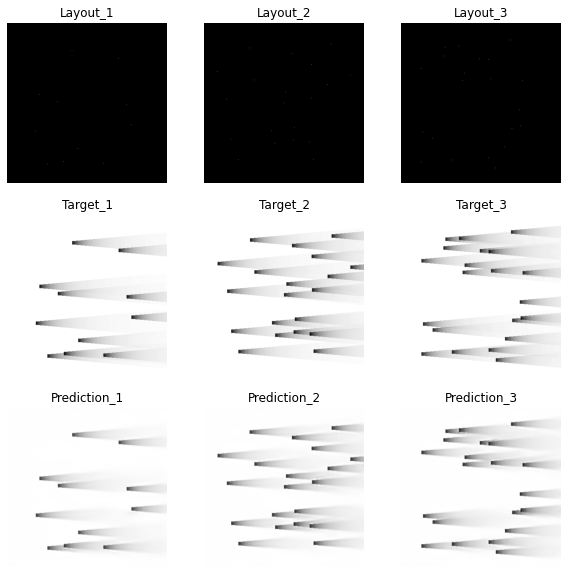

Epoch 76: , Train RMSE: 0.01514343191608638,Validation RMSE: 0.015220872003920572
Epoch 76: , Train loss: 8806.023559570312,Validation loss: 1112.0397338867188


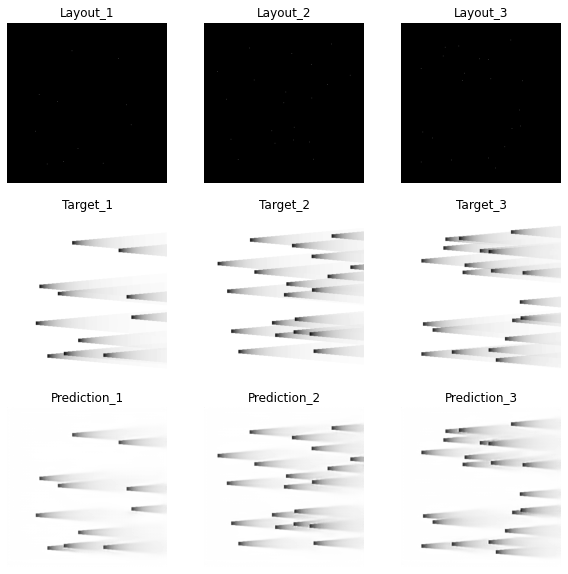

Epoch 77: , Train RMSE: 0.01506569537489424,Validation RMSE: 0.015148149245957391
Epoch 77: , Train loss: 8715.846801757812,Validation loss: 1101.4388427734375


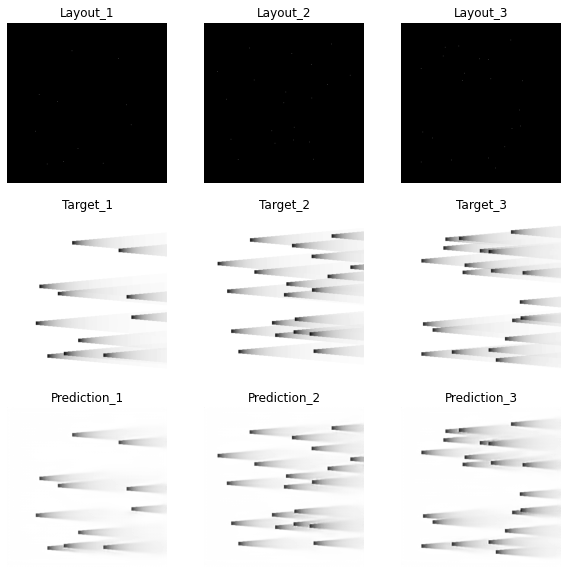

Epoch 78: , Train RMSE: 0.01498921663720741,Validation RMSE: 0.01511539324381073
Epoch 78: , Train loss: 8627.58203125,Validation loss: 1096.6805419921875


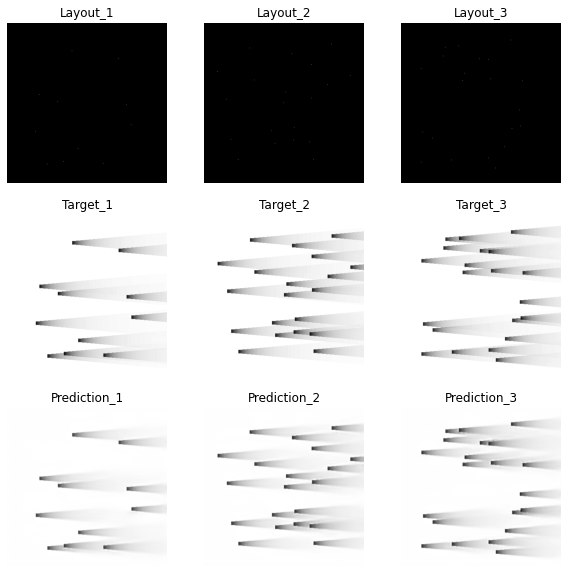

Epoch 79: , Train RMSE: 0.01492442515686341,Validation RMSE: 0.015088749174939096
Epoch 79: , Train loss: 8553.157104492188,Validation loss: 1092.8176879882812


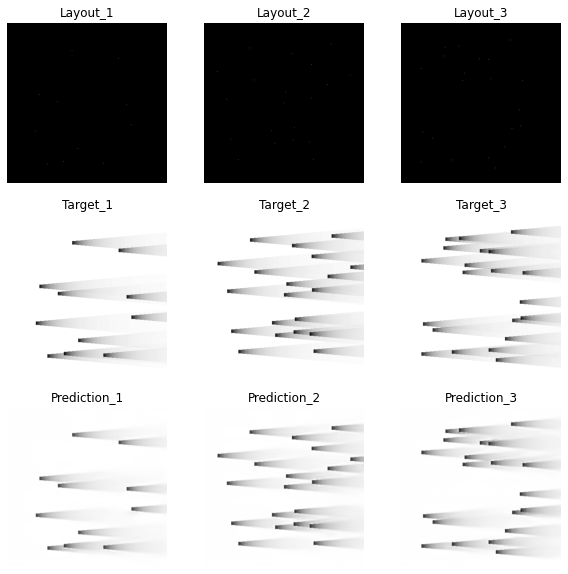

Epoch 80: , Train RMSE: 0.014867476604334857,Validation RMSE: 0.015067545234473453
Epoch 80: , Train loss: 8488.007446289062,Validation loss: 1089.7484130859375


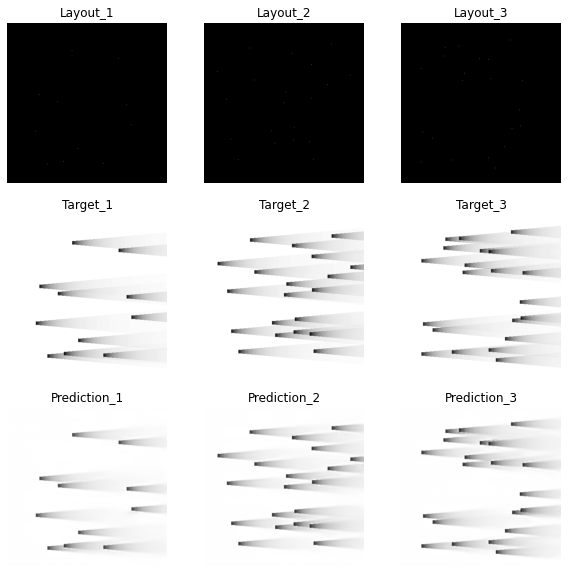

Epoch 81: , Train RMSE: 0.014811761110657922,Validation RMSE: 0.015052221312984941
Epoch 81: , Train loss: 8424.509460449219,Validation loss: 1087.532958984375


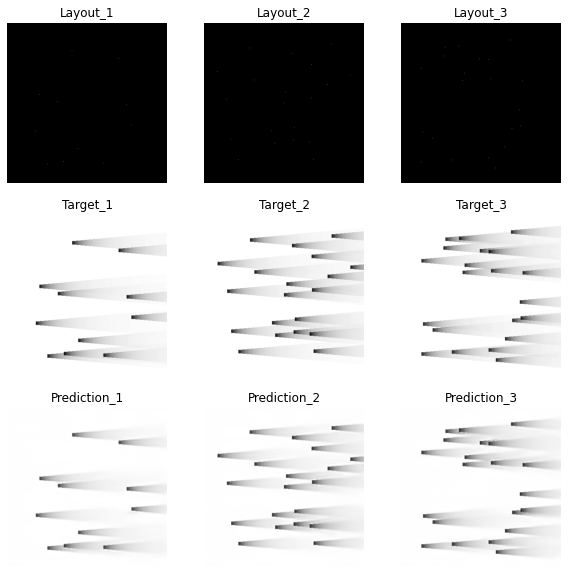

Epoch 82: , Train RMSE: 0.014762423644270802,Validation RMSE: 0.015058173226942808
Epoch 82: , Train loss: 8368.479431152344,Validation loss: 1088.3931884765625


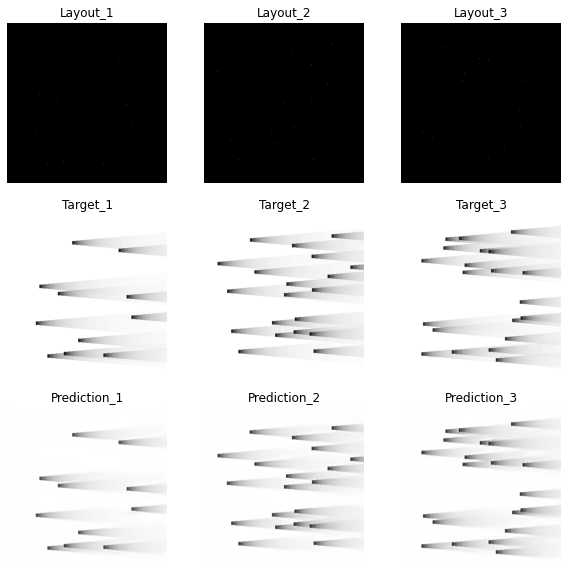

Epoch 83: , Train RMSE: 0.014721446584666412,Validation RMSE: 0.015106278616042017
Epoch 83: , Train loss: 8322.085998535156,Validation loss: 1095.3583374023438


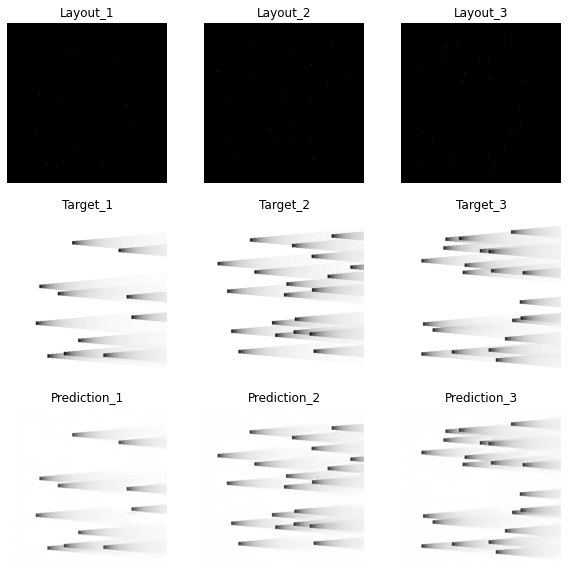

Epoch 84: , Train RMSE: 0.014688841305352833,Validation RMSE: 0.015168610556534845
Epoch 84: , Train loss: 8285.263061523438,Validation loss: 1104.4163818359375


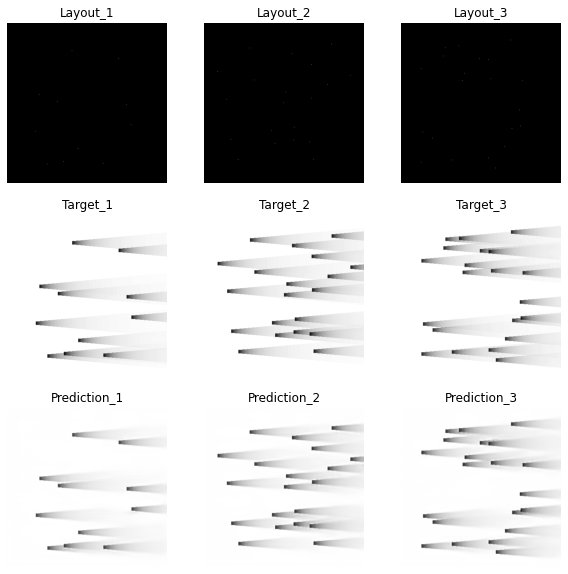

Epoch 85: , Train RMSE: 0.01465783671972241,Validation RMSE: 0.015152561853262954
Epoch 85: , Train loss: 8250.323608398438,Validation loss: 1102.0806274414062


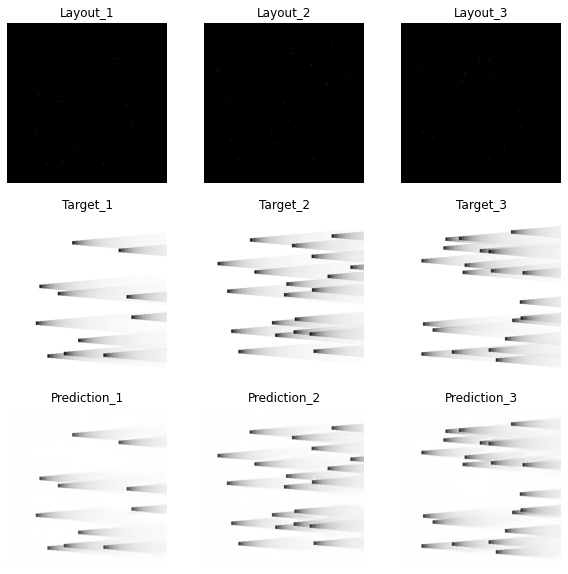

Epoch 86: , Train RMSE: 0.014588515242044563,Validation RMSE: 0.014880602895356655
Epoch 86: , Train loss: 8172.471435546875,Validation loss: 1062.875244140625


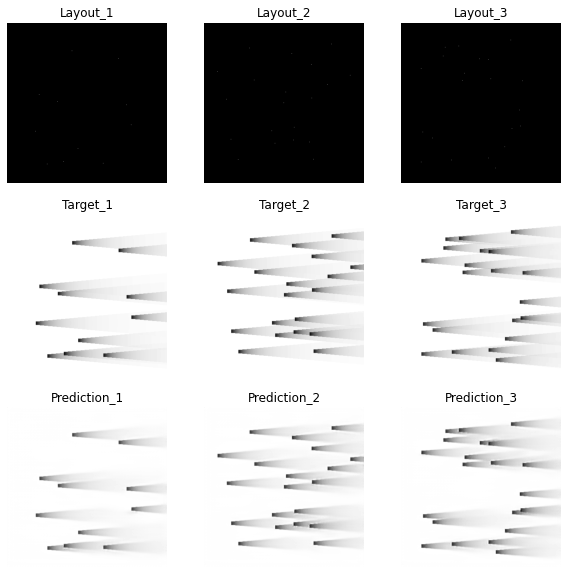

Epoch 87: , Train RMSE: 0.014436373568982684,Validation RMSE: 0.014493549183557419
Epoch 87: , Train loss: 8002.901062011719,Validation loss: 1008.30224609375


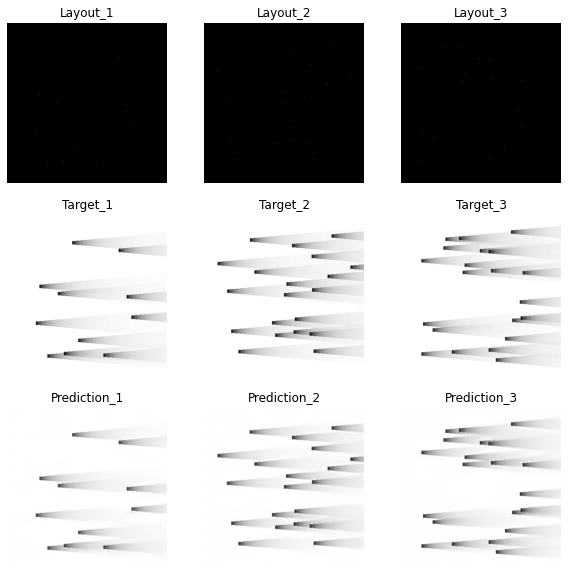

Epoch 88: , Train RMSE: 0.014260771645511159,Validation RMSE: 0.014287875207316867
Epoch 88: , Train loss: 7809.3929443359375,Validation loss: 979.8882141113281


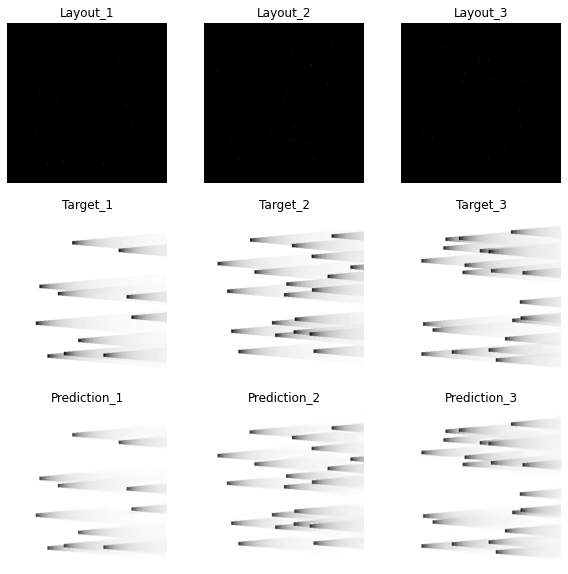

Epoch 89: , Train RMSE: 0.014149648298963287,Validation RMSE: 0.014319829360684018
Epoch 89: , Train loss: 7688.161804199219,Validation loss: 984.2760620117188


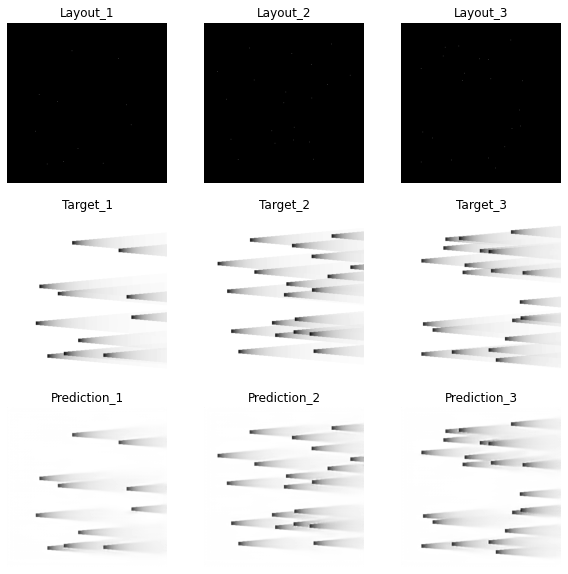

Epoch 90: , Train RMSE: 0.014083218380310297,Validation RMSE: 0.01436901443368652
Epoch 90: , Train loss: 7616.142333984375,Validation loss: 991.0491638183594


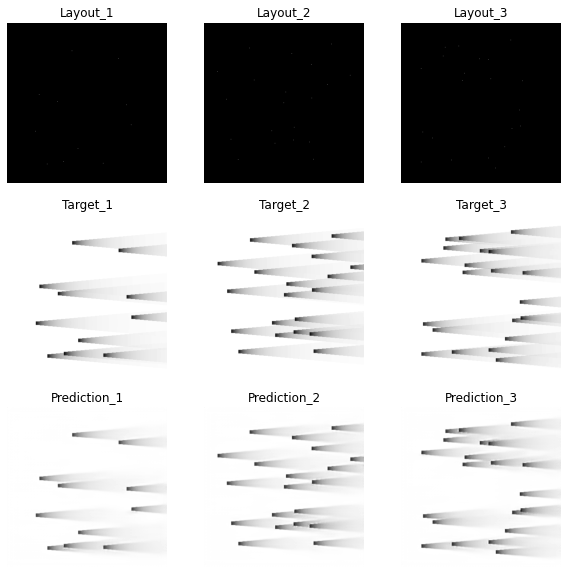

Epoch 91: , Train RMSE: 0.01404394816457015,Validation RMSE: 0.014503084402774825
Epoch 91: , Train loss: 7573.727233886719,Validation loss: 1009.62939453125


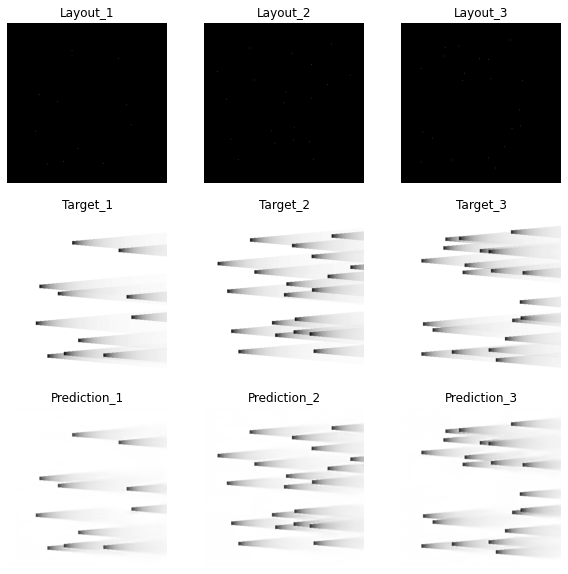

Epoch 92: , Train RMSE: 0.014030223851392765,Validation RMSE: 0.014492224790074441
Epoch 92: , Train loss: 7558.9317626953125,Validation loss: 1008.1179809570312


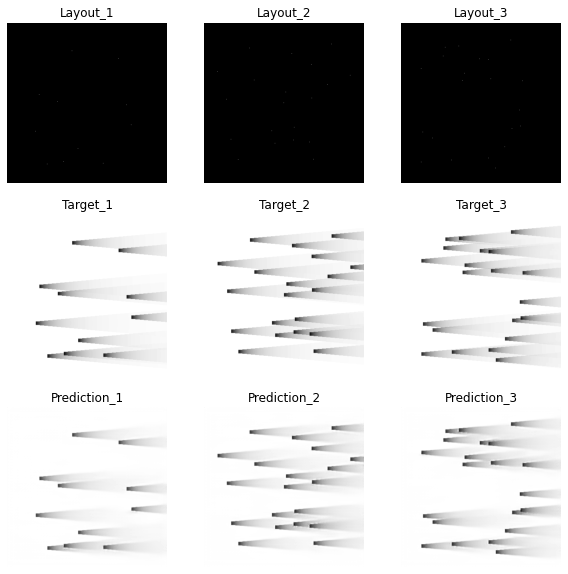

Epoch 93: , Train RMSE: 0.01399966606241415,Validation RMSE: 0.014220360968578124
Epoch 93: , Train loss: 7526.040954589844,Validation loss: 970.6495971679688


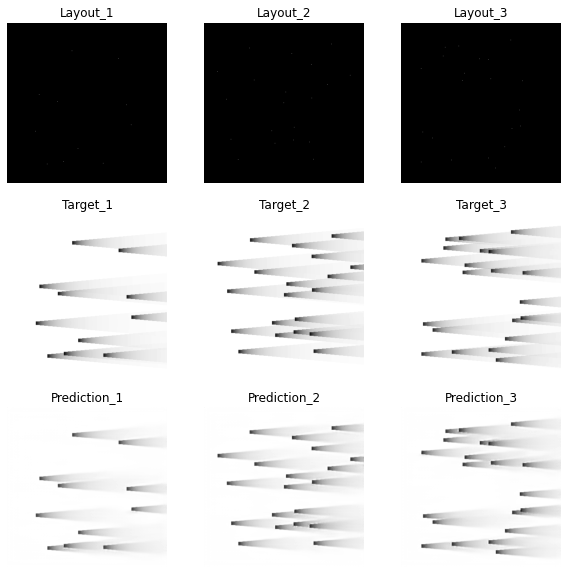

Epoch 94: , Train RMSE: 0.013939806452246259,Validation RMSE: 0.01381772235170361
Epoch 94: , Train loss: 7461.819030761719,Validation loss: 916.4613647460938


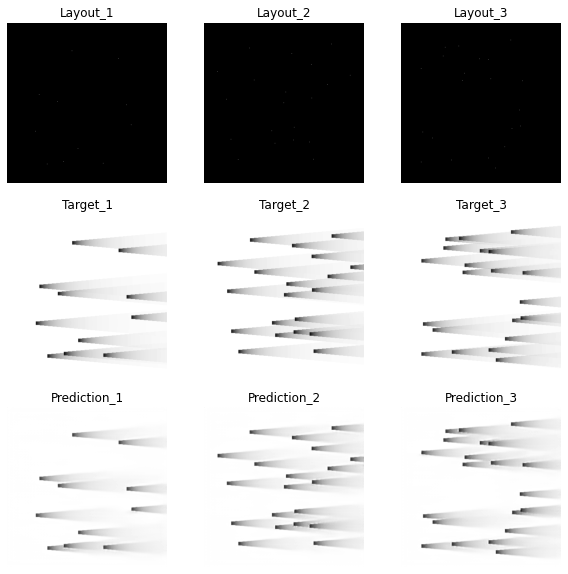

Epoch 95: , Train RMSE: 0.013906702784335622,Validation RMSE: 0.014101410559401893
Epoch 95: , Train loss: 7426.421081542969,Validation loss: 954.4789428710938


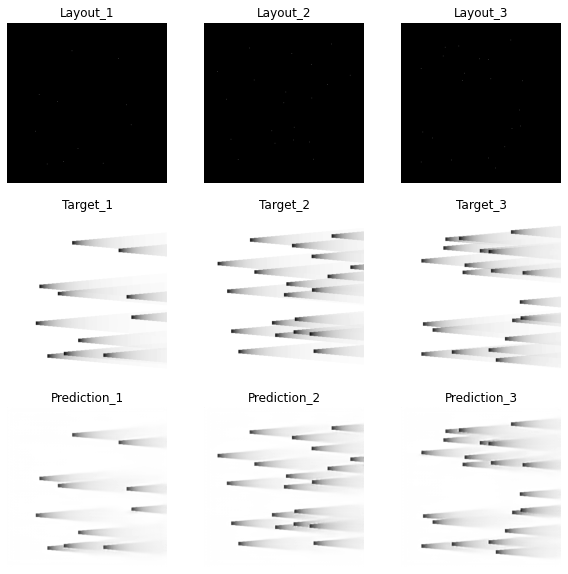

Epoch 96: , Train RMSE: 0.01402226350168304,Validation RMSE: 0.014781830360250893
Epoch 96: , Train loss: 7550.356750488281,Validation loss: 1048.8120422363281


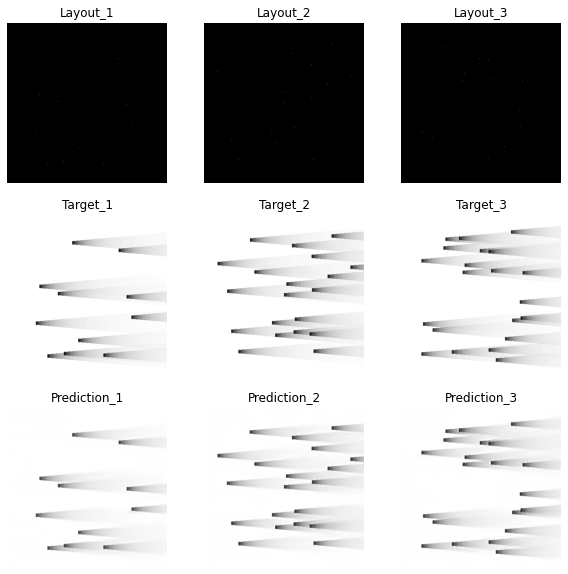

Epoch 97: , Train RMSE: 0.014063573386587886,Validation RMSE: 0.01399772725503958
Epoch 97: , Train loss: 7594.9093017578125,Validation loss: 940.4945678710938


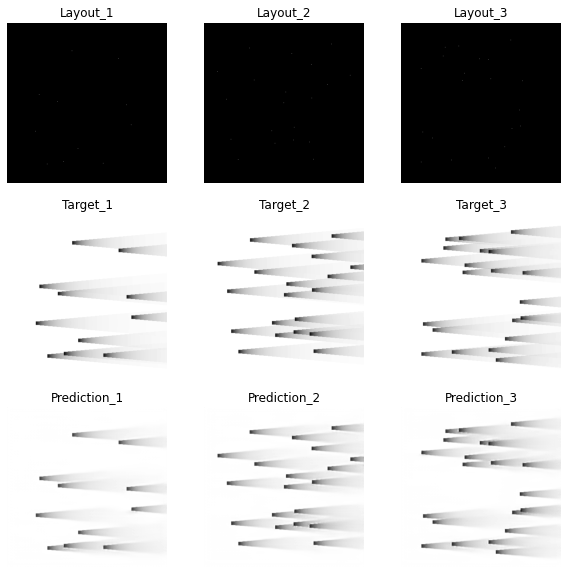

Epoch 98: , Train RMSE: 0.013612694587636165,Validation RMSE: 0.01370324827607807
Epoch 98: , Train loss: 7115.729431152344,Validation loss: 901.3392639160156


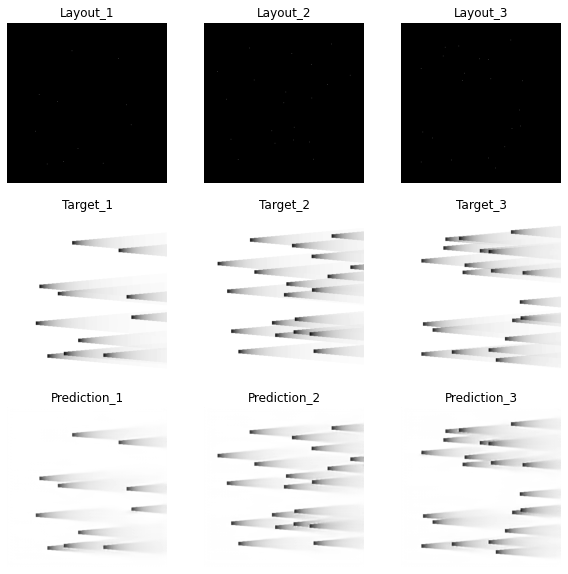

Epoch 99: , Train RMSE: 0.013434044445390446,Validation RMSE: 0.01367790719790621
Epoch 99: , Train loss: 6930.184326171875,Validation loss: 898.0086975097656


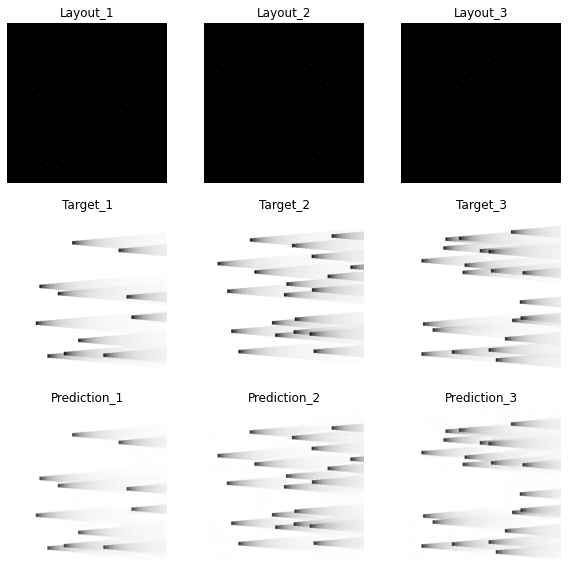

Epoch 100: , Train RMSE: 0.013336988405082517,Validation RMSE: 0.013488495811113234
Epoch 100: , Train loss: 6830.409973144531,Validation loss: 873.3096923828125


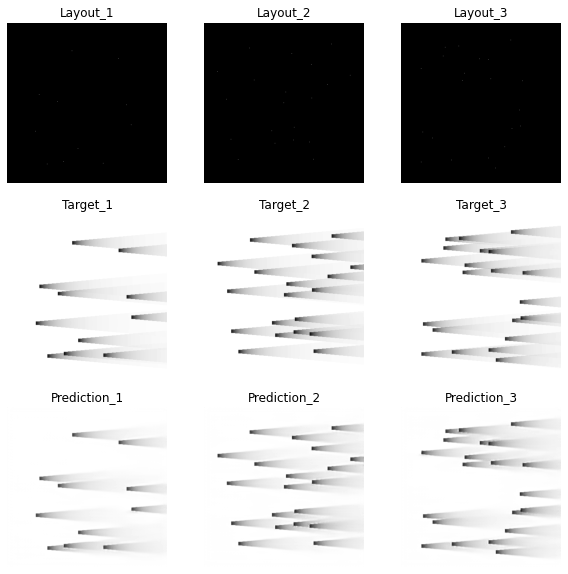

Epoch 101: , Train RMSE: 0.013246387097083999,Validation RMSE: 0.013592902496928889
Epoch 101: , Train loss: 6737.924011230469,Validation loss: 886.881591796875


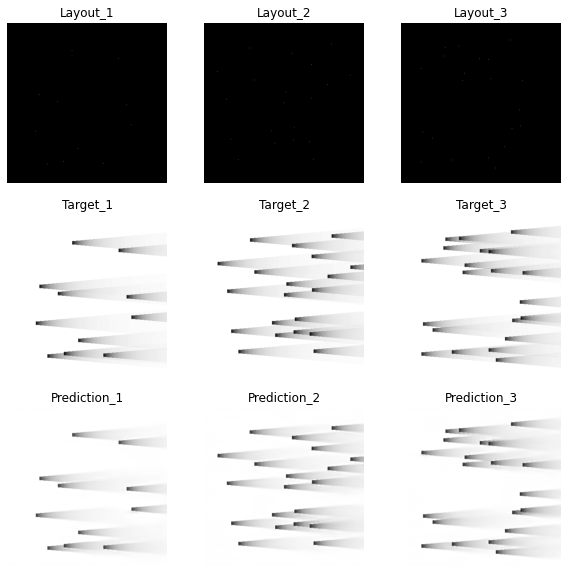

Epoch 102: , Train RMSE: 0.01323951926867424,Validation RMSE: 0.013657389089185328
Epoch 102: , Train loss: 6730.939025878906,Validation loss: 895.3165283203125


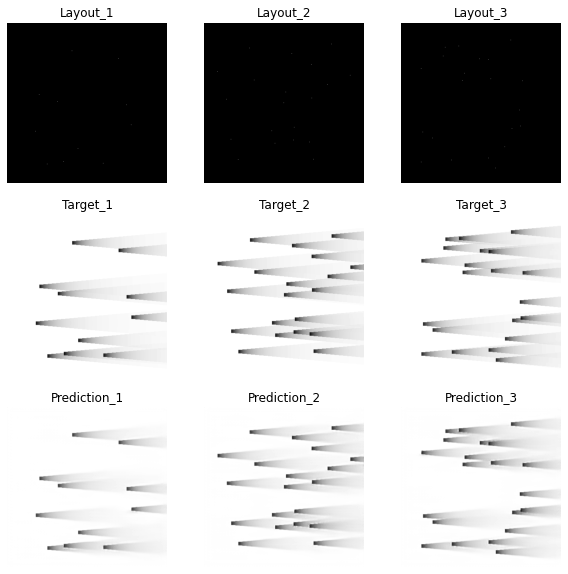

Epoch 103: , Train RMSE: 0.01321251517601429,Validation RMSE: 0.013566934496386122
Epoch 103: , Train loss: 6703.5093994140625,Validation loss: 883.4962158203125


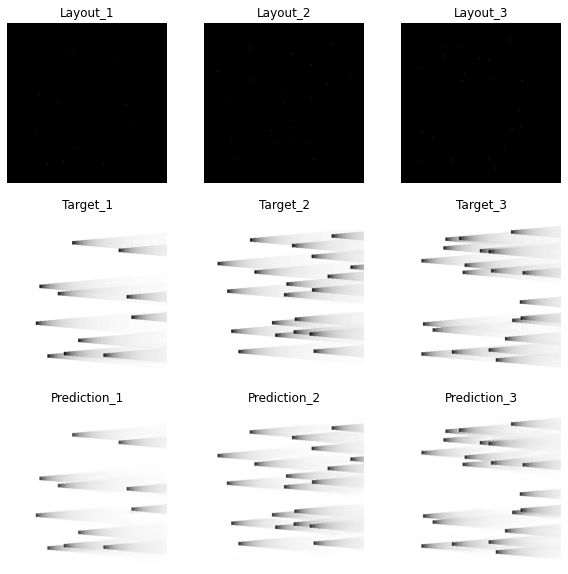

Epoch 104: , Train RMSE: 0.01312607981766064,Validation RMSE: 0.01340932378973243
Epoch 104: , Train loss: 6616.0885009765625,Validation loss: 863.0878295898438


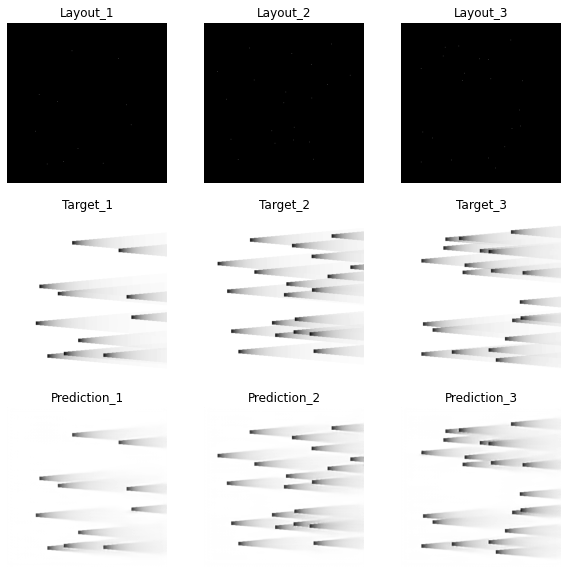

Epoch 105: , Train RMSE: 0.013035510628310652,Validation RMSE: 0.013342781216356847
Epoch 105: , Train loss: 6525.102233886719,Validation loss: 854.5430908203125


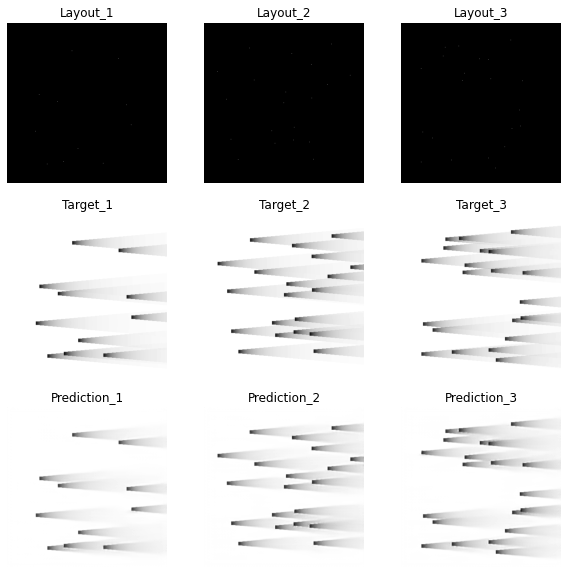

Epoch 106: , Train RMSE: 0.01296246528780246,Validation RMSE: 0.013365087050204266
Epoch 106: , Train loss: 6452.179443359375,Validation loss: 857.4026489257812


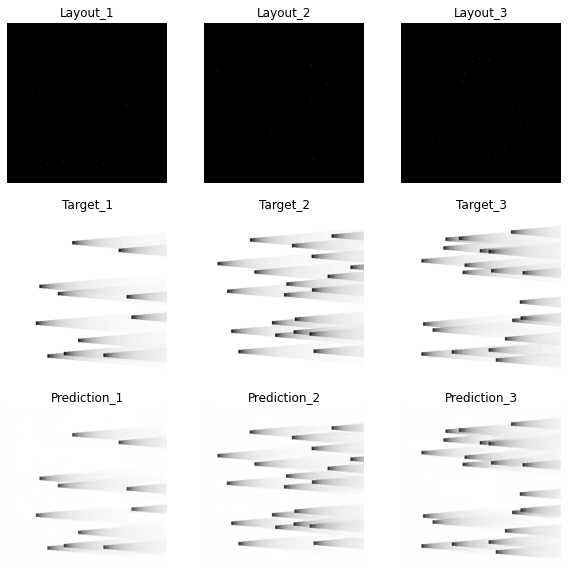

Epoch 107: , Train RMSE: 0.012898759652667804,Validation RMSE: 0.013291495406782447
Epoch 107: , Train loss: 6388.915222167969,Validation loss: 847.9864807128906


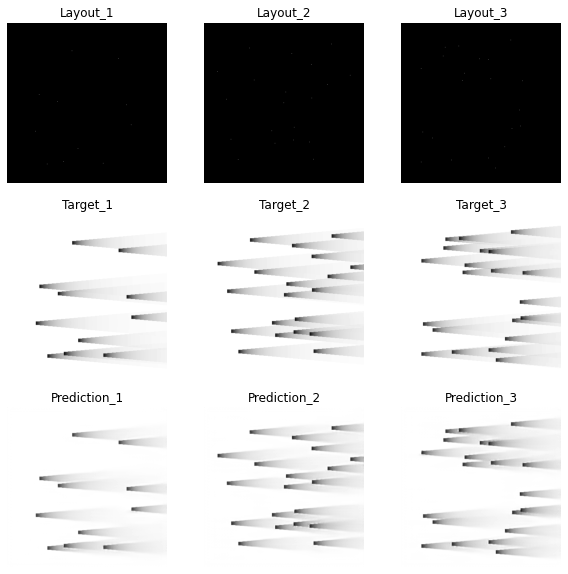

Epoch 108: , Train RMSE: 0.012825802480119254,Validation RMSE: 0.0132845935876236
Epoch 108: , Train loss: 6316.846435546875,Validation loss: 847.1060485839844


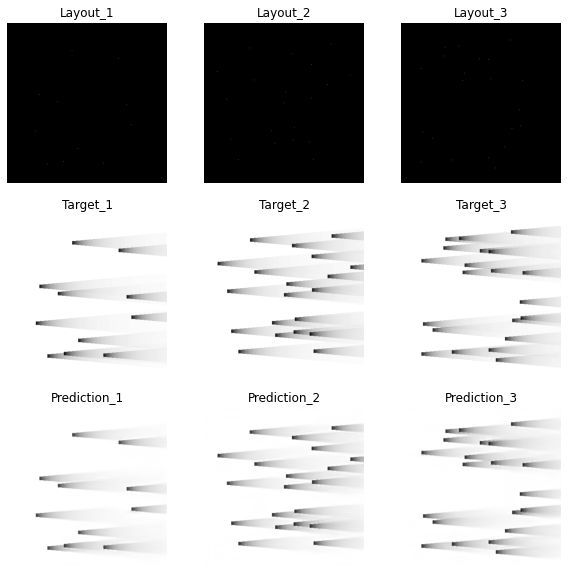

Epoch 109: , Train RMSE: 0.012742322380370229,Validation RMSE: 0.013106784350881334
Epoch 109: , Train loss: 6234.884338378906,Validation loss: 824.5814208984375


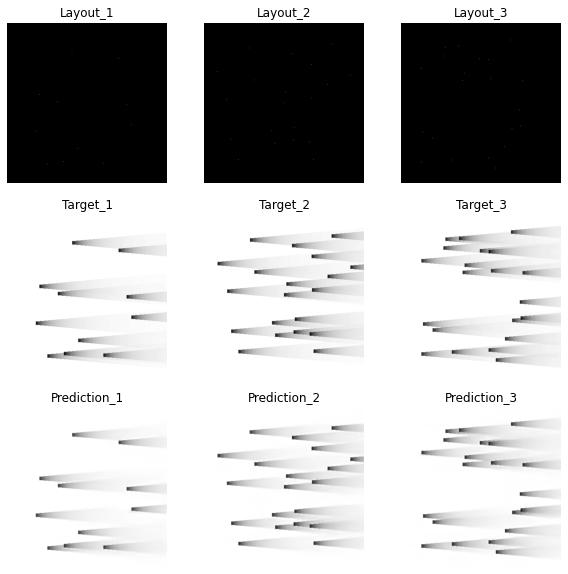

Epoch 110: , Train RMSE: 0.012654794114758013,Validation RMSE: 0.013095745362534422
Epoch 110: , Train loss: 6149.5224609375,Validation loss: 823.1930236816406


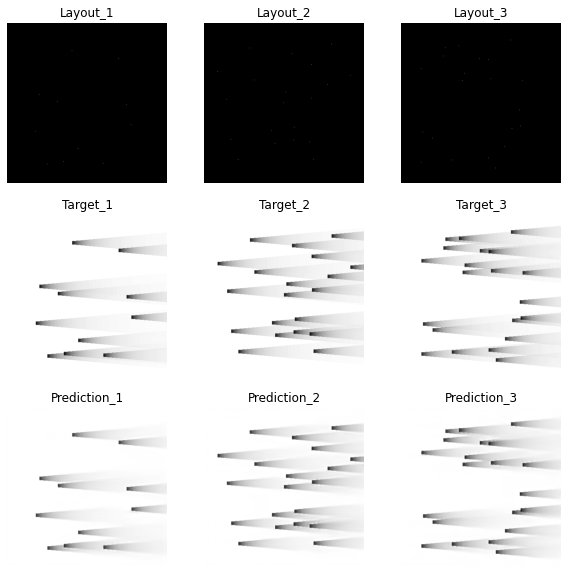

Epoch 111: , Train RMSE: 0.012581668899467885,Validation RMSE: 0.013028720430288559
Epoch 111: , Train loss: 6078.658264160156,Validation loss: 814.7882690429688


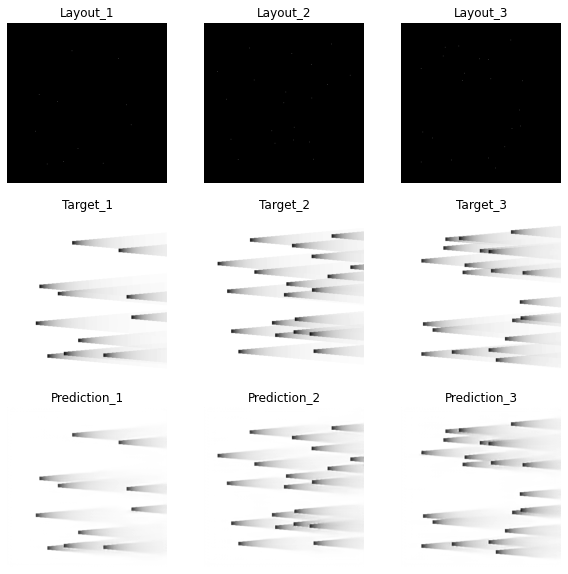

Epoch 112: , Train RMSE: 0.012519128532101895,Validation RMSE: 0.012909096663290997
Epoch 112: , Train loss: 6018.37744140625,Validation loss: 799.8949279785156


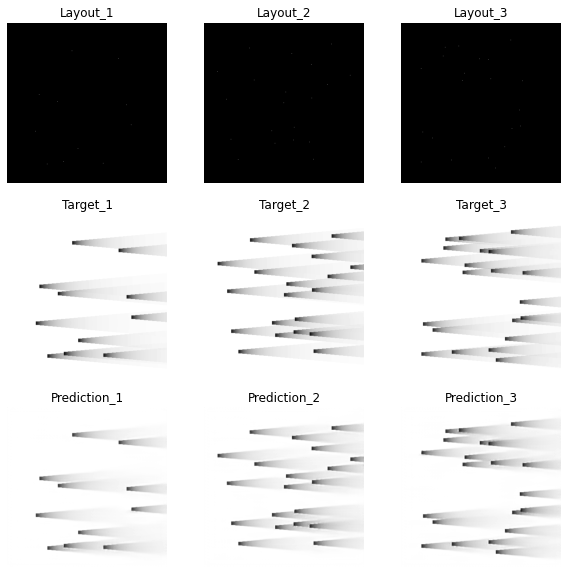

Epoch 113: , Train RMSE: 0.012459481244909542,Validation RMSE: 0.012855794316167053
Epoch 113: , Train loss: 5961.1650390625,Validation loss: 793.3029479980469


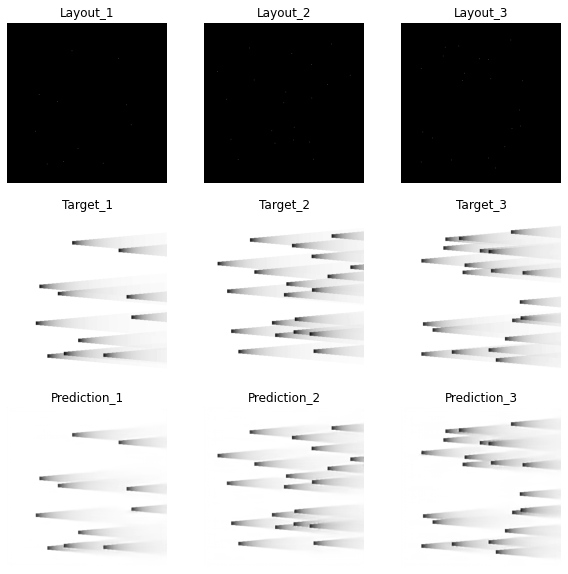

Epoch 114: , Train RMSE: 0.012395137008642247,Validation RMSE: 0.012894781132399028
Epoch 114: , Train loss: 5899.7537841796875,Validation loss: 798.121826171875


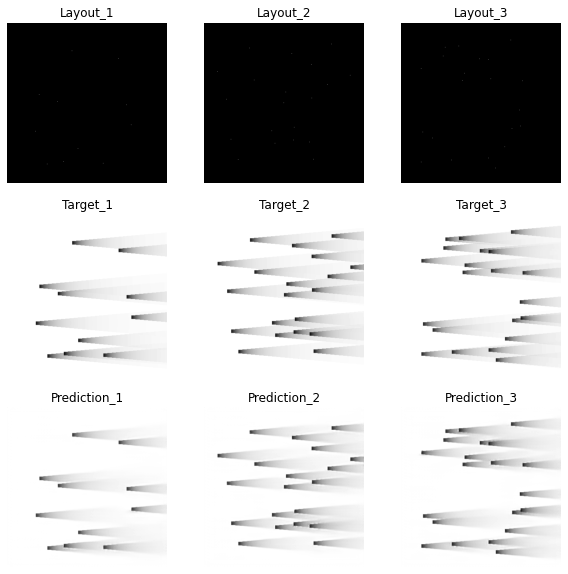

Epoch 115: , Train RMSE: 0.01234200883005111,Validation RMSE: 0.012870169514268611
Epoch 115: , Train loss: 5849.2869873046875,Validation loss: 795.0780639648438


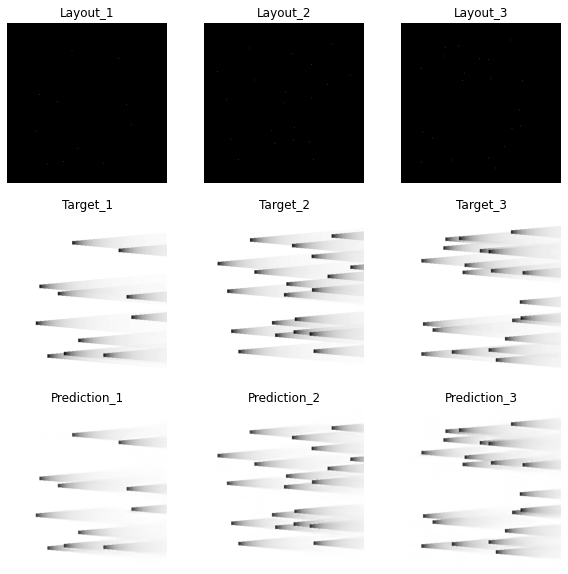

Epoch 116: , Train RMSE: 0.012292789612676923,Validation RMSE: 0.012763265403340303
Epoch 116: , Train loss: 5802.726776123047,Validation loss: 781.9245300292969


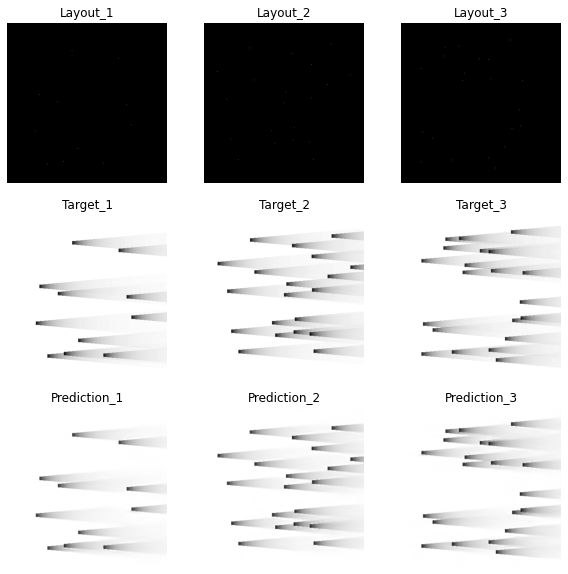

Epoch 117: , Train RMSE: 0.012251312652636308,Validation RMSE: 0.012669311565191247
Epoch 117: , Train loss: 5763.635009765625,Validation loss: 770.4549865722656


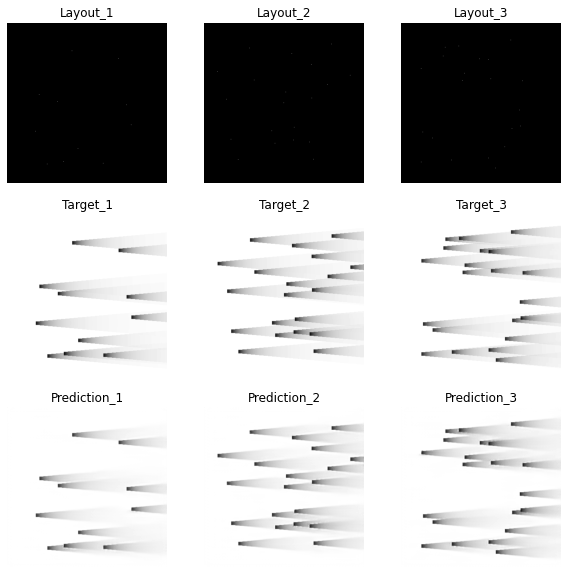

Epoch 118: , Train RMSE: 0.01222353279186829,Validation RMSE: 0.01259451622284606
Epoch 118: , Train loss: 5737.526550292969,Validation loss: 761.3848266601562


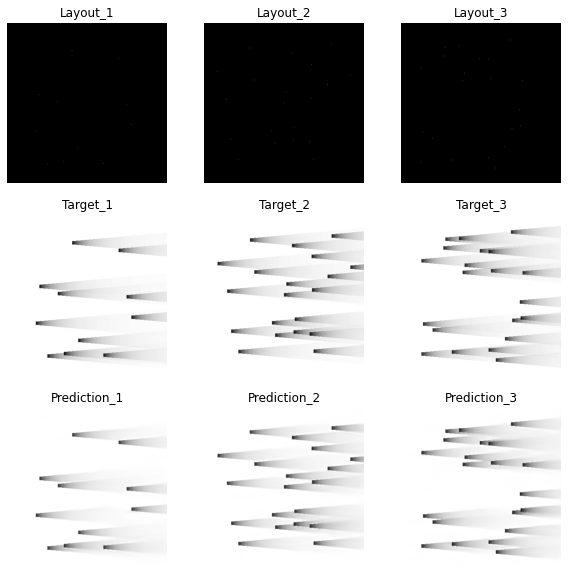

Epoch 119: , Train RMSE: 0.012217399372924693,Validation RMSE: 0.012507415606340888
Epoch 119: , Train loss: 5731.7701416015625,Validation loss: 750.89013671875


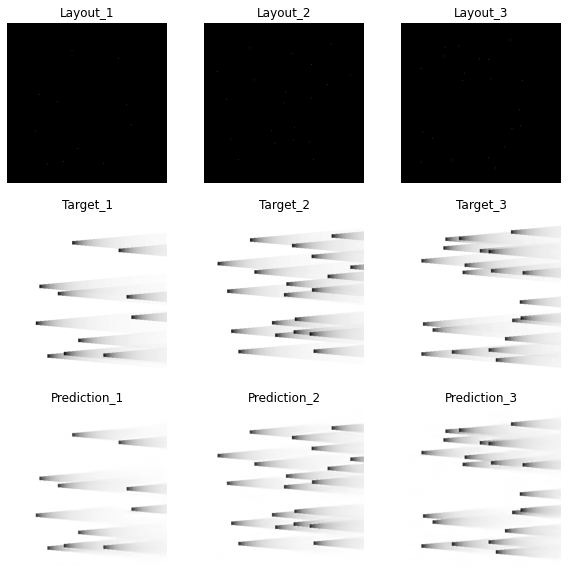

Epoch 120: , Train RMSE: 0.01221824348355963,Validation RMSE: 0.012431877155955501
Epoch 120: , Train loss: 5732.562194824219,Validation loss: 741.8475341796875


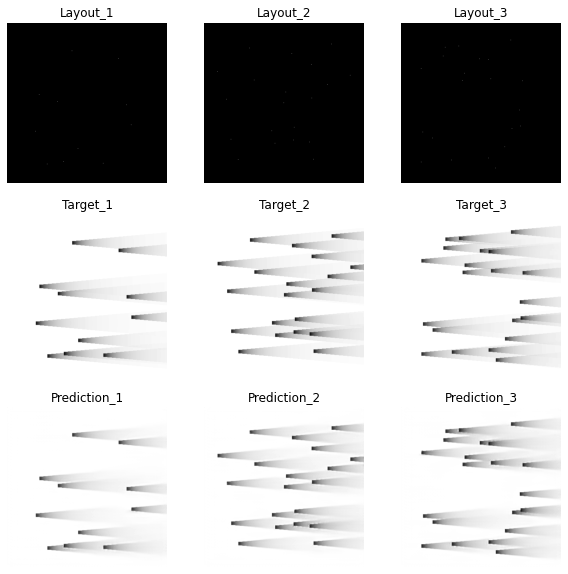

Epoch 121: , Train RMSE: 0.012240694404115075,Validation RMSE: 0.01243835277605094
Epoch 121: , Train loss: 5753.648620605469,Validation loss: 742.6205749511719


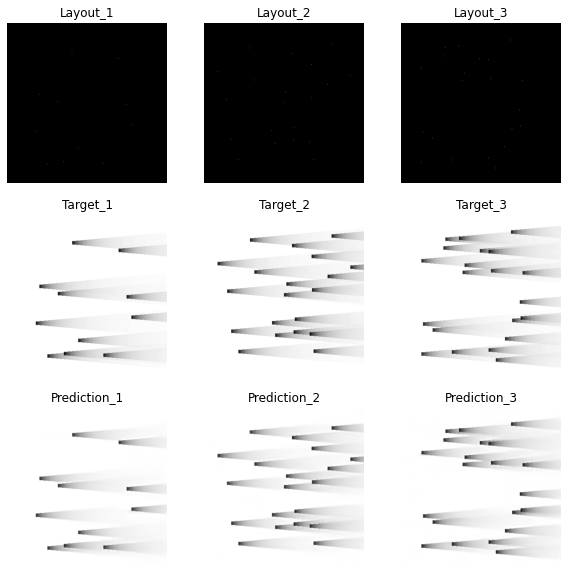

Epoch 122: , Train RMSE: 0.012323738262081801,Validation RMSE: 0.012488051489437746
Epoch 122: , Train loss: 5831.981750488281,Validation loss: 748.5668640136719


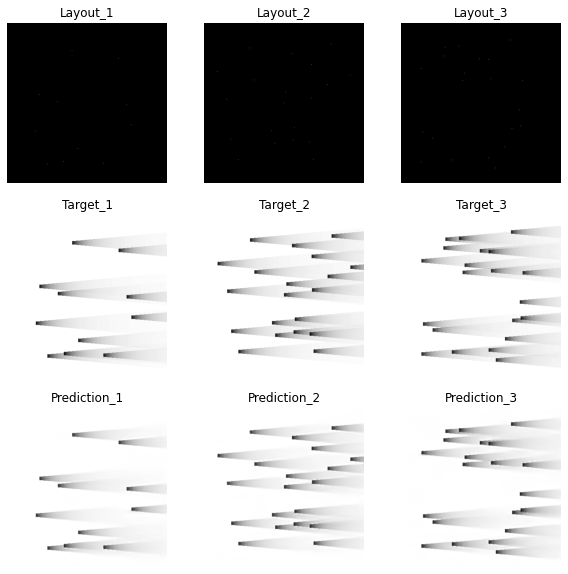

Epoch 123: , Train RMSE: 0.012508155578190617,Validation RMSE: 0.012928994151538154
Epoch 123: , Train loss: 6007.8319091796875,Validation loss: 802.3626708984375


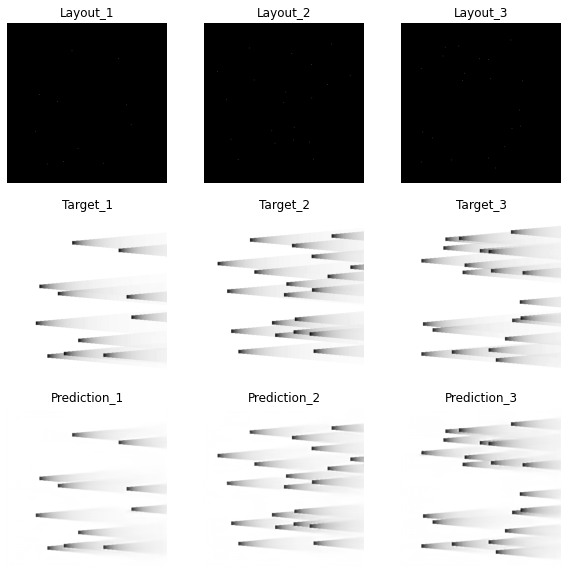

Epoch 124: , Train RMSE: 0.012993288165960461,Validation RMSE: 0.01402431134659873
Epoch 124: , Train loss: 6482.900634765625,Validation loss: 944.0702819824219


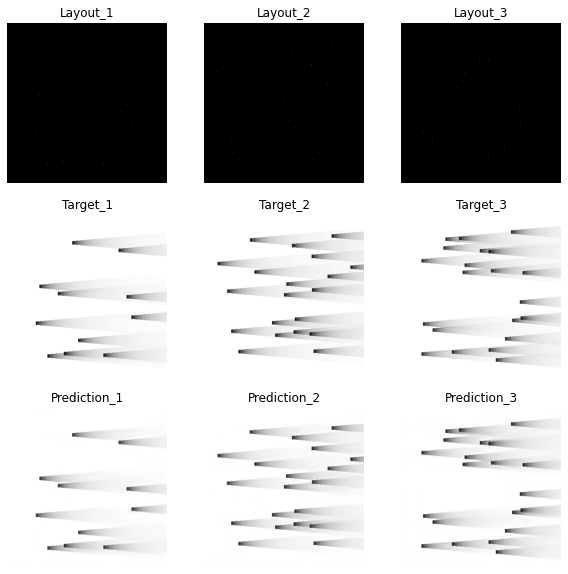

Epoch 125: , Train RMSE: 0.013119430450195787,Validation RMSE: 0.013533744176882925
Epoch 125: , Train loss: 6609.3870849609375,Validation loss: 879.1787109375


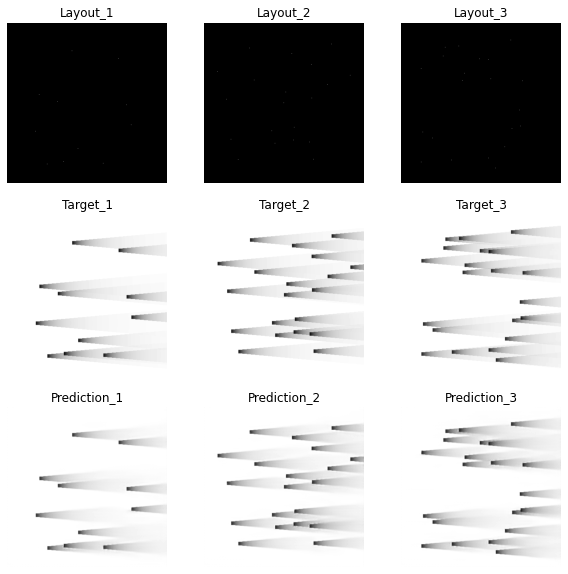

Epoch 126: , Train RMSE: 0.012448356375915336,Validation RMSE: 0.012930895116062312
Epoch 126: , Train loss: 5950.5245361328125,Validation loss: 802.5986328125


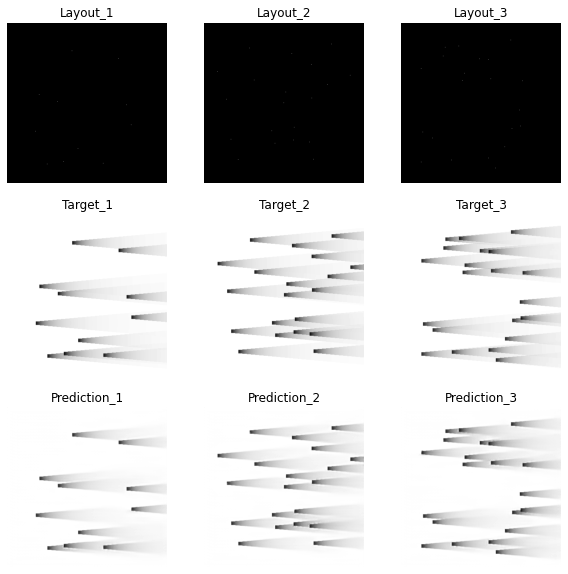

Epoch 127: , Train RMSE: 0.012298532131139395,Validation RMSE: 0.012240897812837215
Epoch 127: , Train loss: 5808.149475097656,Validation loss: 719.22998046875


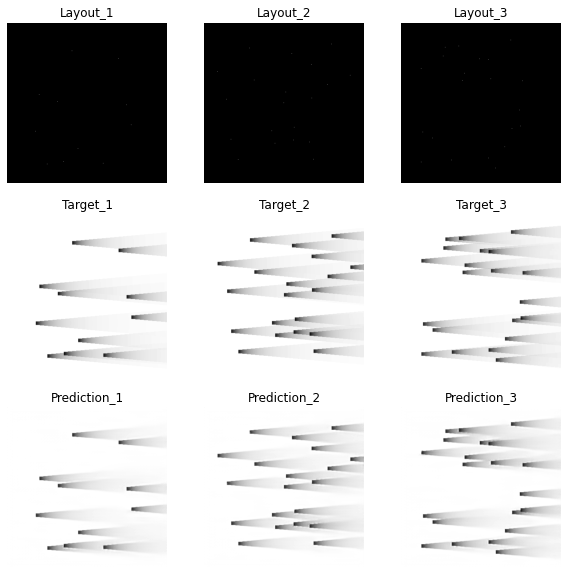

Epoch 128: , Train RMSE: 0.012123757859146964,Validation RMSE: 0.01242952647765227
Epoch 128: , Train loss: 5644.243377685547,Validation loss: 741.5670166015625


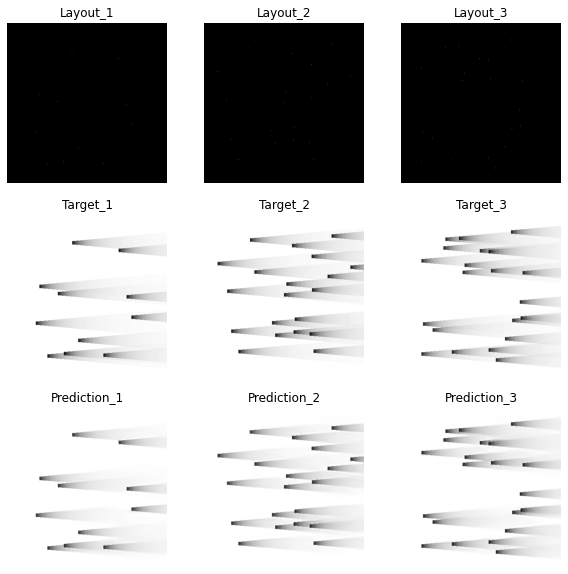

Epoch 129: , Train RMSE: 0.011945109120931456,Validation RMSE: 0.012179393713382697
Epoch 129: , Train loss: 5479.128265380859,Validation loss: 712.0206298828125


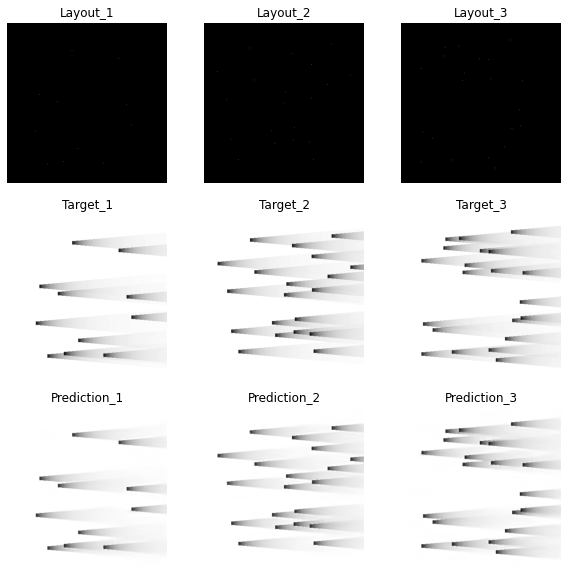

Epoch 130: , Train RMSE: 0.011786063083837828,Validation RMSE: 0.011899171555690391
Epoch 130: , Train loss: 5334.193267822266,Validation loss: 679.6333618164062


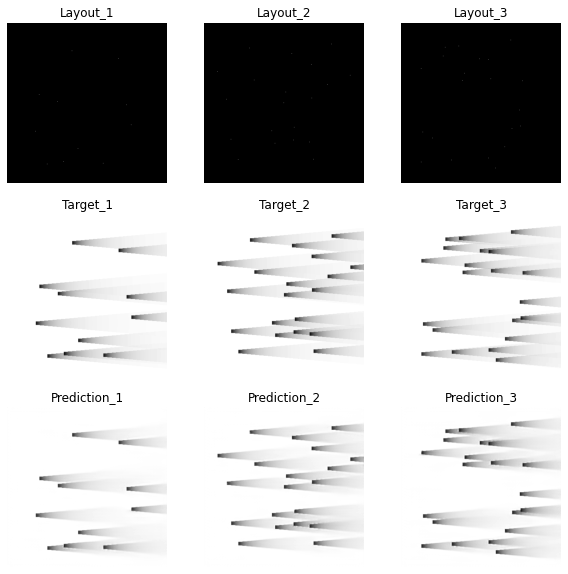

Epoch 131: , Train RMSE: 0.011687896021425054,Validation RMSE: 0.011995080257272894
Epoch 131: , Train loss: 5245.705474853516,Validation loss: 690.6333618164062


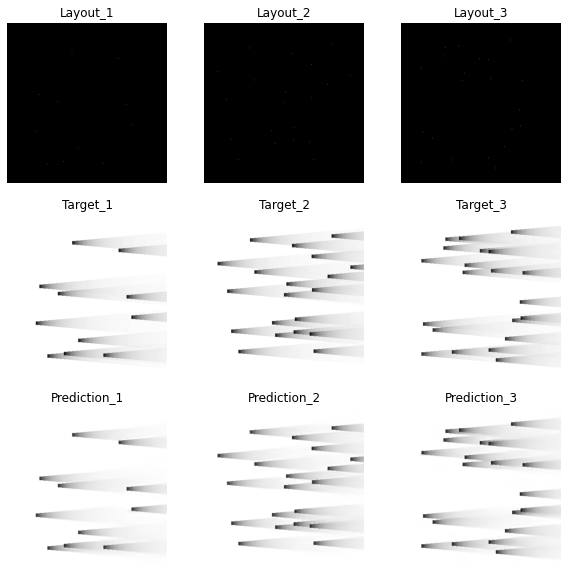

Epoch 132: , Train RMSE: 0.011600187140906422,Validation RMSE: 0.011880260975258525
Epoch 132: , Train loss: 5167.270721435547,Validation loss: 677.4748840332031


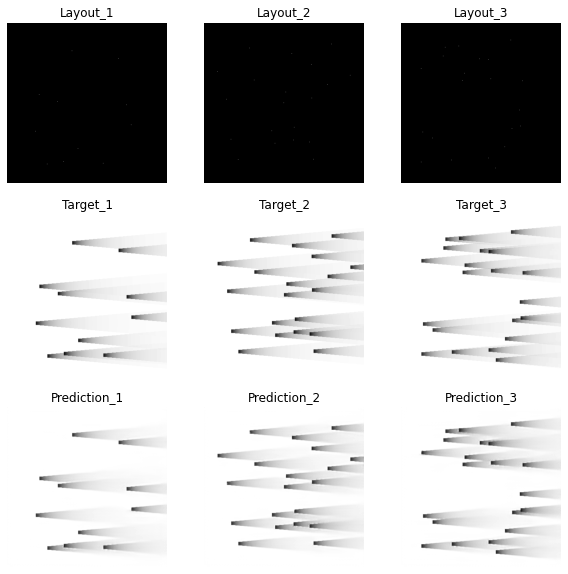

Epoch 133: , Train RMSE: 0.011463609740583613,Validation RMSE: 0.011736256725804896
Epoch 133: , Train loss: 5046.310974121094,Validation loss: 661.1506652832031


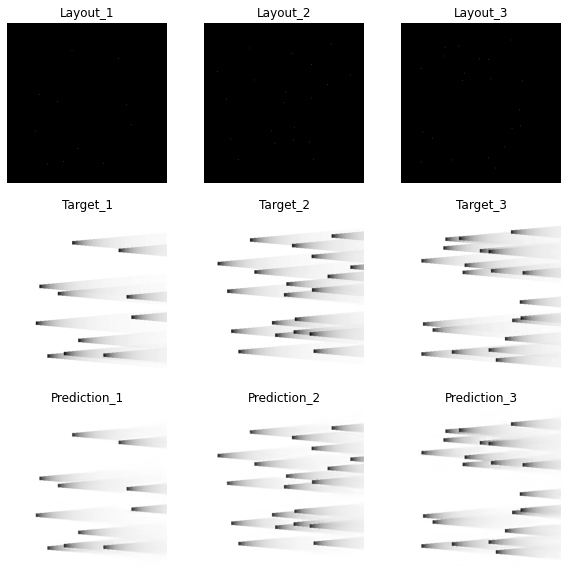

Epoch 134: , Train RMSE: 0.011372008080405702,Validation RMSE: 0.011550659715711656
Epoch 134: , Train loss: 4965.986602783203,Validation loss: 640.4051513671875


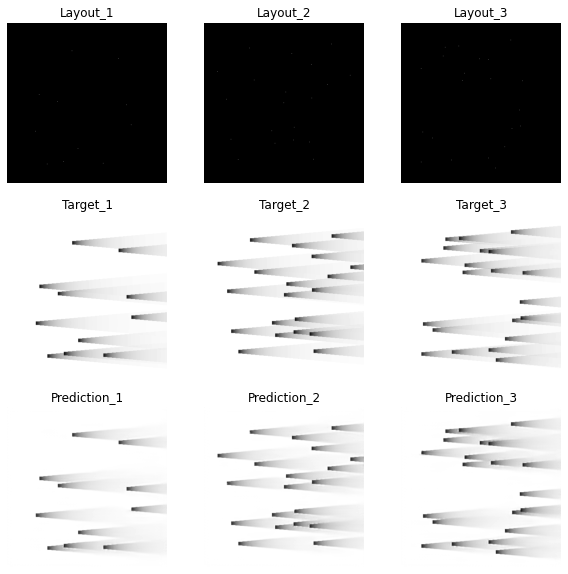

Epoch 135: , Train RMSE: 0.011310062539264745,Validation RMSE: 0.01147365077999469
Epoch 135: , Train loss: 4912.032562255859,Validation loss: 631.8943786621094


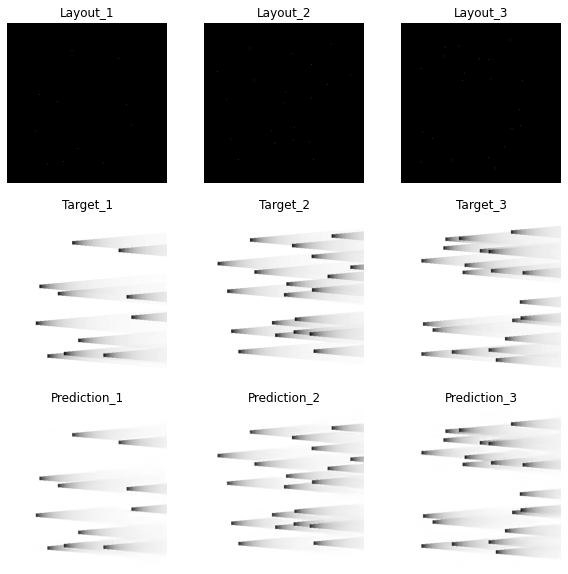

Epoch 136: , Train RMSE: 0.011301975841567728,Validation RMSE: 0.011522432755455938
Epoch 136: , Train loss: 4905.0108642578125,Validation loss: 637.2789916992188


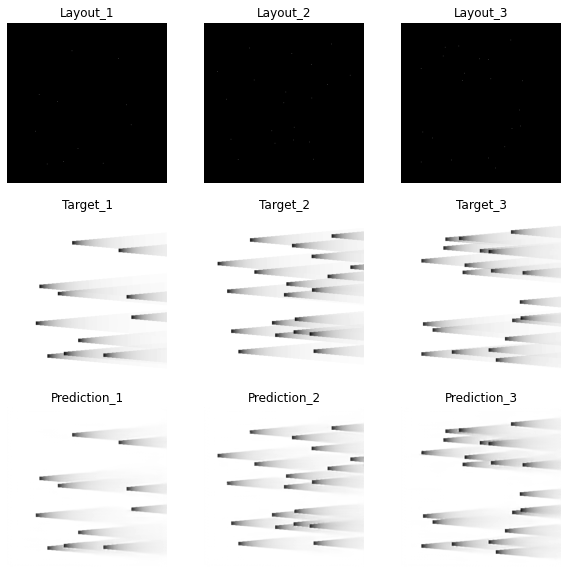

Epoch 137: , Train RMSE: 0.011346647426739827,Validation RMSE: 0.011647763514832404
Epoch 137: , Train loss: 4943.862060546875,Validation loss: 651.2178955078125


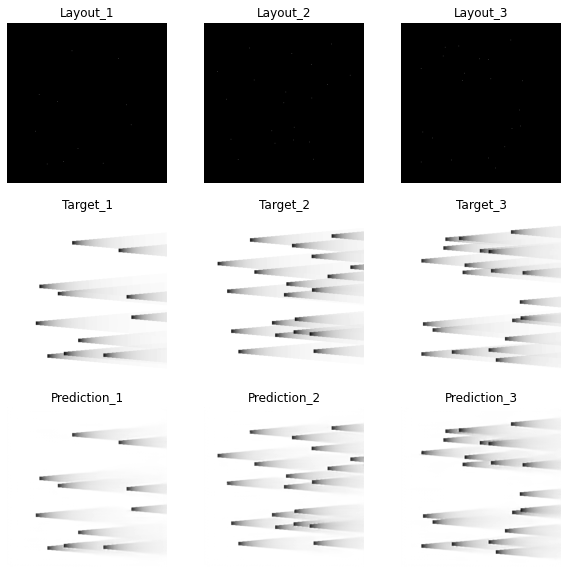

Epoch 138: , Train RMSE: 0.01140700023396007,Validation RMSE: 0.011754003505572768
Epoch 138: , Train loss: 4996.5947265625,Validation loss: 663.1516723632812


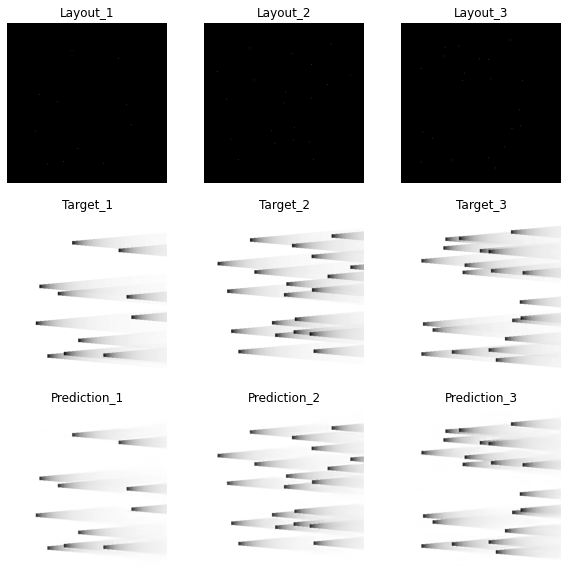

Epoch 139: , Train RMSE: 0.01145796512821338,Validation RMSE: 0.012006478838880274
Epoch 139: , Train loss: 5041.3426513671875,Validation loss: 691.9465637207031


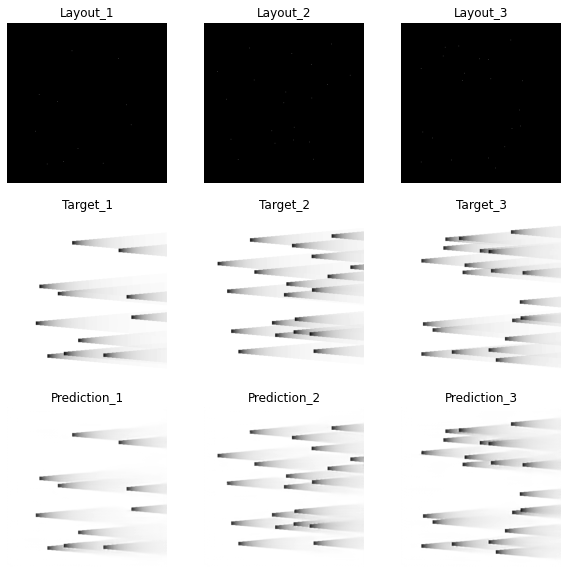

Epoch 140: , Train RMSE: 0.011545042726248497,Validation RMSE: 0.011931327142560986
Epoch 140: , Train loss: 5118.2596435546875,Validation loss: 683.3115234375


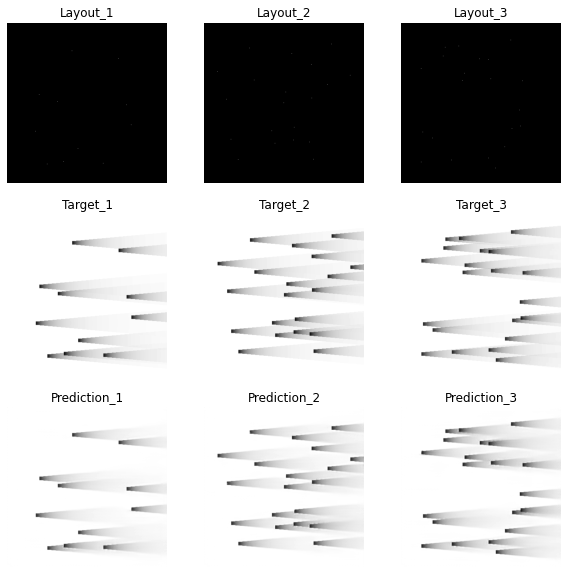

Epoch 141: , Train RMSE: 0.011392386873626854,Validation RMSE: 0.011621006761754262
Epoch 141: , Train loss: 4983.80078125,Validation loss: 648.2294311523438


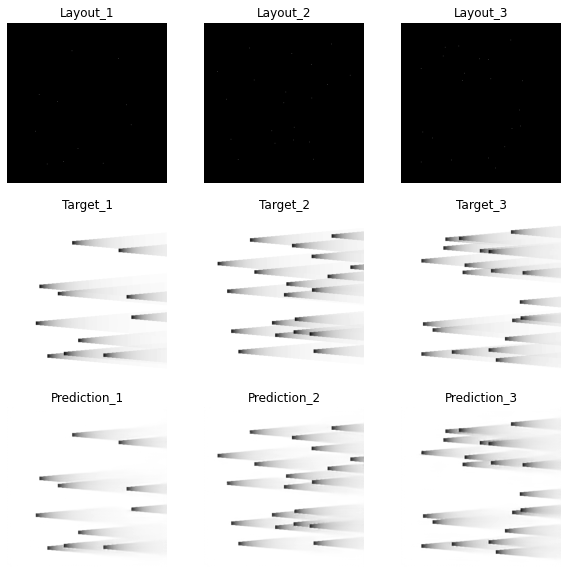

Epoch 142: , Train RMSE: 0.011152150844457758,Validation RMSE: 0.011363552495473536
Epoch 142: , Train loss: 4775.825988769531,Validation loss: 619.8255615234375


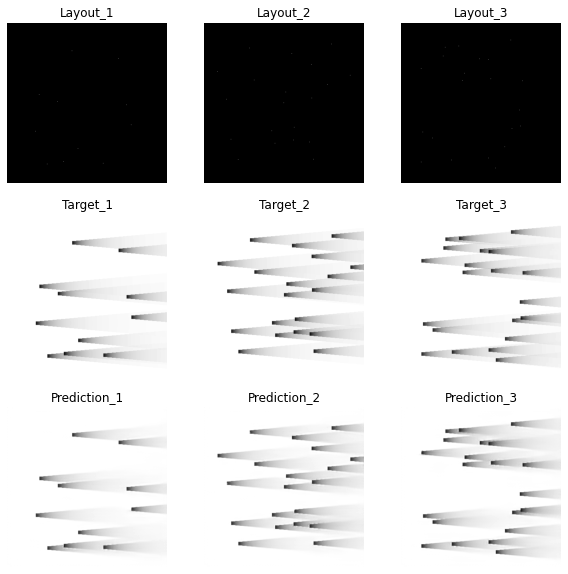

Epoch 143: , Train RMSE: 0.011041395807842738,Validation RMSE: 0.011304184866212244
Epoch 143: , Train loss: 4681.436981201172,Validation loss: 613.3660583496094


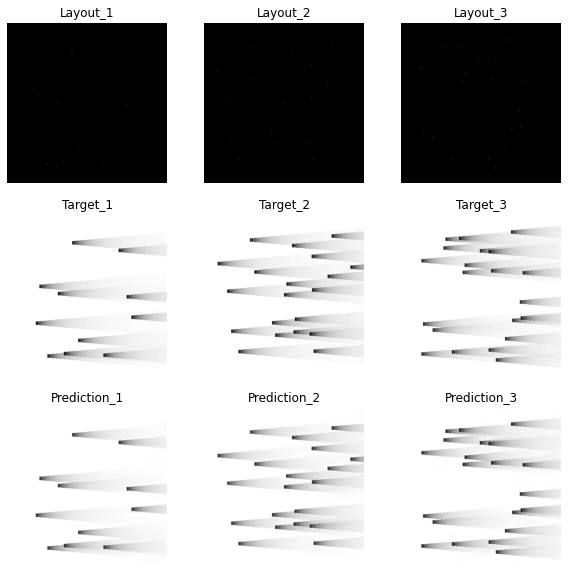

Epoch 144: , Train RMSE: 0.011007120226644079,Validation RMSE: 0.011136419486033776
Epoch 144: , Train loss: 4652.4171142578125,Validation loss: 595.2952270507812


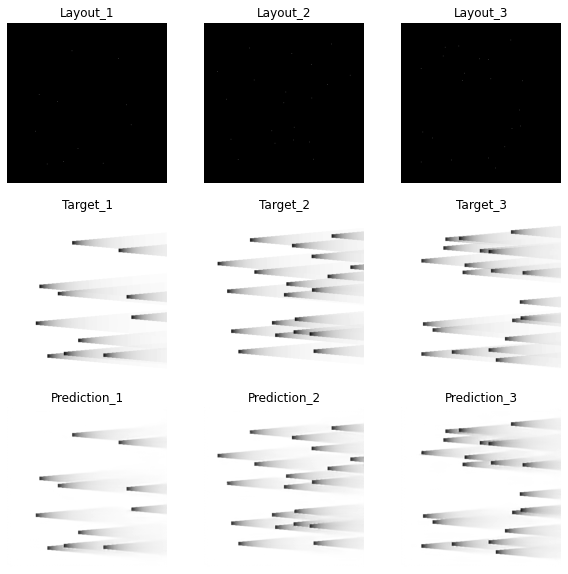

Epoch 145: , Train RMSE: 0.011024792871526275,Validation RMSE: 0.01119992790198962
Epoch 145: , Train loss: 4667.368621826172,Validation loss: 602.104248046875


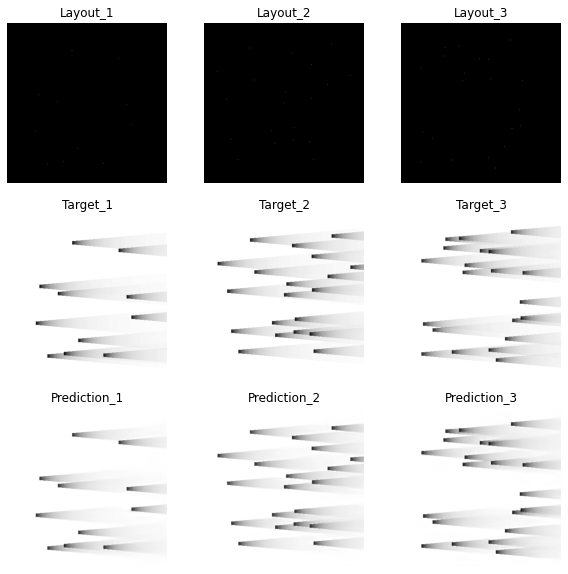

Epoch 146: , Train RMSE: 0.011106429219629066,Validation RMSE: 0.011575882598865122
Epoch 146: , Train loss: 4736.746368408203,Validation loss: 643.205078125


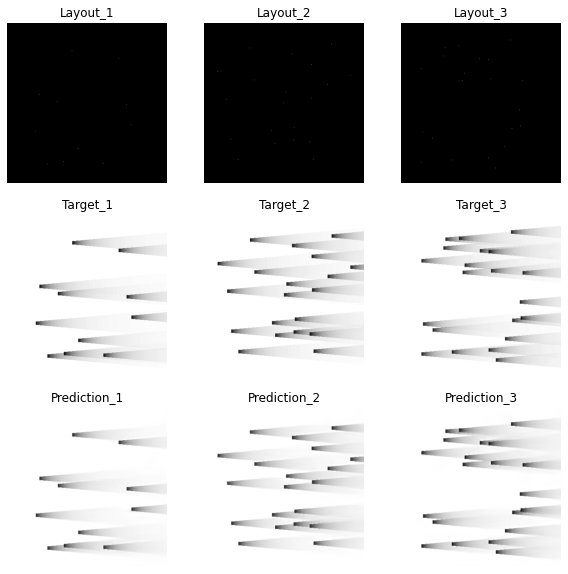

Epoch 147: , Train RMSE: 0.011331462289596363,Validation RMSE: 0.012485166267588487
Epoch 147: , Train loss: 4930.638244628906,Validation loss: 748.2210083007812


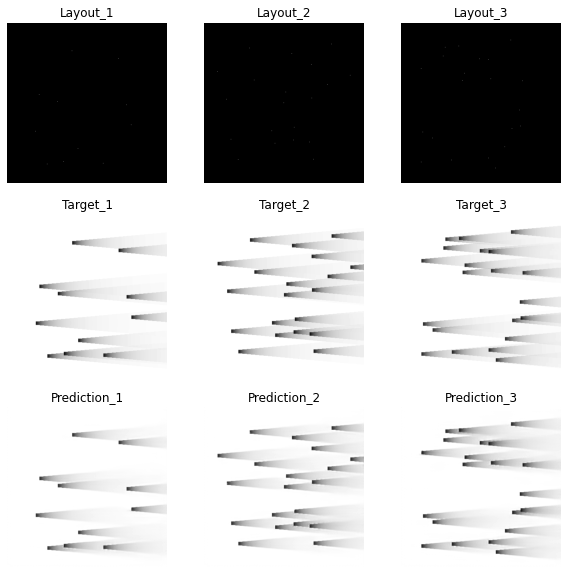

Epoch 148: , Train RMSE: 0.011692554475696686,Validation RMSE: 0.012431991456328754
Epoch 148: , Train loss: 5249.887878417969,Validation loss: 741.8611755371094


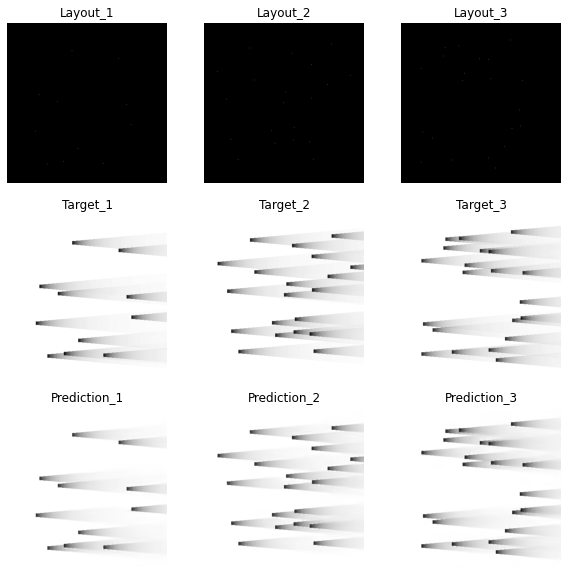

Epoch 149: , Train RMSE: 0.011432894830571083,Validation RMSE: 0.011624005292222213
Epoch 149: , Train loss: 5019.305633544922,Validation loss: 648.5639953613281


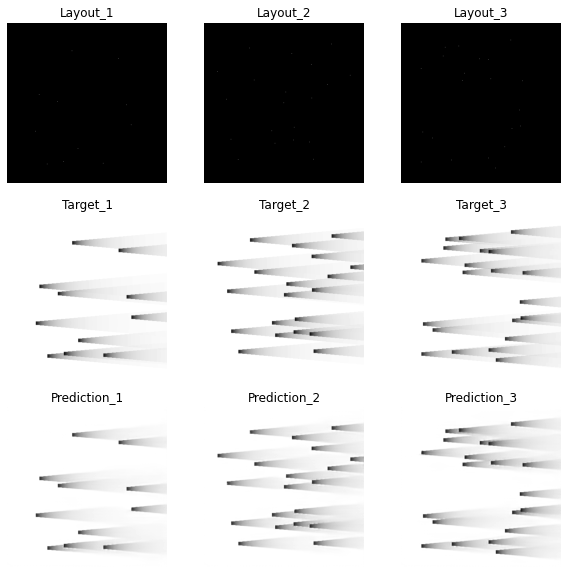

Epoch 150: , Train RMSE: 0.01112635767792424,Validation RMSE: 0.011856367518101143
Epoch 150: , Train loss: 4753.760070800781,Validation loss: 674.7525634765625


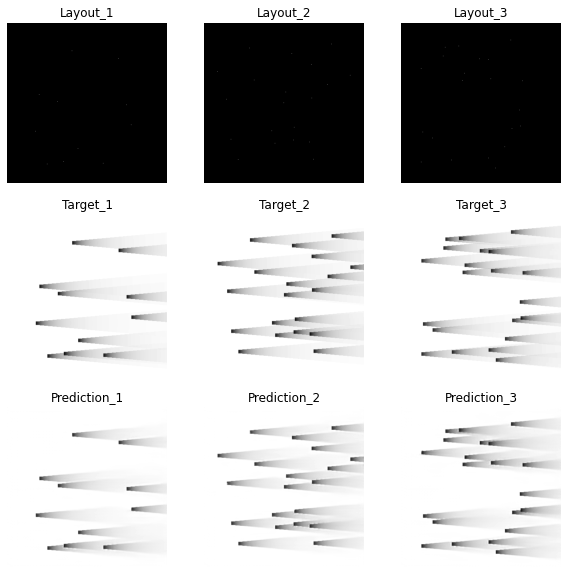

Epoch 151: , Train RMSE: 0.011067769069130992,Validation RMSE: 0.011042065499258227
Epoch 151: , Train loss: 4703.827667236328,Validation loss: 585.2506103515625


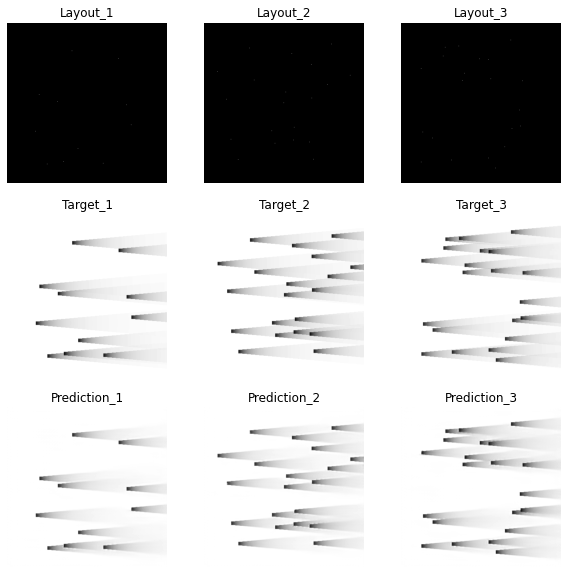

Epoch 152: , Train RMSE: 0.010970631292279,Validation RMSE: 0.011085255124017254
Epoch 152: , Train loss: 4621.6224365234375,Validation loss: 589.8378295898438


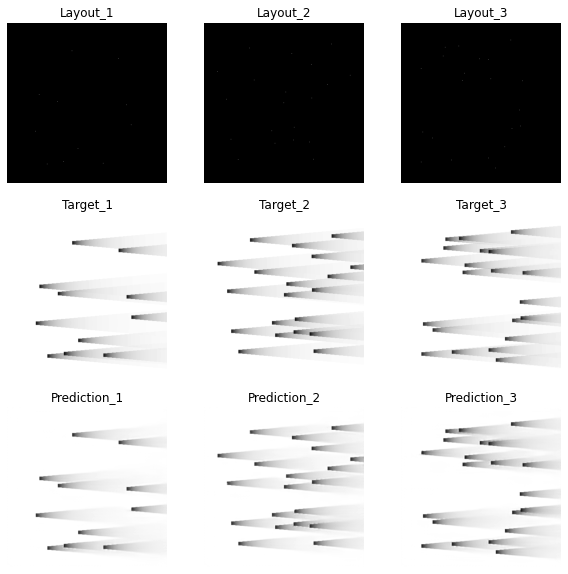

Epoch 153: , Train RMSE: 0.010840681054021783,Validation RMSE: 0.010860069051467997
Epoch 153: , Train loss: 4512.782043457031,Validation loss: 566.1172790527344


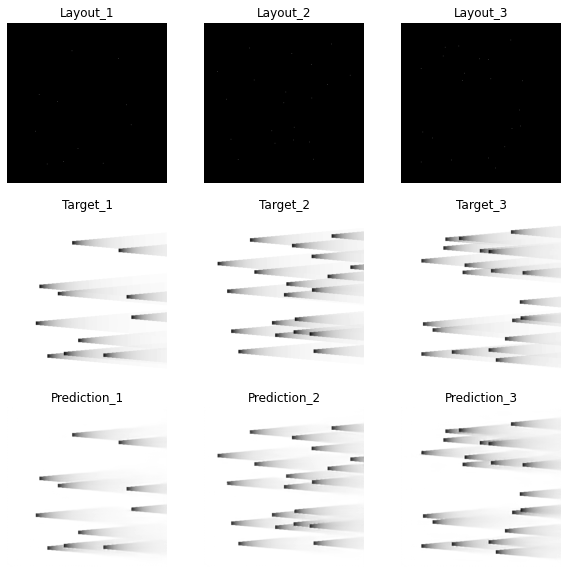

Epoch 154: , Train RMSE: 0.010570982857983496,Validation RMSE: 0.010702767396322255
Epoch 154: , Train loss: 4291.0340576171875,Validation loss: 549.8363037109375


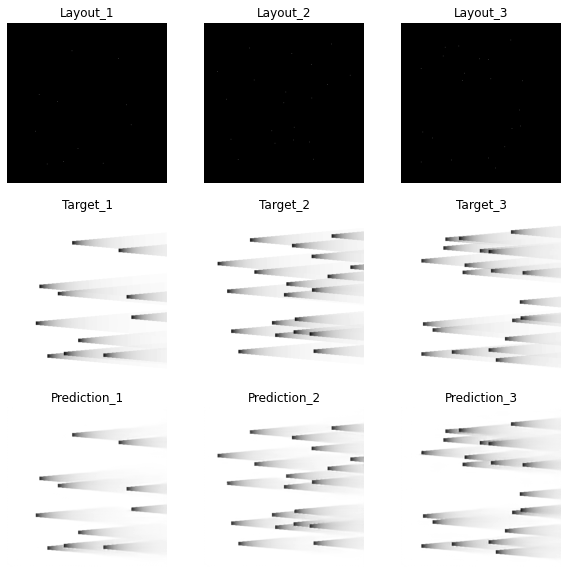

Epoch 155: , Train RMSE: 0.010451948775414464,Validation RMSE: 0.010614193076514452
Epoch 155: , Train loss: 4194.940155029297,Validation loss: 540.7732543945312


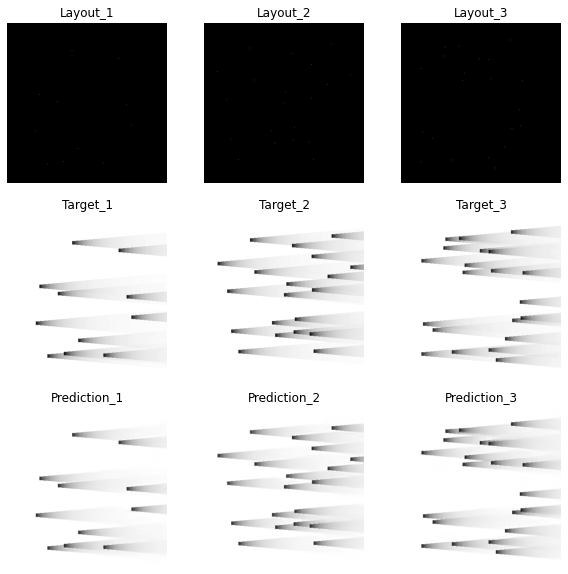

Epoch 156: , Train RMSE: 0.010368904069396235,Validation RMSE: 0.01057670567962668
Epoch 156: , Train loss: 4128.544189453125,Validation loss: 536.9601745605469


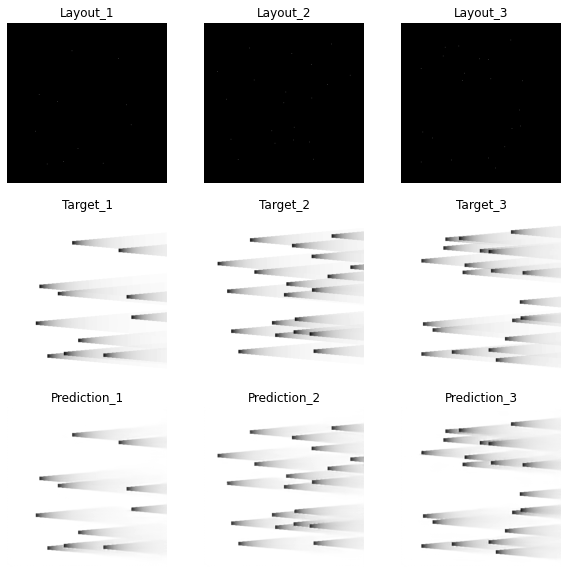

Epoch 157: , Train RMSE: 0.010338761232032005,Validation RMSE: 0.010602710456513382
Epoch 157: , Train loss: 4104.575378417969,Validation loss: 539.6038513183594


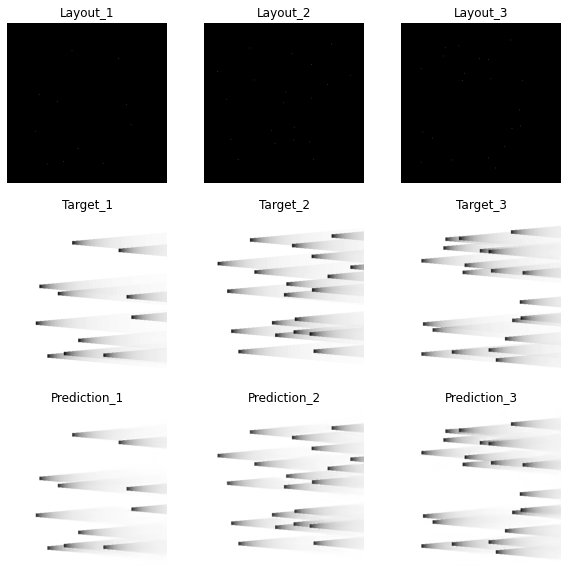

Epoch 158: , Train RMSE: 0.01033555807242341,Validation RMSE: 0.010669240958789841
Epoch 158: , Train loss: 4102.032409667969,Validation loss: 546.39697265625


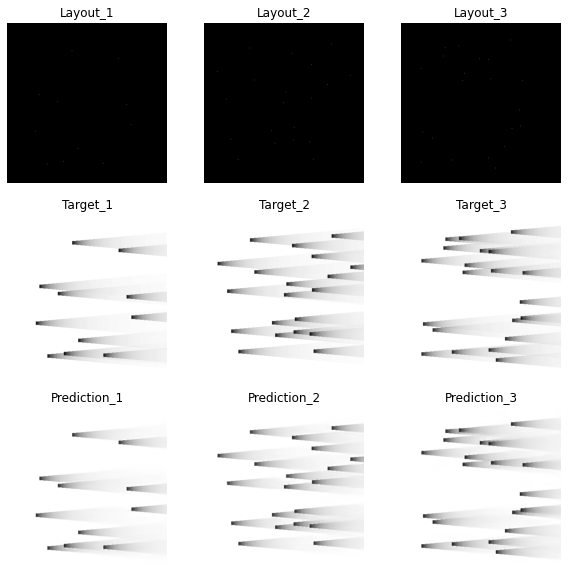

Epoch 159: , Train RMSE: 0.010329632639918387,Validation RMSE: 0.010724333825870383
Epoch 159: , Train loss: 4097.330322265625,Validation loss: 552.0544128417969


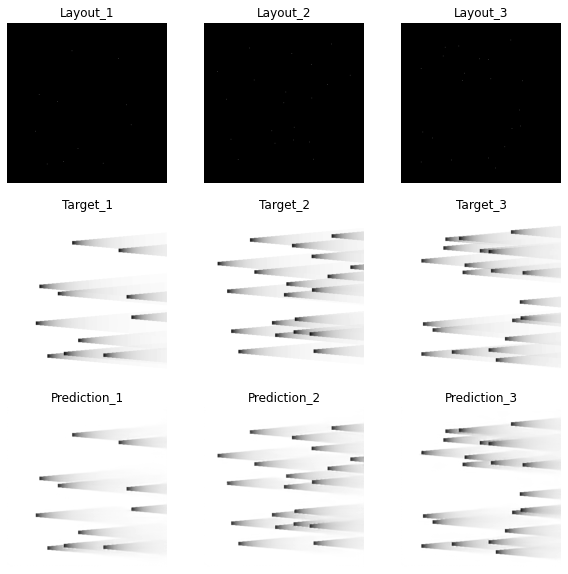

Epoch 160: , Train RMSE: 0.010311643430026912,Validation RMSE: 0.010734817843716618
Epoch 160: , Train loss: 4083.0716247558594,Validation loss: 553.1343078613281


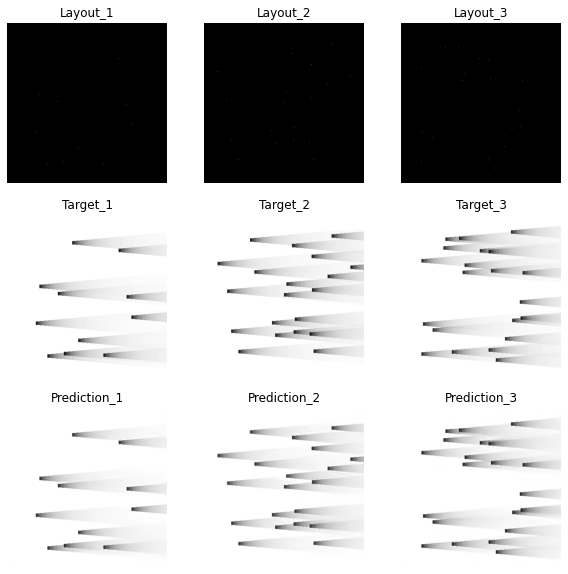

Epoch 161: , Train RMSE: 0.010277427256394855,Validation RMSE: 0.01064898129457953
Epoch 161: , Train loss: 4056.0196228027344,Validation loss: 544.3238525390625


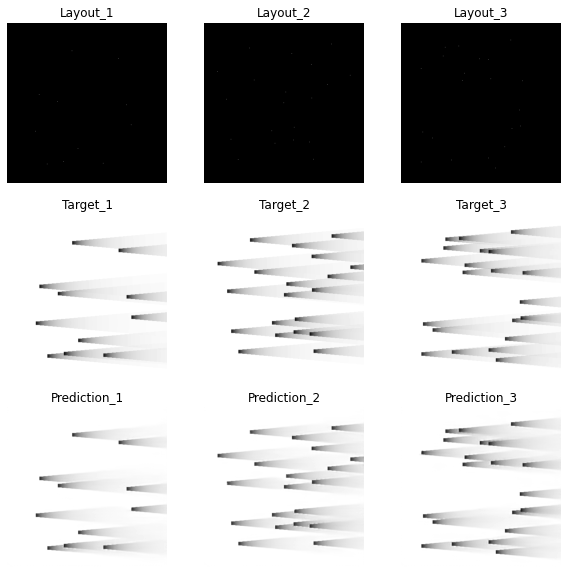

Epoch 162: , Train RMSE: 0.010245168880983953,Validation RMSE: 0.010577411366464548
Epoch 162: , Train loss: 4030.5978393554688,Validation loss: 537.0318298339844


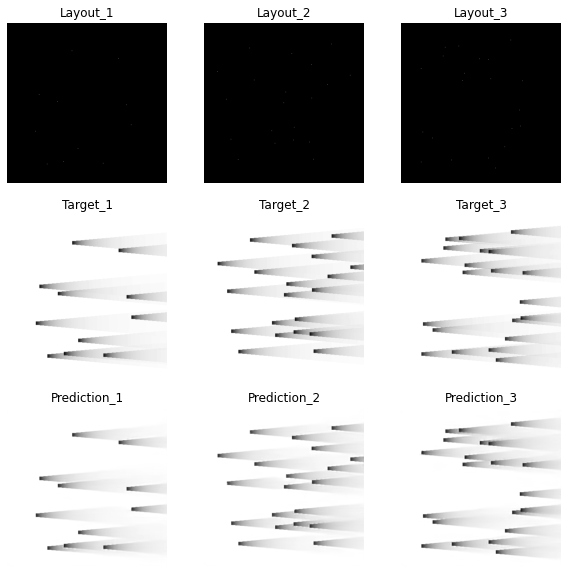

Epoch 163: , Train RMSE: 0.010265827875634173,Validation RMSE: 0.010606329277070487
Epoch 163: , Train loss: 4046.8693237304688,Validation loss: 539.9722595214844


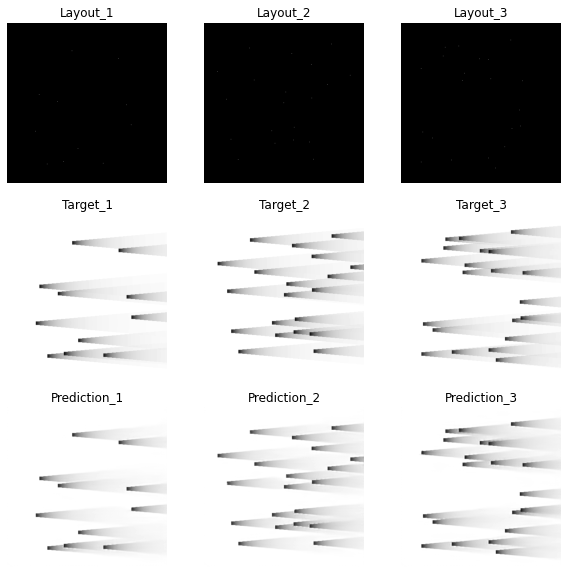

Epoch 164: , Train RMSE: 0.01033811163148038,Validation RMSE: 0.010618394481327391
Epoch 164: , Train loss: 4104.059600830078,Validation loss: 541.2014465332031


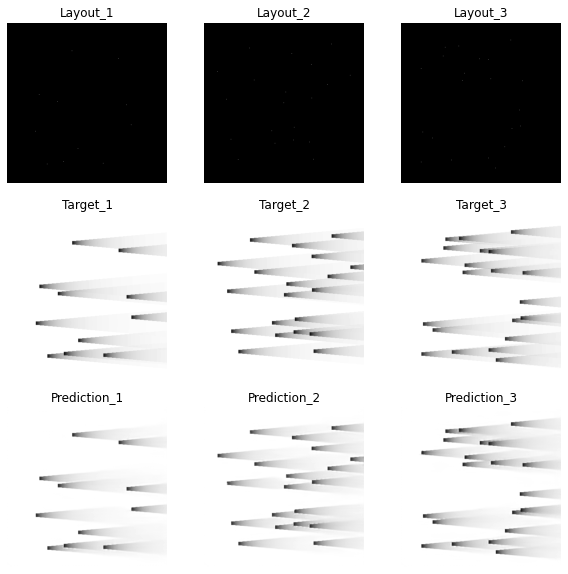

Epoch 165: , Train RMSE: 0.010451889809017028,Validation RMSE: 0.010758692930452906
Epoch 165: , Train loss: 4194.892822265625,Validation loss: 555.5974731445312


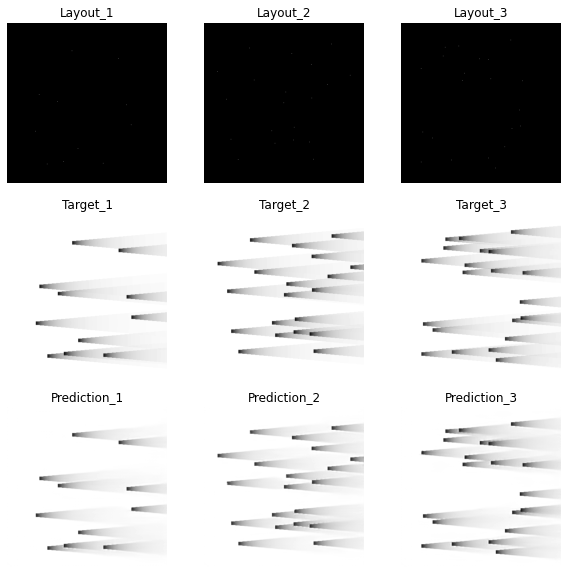

Epoch 166: , Train RMSE: 0.010664755029048262,Validation RMSE: 0.011143059976708877
Epoch 166: , Train loss: 4367.500793457031,Validation loss: 596.00537109375


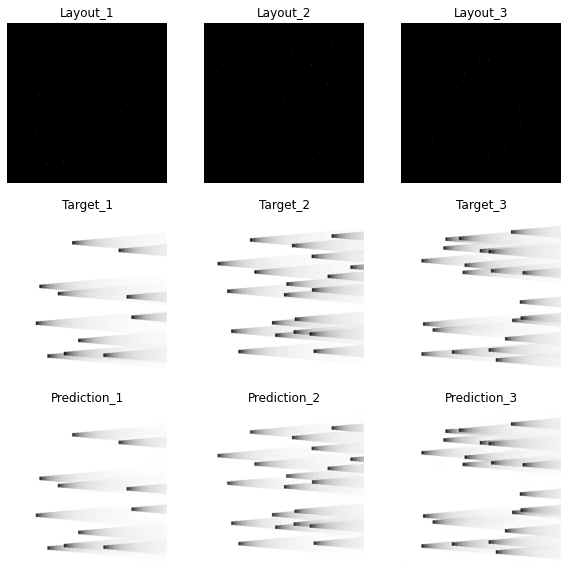

Epoch 167: , Train RMSE: 0.010860388912007158,Validation RMSE: 0.011121160751978823
Epoch 167: , Train loss: 4529.205017089844,Validation loss: 593.6650390625


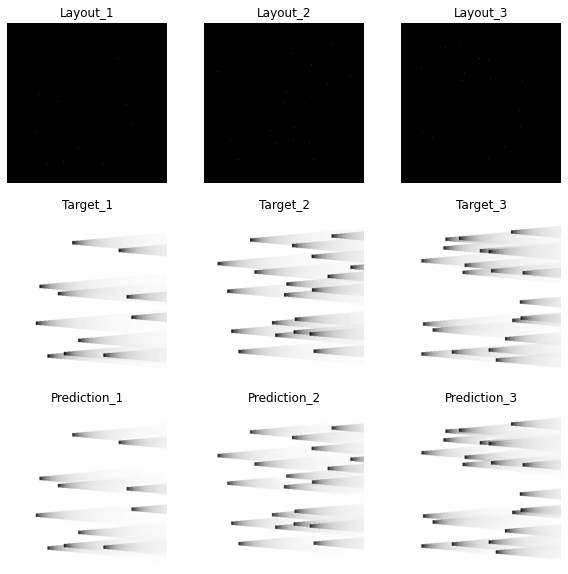

Epoch 168: , Train RMSE: 0.010876592512198476,Validation RMSE: 0.010935051925621943
Epoch 168: , Train loss: 4542.730163574219,Validation loss: 573.9617309570312


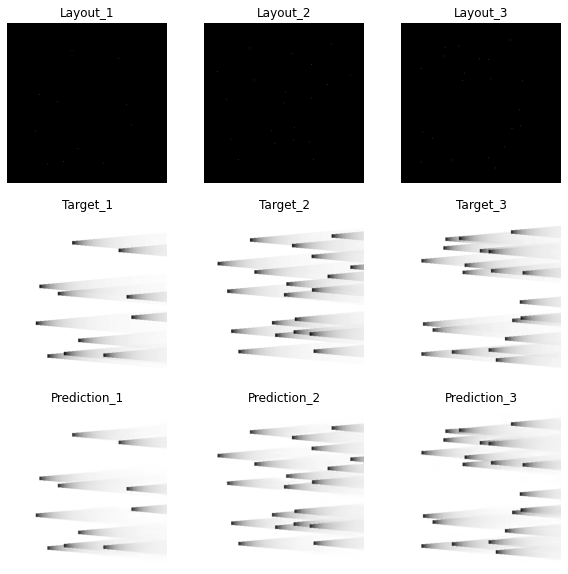

Epoch 169: , Train RMSE: 0.010500351347418824,Validation RMSE: 0.010726104496871907
Epoch 169: , Train loss: 4233.883331298828,Validation loss: 552.2367248535156


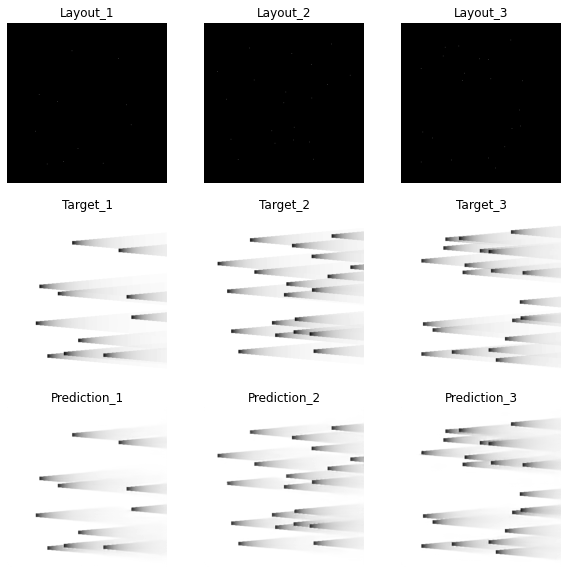

Epoch 170: , Train RMSE: 0.010248286646795913,Validation RMSE: 0.010735656158383691
Epoch 170: , Train loss: 4033.0513610839844,Validation loss: 553.220703125


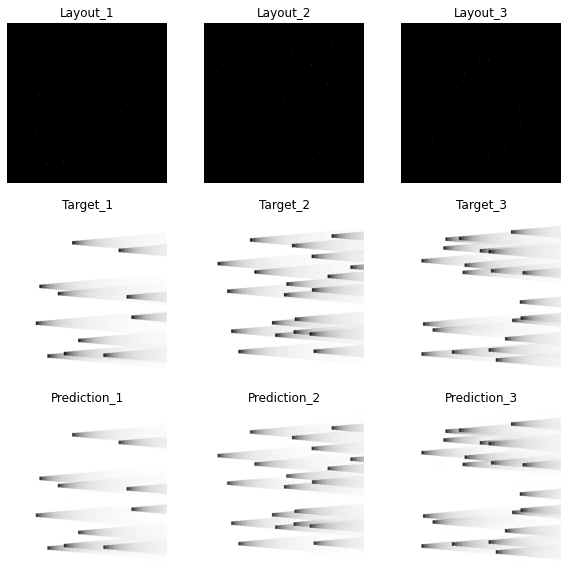

Epoch 171: , Train RMSE: 0.01019796597576332,Validation RMSE: 0.010231136052159896
Epoch 171: , Train loss: 3993.5427856445312,Validation loss: 502.44549560546875


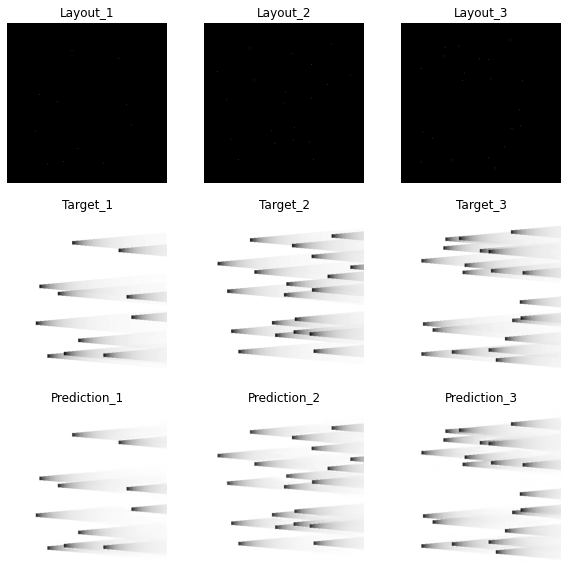

Epoch 172: , Train RMSE: 0.010034450436394378,Validation RMSE: 0.010136976529116336
Epoch 172: , Train loss: 3866.5035095214844,Validation loss: 493.23980712890625


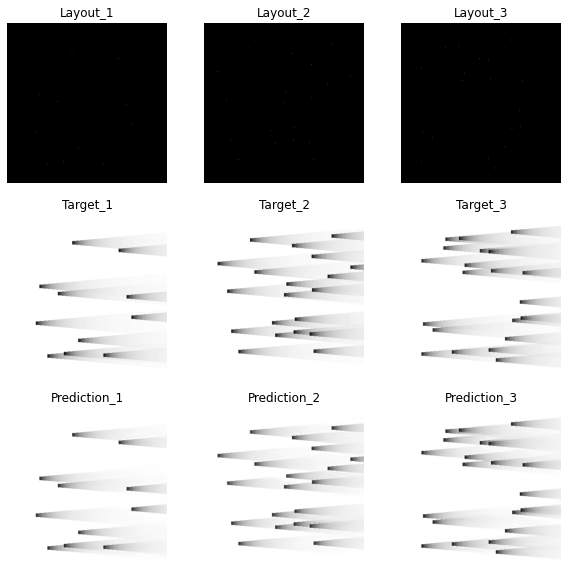

Epoch 173: , Train RMSE: 0.009997807977754243,Validation RMSE: 0.010437972798555854
Epoch 173: , Train loss: 3838.3167114257812,Validation loss: 522.9661254882812


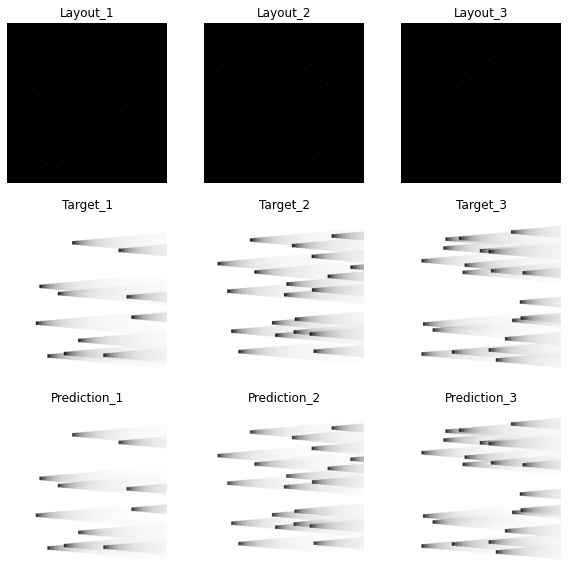

Epoch 174: , Train RMSE: 0.0100222525169956,Validation RMSE: 0.010378006771355728
Epoch 174: , Train loss: 3857.1089477539062,Validation loss: 516.9745178222656


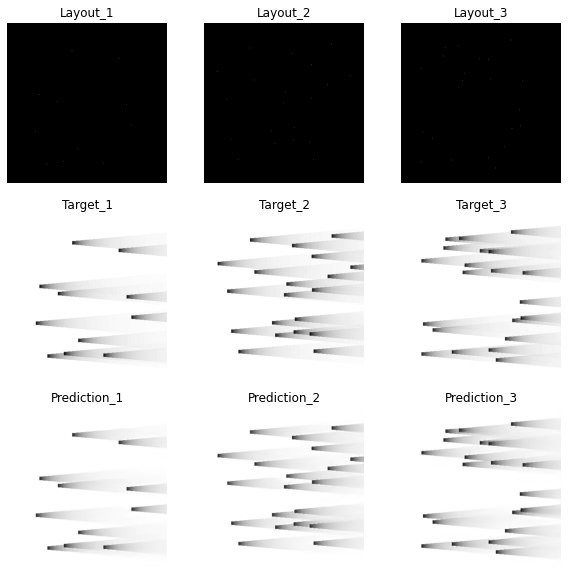

Epoch 175: , Train RMSE: 0.009941294091771748,Validation RMSE: 0.010011313714129373
Epoch 175: , Train loss: 3795.0462036132812,Validation loss: 481.08673095703125


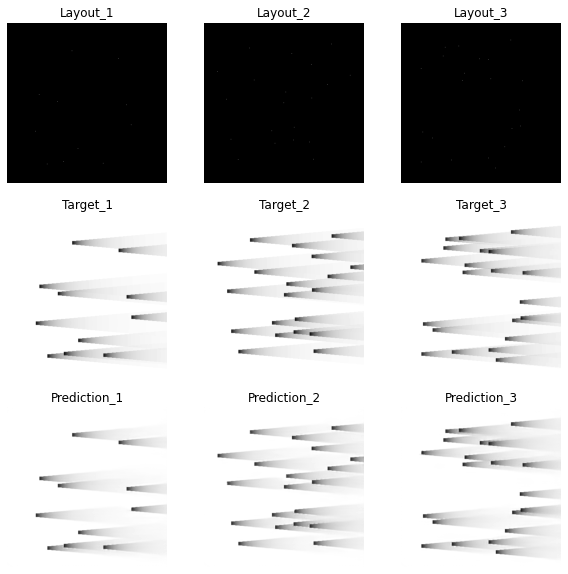

Epoch 176: , Train RMSE: 0.009839167744452936,Validation RMSE: 0.010081927072705344
Epoch 176: , Train loss: 3717.47412109375,Validation loss: 487.897216796875


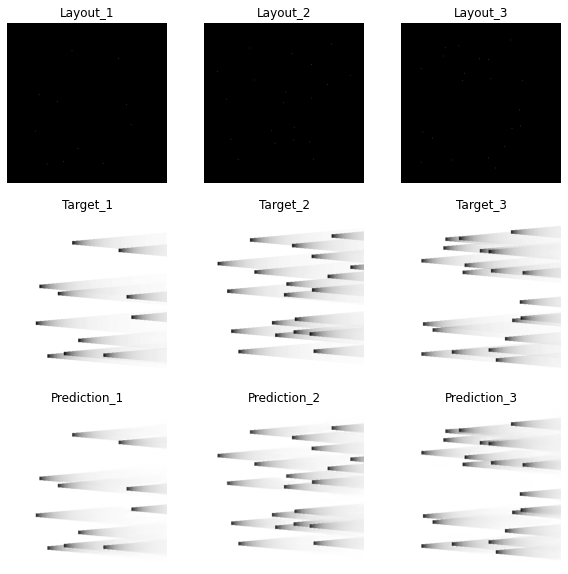

Epoch 177: , Train RMSE: 0.009847373699092672,Validation RMSE: 0.010487095486974919
Epoch 177: , Train loss: 3723.677520751953,Validation loss: 527.9000244140625


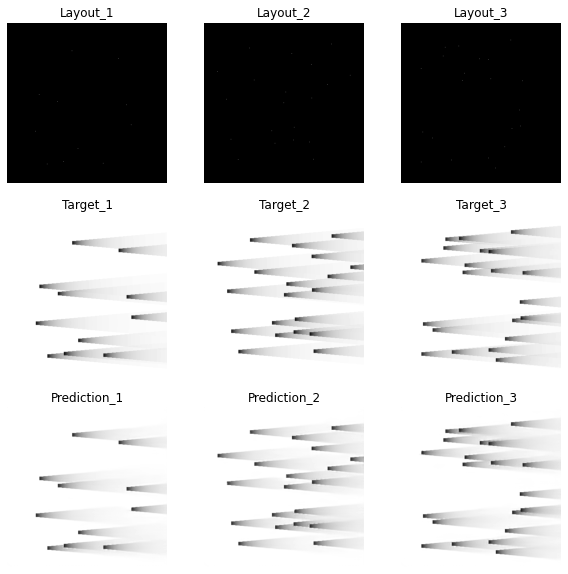

Epoch 178: , Train RMSE: 0.009931066025697785,Validation RMSE: 0.010371637036784242
Epoch 178: , Train loss: 3787.241180419922,Validation loss: 516.3401031494141


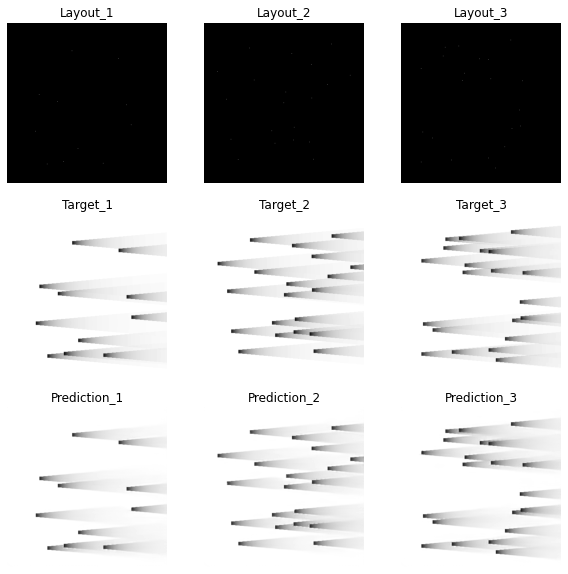

Epoch 179: , Train RMSE: 0.009827609721363534,Validation RMSE: 0.009874394426408608
Epoch 179: , Train loss: 3708.7454528808594,Validation loss: 468.01759338378906


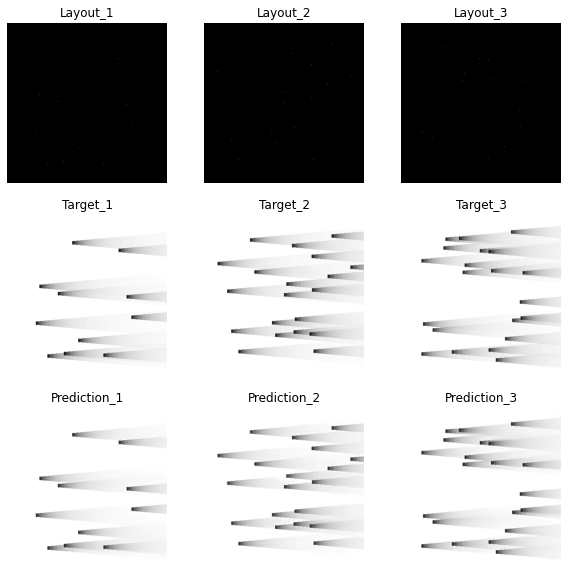

Epoch 180: , Train RMSE: 0.00973551110525848,Validation RMSE: 0.010173499068047187
Epoch 180: , Train loss: 3639.5587768554688,Validation loss: 496.80039978027344


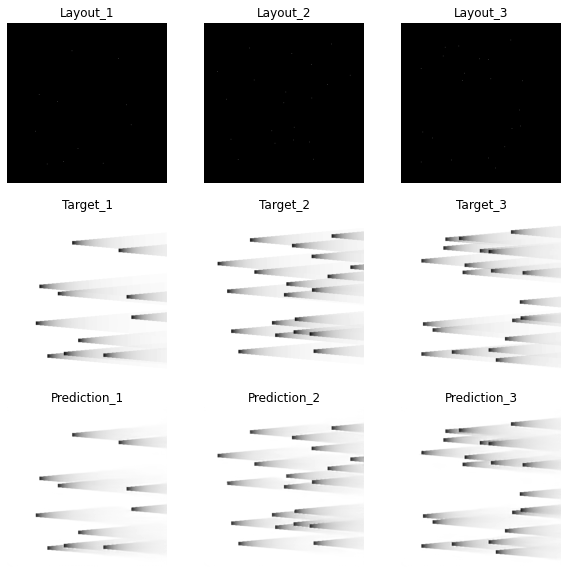

Epoch 181: , Train RMSE: 0.009826002117104216,Validation RMSE: 0.010486622296154768
Epoch 181: , Train loss: 3707.532196044922,Validation loss: 527.8523864746094


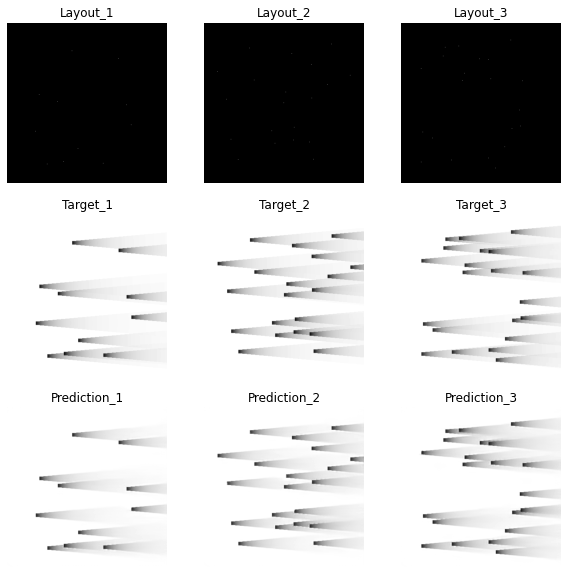

Epoch 182: , Train RMSE: 0.009817230874078646,Validation RMSE: 0.009806025156717996
Epoch 182: , Train loss: 3700.916046142578,Validation loss: 461.55902099609375


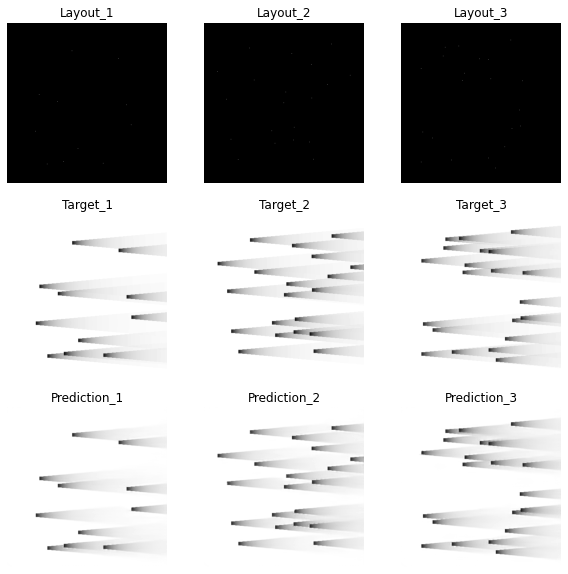

Epoch 183: , Train RMSE: 0.009652264658388907,Validation RMSE: 0.009953983287844003
Epoch 183: , Train loss: 3577.5825805664062,Validation loss: 475.5925598144531


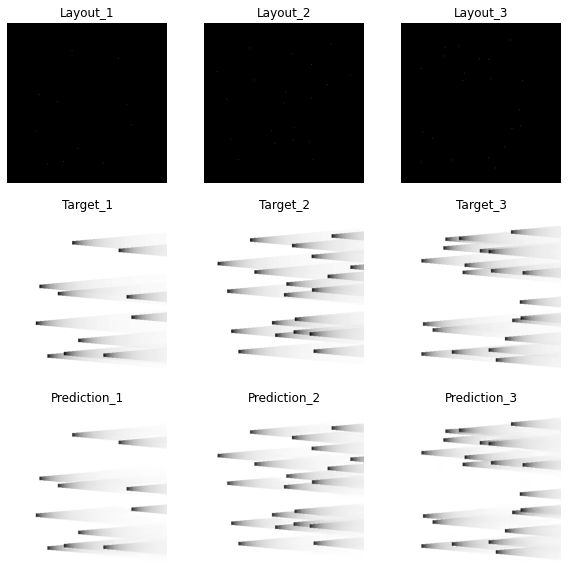

Epoch 184: , Train RMSE: 0.009702908106543602,Validation RMSE: 0.010288194315127822
Epoch 184: , Train loss: 3615.2227478027344,Validation loss: 508.06532287597656


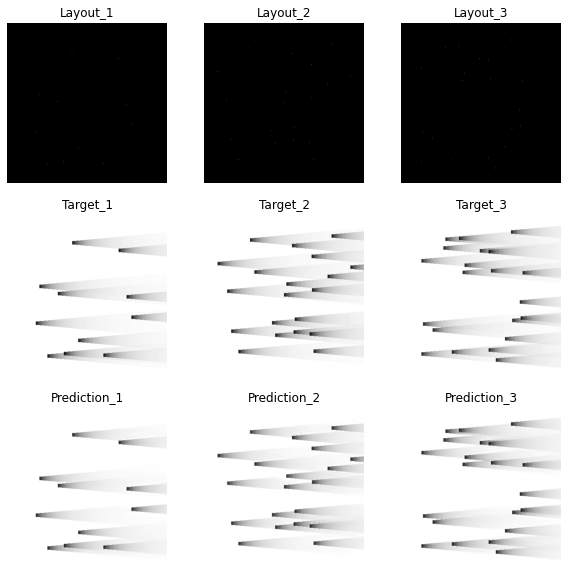

Epoch 185: , Train RMSE: 0.009687502871277086,Validation RMSE: 0.009674462353917227
Epoch 185: , Train loss: 3603.7521362304688,Validation loss: 449.25706481933594


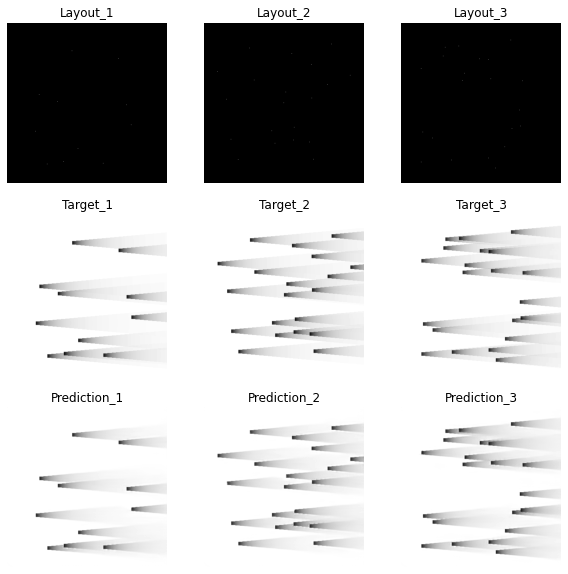

Epoch 186: , Train RMSE: 0.0094976072811726,Validation RMSE: 0.009829805377056751
Epoch 186: , Train loss: 3463.8544921875,Validation loss: 463.80035400390625


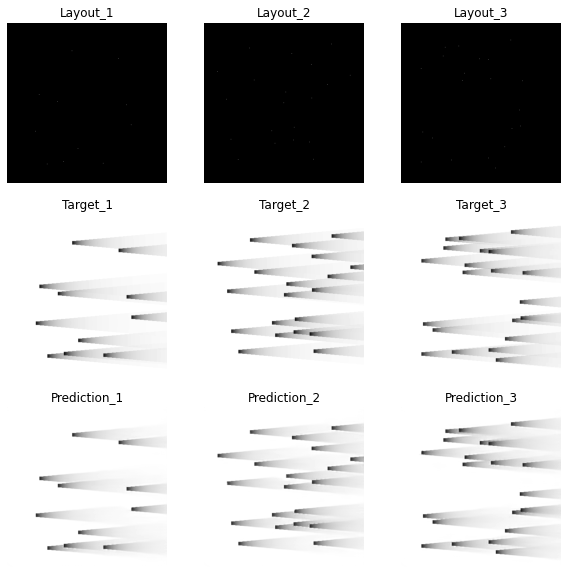

Epoch 187: , Train RMSE: 0.009517738813231988,Validation RMSE: 0.009850670213699047
Epoch 187: , Train loss: 3478.5543212890625,Validation loss: 465.77137756347656


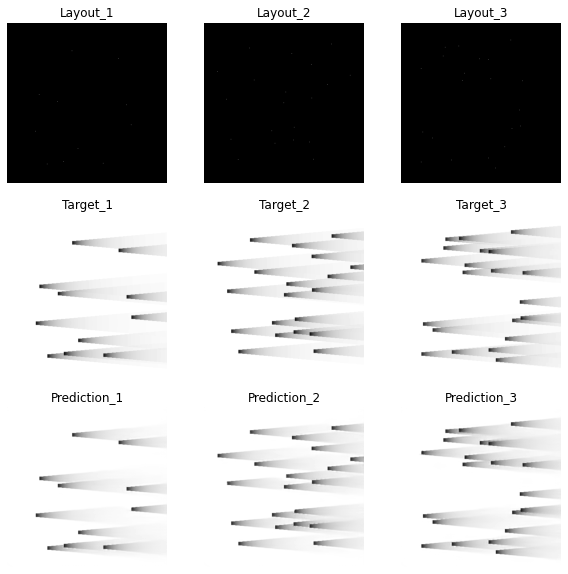

Epoch 188: , Train RMSE: 0.009439428742899058,Validation RMSE: 0.00954561678705874
Epoch 188: , Train loss: 3421.548095703125,Validation loss: 437.3702392578125


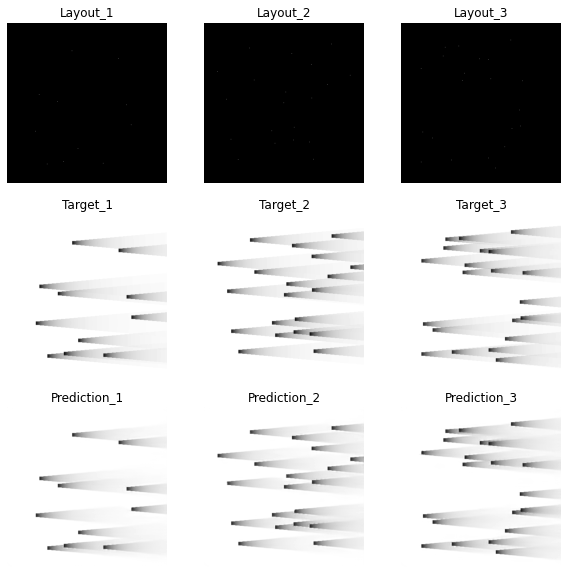

Epoch 189: , Train RMSE: 0.009356950720821954,Validation RMSE: 0.009794934856879068
Epoch 189: , Train loss: 3362.0170288085938,Validation loss: 460.5155944824219


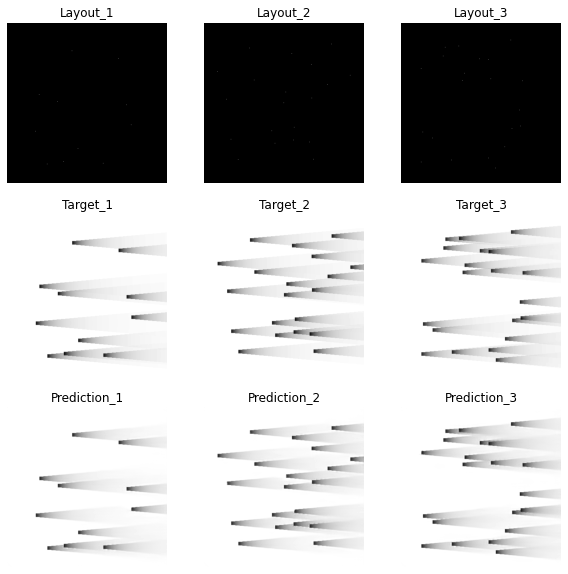

Epoch 190: , Train RMSE: 0.009401512338509666,Validation RMSE: 0.009732122218758833
Epoch 190: , Train loss: 3394.1158752441406,Validation loss: 454.628173828125


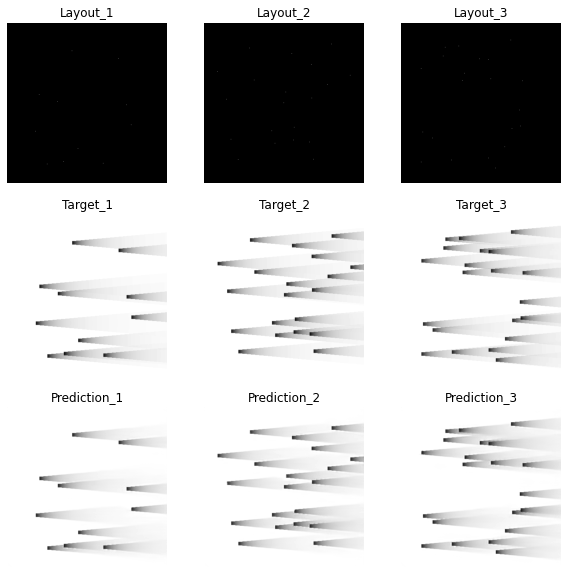

Epoch 191: , Train RMSE: 0.009338527389376454,Validation RMSE: 0.009459982998424734
Epoch 191: , Train loss: 3348.790802001953,Validation loss: 429.5581359863281


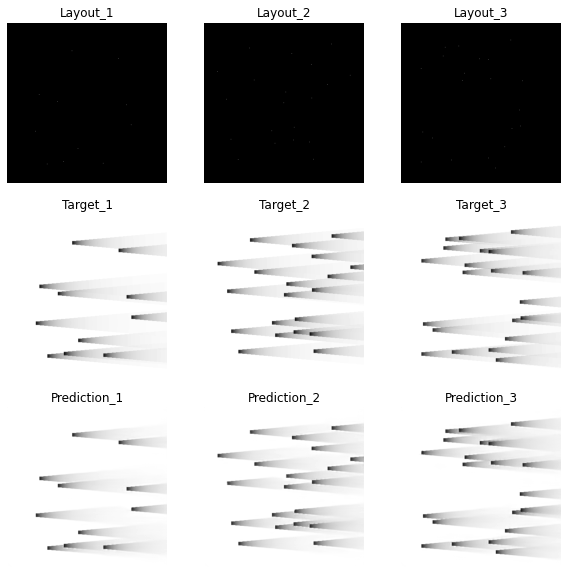

Epoch 192: , Train RMSE: 0.009264423183060316,Validation RMSE: 0.009661518161859202
Epoch 192: , Train loss: 3295.854217529297,Validation loss: 448.05567932128906


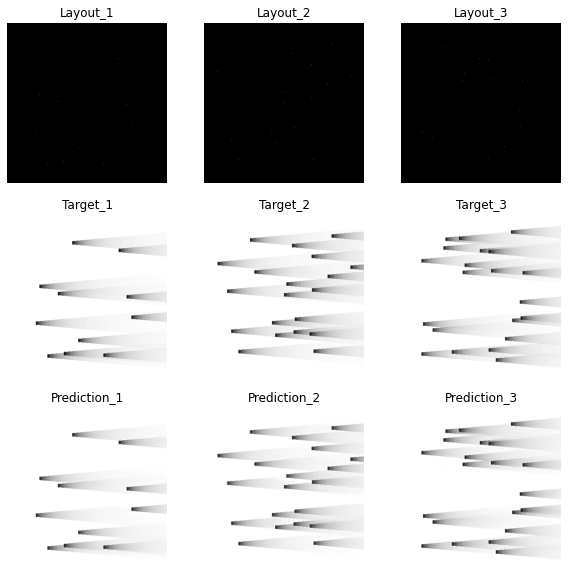

Epoch 193: , Train RMSE: 0.00929652096370766,Validation RMSE: 0.009647905219218239
Epoch 193: , Train loss: 3318.7315979003906,Validation loss: 446.79396057128906


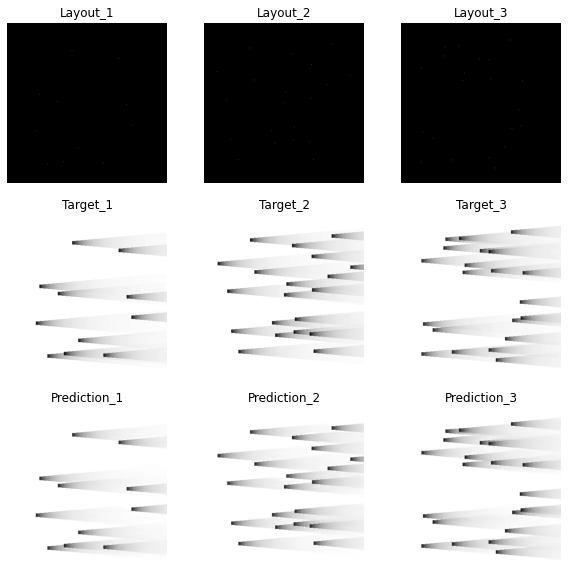

Epoch 194: , Train RMSE: 0.00923774181078723,Validation RMSE: 0.009424265628337496
Epoch 194: , Train loss: 3276.8975524902344,Validation loss: 426.320556640625


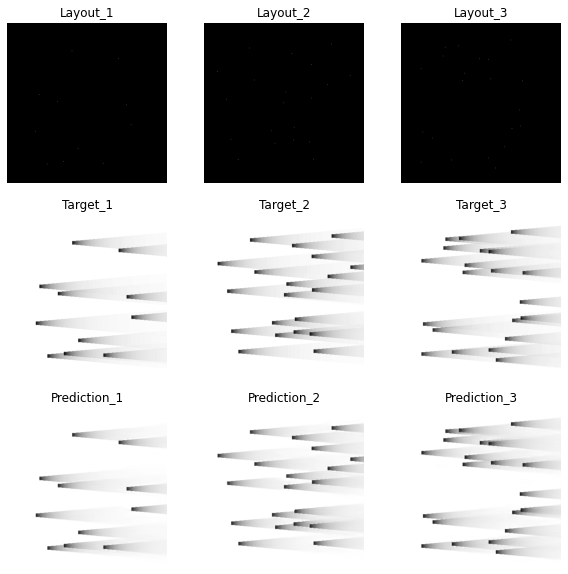

Epoch 195: , Train RMSE: 0.00920228265384241,Validation RMSE: 0.009586038180120224
Epoch 195: , Train loss: 3251.789031982422,Validation loss: 441.08221435546875


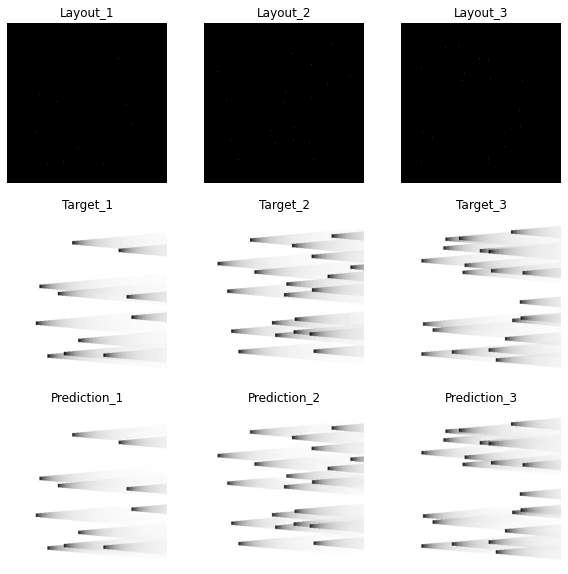

Epoch 196: , Train RMSE: 0.009254069455555245,Validation RMSE: 0.00967144659405191
Epoch 196: , Train loss: 3288.4915771484375,Validation loss: 448.9770202636719


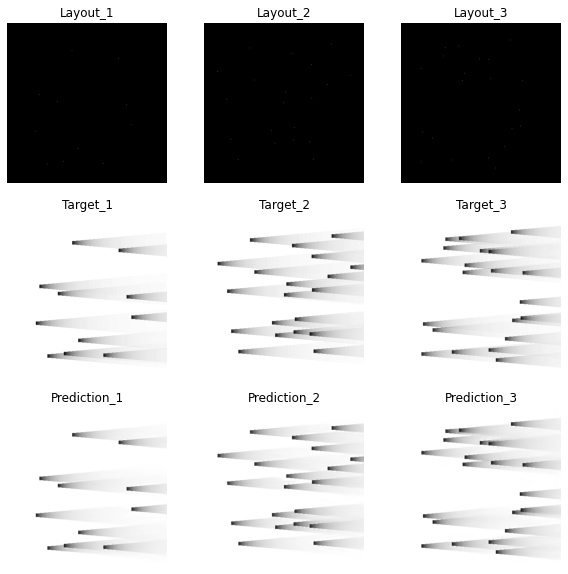

Epoch 197: , Train RMSE: 0.00924434341991633,Validation RMSE: 0.009546196896309308
Epoch 197: , Train loss: 3281.582794189453,Validation loss: 437.42340087890625


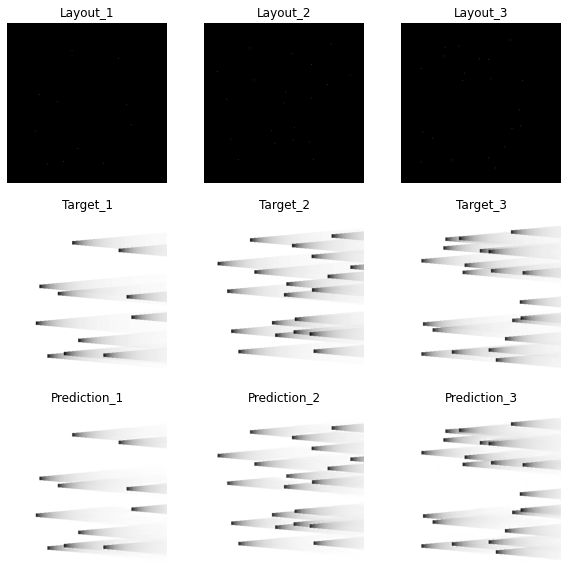

Epoch 198: , Train RMSE: 0.00922887825497298,Validation RMSE: 0.009414425833669799
Epoch 198: , Train loss: 3270.6122436523438,Validation loss: 425.4307861328125


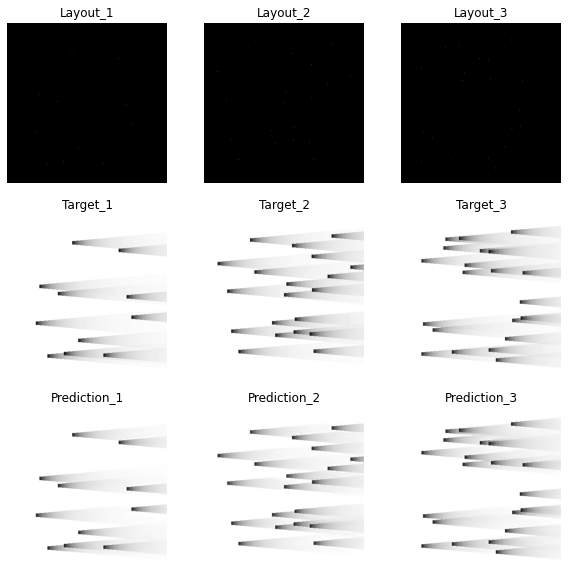

Epoch 199: , Train RMSE: 0.009209125386921884,Validation RMSE: 0.009865370807951692
Epoch 199: , Train loss: 3256.6268310546875,Validation loss: 467.16259765625


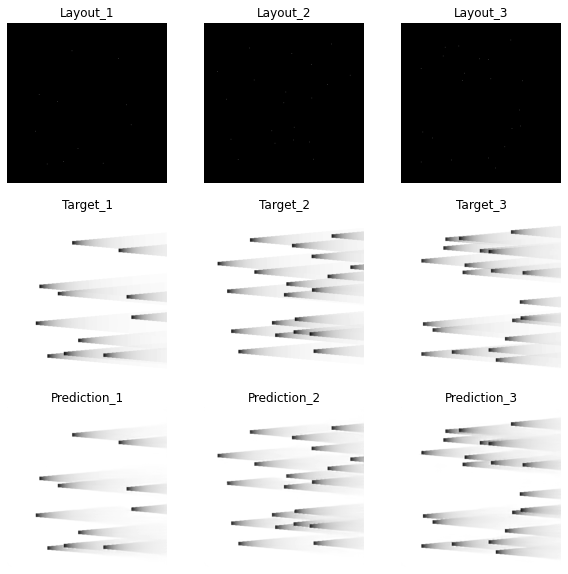

Epoch 200: , Train RMSE: 0.009268094776305021,Validation RMSE: 0.009676100556093813
Epoch 200: , Train loss: 3298.4671020507812,Validation loss: 449.4092254638672


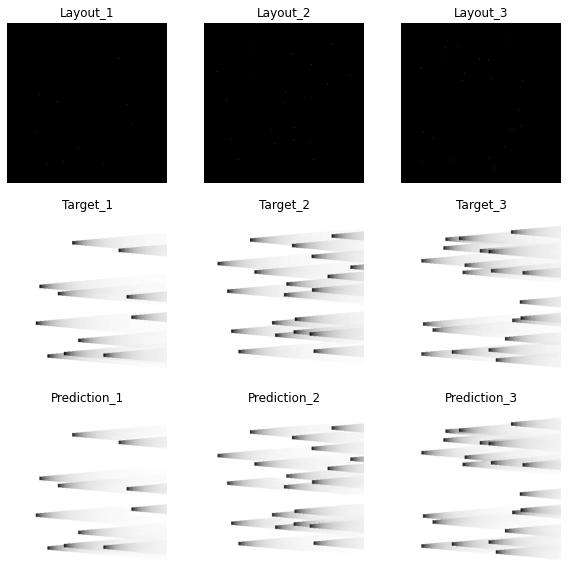

Epoch 201: , Train RMSE: 0.009215424708409038,Validation RMSE: 0.009616946165980491
Epoch 201: , Train loss: 3261.0836181640625,Validation loss: 443.93113708496094


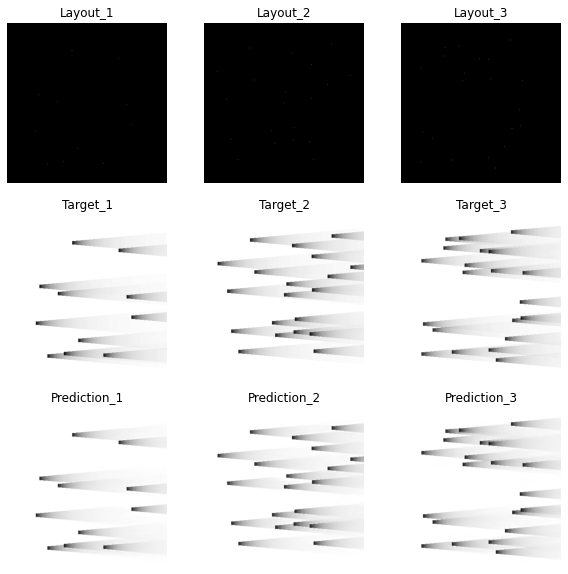

Epoch 202: , Train RMSE: 0.009318324842504286,Validation RMSE: 0.009720407849508316
Epoch 202: , Train loss: 3334.3172302246094,Validation loss: 453.5343780517578


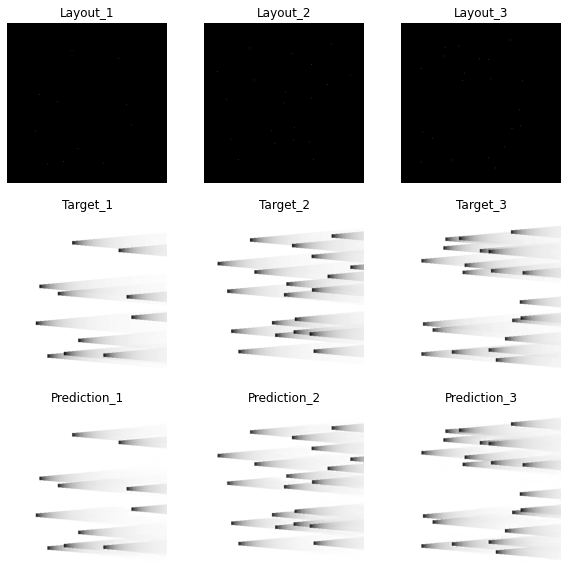

Epoch 203: , Train RMSE: 0.009298382847853488,Validation RMSE: 0.009351419760608716
Epoch 203: , Train loss: 3320.061065673828,Validation loss: 419.7554473876953


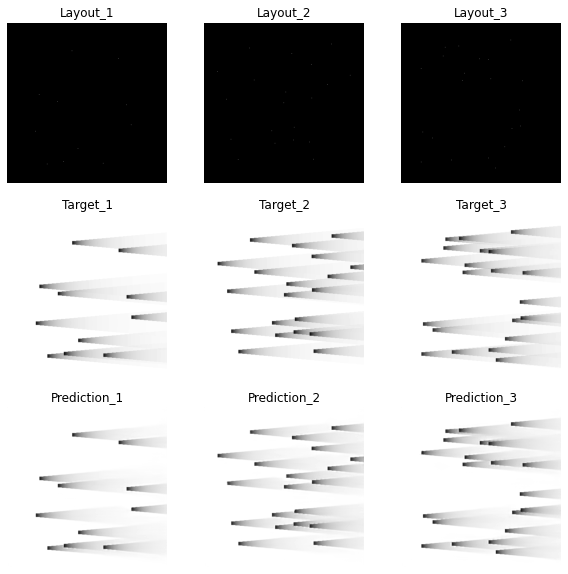

Epoch 204: , Train RMSE: 0.009292057744735568,Validation RMSE: 0.009412468866344904
Epoch 204: , Train loss: 3315.5457458496094,Validation loss: 425.2539367675781


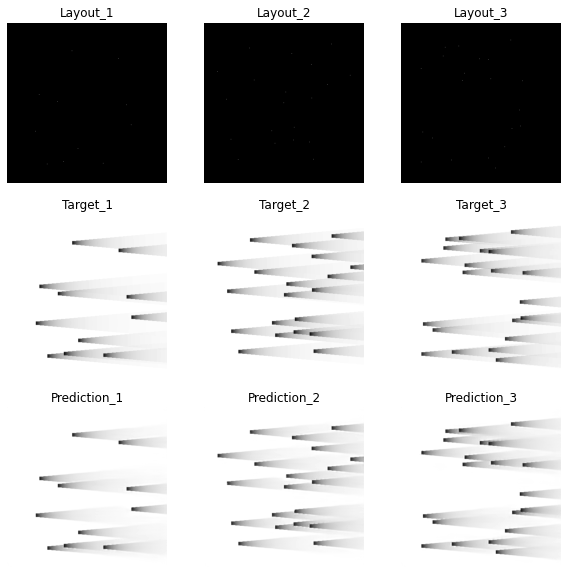

Epoch 205: , Train RMSE: 0.009403490897527124,Validation RMSE: 0.009476050455045208
Epoch 205: , Train loss: 3395.5446166992188,Validation loss: 431.0185546875


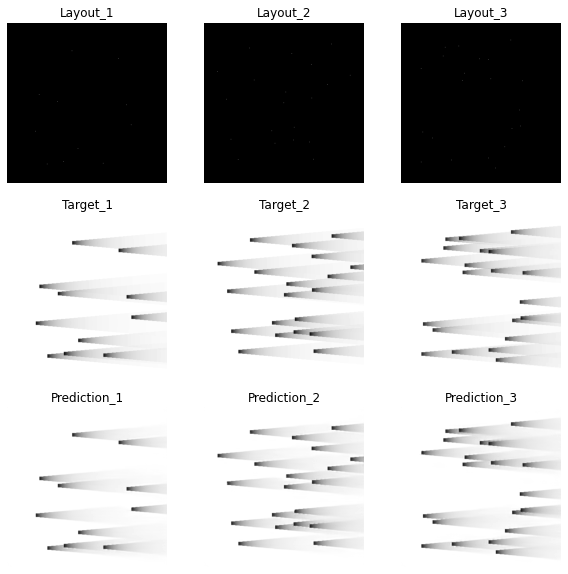

Epoch 206: , Train RMSE: 0.009552556097269757,Validation RMSE: 0.009884973985724275
Epoch 206: , Train loss: 3504.050994873047,Validation loss: 469.02101135253906


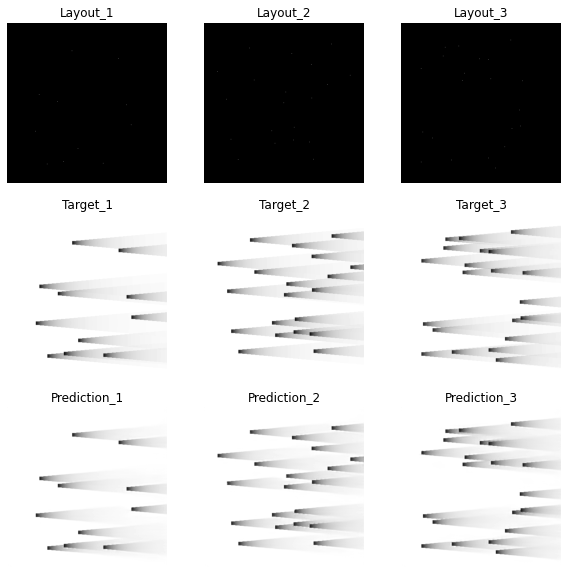

Epoch 207: , Train RMSE: 0.009224736010557016,Validation RMSE: 0.009373386837665048
Epoch 207: , Train loss: 3267.676971435547,Validation loss: 421.7298278808594


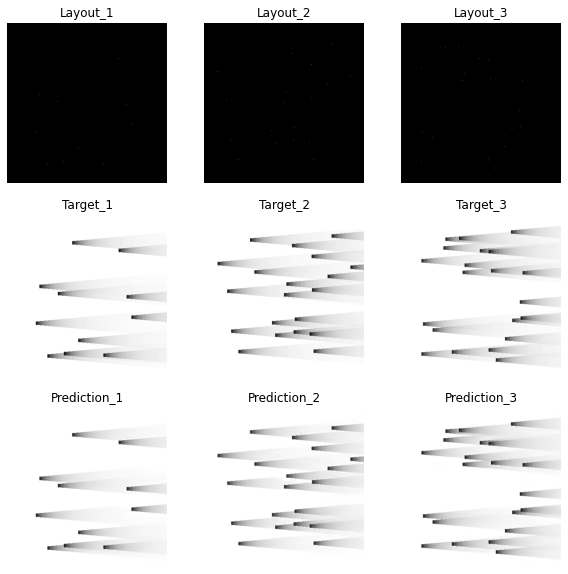

Epoch 208: , Train RMSE: 0.00901236758123814,Validation RMSE: 0.00919954115511201
Epoch 208: , Train loss: 3118.954345703125,Validation loss: 406.2314758300781


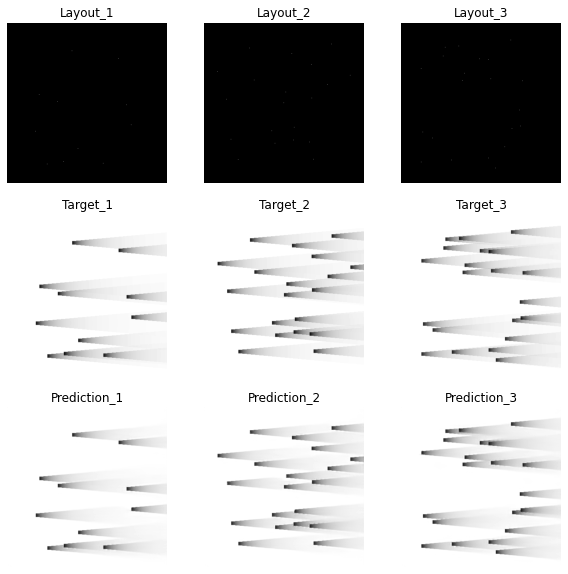

Epoch 209: , Train RMSE: 0.008797438816321404,Validation RMSE: 0.00900015844982681
Epoch 209: , Train loss: 2971.965301513672,Validation loss: 388.8136901855469


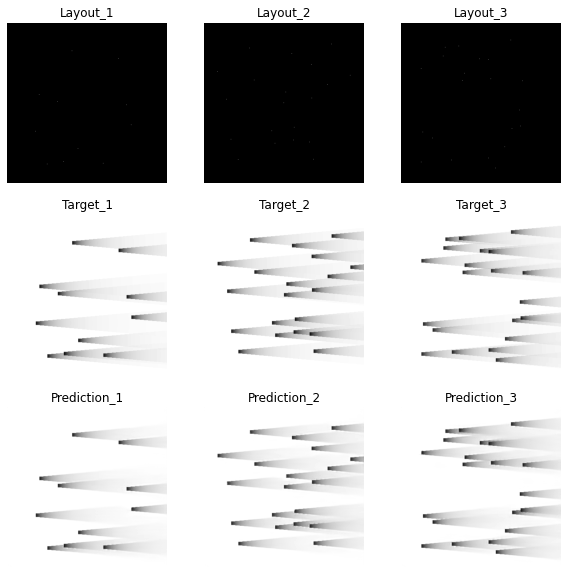

Epoch 210: , Train RMSE: 0.008772930752258178,Validation RMSE: 0.008938472703763188
Epoch 210: , Train loss: 2955.429656982422,Validation loss: 383.50221252441406


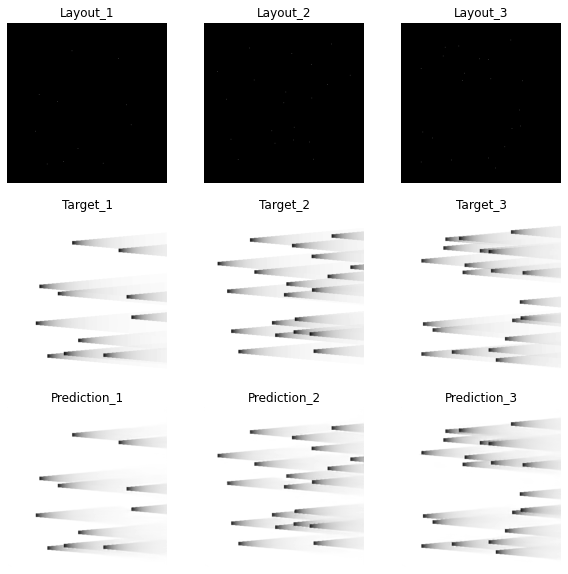

Epoch 211: , Train RMSE: 0.008706177418760662,Validation RMSE: 0.008916583931322193
Epoch 211: , Train loss: 2910.624969482422,Validation loss: 381.6262512207031


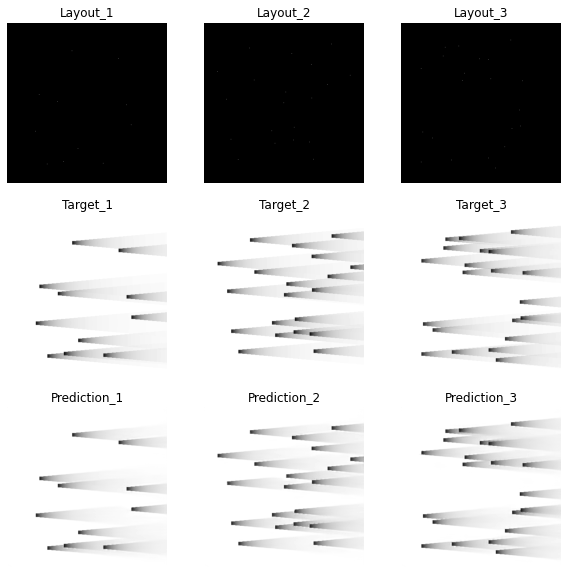

Epoch 212: , Train RMSE: 0.008697442199801522,Validation RMSE: 0.008897401217392553
Epoch 212: , Train loss: 2904.7872314453125,Validation loss: 379.9859924316406


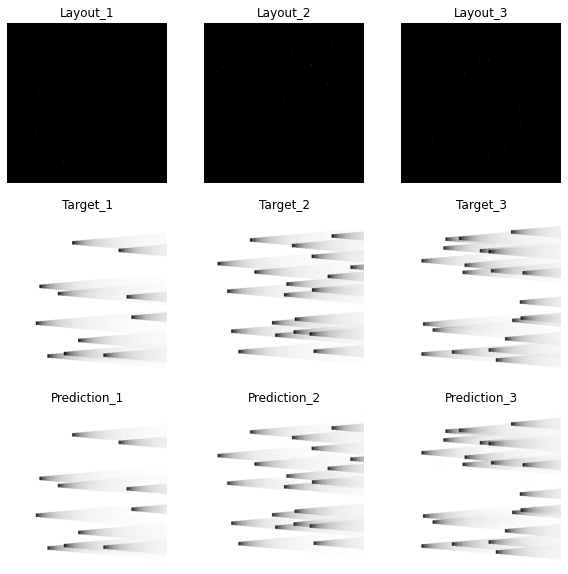

Epoch 213: , Train RMSE: 0.008678498542355488,Validation RMSE: 0.008888781632994894
Epoch 213: , Train loss: 2892.1473388671875,Validation loss: 379.25010681152344


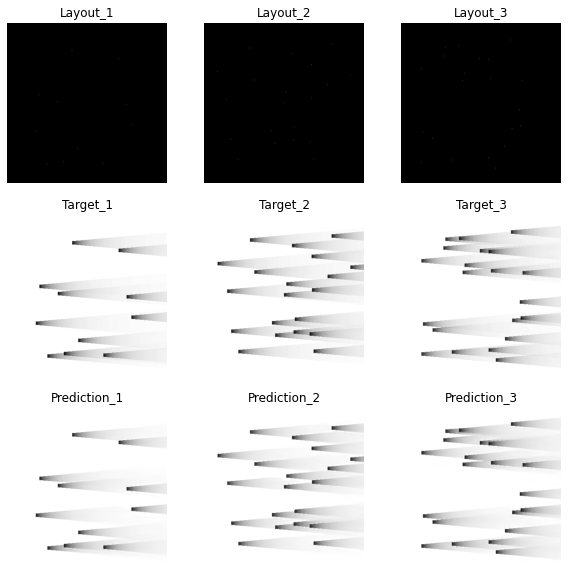

Epoch 214: , Train RMSE: 0.008670744722039731,Validation RMSE: 0.00888036238162907
Epoch 214: , Train loss: 2886.981658935547,Validation loss: 378.5320129394531


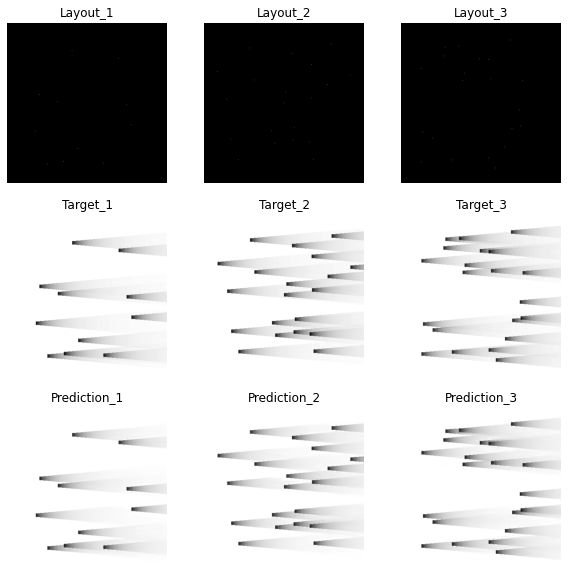

Epoch 215: , Train RMSE: 0.00866188192947,Validation RMSE: 0.008872543353142064
Epoch 215: , Train loss: 2881.0828247070312,Validation loss: 377.86572265625


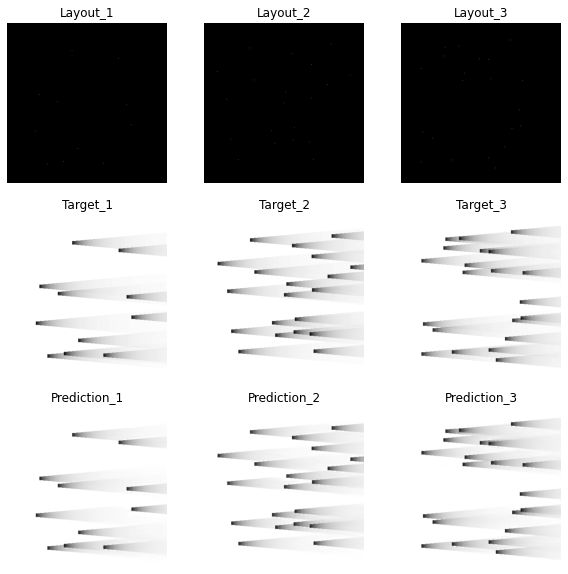

Epoch 216: , Train RMSE: 0.008655578054704372,Validation RMSE: 0.008864875211889875
Epoch 216: , Train loss: 2876.8908081054688,Validation loss: 377.2128601074219


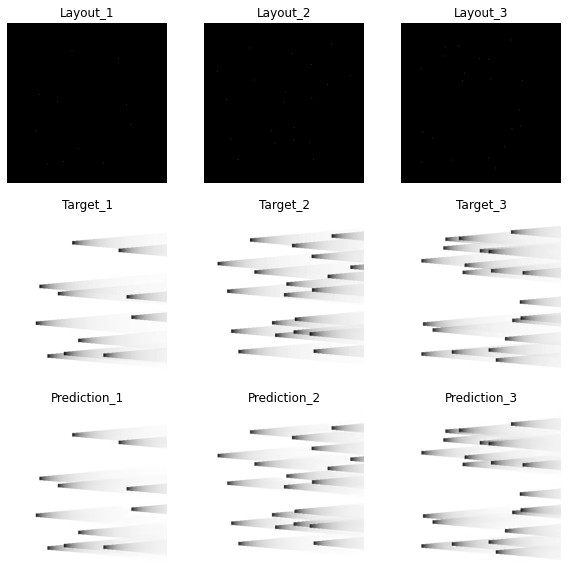

Epoch 217: , Train RMSE: 0.008648886834624399,Validation RMSE: 0.008859623442972593
Epoch 217: , Train loss: 2872.444549560547,Validation loss: 376.76605224609375


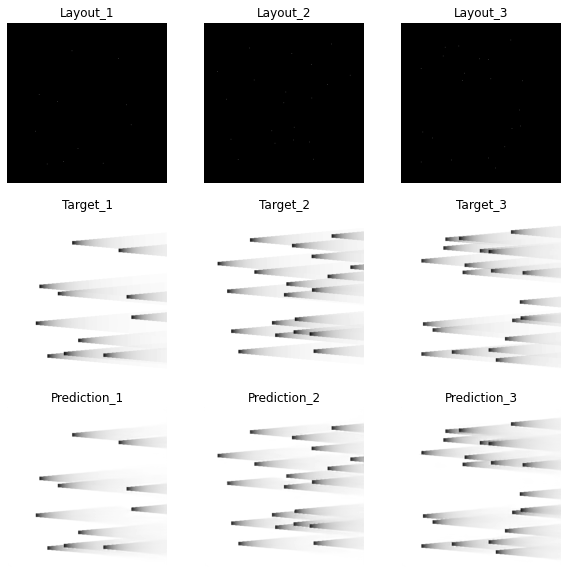

Epoch 218: , Train RMSE: 0.008643751437613919,Validation RMSE: 0.008853795541203385
Epoch 218: , Train loss: 2869.034454345703,Validation loss: 376.2705383300781


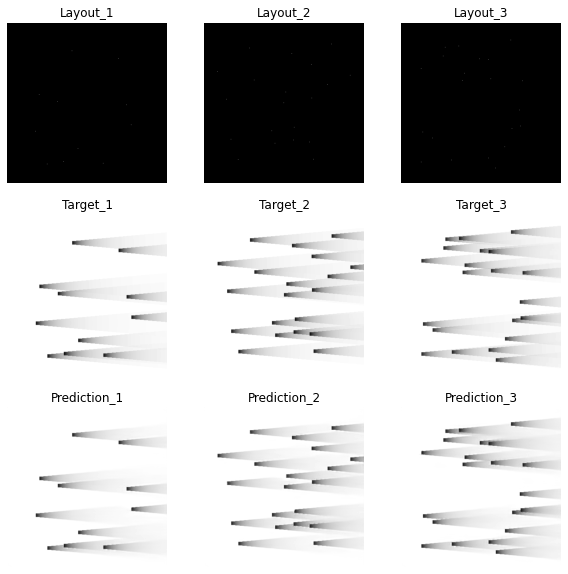

Epoch 219: , Train RMSE: 0.00863760622624442,Validation RMSE: 0.00884775757047394
Epoch 219: , Train loss: 2864.9564666748047,Validation loss: 375.75750732421875


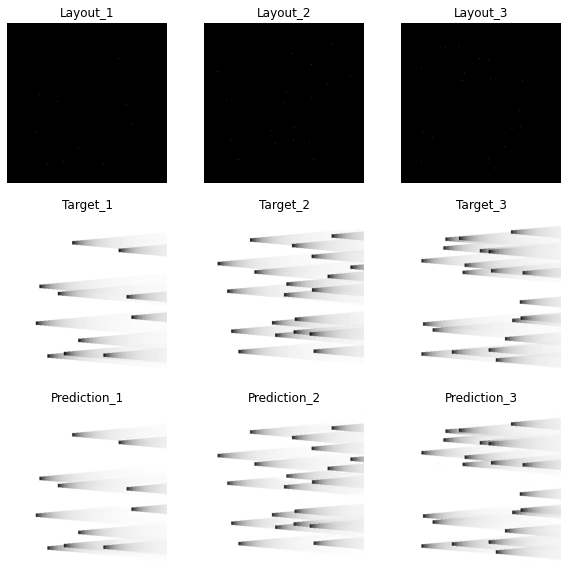

Epoch 220: , Train RMSE: 0.008633157093195844,Validation RMSE: 0.00884306291443058
Epoch 220: , Train loss: 2862.005813598633,Validation loss: 375.3588562011719


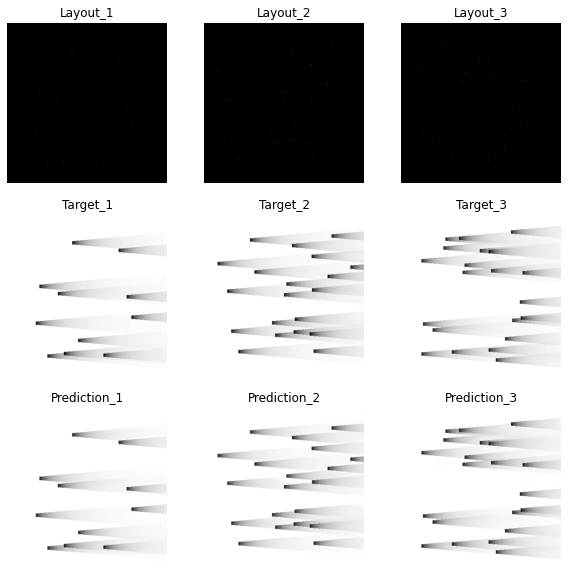

Epoch 221: , Train RMSE: 0.008627653119314594,Validation RMSE: 0.008837751063585
Epoch 221: , Train loss: 2858.357696533203,Validation loss: 374.9080505371094


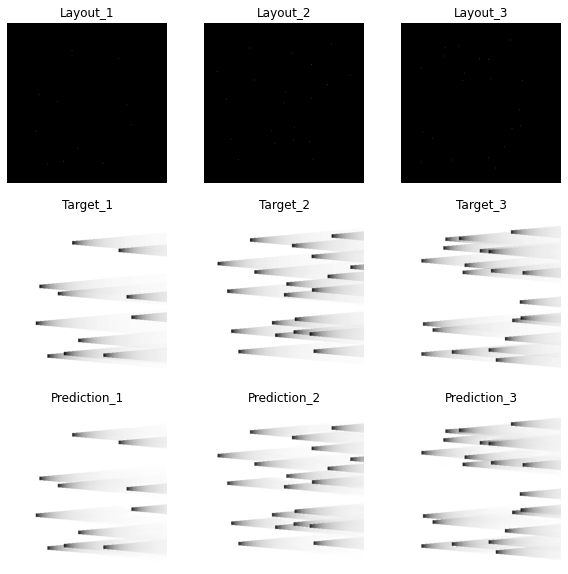

Epoch 222: , Train RMSE: 0.008623167239451095,Validation RMSE: 0.008833268999069385
Epoch 222: , Train loss: 2855.3861083984375,Validation loss: 374.5278778076172


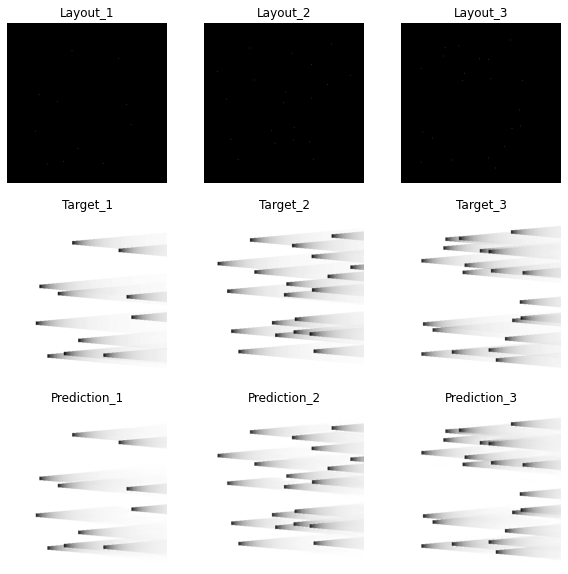

Epoch 223: , Train RMSE: 0.00861828882921372,Validation RMSE: 0.008828369137249254
Epoch 223: , Train loss: 2852.15625,Validation loss: 374.11248779296875


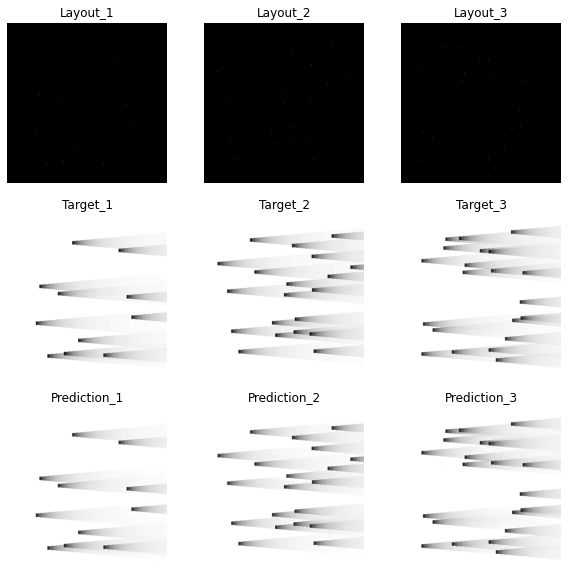

Epoch 224: , Train RMSE: 0.008613783310655241,Validation RMSE: 0.008824026951444063
Epoch 224: , Train loss: 2849.1748962402344,Validation loss: 373.74456787109375


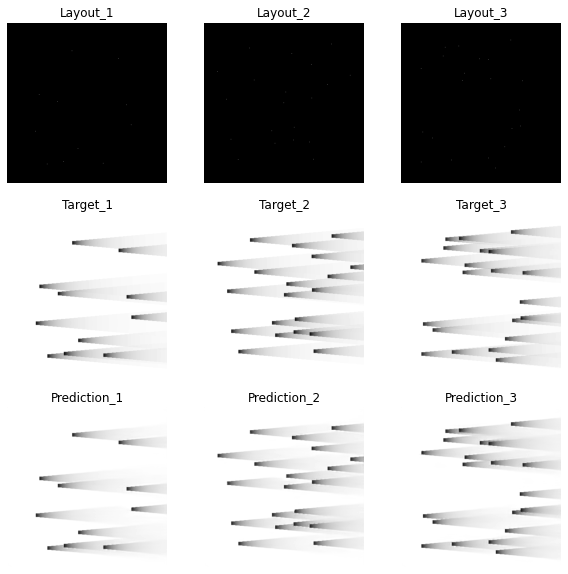

Epoch 225: , Train RMSE: 0.008609249771785902,Validation RMSE: 0.00881953520907524
Epoch 225: , Train loss: 2846.1765747070312,Validation loss: 373.3641662597656


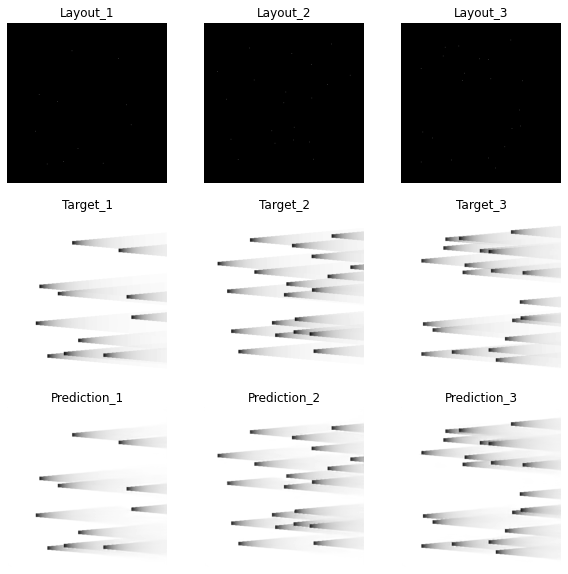

Epoch 226: , Train RMSE: 0.008604810659832792,Validation RMSE: 0.008815260073899779
Epoch 226: , Train loss: 2843.242233276367,Validation loss: 373.0022888183594


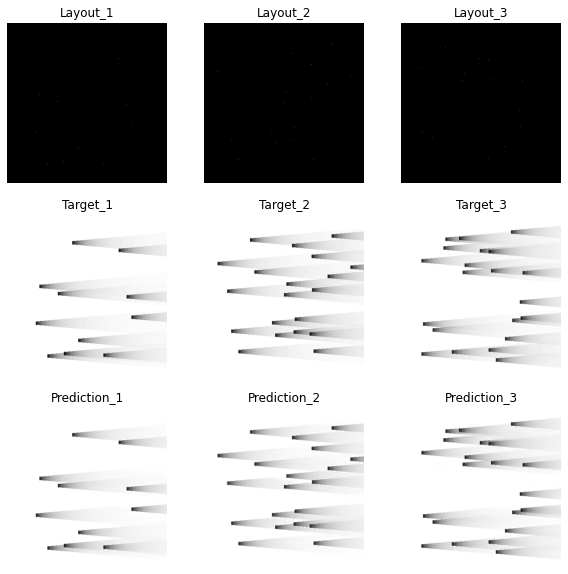

Epoch 227: , Train RMSE: 0.008600455656104794,Validation RMSE: 0.008810935600791528
Epoch 227: , Train loss: 2840.364959716797,Validation loss: 372.63641357421875


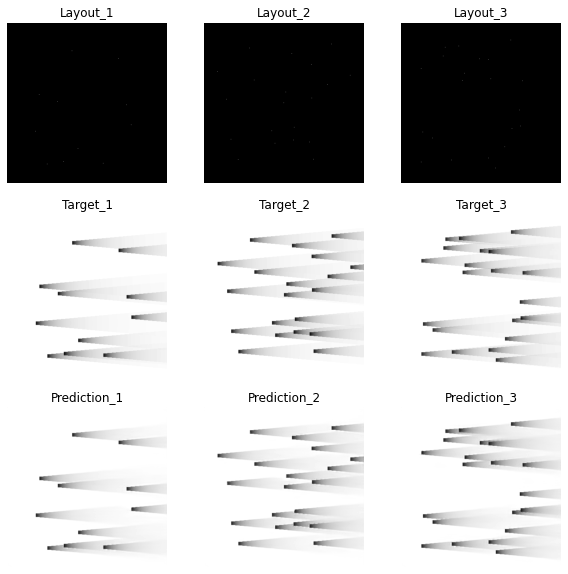

Epoch 228: , Train RMSE: 0.0085961581006245,Validation RMSE: 0.00880669310957322
Epoch 228: , Train loss: 2837.527069091797,Validation loss: 372.27764892578125


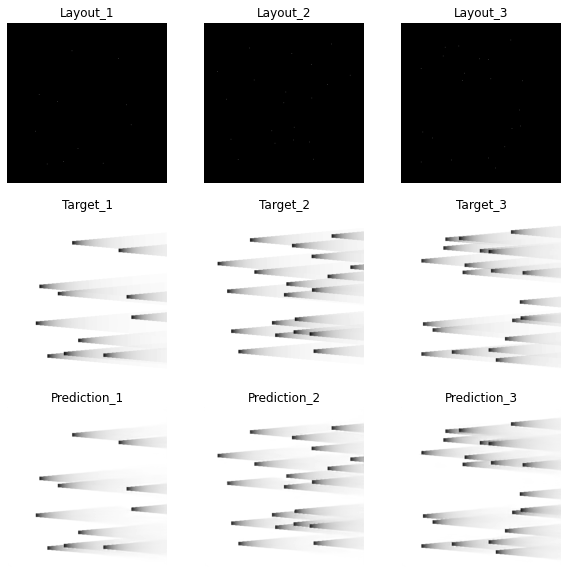

Epoch 229: , Train RMSE: 0.008591838439114756,Validation RMSE: 0.008802458866091531
Epoch 229: , Train loss: 2834.676010131836,Validation loss: 371.9197540283203


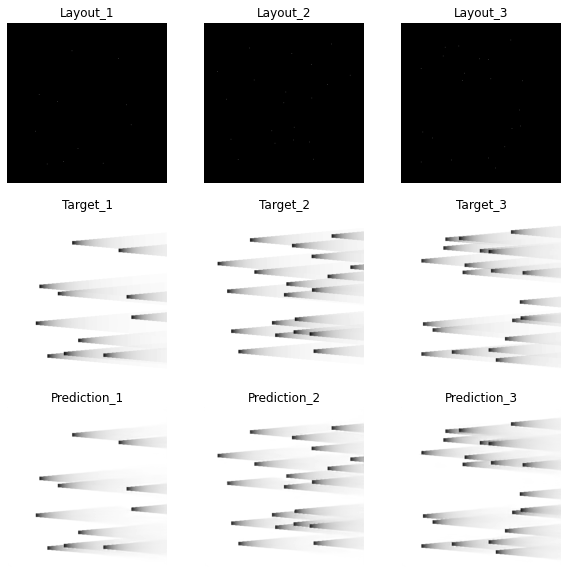

Epoch 230: , Train RMSE: 0.008587650330702393,Validation RMSE: 0.008798272084608698
Epoch 230: , Train loss: 2831.9131469726562,Validation loss: 371.5660400390625


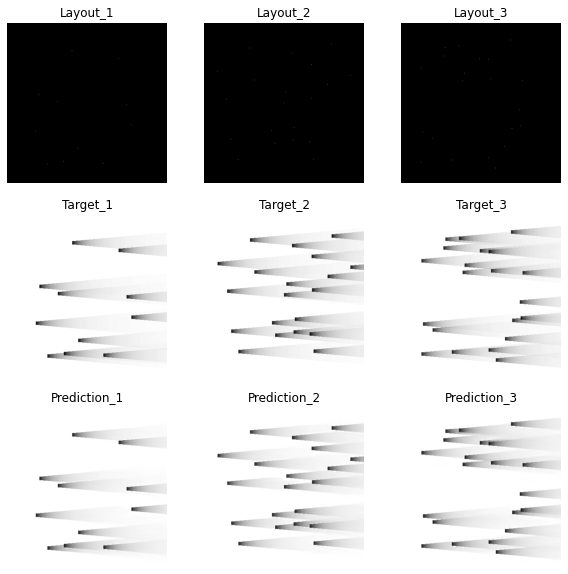

Epoch 231: , Train RMSE: 0.008583482932358017,Validation RMSE: 0.008794209466610334
Epoch 231: , Train loss: 2829.165283203125,Validation loss: 371.2229766845703


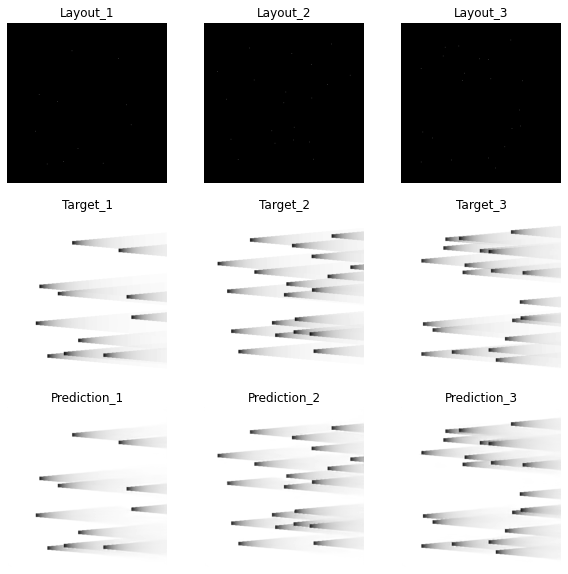

Epoch 232: , Train RMSE: 0.0085792881050303,Validation RMSE: 0.008789962519022218
Epoch 232: , Train loss: 2826.400680541992,Validation loss: 370.86451721191406


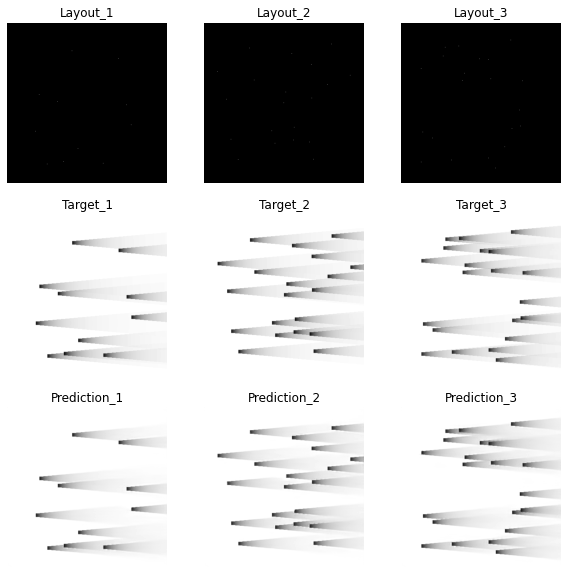

Epoch 233: , Train RMSE: 0.00857530396704025,Validation RMSE: 0.008786072082411406
Epoch 233: , Train loss: 2823.7761840820312,Validation loss: 370.5363006591797


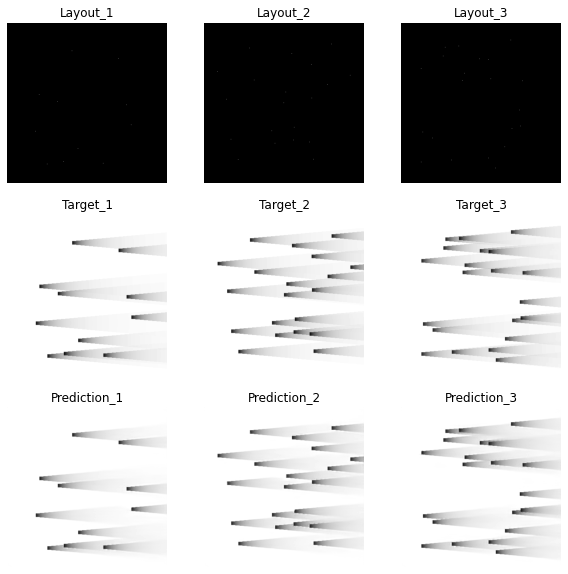

Epoch 234: , Train RMSE: 0.008571142341360825,Validation RMSE: 0.008781877307500146
Epoch 234: , Train loss: 2821.0360717773438,Validation loss: 370.1825714111328


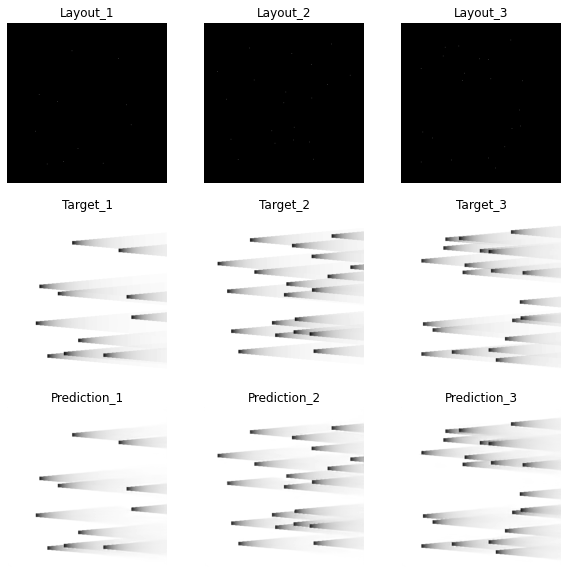

Epoch 235: , Train RMSE: 0.008567133867818438,Validation RMSE: 0.008777842049289622
Epoch 235: , Train loss: 2818.3980560302734,Validation loss: 369.8424530029297


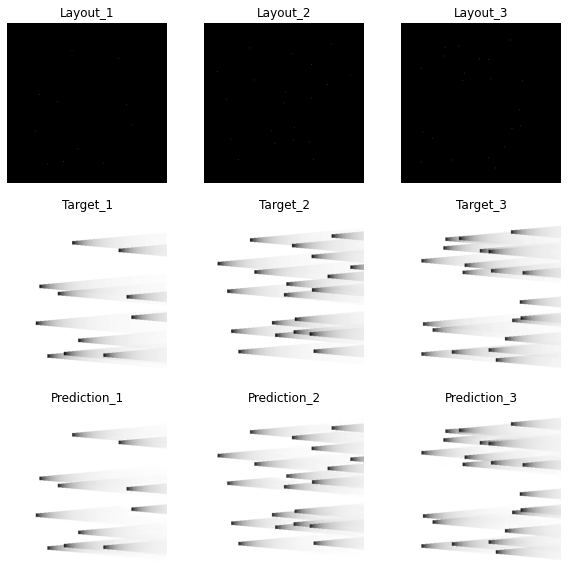

Epoch 236: , Train RMSE: 0.008563103564075256,Validation RMSE: 0.00877390584038159
Epoch 236: , Train loss: 2815.7469177246094,Validation loss: 369.5108337402344


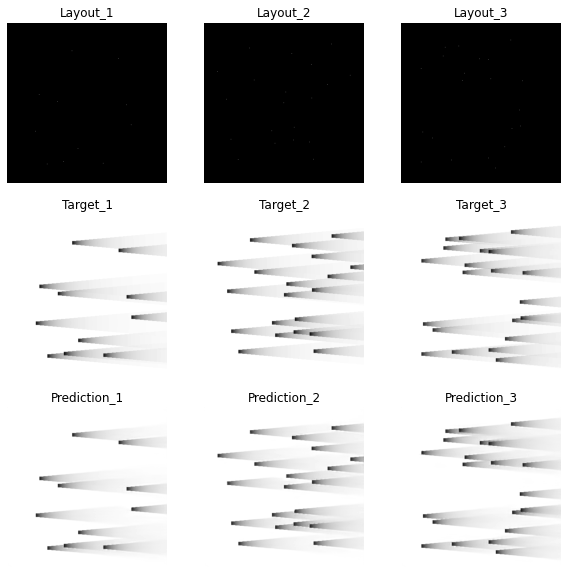

Epoch 237: , Train RMSE: 0.008559059314957696,Validation RMSE: 0.008769832840953597
Epoch 237: , Train loss: 2813.087860107422,Validation loss: 369.1678466796875


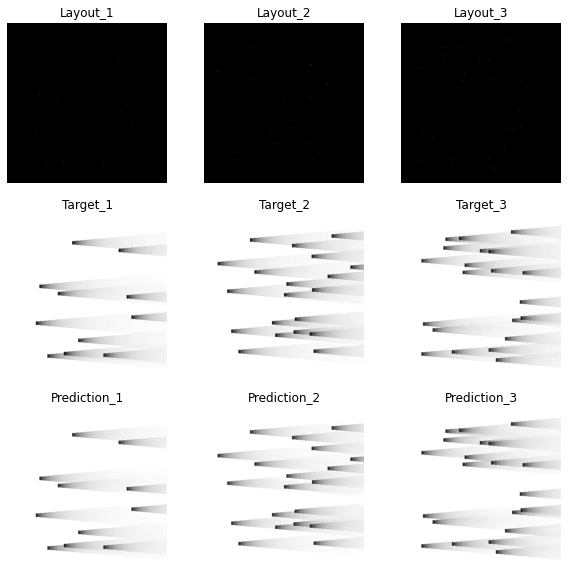

Epoch 238: , Train RMSE: 0.008555117661621791,Validation RMSE: 0.00876592114062199
Epoch 238: , Train loss: 2810.4974670410156,Validation loss: 368.8385925292969


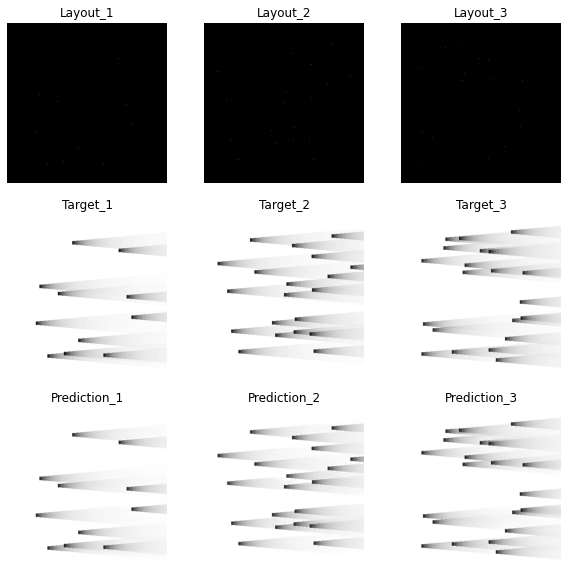

Epoch 239: , Train RMSE: 0.008551189317023712,Validation RMSE: 0.008761985925531509
Epoch 239: , Train loss: 2807.917007446289,Validation loss: 368.50750732421875


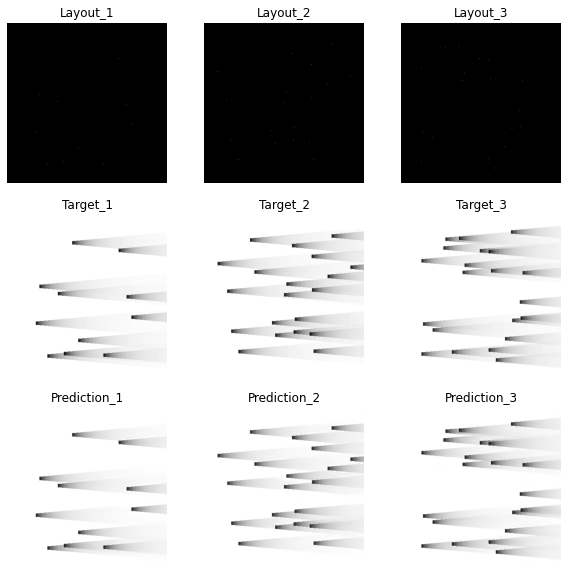

Epoch 240: , Train RMSE: 0.008547231110029696,Validation RMSE: 0.00875817906624643
Epoch 240: , Train loss: 2805.318130493164,Validation loss: 368.18736267089844


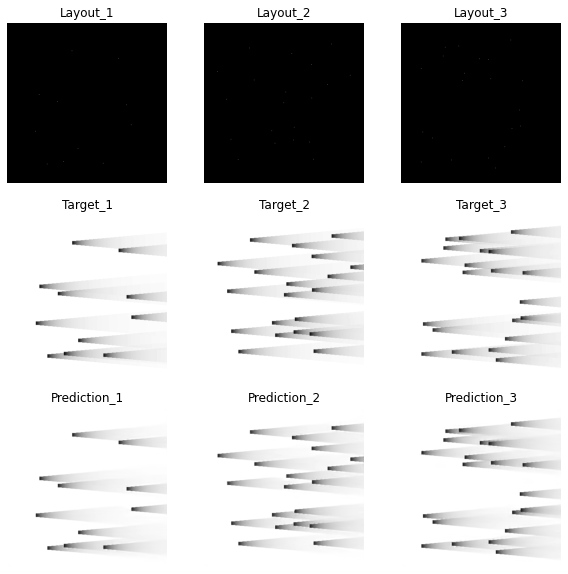

Epoch 241: , Train RMSE: 0.008543260324877887,Validation RMSE: 0.008754118903597341
Epoch 241: , Train loss: 2802.712203979492,Validation loss: 367.8460693359375


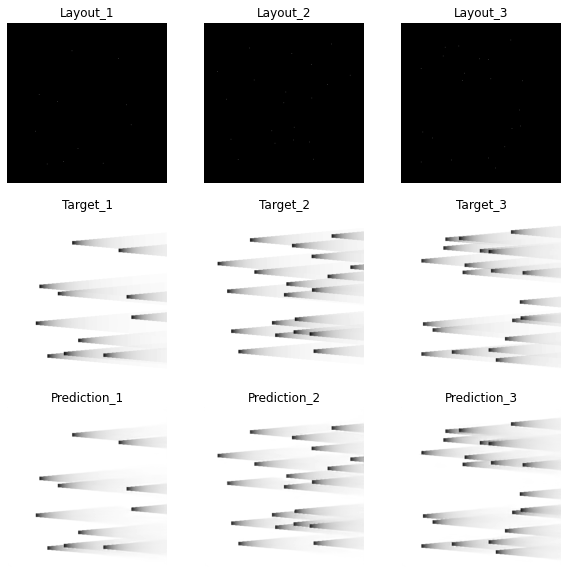

Epoch 242: , Train RMSE: 0.00853942024340144,Validation RMSE: 0.008750452665699926
Epoch 242: , Train loss: 2800.1932067871094,Validation loss: 367.53802490234375


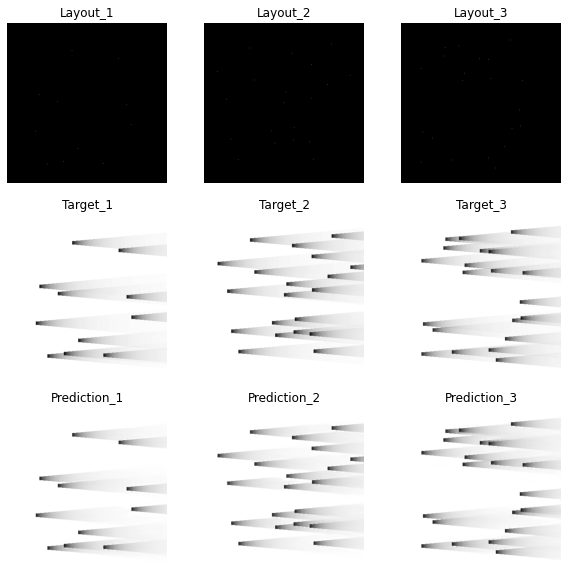

Epoch 243: , Train RMSE: 0.00853550257442098,Validation RMSE: 0.008746413086068579
Epoch 243: , Train loss: 2797.624481201172,Validation loss: 367.1987609863281


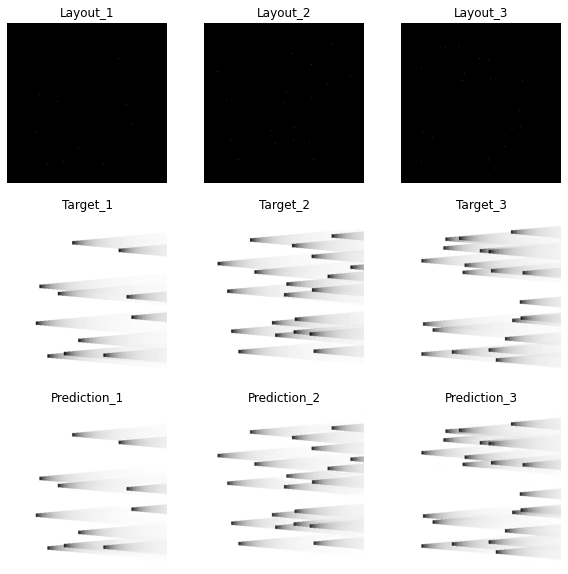

Epoch 244: , Train RMSE: 0.00853158992979735,Validation RMSE: 0.008742493997654878
Epoch 244: , Train loss: 2795.0602264404297,Validation loss: 366.86976623535156


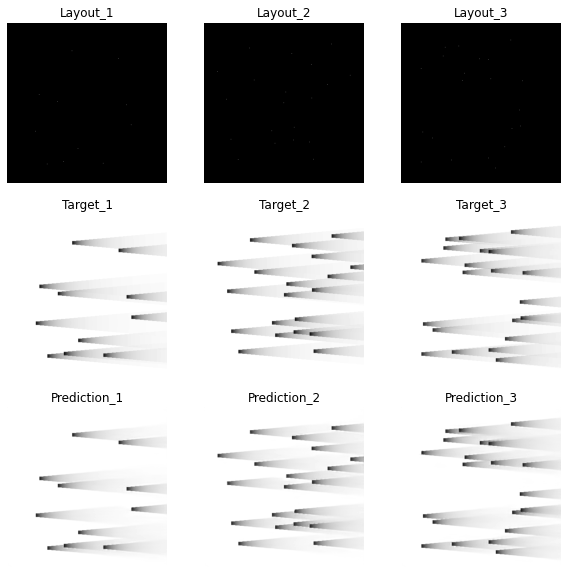

Epoch 245: , Train RMSE: 0.008527740865358976,Validation RMSE: 0.00873841999906143
Epoch 245: , Train loss: 2792.538787841797,Validation loss: 366.5279235839844


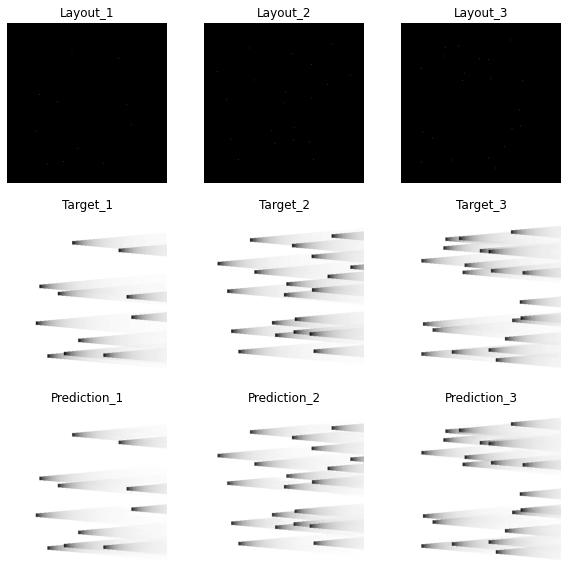

Epoch 246: , Train RMSE: 0.008523848642887142,Validation RMSE: 0.00873458157808594
Epoch 246: , Train loss: 2789.990234375,Validation loss: 366.20599365234375


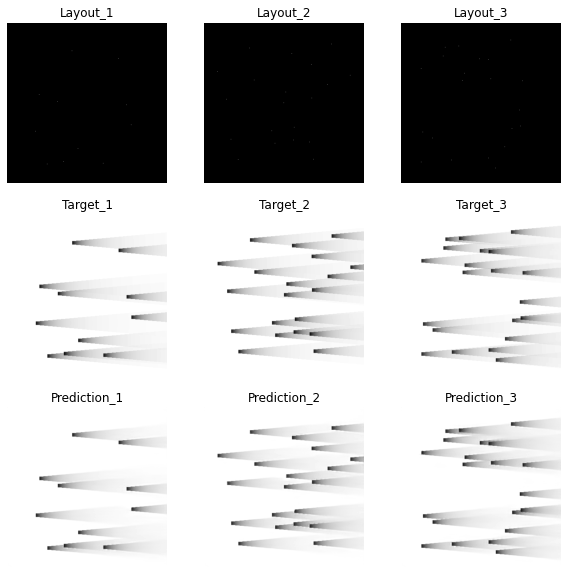

Epoch 247: , Train RMSE: 0.008519967468092155,Validation RMSE: 0.00873067647642743
Epoch 247: , Train loss: 2787.4500732421875,Validation loss: 365.8786163330078


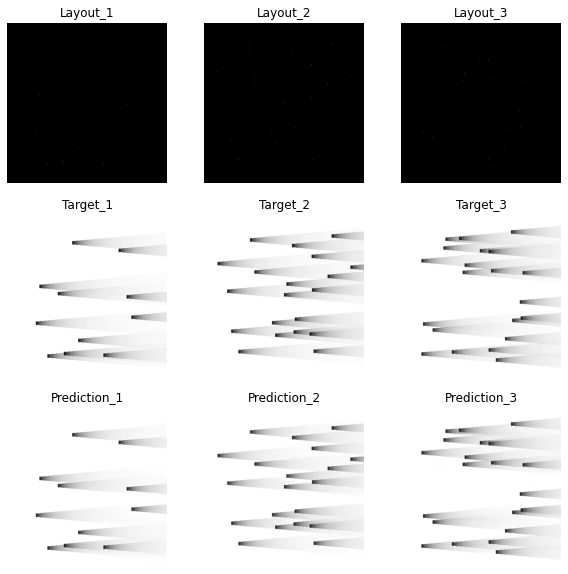

Epoch 248: , Train RMSE: 0.008516097776022176,Validation RMSE: 0.008726870529944813
Epoch 248: , Train loss: 2784.9185791015625,Validation loss: 365.5596923828125


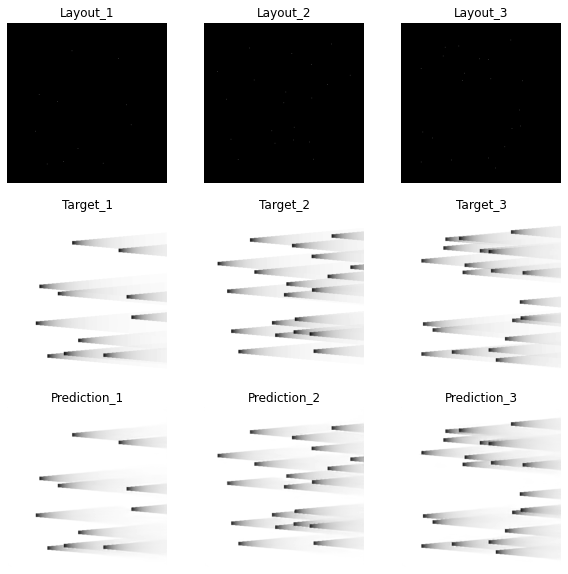

Epoch 249: , Train RMSE: 0.008512253610123234,Validation RMSE: 0.008722993681605404
Epoch 249: , Train loss: 2782.4049224853516,Validation loss: 365.23497009277344


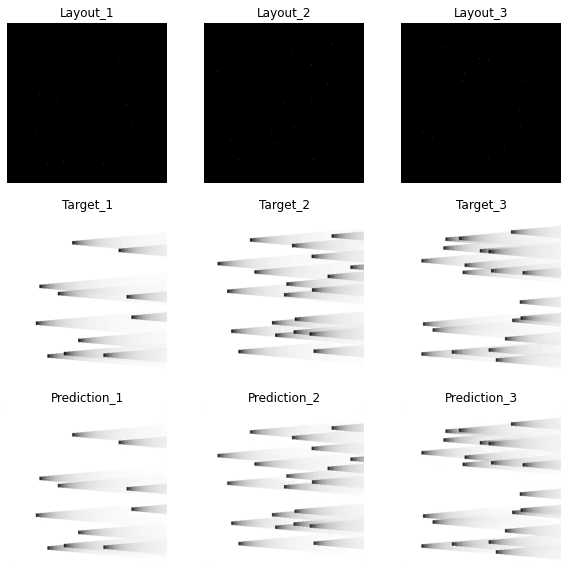

Epoch 250: , Train RMSE: 0.008508414058943734,Validation RMSE: 0.008719246725974926
Epoch 250: , Train loss: 2779.8954162597656,Validation loss: 364.9212646484375


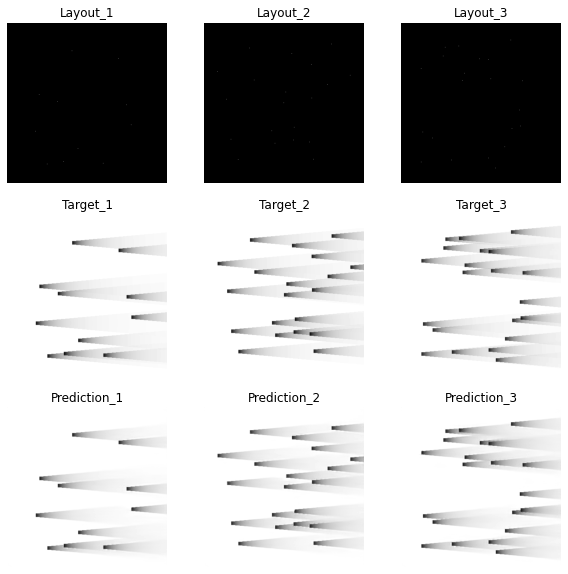

Epoch 251: , Train RMSE: 0.00850456356977083,Validation RMSE: 0.008715305937932195
Epoch 251: , Train loss: 2777.379898071289,Validation loss: 364.5914764404297


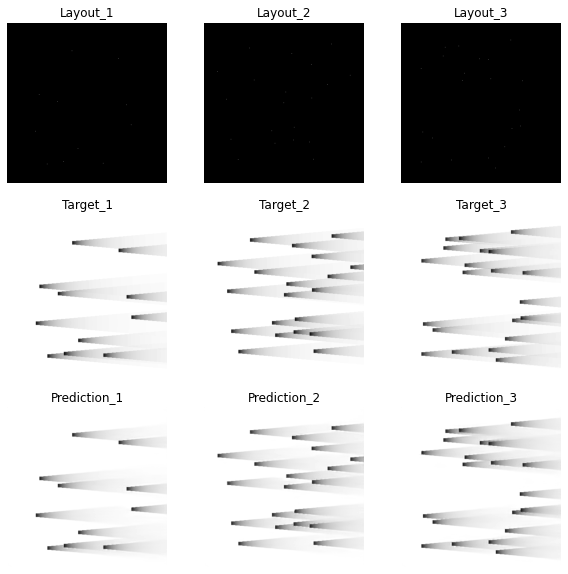

Epoch 252: , Train RMSE: 0.00850079454186593,Validation RMSE: 0.008711465178103877
Epoch 252: , Train loss: 2774.918701171875,Validation loss: 364.27020263671875


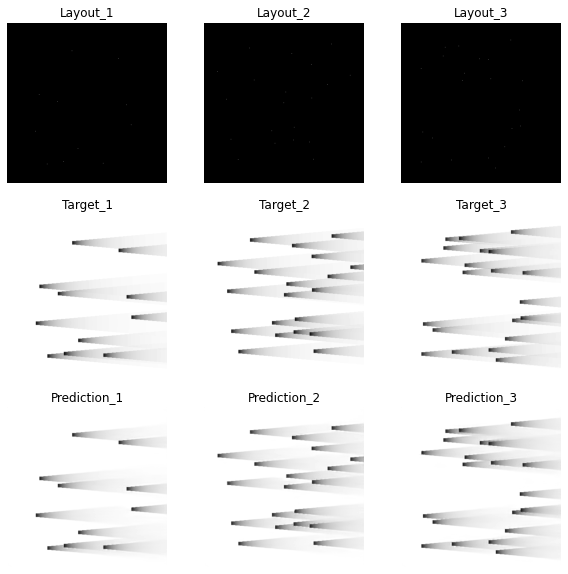

Epoch 253: , Train RMSE: 0.008496924909955074,Validation RMSE: 0.008707621081365859
Epoch 253: , Train loss: 2772.3929443359375,Validation loss: 363.94879150390625


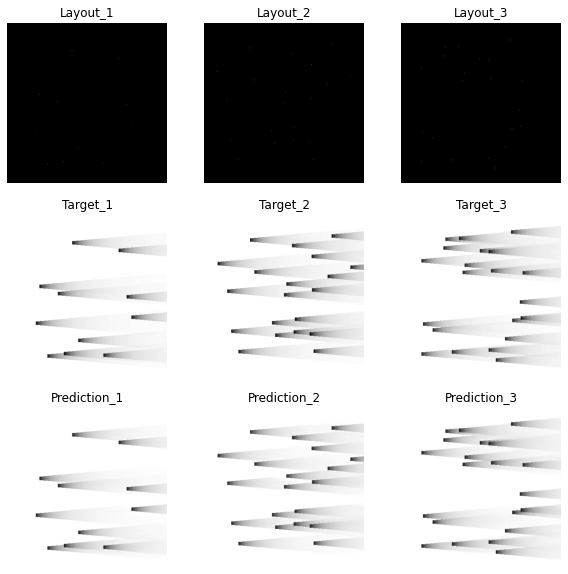

Epoch 254: , Train RMSE: 0.008493075434620852,Validation RMSE: 0.008703744607142416
Epoch 254: , Train loss: 2769.8814849853516,Validation loss: 363.62481689453125


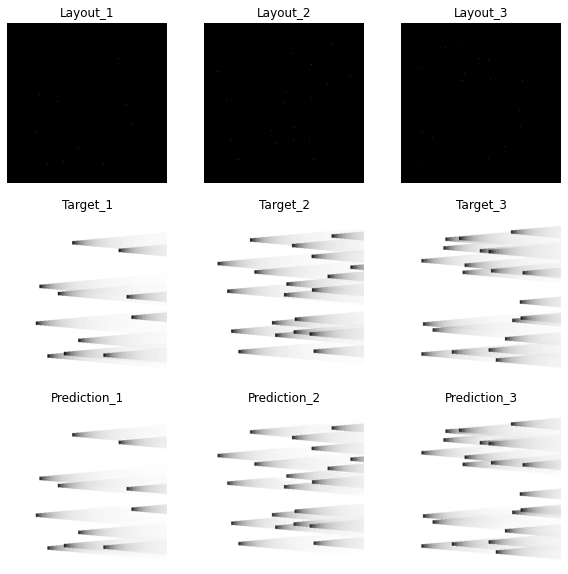

Epoch 255: , Train RMSE: 0.008489361781562378,Validation RMSE: 0.008699875540592154
Epoch 255: , Train loss: 2767.459716796875,Validation loss: 363.3016052246094


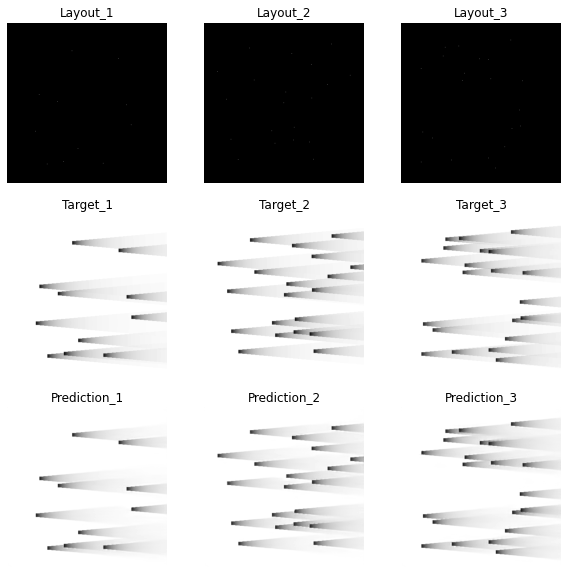

Epoch 256: , Train RMSE: 0.008485472887356975,Validation RMSE: 0.008696124655561528
Epoch 256: , Train loss: 2764.9248046875,Validation loss: 362.9884033203125


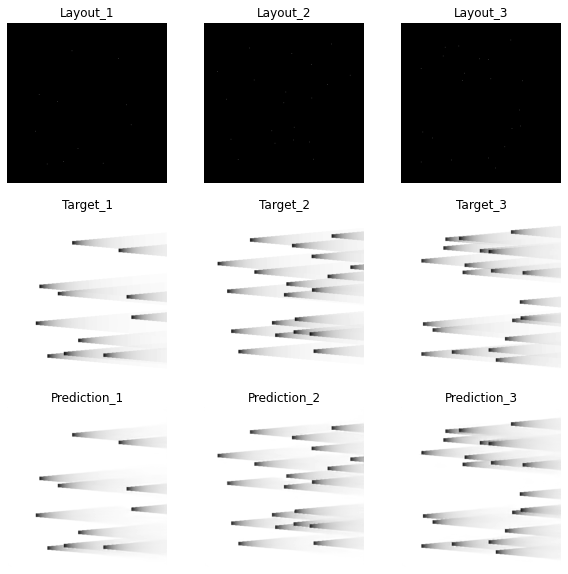

Epoch 257: , Train RMSE: 0.008481630863904457,Validation RMSE: 0.008692183441960263
Epoch 257: , Train loss: 2762.421585083008,Validation loss: 362.6594543457031


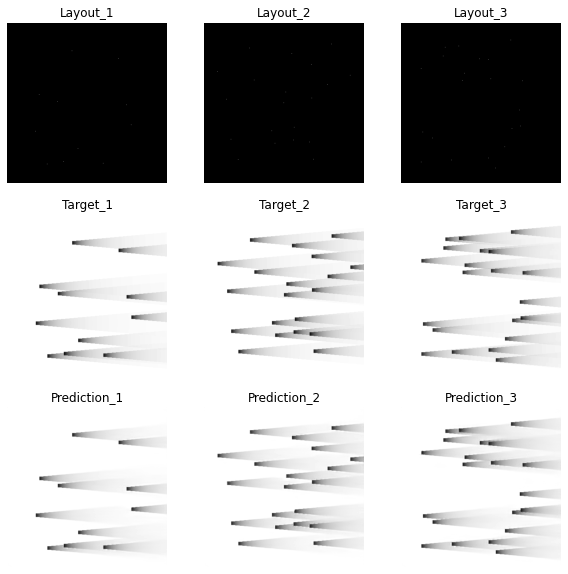

Epoch 258: , Train RMSE: 0.00847790237830015,Validation RMSE: 0.008688275199718579
Epoch 258: , Train loss: 2759.993423461914,Validation loss: 362.3334045410156


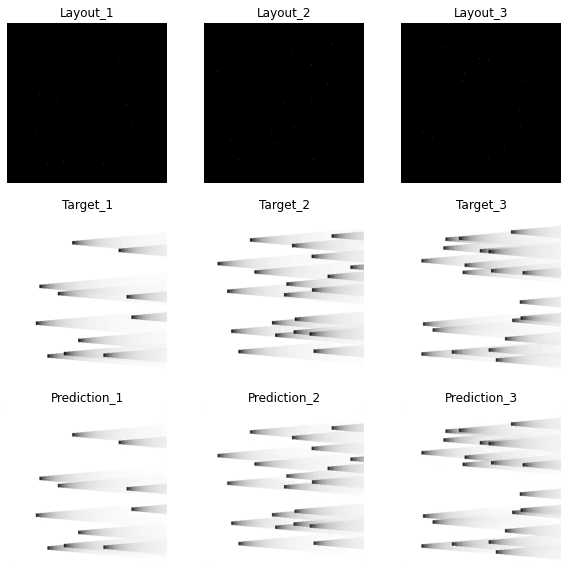

Epoch 259: , Train RMSE: 0.00847404346450656,Validation RMSE: 0.008684483249058746
Epoch 259: , Train loss: 2757.4814453125,Validation loss: 362.01719665527344


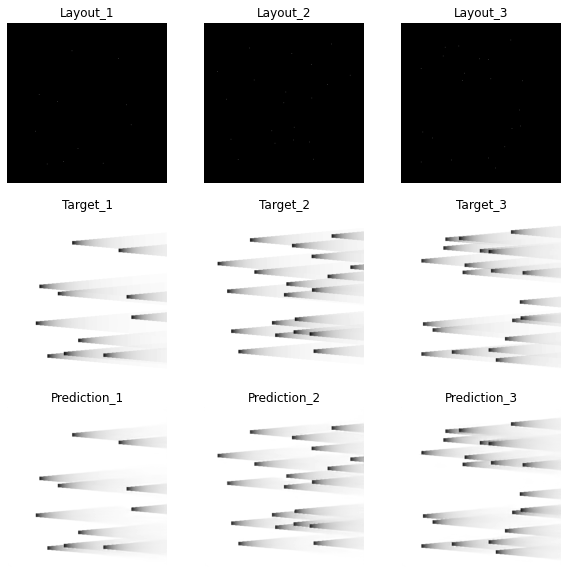

Epoch 260: , Train RMSE: 0.008470205944324375,Validation RMSE: 0.008680622992359579
Epoch 260: , Train loss: 2754.9845275878906,Validation loss: 361.6954345703125


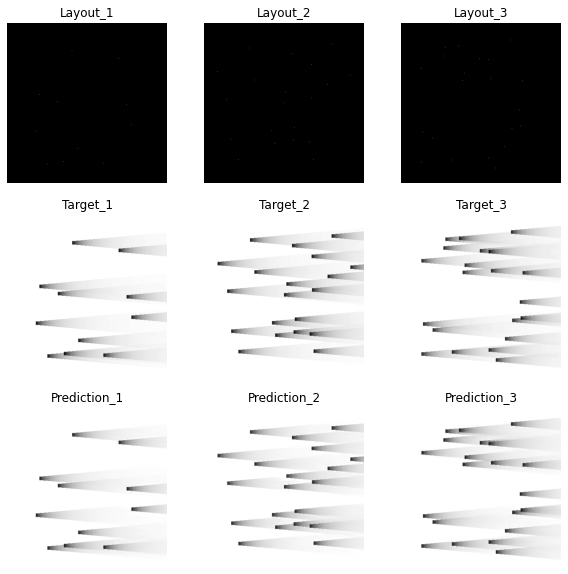

Epoch 261: , Train RMSE: 0.00846639991425141,Validation RMSE: 0.008676701482741323
Epoch 261: , Train loss: 2752.5092163085938,Validation loss: 361.36871337890625


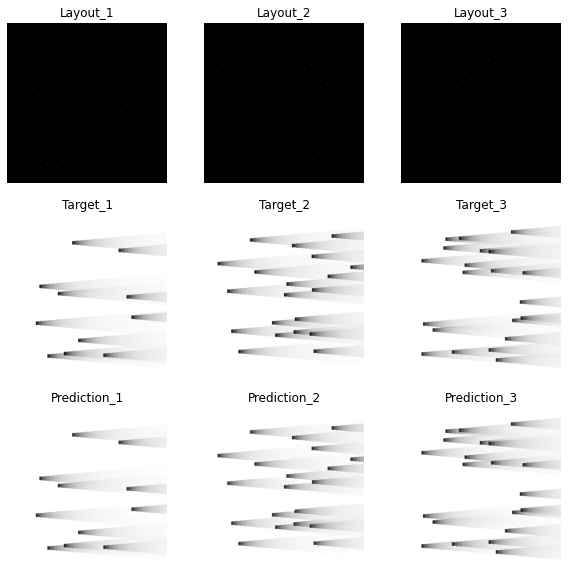

Epoch 262: , Train RMSE: 0.008462656125422664,Validation RMSE: 0.008672830248391546
Epoch 262: , Train loss: 2750.075469970703,Validation loss: 361.04632568359375


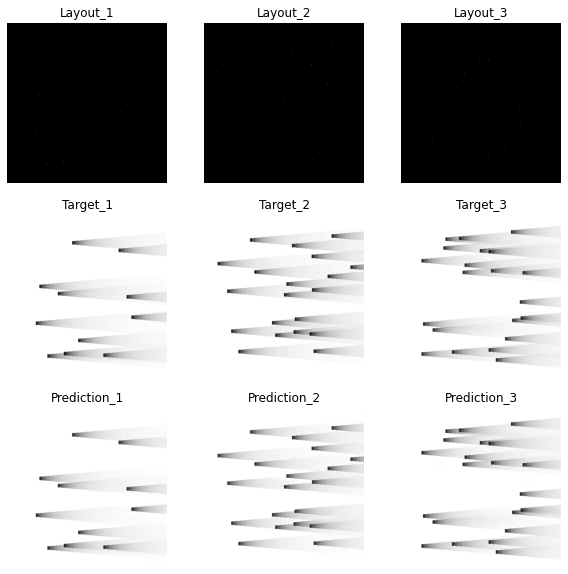

Epoch 263: , Train RMSE: 0.0084587696805379,Validation RMSE: 0.008669139900414327
Epoch 263: , Train loss: 2747.5501251220703,Validation loss: 360.7391357421875


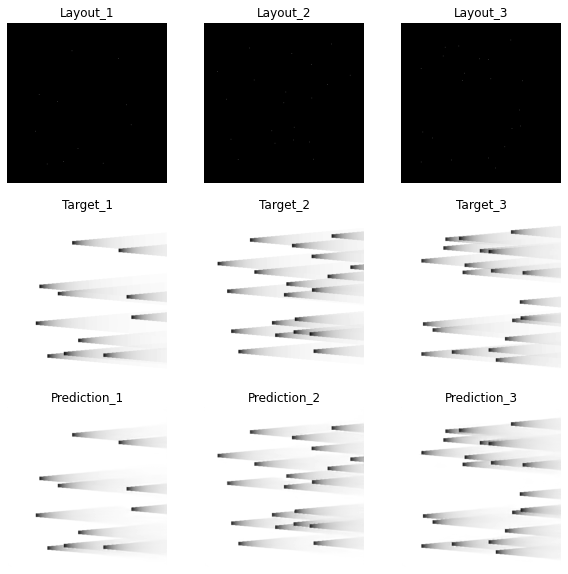

Epoch 264: , Train RMSE: 0.00845497032232507,Validation RMSE: 0.008665162017006097
Epoch 264: , Train loss: 2745.082489013672,Validation loss: 360.4081573486328


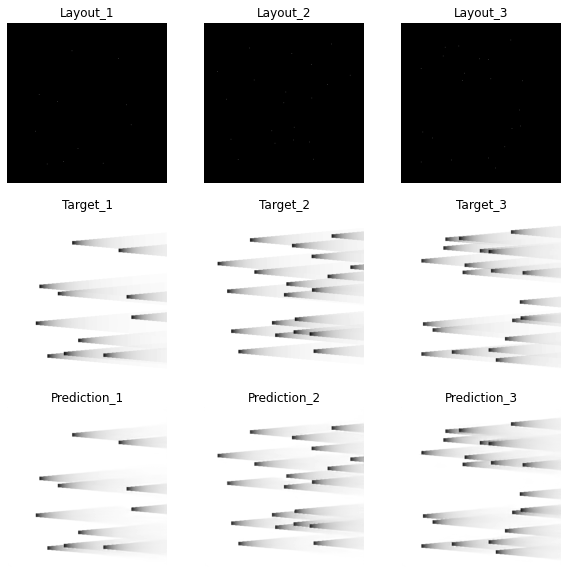

Epoch 265: , Train RMSE: 0.008451187522855477,Validation RMSE: 0.008661394814453152
Epoch 265: , Train loss: 2742.626708984375,Validation loss: 360.0948486328125


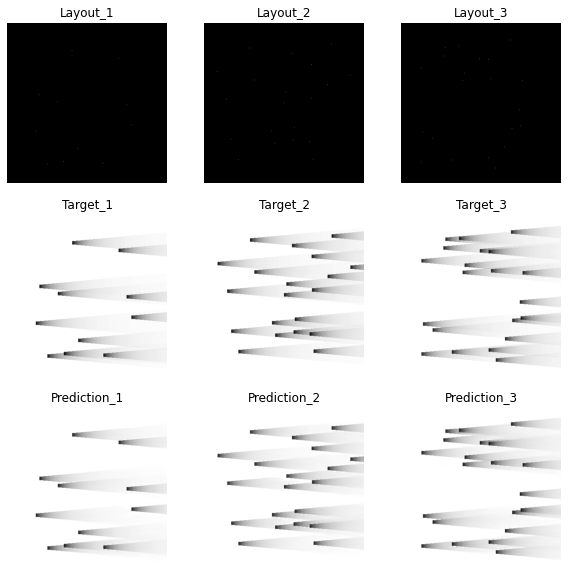

Epoch 266: , Train RMSE: 0.008447368502128239,Validation RMSE: 0.008657575485160381
Epoch 266: , Train loss: 2740.1485290527344,Validation loss: 359.77734375


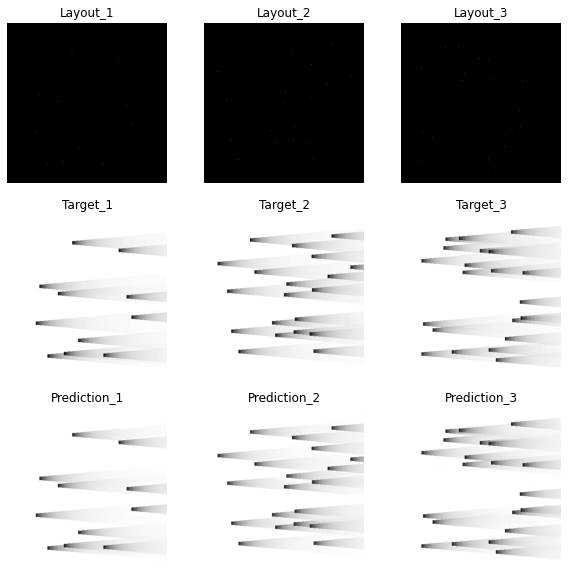

Epoch 267: , Train RMSE: 0.008443489021354823,Validation RMSE: 0.008653712776438676
Epoch 267: , Train loss: 2737.6322631835938,Validation loss: 359.4563751220703


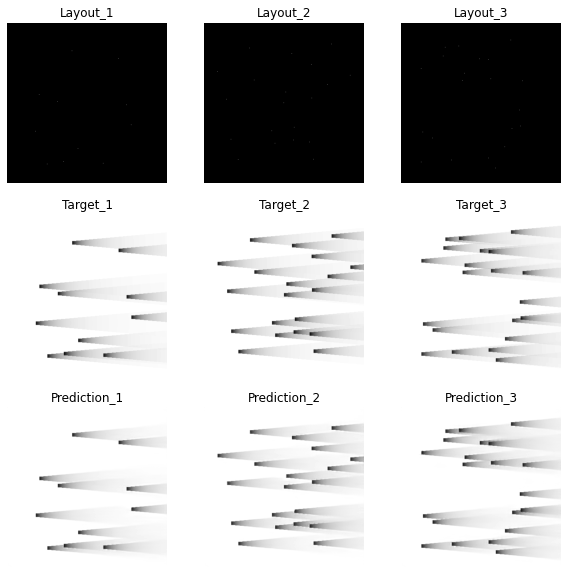

Epoch 268: , Train RMSE: 0.008439718072651084,Validation RMSE: 0.00864997109057349
Epoch 268: , Train loss: 2735.1875,Validation loss: 359.1455993652344


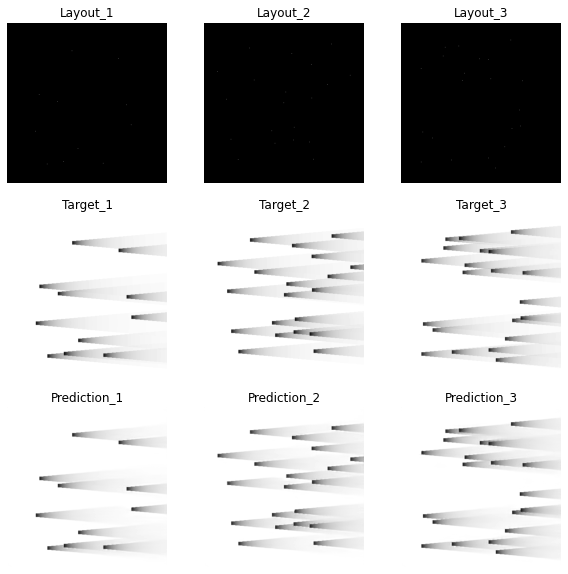

Epoch 269: , Train RMSE: 0.008435914090722234,Validation RMSE: 0.008646047995480065
Epoch 269: , Train loss: 2732.722427368164,Validation loss: 358.8199005126953


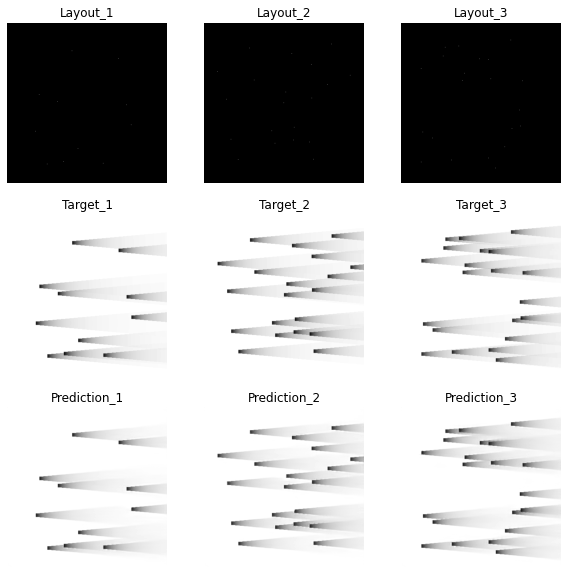

Epoch 270: , Train RMSE: 0.008432093807457183,Validation RMSE: 0.00864220772217094
Epoch 270: , Train loss: 2730.2479095458984,Validation loss: 358.501220703125


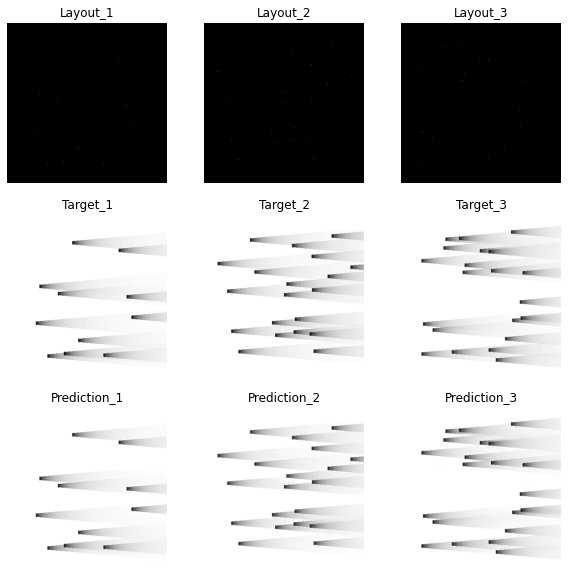

Epoch 271: , Train RMSE: 0.008428254277594846,Validation RMSE: 0.008638240252883952
Epoch 271: , Train loss: 2727.7620544433594,Validation loss: 358.17213439941406


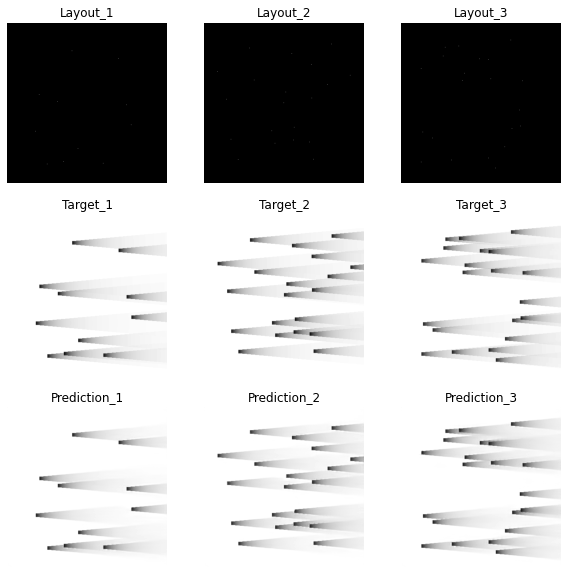

Epoch 272: , Train RMSE: 0.00842445127471756,Validation RMSE: 0.008634328763665187
Epoch 272: , Train loss: 2725.3009643554688,Validation loss: 357.84783935546875


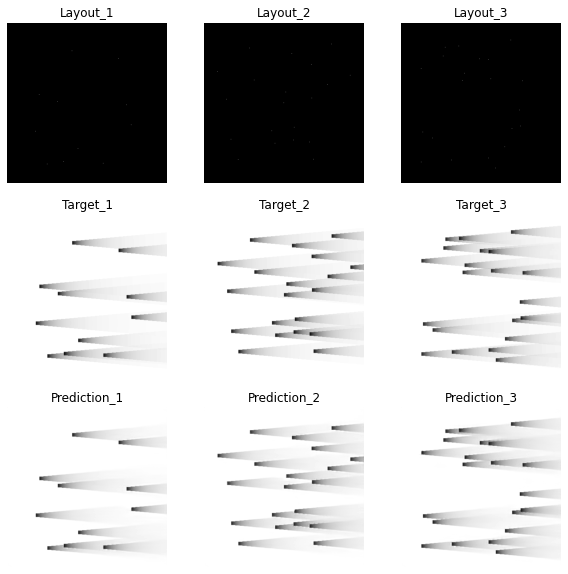

Epoch 273: , Train RMSE: 0.0084206480171642,Validation RMSE: 0.008630556390006048
Epoch 273: , Train loss: 2722.8408203125,Validation loss: 357.53521728515625


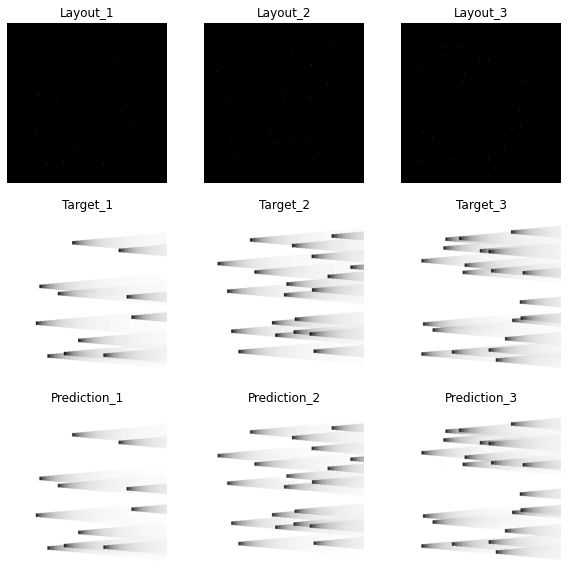

Epoch 274: , Train RMSE: 0.00841676910891997,Validation RMSE: 0.008626651734757311
Epoch 274: , Train loss: 2720.3328857421875,Validation loss: 357.21177673339844


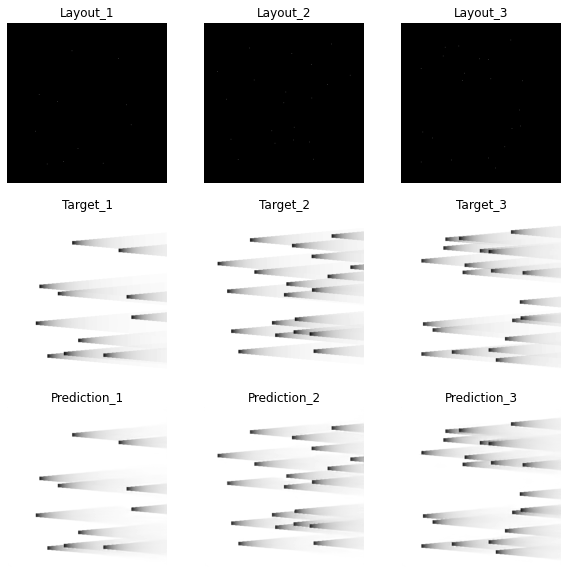

Epoch 275: , Train RMSE: 0.008412933944536537,Validation RMSE: 0.008622718951685192
Epoch 275: , Train loss: 2717.8543701171875,Validation loss: 356.8861541748047


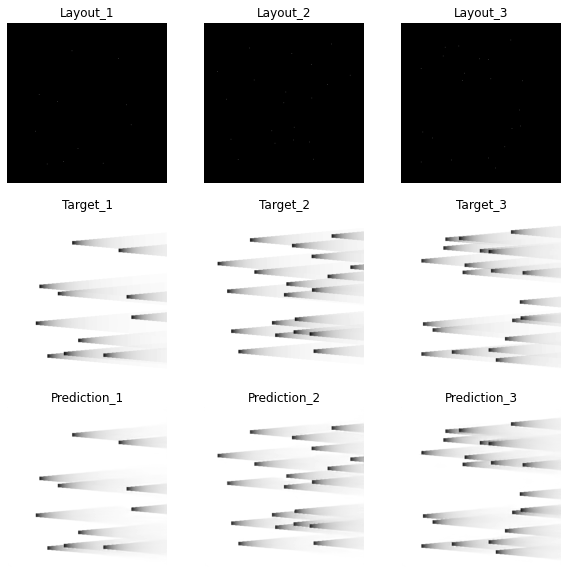

Epoch 276: , Train RMSE: 0.008409153310480179,Validation RMSE: 0.008618806688593935
Epoch 276: , Train loss: 2715.4122009277344,Validation loss: 356.5623779296875


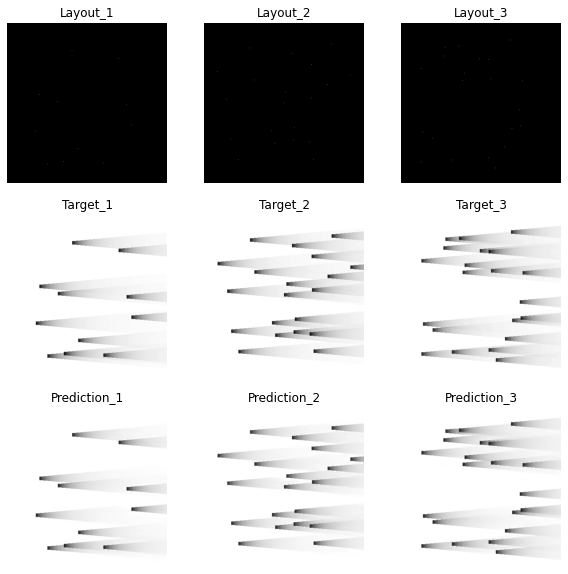

Epoch 277: , Train RMSE: 0.008405321384271166,Validation RMSE: 0.008614995968833035
Epoch 277: , Train loss: 2712.938018798828,Validation loss: 356.2471466064453


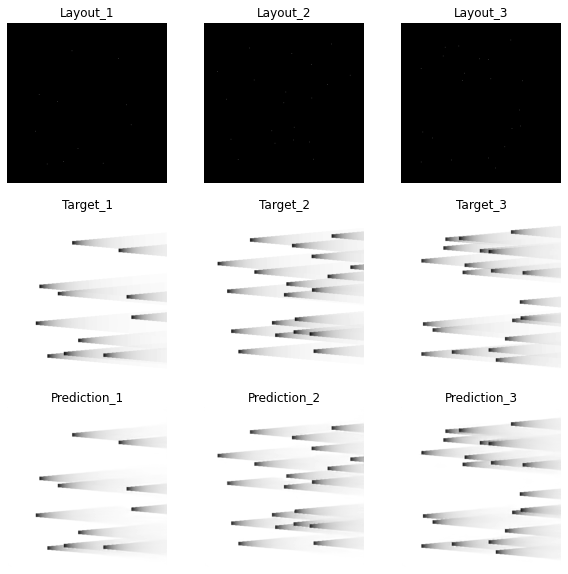

Epoch 278: , Train RMSE: 0.008401452615946457,Validation RMSE: 0.008610853710907876
Epoch 278: , Train loss: 2710.441192626953,Validation loss: 355.90464782714844


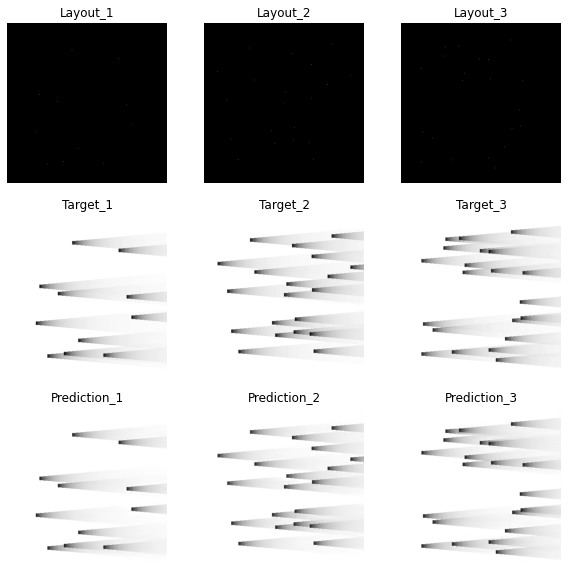

Epoch 279: , Train RMSE: 0.00839759746756531,Validation RMSE: 0.008607160612313003
Epoch 279: , Train loss: 2707.954299926758,Validation loss: 355.59942626953125


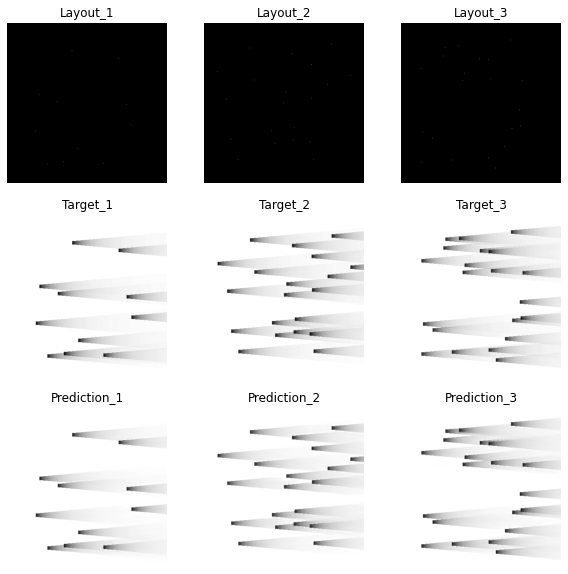

Epoch 280: , Train RMSE: 0.008393768716139388,Validation RMSE: 0.008603143725113283
Epoch 280: , Train loss: 2705.485565185547,Validation loss: 355.26759338378906


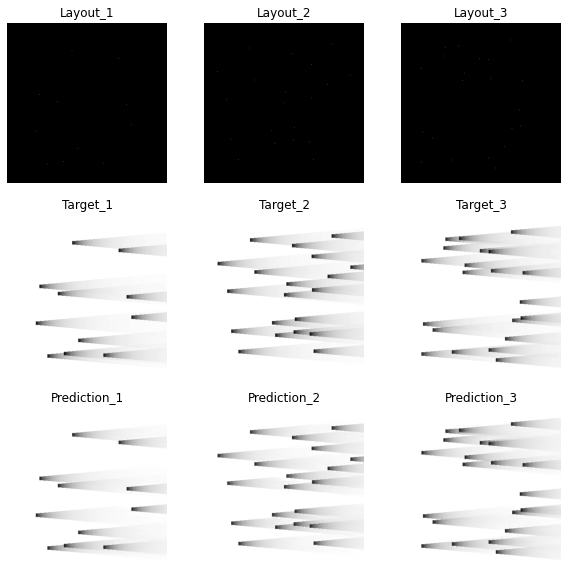

Epoch 281: , Train RMSE: 0.008389879796224547,Validation RMSE: 0.008599373382095772
Epoch 281: , Train loss: 2702.9791870117188,Validation loss: 354.9562683105469


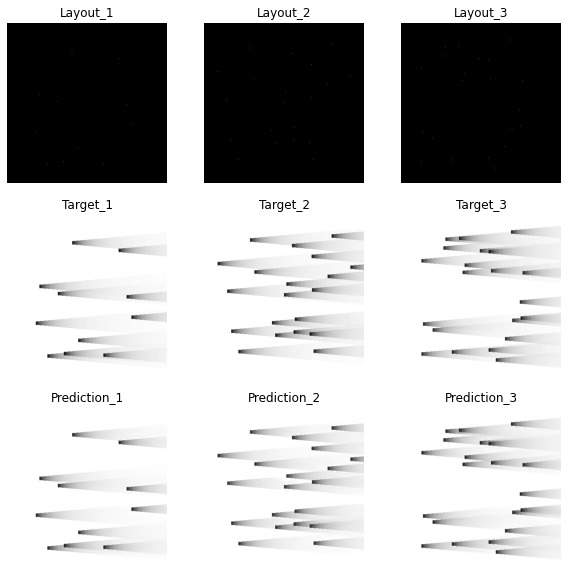

Epoch 282: , Train RMSE: 0.008385991797458888,Validation RMSE: 0.00859528461972562
Epoch 282: , Train loss: 2700.474563598633,Validation loss: 354.6188049316406


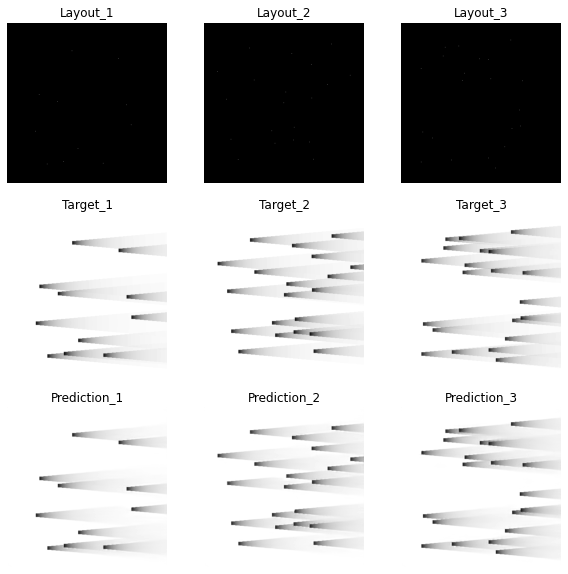

Epoch 283: , Train RMSE: 0.00838214677037801,Validation RMSE: 0.008591610728938
Epoch 283: , Train loss: 2697.998764038086,Validation loss: 354.3157196044922


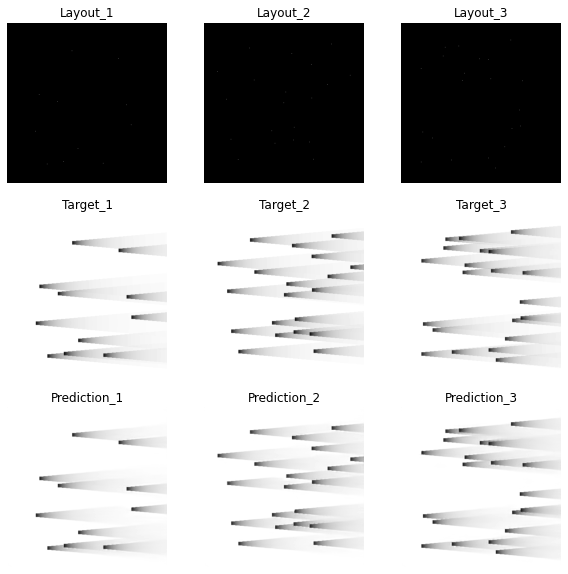

Epoch 284: , Train RMSE: 0.00837831546387197,Validation RMSE: 0.008587603226087077
Epoch 284: , Train loss: 2695.532928466797,Validation loss: 353.9852600097656


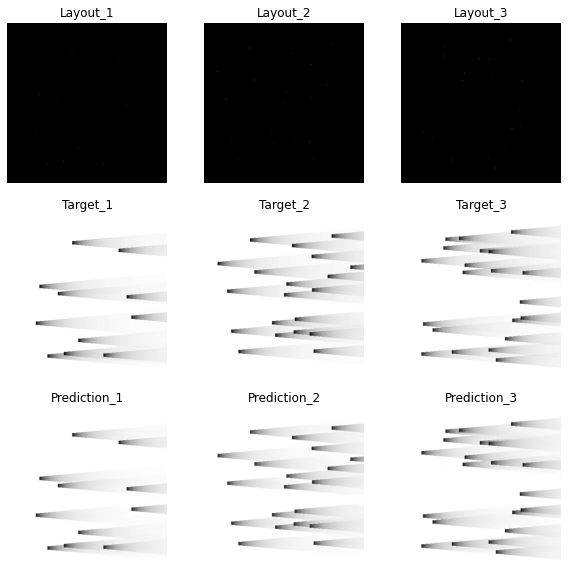

Epoch 285: , Train RMSE: 0.008374404919297546,Validation RMSE: 0.008583456081759555
Epoch 285: , Train loss: 2693.0172576904297,Validation loss: 353.64344787597656


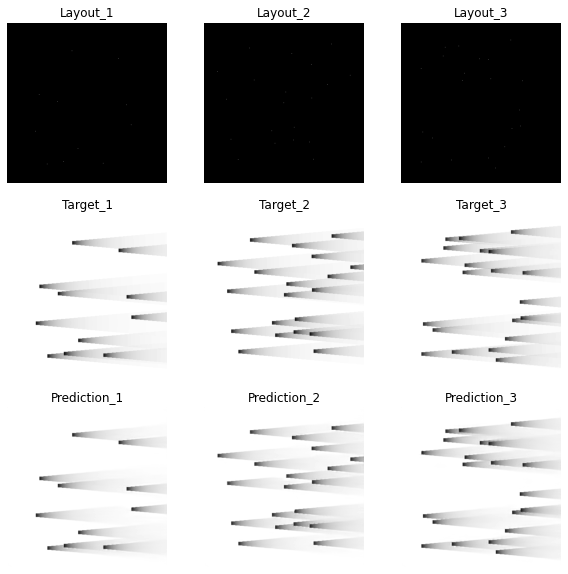

Epoch 286: , Train RMSE: 0.008370571944385414,Validation RMSE: 0.008579679680619654
Epoch 286: , Train loss: 2690.5526275634766,Validation loss: 353.33233642578125


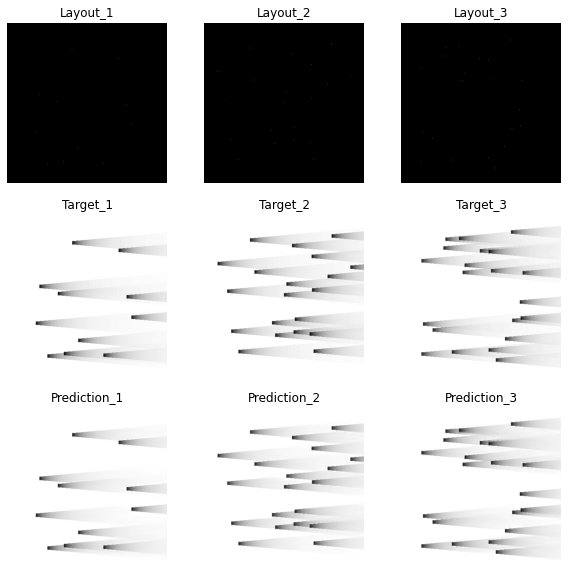

Epoch 287: , Train RMSE: 0.008366612305090953,Validation RMSE: 0.008575789670478751
Epoch 287: , Train loss: 2688.0077362060547,Validation loss: 353.0120086669922


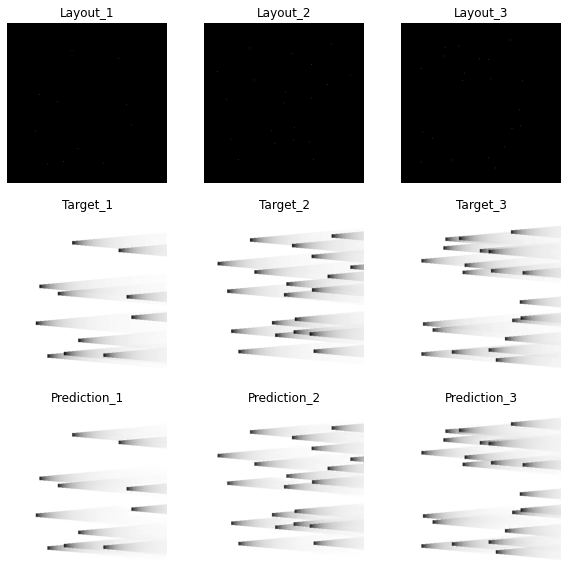

Epoch 288: , Train RMSE: 0.008362780296292472,Validation RMSE: 0.0085718072209661
Epoch 288: , Train loss: 2685.5460205078125,Validation loss: 352.68421936035156


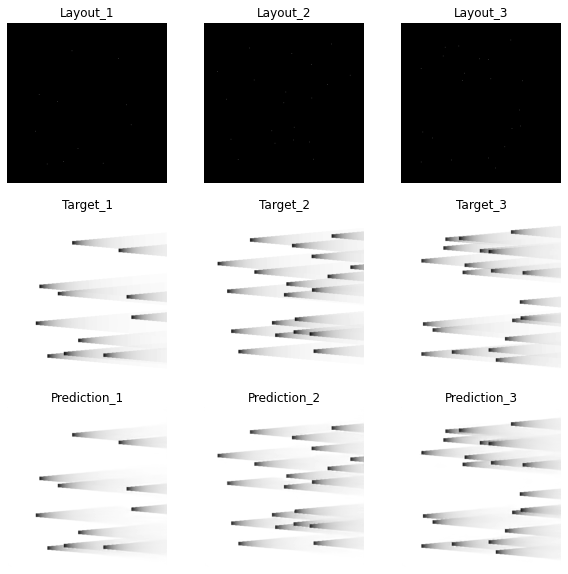

Epoch 289: , Train RMSE: 0.008358770283249953,Validation RMSE: 0.008567739809359133
Epoch 289: , Train loss: 2682.971160888672,Validation loss: 352.34959411621094


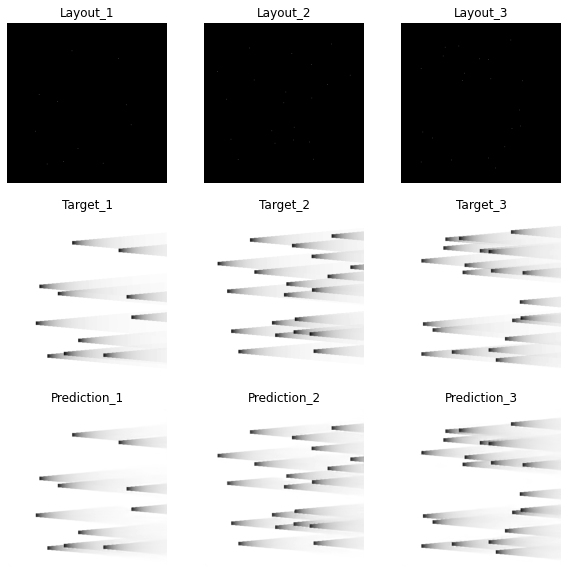

Power_Error= 0.5980899268093686
Epoch 290: , Train RMSE: 0.008354939766656648,Validation RMSE: 0.008564077116057056
Epoch 290: , Train loss: 2680.512710571289,Validation loss: 352.04840087890625


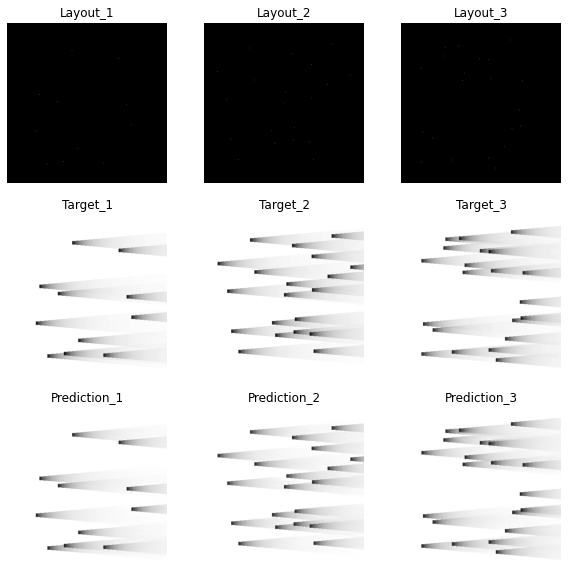

Power_Error= 0.6017454171703578
Epoch 291: , Train RMSE: 0.008350982683952162,Validation RMSE: 0.008560113170446096
Epoch 291: , Train loss: 2677.9742126464844,Validation loss: 351.7225799560547


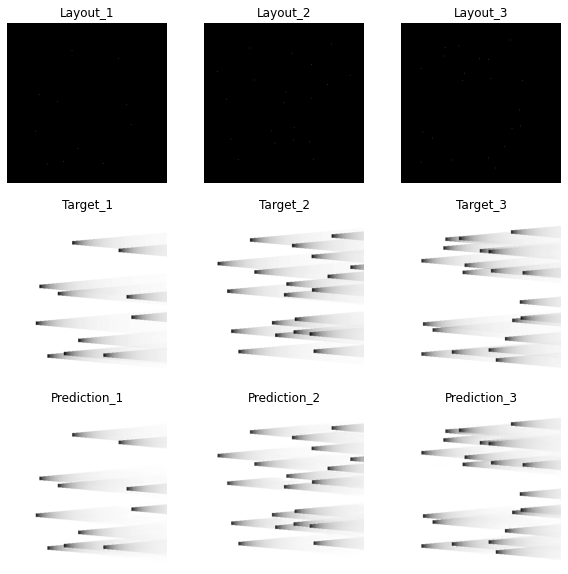

Power_Error= 0.6086283816158912
Epoch 292: , Train RMSE: 0.00834700016054999,Validation RMSE: 0.00855606676476247
Epoch 292: , Train loss: 2675.420608520508,Validation loss: 351.39013671875


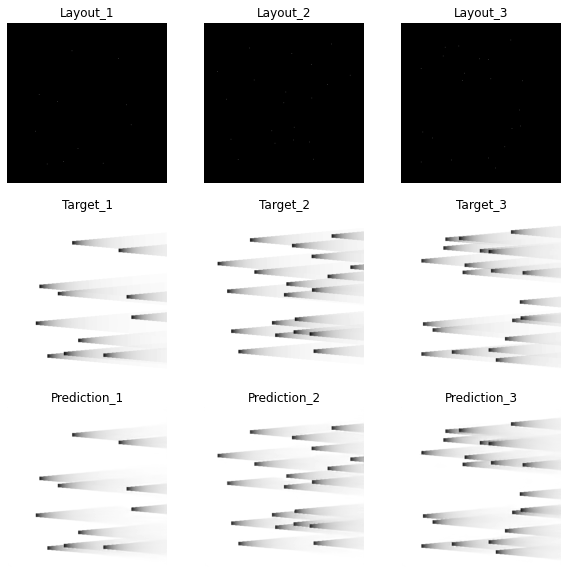

Power_Error= 0.6131630405447132
Epoch 293: , Train RMSE: 0.008343102204968013,Validation RMSE: 0.008551970678989924
Epoch 293: , Train loss: 2672.922409057617,Validation loss: 351.05377197265625


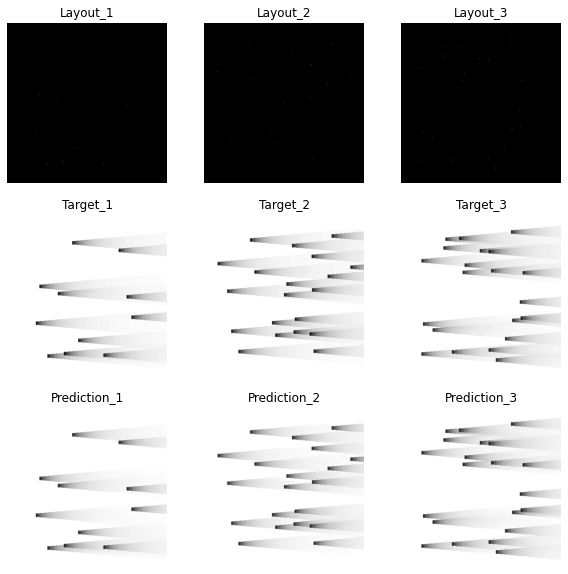

Power_Error= 0.6128044323130971
Epoch 294: , Train RMSE: 0.008339154181459784,Validation RMSE: 0.008547972297781845
Epoch 294: , Train loss: 2670.393310546875,Validation loss: 350.7255859375


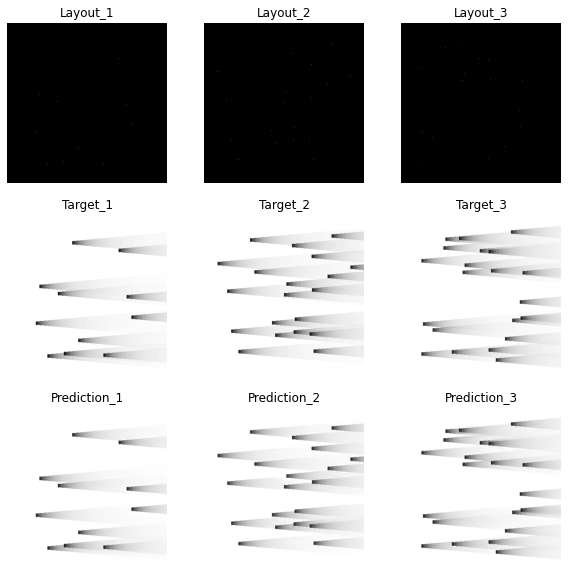

Power_Error= 0.6199187569080602
Epoch 295: , Train RMSE: 0.008335312624161794,Validation RMSE: 0.008543941163959397
Epoch 295: , Train loss: 2667.933563232422,Validation loss: 350.3948669433594


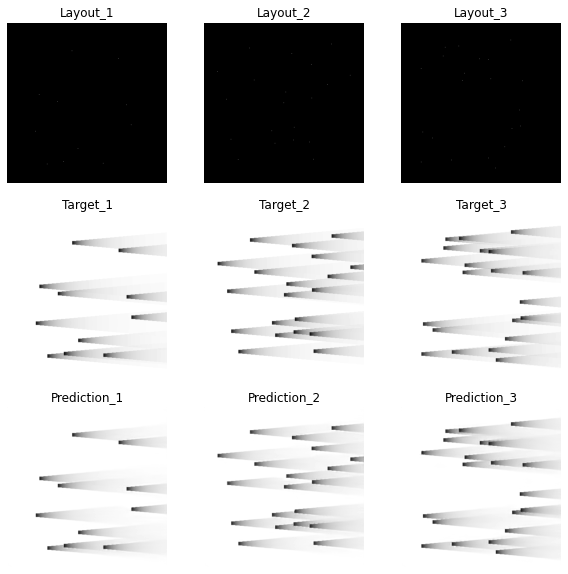

Power_Error= 0.6207632214534786
Epoch 296: , Train RMSE: 0.008331361410164448,Validation RMSE: 0.00853990887178613
Epoch 296: , Train loss: 2665.40478515625,Validation loss: 350.064208984375


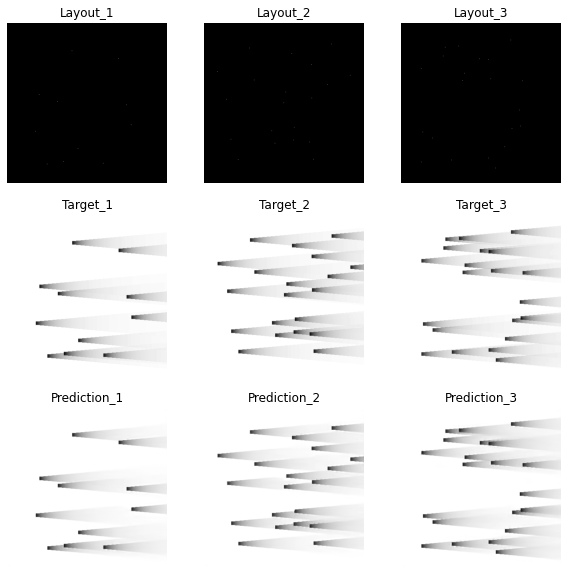

Power_Error= 0.6266282012415214
Epoch 297: , Train RMSE: 0.008327470115501875,Validation RMSE: 0.008535895902590617
Epoch 297: , Train loss: 2662.91552734375,Validation loss: 349.73529052734375


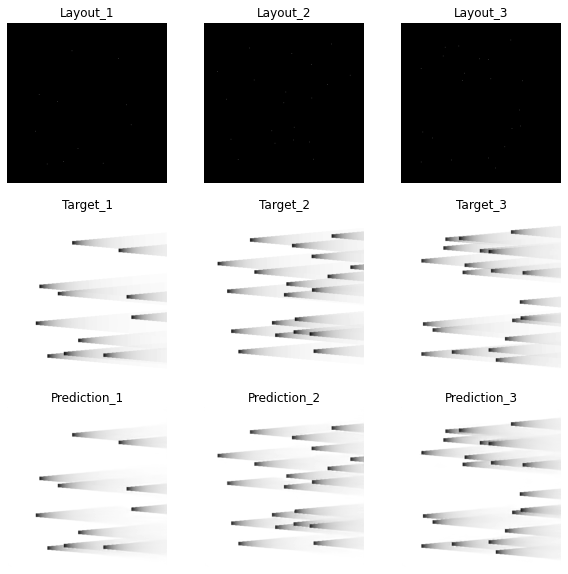

Power_Error= 0.6285022184519019
Epoch 298: , Train RMSE: 0.008323488181635244,Validation RMSE: 0.008531577005046245
Epoch 298: , Train loss: 2660.3694915771484,Validation loss: 349.3814697265625


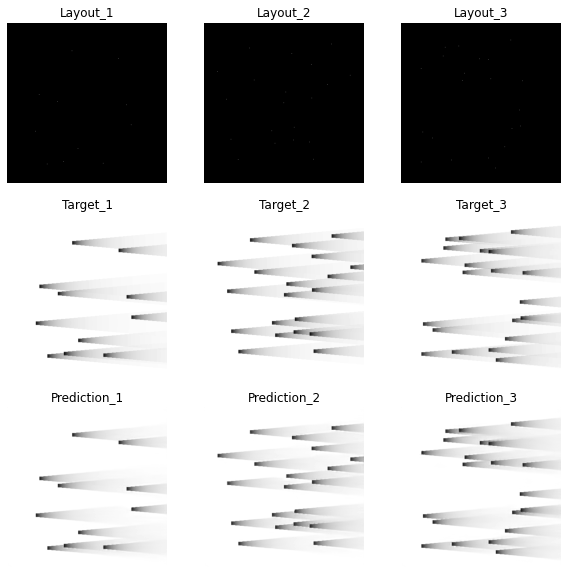

Power_Error= 0.6305960278042406
Validation Images


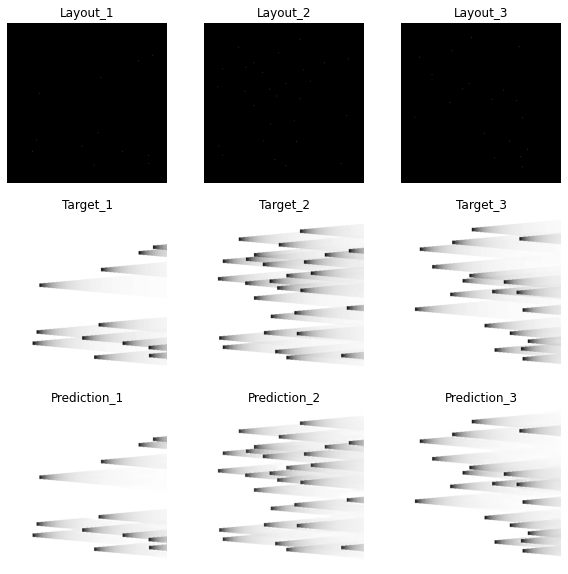

Epoch 299: , Train RMSE: 0.008319621646956103,Validation RMSE: 0.008527671762222331
Epoch 299: , Train loss: 2657.898406982422,Validation loss: 349.0616912841797


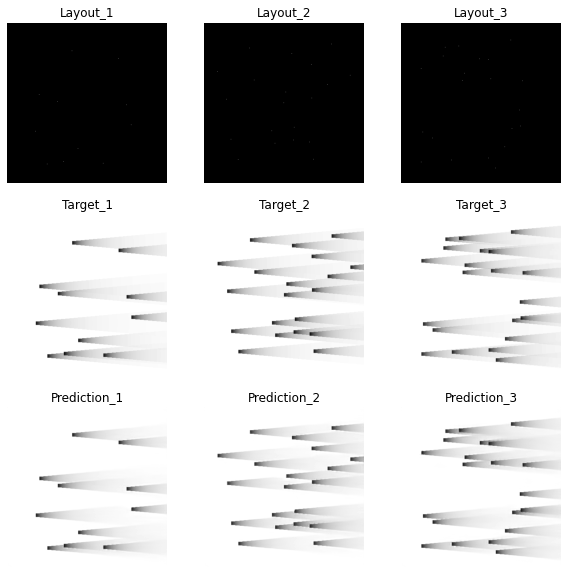

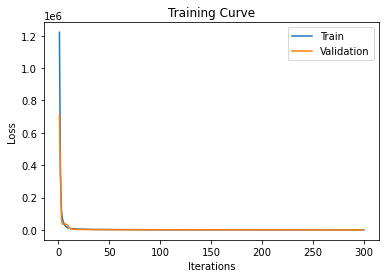

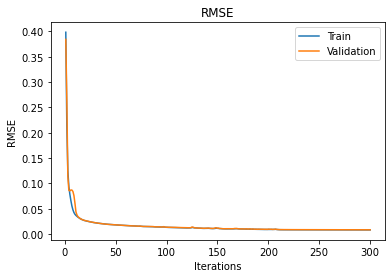

In [19]:
#Main training loop for model
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "plot_LC": True,
    "checkpoint": "",
    "plot": True,
    "visualize": False,
    "downsize_input": False,
    "batch_size":32,
    "test_batch_size":16,
    "learning_rate":3e-3,
    "weight_decay":0.005,
    "epochs":300,
    "ntrain":ntrain,
    "ntest":ntest,
    "nvalid":nvalid,
    "epoch_t":290
}

ConvNet=network_add(Dense_C8_one_layer_Added,7,400)
args.update(args_dict)
cnn,actual_power,Jensen,pre_power = train(args,ConvNet,0.8)

In [20]:
model=cnn
torch.save(model.state_dict(), './results/weighted_{}_model.pt'.format('best'))